# 1. Import all used libraries

In [164]:
!pip install tensorflow
!pip install pygam

Defaulting to user installation because normal site-packages is not writeable

DEPRECATION: Loading egg at c:\program files\python311\lib\site-packages\vboxapi-1.0-py3.11.egg is deprecated. pip 23.3 will enforce this behaviour change. A possible replacement is to use pip for package installation..

[notice] A new release of pip is available: 23.2.1 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip



Defaulting to user installation because normal site-packages is not writeable


DEPRECATION: Loading egg at c:\program files\python311\lib\site-packages\vboxapi-1.0-py3.11.egg is deprecated. pip 23.3 will enforce this behaviour change. A possible replacement is to use pip for package installation..

[notice] A new release of pip is available: 23.2.1 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [165]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from itertools import combinations
from scipy.stats import boxcox
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.seasonal import STL
import seaborn as sns
import random
import torch
from statsmodels.tools.eval_measures import aic
import tensorflow as tf
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_percentage_error, mean_absolute_error, make_scorer
from sklearn.model_selection import train_test_split, cross_val_score, learning_curve, KFold, RandomizedSearchCV
import statsmodels.api as sm
from statsmodels.stats.stattools import durbin_watson
from sklearn.svm import SVR
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.preprocessing import StandardScaler, RobustScaler, MinMaxScaler
from tensorflow.keras.callbacks import EarlyStopping
from scipy.stats import uniform
from pygam import LinearGAM, s

'''imported marked to add notes in bold, Italic...'''
from IPython.display import Markdown
def bold(string):
    display(Markdown(string))


# 2. Load Data

In [166]:
# add file path 
dir_57001_cdr = pd.read_csv('57001_cdr.csv')
dir_57001_gdf = pd.read_csv('57001_gdf.csv')
dir_57002_cdr = pd.read_csv('57002_cdr.csv')
dir_57002_gdf = pd.read_csv('57002_gdf.csv')
dir_57004_cdr = pd.read_csv('57004_cdr.csv')
dir_57004_gdf = pd.read_csv('57004_gdf.csv')
dir_57005_cdr = pd.read_csv('57005_cdr.csv')
dir_57005_gdf = pd.read_csv('57005_gdf.csv')
dir_57006_cdr = pd.read_csv('57006_cdr.csv')
dir_57006_gdf = pd.read_csv('57006_gdf.csv')
dir_57007_cdr = pd.read_csv('57007_cdr.csv')
dir_57007_gdf = pd.read_csv('57007_gdf.csv')
dir_57015_cdr = pd.read_csv('57015_cdr.csv')
dir_57015_gdf = pd.read_csv('57015_gdf.csv')
dir_57017_cdr = pd.read_csv('57017_cdr.csv')
dir_57017_gdf = pd.read_csv('57017_gdf.csv')

# 3. Data Inspection and Data Cleaning

## 3.1 Data inspected of all gauges

### 3.1.1 Gauge station (57005 - Taff at Pontypridd)

In [167]:
bold('**First 30 instance of rainfall\'s raw data of gauge 57005 (which is main river)**')
dir_57005_cdr.head(30)

**First 30 instance of rainfall's raw data of gauge 57005 (which is main river)**

,file,timestamp,2024-06-13T12:11:20
0,database,id,nrfa-public-30
1,database,name,UK National River Flow Archive
2,station,id,57005
3,station,name,Taff at Pontypridd
4,station,gridReference,ST0792489715
5,station,descriptionSummary,Non-standard flat V weir. Velocity area statio...
6,station,descriptionGeneral,Non-standard flat V weir. Velocity area statio...
7,station,descriptionStationHydrometry,Weir width: 32m; cross-slope 1:20 u/s and d/s....
8,station,descriptionFlowRecord,"Weir refurbished Sep-Nov 1996, and weir was re..."
9,station,descriptionCatchment,"Coal Measures, some Boulder Clay cover and all..."


In [168]:
bold('**First 30 instance of daily flow\'s raw data of gauge 57005 (which is main river)**')
dir_57005_gdf.head(30)

**First 30 instance of daily flow's raw data of gauge 57005 (which is main river)**

,file,timestamp,2024-06-13T12:10:59
0,database,id,nrfa-public-30
1,database,name,UK National River Flow Archive
2,station,id,57005
3,station,name,Taff at Pontypridd
4,station,gridReference,ST0792489715
5,station,descriptionSummary,Non-standard flat V weir. Velocity area statio...
6,station,descriptionGeneral,Non-standard flat V weir. Velocity area statio...
7,station,descriptionStationHydrometry,Weir width: 32m; cross-slope 1:20 u/s and d/s....
8,station,descriptionFlowRecord,"Weir refurbished Sep-Nov 1996, and weir was re..."
9,station,descriptionCatchment,"Coal Measures, some Boulder Clay cover and all..."


* raw data file contain metadata with actual dataset which need to separte from metadata (57005, Taff at Pontypridd)

In [169]:
daily_rainfall_catchement_57005 = dir_57005_cdr.iloc[19:,0:2]
df_daily_rainfall_catchement_57005 = pd.DataFrame({
    'date': daily_rainfall_catchement_57005['file'],
    'cdr': daily_rainfall_catchement_57005['timestamp']
})
daily_gauge_catchement_57005 = dir_57005_gdf.iloc[19:,0:2]
df_daily_gauge_catchement_57005 = pd.DataFrame({
    'date': daily_gauge_catchement_57005['file'],
    'gdf': daily_gauge_catchement_57005['timestamp']
})
print('----------------------------------------------------------------------------------------------')
bold('**Measurement of rainfall (mm) for station 57005 (Taff at Pontipridd-Parent of 57004, 57006, 57007)**')
print('----------------------------------------------------------------------------------------------')
print(df_daily_rainfall_catchement_57005)
print('-----------------------------------------------------------------------------------------------')
bold('**Measurement of daily flow (m3/s) for station 57005 (Taff at Pontipridd-Parent of 57004, 57006, 57007)**')
print('-----------------------------------------------------------------------------------------------')
print(df_daily_gauge_catchement_57005)

----------------------------------------------------------------------------------------------


**Measurement of rainfall (mm) for station 57005 (Taff at Pontipridd-Parent of 57004, 57006, 57007)**

----------------------------------------------------------------------------------------------
             date     cdr
19     1961-01-01  17.200
20     1961-01-02  24.700
21     1961-01-03   4.100
22     1961-01-04   0.300
23     1961-01-05  11.000
...           ...     ...
20833  2017-12-27   1.500
20834  2017-12-28  19.000
20835  2017-12-29  10.500
20836  2017-12-30  24.100
20837  2017-12-31  13.300

[20819 rows x 2 columns]
-----------------------------------------------------------------------------------------------


**Measurement of daily flow (m3/s) for station 57005 (Taff at Pontipridd-Parent of 57004, 57006, 57007)**

-----------------------------------------------------------------------------------------------
             date     gdf
19     1970-10-01   6.240
20     1970-10-02   6.020
21     1970-10-03   5.560
22     1970-10-04   5.690
23     1970-10-05  10.600
...           ...     ...
19007  2022-09-26   3.290
19008  2022-09-27   3.270
19009  2022-09-28   3.170
19010  2022-09-29   3.580
19011  2022-09-30  17.900

[18993 rows x 2 columns]


In [170]:
bold('**Structure summary of dataframe 57005**')
print('-----------------')
print('Rainfall at 57005')
print('-----------------')
print(df_daily_rainfall_catchement_57005.info())
print('-----------------')
print('|| Daily flow at 57005 ||')
print('-----------------')
print(df_daily_gauge_catchement_57005.info())

**Structure summary of dataframe 57005**

-----------------
Rainfall at 57005
-----------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20819 entries, 19 to 20837
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   date    20819 non-null  object
 1   cdr     20819 non-null  object
dtypes: object(2)
memory usage: 325.4+ KB
None
-----------------
|| Daily flow at 57005 ||
-----------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18993 entries, 19 to 19011
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   date    18993 non-null  object
 1   gdf     18993 non-null  object
dtypes: object(2)
memory usage: 296.9+ KB
None


In [171]:
bold('**Description summary of dataframe 57005**')
print('-----------------------')
print('|| Rainfall at 57005 ||')
print('-----------------------')
print(df_daily_rainfall_catchement_57005.describe())
print('-----------------------')
print('|| Daily flow at 57005 ||')
print('-----------------------')
print(df_daily_gauge_catchement_57005.describe())

**Description summary of dataframe 57005**

-----------------------
|| Rainfall at 57005 ||
-----------------------
              date    cdr
count        20819  20819
unique       20819    569
top     1961-01-01  0.000
freq             1   6265
-----------------------
|| Daily flow at 57005 ||
-----------------------
              date     gdf
count        18993   18993
unique       18993    1796
top     1970-10-01  10.600
freq             1      95


In [172]:
bold('**Merge DataFrames 57005 on \'time\' column using inner join**')
merged_df_57005 = pd.merge(df_daily_rainfall_catchement_57005, df_daily_gauge_catchement_57005, on='date', how='inner')
print("Inner Join Result:")
print(merged_df_57005)

**Merge DataFrames 57005 on 'time' column using inner join**

Inner Join Result:
             date     cdr     gdf
0      1970-10-01   0.600   6.240
1      1970-10-02   2.200   6.020
2      1970-10-03   0.700   5.560
3      1970-10-04   7.800   5.690
4      1970-10-05  14.600  10.600
...           ...     ...     ...
17254  2017-12-27   1.500  34.500
17255  2017-12-28  19.000  28.500
17256  2017-12-29  10.500  73.400
17257  2017-12-30  24.100  89.400
17258  2017-12-31  13.300  87.700

[17259 rows x 3 columns]


In [173]:
merged_df_57005['gauge'] = 57005
merged_df_57005

,date,cdr,gdf,gauge
0,1970-10-01,0.600,6.240,57005
1,1970-10-02,2.200,6.020,57005
2,1970-10-03,0.700,5.560,57005
3,1970-10-04,7.800,5.690,57005
4,1970-10-05,14.600,10.600,57005
...,...,...,...,...
17254,2017-12-27,1.500,34.500,57005
17255,2017-12-28,19.000,28.500,57005
17256,2017-12-29,10.500,73.400,57005
17257,2017-12-30,24.100,89.400,57005


In [174]:
# converting type of attritute
merged_df_57005['date'] = pd.to_datetime(merged_df_57005['date'])
merged_df_57005['cdr'] = pd.to_numeric(merged_df_57005['cdr'])
merged_df_57005['gdf'] = pd.to_numeric(merged_df_57005['gdf'])
merged_df_57005.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17259 entries, 0 to 17258
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   date    17259 non-null  datetime64[ns]
 1   cdr     17259 non-null  float64       
 2   gdf     17259 non-null  float64       
 3   gauge   17259 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int64(1)
memory usage: 539.5 KB


In [175]:
print('--------------------------------')
bold('**|| Numerical Summary of 57005 ||**')
print('--------------------------------')
merged_df_57005.iloc[0:,1:3].describe()

--------------------------------


**|| Numerical Summary of 57005 ||**

--------------------------------


,cdr,gdf
count,17259.000000,17259.000000
mean,5.344696,20.720056
std,9.331123,27.358210
min,0.000000,1.700000
25%,0.000000,6.430000
50%,1.000000,10.900000
75%,6.800000,22.700000
max,87.300000,397.000000


In [176]:
print('**********************************')
bold('**|| Checking missing value in 57005 ||**')
print('**********************************')
missing_values_57005 = merged_df_57005.isna().sum()
missing_values_57005

**********************************


**|| Checking missing value in 57005 ||**

**********************************


date     0
cdr      0
gdf      0
gauge    0
dtype: int64

In [177]:
print('**********************************')
bold('**|| Checking duplicacy in data 57005 ||**')
print('**********************************')
duplicate_values_count_57005 = merged_df_57005.duplicated().sum()
print(f'duplicate values : {duplicate_values_count_57005}')

**********************************


**|| Checking duplicacy in data 57005 ||**

**********************************
duplicate values : 0


### 3.1.2 Gauge station (57006 - Rhondda at Trehafod)

In [178]:
bold('**First 30 instance of water rainfall\'s raw data of gauge 57006 (which is tributaries river)**')
dir_57006_cdr.head(30)

**First 30 instance of water rainfall's raw data of gauge 57006 (which is tributaries river)**

,file,timestamp,2024-06-13T12:16:29
0,database,id,nrfa-public-30
1,database,name,UK National River Flow Archive
2,station,id,57006
3,station,name,Rhondda at Trehafod
4,station,gridReference,ST0528390946
5,station,descriptionSummary,Velocity area station; concrete trapezoidal ch...
6,station,descriptionGeneral,Velocity area station formalised concrete trap...
7,station,descriptionStationHydrometry,Armoured side slopes 1:1.5. Full range. Three ...
8,station,descriptionFlowRecord,Full period of record peak flow data reviewed ...
9,station,descriptionCatchment,Coal Measures with alluvial deposits and Bould...


In [179]:
bold('**First 30 instance of water daily flow\'s raw data of gauge 57006 (which is tributaries river)**')
dir_57006_gdf.head(30)

**First 30 instance of water daily flow's raw data of gauge 57006 (which is tributaries river)**

,file,timestamp,2024-06-13T12:16:17
0,database,id,nrfa-public-30
1,database,name,UK National River Flow Archive
2,station,id,57006
3,station,name,Rhondda at Trehafod
4,station,gridReference,ST0528390946
5,station,descriptionSummary,Velocity area station; concrete trapezoidal ch...
6,station,descriptionGeneral,Velocity area station formalised concrete trap...
7,station,descriptionStationHydrometry,Armoured side slopes 1:1.5. Full range. Three ...
8,station,descriptionFlowRecord,Full period of record peak flow data reviewed ...
9,station,descriptionCatchment,Coal Measures with alluvial deposits and Bould...


In [180]:
daily_rainfall_catchement_57006 = dir_57006_cdr.iloc[19:,0:2]
df_daily_rainfall_catchement_57006 = pd.DataFrame({
    'date': daily_rainfall_catchement_57006['file'],
    'cdr': daily_rainfall_catchement_57006['timestamp']
})
daily_gauge_catchement_57006 = dir_57006_gdf.iloc[19:,0:2]
df_daily_gauge_catchement_57006 = pd.DataFrame({
    'date': daily_gauge_catchement_57006['file'],
    'gdf': daily_gauge_catchement_57006['timestamp']
})
print('------------------------------------------------------------------------------------')
bold('**Measurement of rainfall (mm) for station 57006 (Rhondda at Trehafod- parent of 57017)**')
print('------------------------------------------------------------------------------------')
print(df_daily_rainfall_catchement_57006)
print('-------------------------------------------------------------------------------------')
bold('**Measurement of daily flow (m3/s) for station 57006 (Rhondda at Trehafod - parent of 57017)**')
print('-------------------------------------------------------------------------------------')
print(df_daily_gauge_catchement_57006)

------------------------------------------------------------------------------------


**Measurement of rainfall (mm) for station 57006 (Rhondda at Trehafod- parent of 57017)**

------------------------------------------------------------------------------------
             date     cdr
19     1961-01-01  22.300
20     1961-01-02  30.700
21     1961-01-03   5.800
22     1961-01-04   0.100
23     1961-01-05  12.000
...           ...     ...
20833  2017-12-27   1.300
20834  2017-12-28  22.300
20835  2017-12-29  13.300
20836  2017-12-30  23.500
20837  2017-12-31  11.000

[20819 rows x 2 columns]
-------------------------------------------------------------------------------------


**Measurement of daily flow (m3/s) for station 57006 (Rhondda at Trehafod - parent of 57017)**

-------------------------------------------------------------------------------------
             date    gdf
19     1970-10-01  1.810
20     1970-10-02  1.780
21     1970-10-03  1.540
22     1970-10-04  1.620
23     1970-10-05  4.770
...           ...    ...
19007  2022-09-26  0.923
19008  2022-09-27  0.899
19009  2022-09-28  0.879
19010  2022-09-29  0.910
19011  2022-09-30  9.750

[18993 rows x 2 columns]


In [181]:
bold('**structure summary of dataframe 57006**')
print('-----------------------')
print('|| Rainfall at 57006 ||')
print('-----------------------')
print(df_daily_rainfall_catchement_57006.info())
print('-----------------------')
print('|| Daily flow at 57006 ||')
print('-----------------------')
print(df_daily_gauge_catchement_57006.info())

**structure summary of dataframe 57006**

-----------------------
|| Rainfall at 57006 ||
-----------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20819 entries, 19 to 20837
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   date    20819 non-null  object
 1   cdr     20819 non-null  object
dtypes: object(2)
memory usage: 325.4+ KB
None
-----------------------
|| Daily flow at 57006 ||
-----------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18993 entries, 19 to 19011
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   date    18993 non-null  object
 1   gdf     18689 non-null  object
dtypes: object(2)
memory usage: 296.9+ KB
None


In [182]:
bold('**Description summary of dataframe 57006**')
print('-----------------------')
print('|| Rainfall at 57006 ||')
print('-----------------------')
print(df_daily_rainfall_catchement_57006.describe())
print('-----------------------')
print('|| Daily flow at 57006 ||')
print('-----------------------')
print(df_daily_gauge_catchement_57006.describe())

**Description summary of dataframe 57006**

-----------------------
|| Rainfall at 57006 ||
-----------------------
              date    cdr
count        20819  20819
unique       20819    668
top     1961-01-01  0.000
freq             1   6611
-----------------------
|| Daily flow at 57006 ||
-----------------------
              date     gdf
count        18993   18689
unique       18993    6467
top     1970-10-01  10.200
freq             1      36


In [183]:
bold('**Merge DataFrames 57006 on \'time\'column using inner join**')
merged_df_57006 = pd.merge(df_daily_rainfall_catchement_57006, df_daily_gauge_catchement_57006, on='date', how='inner')
print("Inner Join Result:")
merged_df_57006['gauge'] = 57006
print(merged_df_57006)

**Merge DataFrames 57006 on 'time'column using inner join**

Inner Join Result:
             date     cdr     gdf  gauge
0      1970-10-01   0.600   1.810  57006
1      1970-10-02   2.700   1.780  57006
2      1970-10-03   0.800   1.540  57006
3      1970-10-04  10.200   1.620  57006
4      1970-10-05  21.400   4.770  57006
...           ...     ...     ...    ...
17254  2017-12-27   1.300   9.380  57006
17255  2017-12-28  22.300   9.570  57006
17256  2017-12-29  13.300  19.300  57006
17257  2017-12-30  23.500  19.300  57006
17258  2017-12-31  11.000  17.600  57006

[17259 rows x 4 columns]


In [184]:
# converting type of attritute
merged_df_57006['date'] = pd.to_datetime(merged_df_57006['date'])
merged_df_57006['cdr'] = pd.to_numeric(merged_df_57006['cdr'])
merged_df_57006['gdf'] = pd.to_numeric(merged_df_57006['gdf'])
merged_df_57006.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17259 entries, 0 to 17258
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   date    17259 non-null  datetime64[ns]
 1   cdr     17259 non-null  float64       
 2   gdf     16955 non-null  float64       
 3   gauge   17259 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int64(1)
memory usage: 539.5 KB


In [185]:
print('--------------------------------')
bold('**|| Numerical Summary of 57006 ||**')
print('--------------------------------')
merged_df_57006.iloc[0:,1:3].describe()

--------------------------------


**|| Numerical Summary of 57006 ||**

--------------------------------


,cdr,gdf
count,17259.000000,16955.000000
mean,6.443687,5.899018
std,11.302441,7.739532
min,0.000000,0.303000
25%,0.000000,1.660000
50%,1.100000,3.110000
75%,8.200000,6.881500
max,99.300000,104.000000


In [186]:
print('**********************************')
bold('**|| Checking missing value in 57006 ||**')
print('**********************************')
missing_values_57006 = merged_df_57006.isna().sum()
missing_values_57006

**********************************


**|| Checking missing value in 57006 ||**

**********************************


date       0
cdr        0
gdf      304
gauge      0
dtype: int64

In [187]:
print('**********************************')
bold('**|| Checking duplicacy in data 57006 ||**')
print('**********************************')
duplicate_values_count_57006 = merged_df_57006.duplicated().sum()
print(f'duplicate values : {duplicate_values_count_57006}')

**********************************


**|| Checking duplicacy in data 57006 ||**

**********************************
duplicate values : 0


### 3.1.3 Gauge station (57017 - Rhondda Fawr at Tynewydd)

In [188]:
bold('**First 30 instance of rainfall\'s raw data of gauge 57017 (which is tributaries river)**')
dir_57017_cdr.head(30)

**First 30 instance of rainfall's raw data of gauge 57017 (which is tributaries river)**

,file,timestamp,2024-06-13T12:17:06
0,database,id,nrfa-public-30
1,database,name,UK National River Flow Archive
2,station,id,57017
3,station,name,Rhondda Fawr at Tynewydd
4,station,gridReference,SS9325998687
5,station,descriptionSummary,Flat V weir with fish baffles on d/s slope. Fl...
6,station,descriptionGeneral,Flat V weir in good condition with fish baffle...
7,station,descriptionStationHydrometry,1.667m high concrete wing walls either side of...
8,station,descriptionFlowRecord,Full period of record peak flow data reviewed ...
9,station,descriptionCatchment,Coal Measures with alluvial deposits and Bould...


In [189]:
bold('**First 30 instance of daily flow\'s raw data of gauge 57017 (which is tributaries river)**')
dir_57017_gdf.head(30)

**First 30 instance of daily flow's raw data of gauge 57017 (which is tributaries river)**

,file,timestamp,2024-06-13T12:16:54
0,database,id,nrfa-public-30
1,database,name,UK National River Flow Archive
2,station,id,57017
3,station,name,Rhondda Fawr at Tynewydd
4,station,gridReference,SS9325998687
5,station,descriptionSummary,Flat V weir with fish baffles on d/s slope. Fl...
6,station,descriptionGeneral,Flat V weir in good condition with fish baffle...
7,station,descriptionStationHydrometry,1.667m high concrete wing walls either side of...
8,station,descriptionFlowRecord,Full period of record peak flow data reviewed ...
9,station,descriptionCatchment,Coal Measures with alluvial deposits and Bould...


In [190]:
daily_rainfall_catchement_57017 = dir_57017_cdr.iloc[19:,0:2]
df_daily_rainfall_catchement_57017 = pd.DataFrame({
    'date': daily_rainfall_catchement_57017['file'],
    'cdr': daily_rainfall_catchement_57017['timestamp']
})
daily_gauge_catchement_57017 = dir_57017_gdf.iloc[19:,0:2]
df_daily_gauge_catchement_57017 = pd.DataFrame({
    'date': daily_gauge_catchement_57017['file'],
    'gdf': daily_gauge_catchement_57017['timestamp']
})
print('-------------------------------------------------------------------------------')
bold('**Measurement of rainfall (mm) for station 57017  (Rhondda Fawr at Tynewydd-child)**')
print('-------------------------------------------------------------------------------')
print(df_daily_rainfall_catchement_57017)
print('--------------------------------------------------------------------------------')
bold('**mMasurement of daily flow (m3/s) for station 57017(Rhondda Fawr at Tynewydd-child)**')
print('---------------------------------------------------------------------------------')
print(df_daily_gauge_catchement_57017)

-------------------------------------------------------------------------------


**Measurement of rainfall (mm) for station 57017  (Rhondda Fawr at Tynewydd-child)**

-------------------------------------------------------------------------------
           date     cdr
19   2016-01-01  23.900
20   2016-01-02  21.400
21   2016-01-03  44.800
22   2016-01-04  35.600
23   2016-01-05  10.100
..          ...     ...
745  2017-12-27   2.500
746  2017-12-28  25.800
747  2017-12-29  14.700
748  2017-12-30  25.100
749  2017-12-31  13.400

[731 rows x 2 columns]
--------------------------------------------------------------------------------


**mMasurement of daily flow (m3/s) for station 57017(Rhondda Fawr at Tynewydd-child)**

---------------------------------------------------------------------------------
            date    gdf
19    2001-04-17  0.654
20    2001-04-18  0.636
21    2001-04-19  0.653
22    2001-04-20  0.671
23    2001-04-21  0.795
...          ...    ...
7851  2022-09-26  0.199
7852  2022-09-27  0.221
7853  2022-09-28  0.218
7854  2022-09-29  0.218
7855  2022-09-30  2.372

[7837 rows x 2 columns]


In [191]:
bold('**structure summary of dataframe 57017**')
print('-----------------------')
print('|| Rainfall at 57017 ||')
print('-----------------------')
print(df_daily_rainfall_catchement_57017.info())
print('-----------------------')
print('|| Daily flow at 57017 ||')
print('-----------------------')
print(df_daily_gauge_catchement_57017.info())

**structure summary of dataframe 57017**

-----------------------
|| Rainfall at 57017 ||
-----------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 731 entries, 19 to 749
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   date    731 non-null    object
 1   cdr     731 non-null    object
dtypes: object(2)
memory usage: 11.6+ KB
None
-----------------------
|| Daily flow at 57017 ||
-----------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7837 entries, 19 to 7855
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   date    7837 non-null   object
 1   gdf     7837 non-null   object
dtypes: object(2)
memory usage: 122.6+ KB
None


In [192]:
bold('**Description summary of dataframe 57017**')
print('-----------------------')
print('|| Rainfall at 57017 ||')
print('-----------------------')
print(df_daily_rainfall_catchement_57017.describe())
print('-----------------------')
print('|| Daily flow at 57017 ||')
print('-----------------------')
print(df_daily_gauge_catchement_57017.describe())

**Description summary of dataframe 57017**

-----------------------
|| Rainfall at 57017 ||
-----------------------
              date    cdr
count          731    731
unique         731    217
top     2016-01-01  0.000
freq             1    177
-----------------------
|| Daily flow at 57017 ||
-----------------------
              date    gdf
count         7837   7837
unique        7837   2252
top     2001-04-17  0.196
freq             1     20


In [193]:
bold('**Merge DataFrames 57017 on \'time\'column using inner join**')
merged_df_57017 = pd.merge(df_daily_rainfall_catchement_57017, df_daily_gauge_catchement_57017, on='date', how='inner')
print("Inner Join Result:")
merged_df_57017['gauge'] = 57017
print(merged_df_57017)

**Merge DataFrames 57017 on 'time'column using inner join**

Inner Join Result:
           date     cdr    gdf  gauge
0    2016-01-01  23.900  3.132  57017
1    2016-01-02  21.400  3.349  57017
2    2016-01-03  44.800  7.026  57017
3    2016-01-04  35.600  7.374  57017
4    2016-01-05  10.100  3.455  57017
..          ...     ...    ...    ...
726  2017-12-27   2.500  1.917  57017
727  2017-12-28  25.800  1.950  57017
728  2017-12-29  14.700  3.211  57017
729  2017-12-30  25.100  3.611  57017
730  2017-12-31  13.400  3.059  57017

[731 rows x 4 columns]


In [194]:
# converting type of attritute
merged_df_57017['date'] = pd.to_datetime(merged_df_57017['date'])
merged_df_57017['cdr'] = pd.to_numeric(merged_df_57017['cdr'])
merged_df_57017['gdf'] = pd.to_numeric(merged_df_57017['gdf'])
merged_df_57017.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 731 entries, 0 to 730
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   date    731 non-null    datetime64[ns]
 1   cdr     731 non-null    float64       
 2   gdf     731 non-null    float64       
 3   gauge   731 non-null    int64         
dtypes: datetime64[ns](1), float64(2), int64(1)
memory usage: 23.0 KB


In [195]:
print('--------------------------------')
bold('**|| Numerical Summary of 57017 ||**')
print('--------------------------------')
merged_df_57017.iloc[0:,1:3].describe()

--------------------------------


**|| Numerical Summary of 57017 ||**

--------------------------------


,cdr,gdf
count,731.000000,731.000000
mean,6.830369,1.156085
std,10.990441,1.306841
min,0.000000,0.147000
25%,0.100000,0.364000
50%,1.600000,0.739000
75%,9.850000,1.402500
max,93.000000,13.990000


In [196]:
print('**********************************')
bold('**|| Checking missing value in 57017 ||**')
print('**********************************')
missing_values_57017 = merged_df_57017.isna().sum()
missing_values_57017

**********************************


**|| Checking missing value in 57017 ||**

**********************************


date     0
cdr      0
gdf      0
gauge    0
dtype: int64

In [197]:
print('**********************************')
bold('**|| Checking duplicacy in data 57017 ||**')
print('**********************************')
duplicate_values_count_57017 = merged_df_57017.duplicated().sum()
print(f'duplicate values : {duplicate_values_count_57017}')

**********************************


**|| Checking duplicacy in data 57017 ||**

**********************************
duplicate values : 0


note: need to drop station 57017 because there is very less data point for modelling but still need look forward at this point not very clear

### 3.1.4 Gauge station (57004 - Cynon at Abercynon)

In [198]:
bold('**First 30 instance of rainfall\'s raw data of gauge 57004 (which is tributaries river)**')
dir_57004_cdr.head(30)

**First 30 instance of rainfall's raw data of gauge 57004 (which is tributaries river)**

,file,timestamp,2024-06-13T12:18:11
0,database,id,nrfa-public-30
1,database,name,UK National River Flow Archive
2,station,id,57004
3,station,name,Cynon at Abercynon
4,station,gridReference,ST0794095652
5,station,descriptionSummary,Flat V weir. Station located 900m upstream of ...
6,station,descriptionGeneral,Flat V weir from June 1966 - channel control a...
7,station,descriptionStationHydrometry,"Weir width: 14.24m; cross-slope 1:20, u/s 1:2,..."
8,station,descriptionFlowRecord,Data prior to 1962 of poorer quality than thos...
9,station,descriptionCatchment,Coal Measures with Millstone Grit on northern ...


In [199]:
bold('**First 30 instance of daily flow\'s raw data of gauge 57004 (which is tributaries river)**')
dir_57004_gdf.head(30)

**First 30 instance of daily flow's raw data of gauge 57004 (which is tributaries river)**

,file,timestamp,2024-06-13T12:18:01
0,database,id,nrfa-public-30
1,database,name,UK National River Flow Archive
2,station,id,57004
3,station,name,Cynon at Abercynon
4,station,gridReference,ST0794095652
5,station,descriptionSummary,Flat V weir. Station located 900m upstream of ...
6,station,descriptionGeneral,Flat V weir from June 1966 - channel control a...
7,station,descriptionStationHydrometry,"Weir width: 14.24m; cross-slope 1:20, u/s 1:2,..."
8,station,descriptionFlowRecord,Data prior to 1962 of poorer quality than thos...
9,station,descriptionCatchment,Coal Measures with Millstone Grit on northern ...


In [200]:
daily_rainfall_catchement_57004 = dir_57004_cdr.iloc[19:,0:2]
df_daily_rainfall_catchement_57004 = pd.DataFrame({
    'date': daily_rainfall_catchement_57004['file'],
    'cdr': daily_rainfall_catchement_57004['timestamp']
})
daily_gauge_catchement_57004 = dir_57004_gdf.iloc[19:,0:2]
df_daily_gauge_catchement_57004 = pd.DataFrame({
    'date': daily_gauge_catchement_57004['file'],
    'gdf': daily_gauge_catchement_57004['timestamp']
})
print('------------------------------------------------------------------------')
bold('**Measurement of rainfall (mm) for station 57004 (Cynon at Abercynon-child)**')
print('------------------------------------------------------------------------')
print(df_daily_rainfall_catchement_57004)
print('--------------------------------------------------------------------------')
bold('**Measurement of daily flow (m3/s) for station 57004 (Cynon at Abercynon-child)**')
print('--------------------------------------------------------------------------')
print(df_daily_gauge_catchement_57004)

------------------------------------------------------------------------


**Measurement of rainfall (mm) for station 57004 (Cynon at Abercynon-child)**

------------------------------------------------------------------------
             date     cdr
19     1957-01-01   1.100
20     1957-01-02   8.600
21     1957-01-03  13.600
22     1957-01-04  35.200
23     1957-01-05  19.400
...           ...     ...
22294  2017-12-27   1.400
22295  2017-12-28  19.700
22296  2017-12-29  10.200
22297  2017-12-30  24.600
22298  2017-12-31  13.600

[22280 rows x 2 columns]
--------------------------------------------------------------------------


**Measurement of daily flow (m3/s) for station 57004 (Cynon at Abercynon-child)**

--------------------------------------------------------------------------
             date    gdf
19     1957-10-01  3.540
20     1957-10-02  3.483
21     1957-10-03  3.058
22     1957-10-04  2.679
23     1957-10-05  2.784
...           ...    ...
23755  2022-09-26  0.470
23756  2022-09-27  0.503
23757  2022-09-28  0.506
23758  2022-09-29  0.582
23759  2022-09-30  2.879

[23741 rows x 2 columns]


In [201]:
bold('**structure summary of dataframe 57004**')
print('-----------------------')
print('|| Rainfall at 57004 ||')
print('-----------------------')
print(df_daily_rainfall_catchement_57004.info())
print('-----------------------')
print('|| Daily flow at 57004 ||')
print('-----------------------')
print(df_daily_gauge_catchement_57004.info())

**structure summary of dataframe 57004**

-----------------------
|| Rainfall at 57004 ||
-----------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22280 entries, 19 to 22298
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   date    22280 non-null  object
 1   cdr     22280 non-null  object
dtypes: object(2)
memory usage: 348.3+ KB
None
-----------------------
|| Daily flow at 57004 ||
-----------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23741 entries, 19 to 23759
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   date    23741 non-null  object
 1   gdf     23376 non-null  object
dtypes: object(2)
memory usage: 371.1+ KB
None


In [202]:
bold('**Description summary of dataframe 57004**')
print('-----------------------')
print('|| Rainfall at 57004 ||')
print('-----------------------')
print(df_daily_rainfall_catchement_57004.describe())
print('-----------------------')
print('|| Daily flow at 57004 ||')
print('-----------------------')
print(df_daily_gauge_catchement_57004.describe())

**Description summary of dataframe 57004**

-----------------------
|| Rainfall at 57004 ||
-----------------------
              date    cdr
count        22280  22280
unique       22280    589
top     1957-01-01  0.000
freq             1   7088
-----------------------
|| Daily flow at 57004 ||
-----------------------
              date    gdf
count        23741  23376
unique       23741   7588
top     1957-10-01  2.699
freq             1     42


In [203]:
bold('**Merge DataFrames 57004 on \'time\'column using inner join**')
merged_df_57004 = pd.merge(df_daily_rainfall_catchement_57004, df_daily_gauge_catchement_57004, on='date', how='inner')
print("Inner Join Result:")
merged_df_57004['gauge'] = 57004
print(merged_df_57004)

**Merge DataFrames 57004 on 'time'column using inner join**

Inner Join Result:
             date     cdr     gdf  gauge
0      1957-10-01   0.000   3.540  57004
1      1957-10-02   0.100   3.483  57004
2      1957-10-03   0.000   3.058  57004
3      1957-10-04   0.000   2.679  57004
4      1957-10-05   0.000   2.784  57004
...           ...     ...     ...    ...
22002  2017-12-27   1.400   6.390  57004
22003  2017-12-28  19.700   5.518  57004
22004  2017-12-29  10.200  14.560  57004
22005  2017-12-30  24.600  16.770  57004
22006  2017-12-31  13.600  17.450  57004

[22007 rows x 4 columns]


In [204]:
# converting type of attritute
merged_df_57004['date'] = pd.to_datetime(merged_df_57004['date'])
merged_df_57004['cdr'] = pd.to_numeric(merged_df_57004['cdr'])
merged_df_57004['gdf'] = pd.to_numeric(merged_df_57004['gdf'])
merged_df_57004.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22007 entries, 0 to 22006
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   date    22007 non-null  datetime64[ns]
 1   cdr     22007 non-null  float64       
 2   gdf     21642 non-null  float64       
 3   gauge   22007 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int64(1)
memory usage: 687.8 KB


In [205]:
print('--------------------------------')
bold('**|| Numerical Summary of 57004 ||**')
print('--------------------------------')
merged_df_57004.iloc[0:,1:3].describe()

--------------------------------


**|| Numerical Summary of 57004 ||**

--------------------------------


,cdr,gdf
count,22007.000000,21642.000000
mean,5.257218,4.409308
std,9.460269,6.155301
min,0.000000,0.283000
25%,0.000000,1.177000
50%,0.900000,2.183000
75%,6.500000,4.886750
max,113.400000,119.200000


In [206]:
print('**********************************')
bold('**|| Checking missing value in 57004 ||**')
print('**********************************')
missing_values_57004 = merged_df_57004.isna().sum()
missing_values_57004

**********************************


**|| Checking missing value in 57004 ||**

**********************************


date       0
cdr        0
gdf      365
gauge      0
dtype: int64

In [207]:
print('**********************************')
bold('**|| Checking duplicacy in data 57004 ||**')
print('**********************************')
duplicate_values_count_57004 = merged_df_57004.duplicated().sum()
print(f'duplicate values : {duplicate_values_count_57004}')

**********************************


**|| Checking duplicacy in data 57004 ||**

**********************************
duplicate values : 0


### 3.1.5 Gauge station (57007 - Taff at Fiddlers Elbow)

In [208]:
bold('**First 30 instance of rainfall\'s raw data of gauge 57007 (which is tributaries river)**')
dir_57007_cdr.head(30)

**First 30 instance of rainfall's raw data of gauge 57007 (which is tributaries river)**

,file,timestamp,2024-06-13T12:17:40
0,database,id,nrfa-public-30
1,database,name,UK National River Flow Archive
2,station,id,57007
3,station,name,Taff at Fiddlers Elbow
4,station,gridReference,ST0892095153
5,station,descriptionSummary,"Flat V weir, velocity area station for high fl..."
6,station,descriptionGeneral,Flat V weir with concrete side walls. Velocity...
7,station,descriptionStationHydrometry,"Weir width 23m; cross-slope 1:20, 1:5 d/s, 1:2..."
8,station,descriptionFlowRecord,Data prior to 1962 of poorer quality than thos...
9,station,descriptionCatchment,Coal Measures with Millstone Grit and Carbonif...


In [209]:
bold('**First 30 instance of daily flow\'s raw data of gauge 57007 (which is tributaries river)**')
dir_57007_gdf.head(30)

**First 30 instance of daily flow's raw data of gauge 57007 (which is tributaries river)**

,file,timestamp,2024-06-13T12:17:30
0,database,id,nrfa-public-30
1,database,name,UK National River Flow Archive
2,station,id,57007
3,station,name,Taff at Fiddlers Elbow
4,station,gridReference,ST0892095153
5,station,descriptionSummary,"Flat V weir, velocity area station for high fl..."
6,station,descriptionGeneral,Flat V weir with concrete side walls. Velocity...
7,station,descriptionStationHydrometry,"Weir width 23m; cross-slope 1:20, 1:5 d/s, 1:2..."
8,station,descriptionFlowRecord,Data prior to 1962 of poorer quality than thos...
9,station,descriptionCatchment,Coal Measures with Millstone Grit and Carbonif...


In [210]:
daily_rainfall_catchement_57007 = dir_57007_cdr.iloc[19:,0:2]
df_daily_rainfall_catchement_57007 = pd.DataFrame({
    'date': daily_rainfall_catchement_57007['file'],
    'cdr': daily_rainfall_catchement_57007['timestamp']
})
daily_gauge_catchement_57007 = dir_57007_gdf.iloc[19:,0:2]
df_daily_gauge_catchement_57007 = pd.DataFrame({
    'date': daily_gauge_catchement_57007['file'],
    'gdf': daily_gauge_catchement_57007['timestamp']
})
print('------------------------------------------------------------------------------------------------------------------------')
bold('**Measurement of rainfall (mm) for station 57007 (Taff at Fiddlers Elbow- parent of 57015 and other tributeries and child 57005)**')
print('------------------------------------------------------------------------------------------------------------------------')
print(df_daily_rainfall_catchement_57007)
print('------------------------------------------------------------------------------------------------------------------------')
bold('**Measurement of daily flow (m3/s) for station 57007 (Taff at Fiddlers Elbow- parent of 57015 and other tributeries and child of 57005)**')
print('------------------------------------------------------------------------------------------------------------------------')
print(df_daily_gauge_catchement_57007)

------------------------------------------------------------------------------------------------------------------------


**Measurement of rainfall (mm) for station 57007 (Taff at Fiddlers Elbow- parent of 57015 and other tributeries and child 57005)**

------------------------------------------------------------------------------------------------------------------------
             date     cdr
19     1961-01-01  14.500
20     1961-01-02  21.500
21     1961-01-03   3.800
22     1961-01-04   0.400
23     1961-01-05  10.800
...           ...     ...
20833  2017-12-27   1.700
20834  2017-12-28  17.500
20835  2017-12-29   8.700
20836  2017-12-30  24.100
20837  2017-12-31  14.700

[20819 rows x 2 columns]
------------------------------------------------------------------------------------------------------------------------


**Measurement of daily flow (m3/s) for station 57007 (Taff at Fiddlers Elbow- parent of 57015 and other tributeries and child of 57005)**

------------------------------------------------------------------------------------------------------------------------
             date    gdf
19     1973-05-01  2.391
20     1973-05-02  2.231
21     1973-05-03  3.707
22     1973-05-04  4.788
23     1973-05-05  4.380
...           ...    ...
18064  2022-09-26  1.280
18065  2022-09-27  1.200
18066  2022-09-28  1.230
18067  2022-09-29  1.290
18068  2022-09-30  2.230

[18050 rows x 2 columns]


In [211]:
bold('**structure summary of dataframe 57007**')
print('-----------------------')
print('|| Rainfall at 57007 ||')
print('-----------------------')
print(df_daily_rainfall_catchement_57007.info())
print('-----------------------')
print('|| Daily flow at 57007 ||')
print('-----------------------')
print(df_daily_gauge_catchement_57007.info())

**structure summary of dataframe 57007**

-----------------------
|| Rainfall at 57007 ||
-----------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20819 entries, 19 to 20837
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   date    20819 non-null  object
 1   cdr     20819 non-null  object
dtypes: object(2)
memory usage: 325.4+ KB
None
-----------------------
|| Daily flow at 57007 ||
-----------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18050 entries, 19 to 18068
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   date    18050 non-null  object
 1   gdf     18050 non-null  object
dtypes: object(2)
memory usage: 282.2+ KB
None


In [212]:
bold('**Description summary of dataframe 57007**')
print('-----------------------')
print('|| Rainfall at 57007 ||')
print('-----------------------')
print(df_daily_rainfall_catchement_57007.describe())
print('-----------------------')
print('|| Rainfall at 57007 ||')
print('-----------------------')
print(df_daily_gauge_catchement_57007.describe())

**Description summary of dataframe 57007**

-----------------------
|| Rainfall at 57007 ||
-----------------------
              date    cdr
count        20819  20819
unique       20819    534
top     1961-01-01  0.000
freq             1   6359
-----------------------
|| Rainfall at 57007 ||
-----------------------
              date    gdf
count        18050  18050
unique       18050   4378
top     1973-05-01  1.710
freq             1     50


In [213]:
bold('**Merge DataFrames 57007 on \'time\'column using inner join**')
merged_df_57007 = pd.merge(df_daily_rainfall_catchement_57007, df_daily_gauge_catchement_57007, on='date', how='inner')
print("Inner Join Result:")
merged_df_57007['gauge'] = 57007
print(merged_df_57007)

**Merge DataFrames 57007 on 'time'column using inner join**

Inner Join Result:
             date     cdr     gdf  gauge
0      1973-05-01   0.000   2.391  57007
1      1973-05-02   0.600   2.231  57007
2      1973-05-03  18.900   3.707  57007
3      1973-05-04   8.500   4.788  57007
4      1973-05-05  10.700   4.380  57007
...           ...     ...     ...    ...
16311  2017-12-27   1.700  11.000  57007
16312  2017-12-28  17.500   8.280  57007
16313  2017-12-29   8.700  24.400  57007
16314  2017-12-30  24.100  40.100  57007
16315  2017-12-31  14.700  34.100  57007

[16316 rows x 4 columns]


In [214]:
# converting type of attritute
merged_df_57007['date'] = pd.to_datetime(merged_df_57007['date'])
merged_df_57007['cdr'] = pd.to_numeric(merged_df_57007['cdr'])
merged_df_57007['gdf'] = pd.to_numeric(merged_df_57007['gdf'])
merged_df_57007.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16316 entries, 0 to 16315
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   date    16316 non-null  datetime64[ns]
 1   cdr     16316 non-null  float64       
 2   gdf     16316 non-null  float64       
 3   gauge   16316 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int64(1)
memory usage: 510.0 KB


In [215]:
print('--------------------------------')
bold('**|| Numerical Summary of 57007 ||**')
print('--------------------------------')
merged_df_57007.iloc[0:,1:3].describe()

--------------------------------


**|| Numerical Summary of 57007 ||**

--------------------------------


,cdr,gdf
count,16316.000000,16316.000000
mean,4.931907,6.989491
std,8.544934,9.668518
min,0.000000,0.555000
25%,0.000000,2.180000
50%,0.900000,3.460000
75%,6.300000,7.511250
max,85.800000,167.500000


In [216]:
print('--------------------------------')
bold('**|| Numerical Summary of 57007 ||**')
print('--------------------------------')
missing_values_57007 = merged_df_57007.isna().sum()
missing_values_57007

--------------------------------


**|| Numerical Summary of 57007 ||**

--------------------------------


date     0
cdr      0
gdf      0
gauge    0
dtype: int64

In [217]:
print('**********************************')
bold('**|| Checking duplicacy in data 57007 ||**')
print('**********************************')
duplicate_values_count_57007 = merged_df_57007.duplicated().sum()
print(f'duplicate values : {duplicate_values_count_57007}')

**********************************


**|| Checking duplicacy in data 57007 ||**

**********************************
duplicate values : 0


### 3.1.6 Gauge station (57015 - Taff at Merthyr Tydfil)

In [218]:
bold('**First 30 instance of rainfall\'s raw data of gauge 57015 (which is tributaries river)**')
dir_57015_cdr.head(30)

**First 30 instance of rainfall's raw data of gauge 57015 (which is tributaries river)**

,file,timestamp,2024-06-13T12:19:03
0,database,id,nrfa-public-30
1,database,name,UK National River Flow Archive
2,station,id,57015
3,station,name,Taff at Merthyr Tydfil
4,station,gridReference,SO0430806814
5,station,descriptionSummary,Flat V weir; velocity area station for high fl...
6,station,descriptionGeneral,Flat V weir; velocity area station for high fl...
7,station,descriptionStationHydrometry,"Structure is 14 m wide (from 1998), 1:20 cross..."
8,station,descriptionFlowRecord,Flow records from 1978 updated in August 2014 ...
9,station,descriptionCatchment,Upland catchment in Brecon Beacons National Pa...


In [219]:
bold('**First 30 instance of daily flow\'s raw data of gauge 57015 (which is tributaries river)**')
dir_57015_gdf.head(30)

**First 30 instance of daily flow's raw data of gauge 57015 (which is tributaries river)**

,file,timestamp,2024-06-13T12:18:52
0,database,id,nrfa-public-30
1,database,name,UK National River Flow Archive
2,station,id,57015
3,station,name,Taff at Merthyr Tydfil
4,station,gridReference,SO0430806814
5,station,descriptionSummary,Flat V weir; velocity area station for high fl...
6,station,descriptionGeneral,Flat V weir; velocity area station for high fl...
7,station,descriptionStationHydrometry,"Structure is 14 m wide (from 1998), 1:20 cross..."
8,station,descriptionFlowRecord,Flow records from 1978 updated in August 2014 ...
9,station,descriptionCatchment,Upland catchment in Brecon Beacons National Pa...


In [220]:
daily_rainfall_catchement_57015 = dir_57015_cdr.iloc[19:,0:2]
df_daily_rainfall_catchement_57015 = pd.DataFrame({
    'date': daily_rainfall_catchement_57015['file'],
    'cdr': daily_rainfall_catchement_57015['timestamp']
})
daily_gauge_catchement_57015 = dir_57015_gdf.iloc[19:,0:2]
df_daily_gauge_catchement_57015 = pd.DataFrame({
    'date': daily_gauge_catchement_57015['file'],
    'gdf': daily_gauge_catchement_57015['timestamp']
})
print('------------------------------------------------------------------------------------')
bold('**Measurement of rainfall (mm) for station 57015 (Taff at Merthyr Tydfil-parent of 57001,57002)**')
print('------------------------------------------------------------------------------------')
print(df_daily_rainfall_catchement_57015)
print('--------------------------------------------------------------------------------------')
bold('**Measurement of daily flow (m3/s) for station 57015 (Taff at Merthyr Tydfil- parent of 57001, 57002**')
print('--------------------------------------------------------------------------------------')
print(df_daily_gauge_catchement_57015)

------------------------------------------------------------------------------------


**Measurement of rainfall (mm) for station 57015 (Taff at Merthyr Tydfil-parent of 57001,57002)**

------------------------------------------------------------------------------------
             date     cdr
19     1961-01-01  14.000
20     1961-01-02  20.400
21     1961-01-03   4.400
22     1961-01-04   0.300
23     1961-01-05  11.300
...           ...     ...
20833  2017-12-27   2.200
20834  2017-12-28  18.200
20835  2017-12-29   8.400
20836  2017-12-30  24.600
20837  2017-12-31  17.700

[20819 rows x 2 columns]
--------------------------------------------------------------------------------------


**Measurement of daily flow (m3/s) for station 57015 (Taff at Merthyr Tydfil- parent of 57001, 57002**

--------------------------------------------------------------------------------------
             date    gdf
19     1978-10-01  0.782
20     1978-10-02  0.780
21     1978-10-03  0.777
22     1978-10-04  0.747
23     1978-10-05  0.757
...           ...    ...
16085  2022-09-26  0.665
16086  2022-09-27  0.664
16087  2022-09-28  0.692
16088  2022-09-29  0.707
16089  2022-09-30  1.080

[16071 rows x 2 columns]


In [221]:
bold('**structure summary of dataframe 57015**')
print('-----------------------')
print('|| Rainfall at 57015 ||')
print('-----------------------')

print(df_daily_rainfall_catchement_57015.info())
print('-----------------------')
print('|| Daily flow at 57015 ||')
print('-----------------------')
print(df_daily_gauge_catchement_57015.info())

**structure summary of dataframe 57015**

-----------------------
|| Rainfall at 57015 ||
-----------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20819 entries, 19 to 20837
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   date    20819 non-null  object
 1   cdr     20819 non-null  object
dtypes: object(2)
memory usage: 325.4+ KB
None
-----------------------
|| Daily flow at 57015 ||
-----------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16071 entries, 19 to 16089
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   date    16071 non-null  object
 1   gdf     16071 non-null  object
dtypes: object(2)
memory usage: 251.2+ KB
None


In [222]:
bold('**Description summary of dataframe 57015**')
print('-----------------------')
print('|| Rainfall at 57015 ||')
print('-----------------------')
print(df_daily_rainfall_catchement_57015.describe())
print('-----------------------')
print('|| Daily flow at 57015 ||')
print('-----------------------')
print(df_daily_gauge_catchement_57015.describe())

**Description summary of dataframe 57015**

-----------------------
|| Rainfall at 57015 ||
-----------------------
              date    cdr
count        20819  20819
unique       20819    554
top     1961-01-01  0.000
freq             1   6358
-----------------------
|| Daily flow at 57015 ||
-----------------------
              date    gdf
count        16071  16071
unique       16071   1740
top     1978-10-01  1.040
freq             1    140


In [223]:
bold('**Merge DataFrames 57015 on \'time\'column using inner join**')
merged_df_57015 = pd.merge(df_daily_rainfall_catchement_57015, df_daily_gauge_catchement_57015, on='date', how='inner')
print("Inner Join Result:")
merged_df_57015['gauge'] = 57015
print(merged_df_57015)

**Merge DataFrames 57015 on 'time'column using inner join**

Inner Join Result:
             date     cdr     gdf  gauge
0      1978-10-01   0.000   0.782  57015
1      1978-10-02   3.300   0.780  57015
2      1978-10-03   0.000   0.777  57015
3      1978-10-04   1.600   0.747  57015
4      1978-10-05   0.600   0.757  57015
...           ...     ...     ...    ...
14332  2017-12-27   2.200   5.790  57015
14333  2017-12-28  18.200   3.770  57015
14334  2017-12-29   8.400  17.400  57015
14335  2017-12-30  24.600  29.800  57015
14336  2017-12-31  17.700  21.500  57015

[14337 rows x 4 columns]


In [224]:
# converting type of attritute
merged_df_57015['date'] = pd.to_datetime(merged_df_57015['date'])
merged_df_57015['cdr'] = pd.to_numeric(merged_df_57015['cdr'])
merged_df_57015['gdf'] = pd.to_numeric(merged_df_57015['gdf'])
merged_df_57015.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14337 entries, 0 to 14336
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   date    14337 non-null  datetime64[ns]
 1   cdr     14337 non-null  float64       
 2   gdf     14337 non-null  float64       
 3   gauge   14337 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int64(1)
memory usage: 448.2 KB


In [225]:
print('--------------------------------')
bold('**|| Numerical Summary of 570015||**')
print('--------------------------------')
merged_df_57015.iloc[0:,1:3].describe()

--------------------------------


**|| Numerical Summary of 570015||**

--------------------------------


,cdr,gdf
count,14337.000000,14337.000000
mean,5.402260,3.796097
std,9.210841,6.116896
min,0.000000,0.277000
25%,0.000000,1.050000
50%,1.100000,1.470000
75%,7.100000,3.690000
max,82.800000,132.000000


In [226]:
print('**********************************')
bold('**|| Checking missing value in 57015 ||**')
print('**********************************')
missing_values_57015 = merged_df_57015.isna().sum()
missing_values_57015

**********************************


**|| Checking missing value in 57015 ||**

**********************************


date     0
cdr      0
gdf      0
gauge    0
dtype: int64

In [227]:
print('**********************************')
bold('**|| Checking duplicacy in data 57015 ||**')
print('**********************************')
duplicate_values_count_57015 = merged_df_57015.duplicated().sum()
print(f'duplicate values : {duplicate_values_count_57015}')

**********************************


**|| Checking duplicacy in data 57015 ||**

**********************************
duplicate values : 0


### 3.1.7 Gauge station (57002 - Taf Fawr at Llwynon Reservoir)

In [228]:
bold('**First 30 instance of rainfall\'s raw data of gauge 57002 (which is tributaries river)**')
dir_57002_cdr.head(30)

**First 30 instance of rainfall's raw data of gauge 57002 (which is tributaries river)**

,file,timestamp,2024-06-13T12:19:39
0,database,id,nrfa-public-30
1,database,name,UK National River Flow Archive
2,station,id,57002
3,station,name,Taf Fawr at Llwynon Reservoir
4,station,gridReference,SO0118611166
5,station,descriptionSummary,"Reservoir outflows. Artificial regime, and wat..."
6,station,descriptionGeneral,Reservoir outflows.
7,station,descriptionFlowRecord,"Prior to 1987, station believed to be record o..."
8,station,descriptionCatchment,"Old Red Sandstone, mainly peaty soils. Predomi..."
9,station,descriptionFlowRegime,"Artificial regime, and water balance substanti..."


In [229]:
bold('**First 30 instance of daily flow\'s raw data of gauge 57002 (which is tributaries river)**')
dir_57002_gdf.head(30)

**First 30 instance of daily flow's raw data of gauge 57002 (which is tributaries river)**

,file,timestamp,2024-06-13T12:19:30
0,database,id,nrfa-public-30
1,database,name,UK National River Flow Archive
2,station,id,57002
3,station,name,Taf Fawr at Llwynon Reservoir
4,station,gridReference,SO0118611166
5,station,descriptionSummary,"Reservoir outflows. Artificial regime, and wat..."
6,station,descriptionGeneral,Reservoir outflows.
7,station,descriptionFlowRecord,"Prior to 1987, station believed to be record o..."
8,station,descriptionCatchment,"Old Red Sandstone, mainly peaty soils. Predomi..."
9,station,descriptionFlowRegime,"Artificial regime, and water balance substanti..."


In [230]:
daily_rainfall_catchement_57002 = dir_57002_cdr.iloc[19:,0:2]
df_daily_rainfall_catchement_57002 = pd.DataFrame({
    'date': daily_rainfall_catchement_57002['file'],
    'cdr': daily_rainfall_catchement_57002['timestamp']
})
daily_gauge_catchement_57002 = dir_57002_gdf.iloc[19:,0:2]
df_daily_gauge_catchement_57002 = pd.DataFrame({
    'date': daily_gauge_catchement_57002['file'],
    'gdf': daily_gauge_catchement_57002['timestamp']
})
print('------------------------------------------------------------------------')
bold('**measurement of rainfall (mm) for station 57002 (Taf Fawr at Llwynon Reservoir-child)**')
print('------------------------------------------------------------------------')
print(df_daily_rainfall_catchement_57002)
print('------------------------------------------------------------------------')
bold('**measurement of daily flow (m3/s) for station 57002 (Taf Fawr at Llwynon Reservoir-child)**')
print('------------------------------------------------------------------------')
print(df_daily_gauge_catchement_57002)

------------------------------------------------------------------------


**measurement of rainfall (mm) for station 57002 (Taf Fawr at Llwynon Reservoir-child)**

------------------------------------------------------------------------
             date     cdr
19     1931-01-02   3.000
20     1931-01-03   6.600
21     1931-01-04   0.100
22     1931-01-05   0.000
23     1931-01-06   0.000
...           ...     ...
31790  2017-12-27   2.700
31791  2017-12-28  18.200
31792  2017-12-29   8.900
31793  2017-12-30  25.500
31794  2017-12-31  19.200

[31776 rows x 2 columns]
------------------------------------------------------------------------


**measurement of daily flow (m3/s) for station 57002 (Taf Fawr at Llwynon Reservoir-child)**

------------------------------------------------------------------------
             date    gdf
19     1931-10-02  2.059
20     1931-10-03  2.359
21     1931-10-04  2.438
22     1931-10-05  3.030
23     1931-10-06  1.792
...           ...    ...
33251  2022-09-26  0.207
33252  2022-09-27  0.208
33253  2022-09-28  0.210
33254  2022-09-29  0.213
33255  2022-09-30  0.210

[33237 rows x 2 columns]


In [231]:
bold('**structure summary of dataframe 57002**')
print('-----------------------')
print('|| Rainfall at 57002 ||')
print('-----------------------')
print(df_daily_rainfall_catchement_57002.info())
print('-----------------------')
print('|| Daily flow at 57002 ||')
print('-----------------------')
print(df_daily_gauge_catchement_57002.info())

**structure summary of dataframe 57002**

-----------------------
|| Rainfall at 57002 ||
-----------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31776 entries, 19 to 31794
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   date    31776 non-null  object
 1   cdr     31776 non-null  object
dtypes: object(2)
memory usage: 496.6+ KB
None
-----------------------
|| Daily flow at 57002 ||
-----------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33237 entries, 19 to 33255
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   date    33237 non-null  object
 1   gdf     27555 non-null  object
dtypes: object(2)
memory usage: 519.5+ KB
None


In [232]:
bold('**Description summary of dataframe 57002**')
print('-----------------------')
print('|| Rainfall at 57002 ||')
print('-----------------------')
print(df_daily_rainfall_catchement_57002.describe())
print('-----------------------')
print('|| Daily flow at 57002 ||')
print('-----------------------')
print(df_daily_gauge_catchement_57002.describe())

**Description summary of dataframe 57002**

-----------------------
|| Rainfall at 57002 ||
-----------------------
              date    cdr
count        31776  31776
unique       31776    619
top     1931-01-02  0.000
freq             1  10071
-----------------------
|| Daily flow at 57002 ||
-----------------------
              date    gdf
count        33237  27555
unique       33237   2491
top     1931-10-02  0.416
freq             1    220


In [233]:
bold('**Merge DataFrames 57002 on \'time\'column using inner join**')
merged_df_57002 = pd.merge(df_daily_rainfall_catchement_57002, df_daily_gauge_catchement_57002, on='date', how='inner')
print("Inner Join Result:")
merged_df_57002['gauge'] = 57002
print(merged_df_57002)

**Merge DataFrames 57002 on 'time'column using inner join**

Inner Join Result:
             date     cdr    gdf  gauge
0      1931-10-02   4.900  2.059  57002
1      1931-10-03   2.100  2.359  57002
2      1931-10-04   8.200  2.438  57002
3      1931-10-05   0.300  3.030  57002
4      1931-10-06  11.900  1.792  57002
...           ...     ...    ...    ...
31498  2017-12-27   2.700  1.600  57002
31499  2017-12-28  18.200  0.986  57002
31500  2017-12-29   8.900  2.950  57002
31501  2017-12-30  25.500  3.140  57002
31502  2017-12-31  19.200  2.950  57002

[31503 rows x 4 columns]


In [234]:
# converting type of attritute
merged_df_57002['date'] = pd.to_datetime(merged_df_57002['date'])
merged_df_57002['cdr'] = pd.to_numeric(merged_df_57002['cdr'])
merged_df_57002['gdf'] = pd.to_numeric(merged_df_57002['gdf'])
merged_df_57002.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31503 entries, 0 to 31502
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   date    31503 non-null  datetime64[ns]
 1   cdr     31503 non-null  float64       
 2   gdf     25821 non-null  float64       
 3   gauge   31503 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int64(1)
memory usage: 984.6 KB


In [235]:
print('--------------------------------')
bold('**|| Numerical Summary of 57002 ||**')
print('--------------------------------')
merged_df_57002.iloc[0:,1:3].describe()

--------------------------------


**|| Numerical Summary of 57002 ||**

--------------------------------


,cdr,gdf
count,31503.000000,25821.000000
mean,5.482570,1.098884
std,9.406618,1.852487
min,0.000000,0.000000
25%,0.000000,0.253000
50%,1.100000,0.374000
75%,7.100000,1.230000
max,126.900000,34.260000


In [236]:
print('**********************************')
bold('**|| Checking missing value in 57002 ||**')
print('**********************************')
missing_values_57002 = merged_df_57002.isna().sum()
missing_values_57002

**********************************


**|| Checking missing value in 57002 ||**

**********************************


date        0
cdr         0
gdf      5682
gauge       0
dtype: int64

In [237]:
print('**********************************')
bold('**|| Checking duplicacy in data 57002 ||**')
print('**********************************')
duplicate_values_count_57002 = merged_df_57002.duplicated().sum()
print(f'duplicate values : {duplicate_values_count_57002}')

**********************************


**|| Checking duplicacy in data 57002 ||**

**********************************
duplicate values : 0


### 3.1.8 Gauge station (57001 - Taf Fechan at Taf Fechan Reservoir)

In [238]:
bold('**First 30 instance of rainfall\'s raw data of gauge 57001 (which is tributaries river)**')
dir_57001_cdr.head(30)

**First 30 instance of rainfall's raw data of gauge 57001 (which is tributaries river)**

,file,timestamp,2024-06-13T12:20:11
0,database,id,nrfa-public-30
1,database,name,UK National River Flow Archive
2,station,id,57001
3,station,name,Taf Fechan at Taf Fechan Reservoir
4,station,gridReference,SO060117
5,station,descriptionSummary,Station measuring reservoir outflows. Artifici...
6,station,descriptionGeneral,Station measuring reservoir outflows.
7,station,descriptionStationHydrometry,Post 1979 weir constructed in order to monitor...
8,station,descriptionFlowRecord,"From 2016 onwards, flood alleviation works mea..."
9,station,descriptionFlowRegime,"Prior to 1973, station believed to be record o..."


In [239]:
bold('**First 30 instance of daily flow\'s raw data of gauge 57001 (which is tributaries river)**')
dir_57001_gdf.head(30)

**First 30 instance of daily flow's raw data of gauge 57001 (which is tributaries river)**

,file,timestamp,2024-06-13T12:20:02
0,database,id,nrfa-public-30
1,database,name,UK National River Flow Archive
2,station,id,57001
3,station,name,Taf Fechan at Taf Fechan Reservoir
4,station,gridReference,SO060117
5,station,descriptionSummary,Station measuring reservoir outflows. Artifici...
6,station,descriptionGeneral,Station measuring reservoir outflows.
7,station,descriptionStationHydrometry,Post 1979 weir constructed in order to monitor...
8,station,descriptionFlowRecord,"From 2016 onwards, flood alleviation works mea..."
9,station,descriptionFlowRegime,"Prior to 1973, station believed to be record o..."


In [240]:
daily_rainfall_catchement_57001 = dir_57001_cdr.iloc[19:,0:2]
df_daily_rainfall_catchement_57001 = pd.DataFrame({
    'date': daily_rainfall_catchement_57001['file'],
    'cdr': daily_rainfall_catchement_57001['timestamp']
})
daily_gauge_catchement_57001 = dir_57001_gdf.iloc[19:,0:2]
df_daily_gauge_catchement_57001 = pd.DataFrame({
    'date': daily_gauge_catchement_57001['file'],
    'gdf': daily_gauge_catchement_57001['timestamp']
})
print('------------------------------------------------------------------------')
bold('**Measurement of rainfall (mm) for station 57001  (Taf Fechan at Taf Fechan Reservoir-child)**')
print('------------------------------------------------------------------------')
print(df_daily_rainfall_catchement_57001)
print('------------------------------------------------------------------------')
bold('**Measurement of daily flow (m3/s) for station 57001(Taf Fechan at Taf Fechan Reservoir-child)**')
print('------------------------------------------------------------------------')
print(df_daily_gauge_catchement_57001)

------------------------------------------------------------------------


**Measurement of rainfall (mm) for station 57001  (Taf Fechan at Taf Fechan Reservoir-child)**

------------------------------------------------------------------------
             date     cdr
19     1936-01-02   2.600
20     1936-01-03   0.900
21     1936-01-04   2.200
22     1936-01-05  14.100
23     1936-01-06  24.400
...           ...     ...
29964  2017-12-27   2.200
29965  2017-12-28  19.400
29966  2017-12-29   8.300
29967  2017-12-30  26.500
29968  2017-12-31  18.900

[29950 rows x 2 columns]
------------------------------------------------------------------------


**Measurement of daily flow (m3/s) for station 57001(Taf Fechan at Taf Fechan Reservoir-child)**

------------------------------------------------------------------------
             date    gdf
19     1936-11-02  0.368
20     1936-11-03  0.368
21     1936-11-04  0.368
22     1936-11-05  0.368
23     1936-11-06  0.368
...           ...    ...
31393  2022-09-26  0.271
31394  2022-09-27  0.270
31395  2022-09-28  0.270
31396  2022-09-29  0.268
31397  2022-09-30  0.273

[31379 rows x 2 columns]


In [241]:
bold('**structure summary of dataframe 57001**')
print('-----------------------')
print('|| Rainfall at 57001 ||')
print('-----------------------')
print(df_daily_rainfall_catchement_57001.info())
print('-----------------------')
print('|| Daily flow at 57001 ||')
print('-----------------------')
print(df_daily_gauge_catchement_57001.info())

**structure summary of dataframe 57001**

-----------------------
|| Rainfall at 57001 ||
-----------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29950 entries, 19 to 29968
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   date    29950 non-null  object
 1   cdr     29950 non-null  object
dtypes: object(2)
memory usage: 468.1+ KB
None
-----------------------
|| Daily flow at 57001 ||
-----------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31379 entries, 19 to 31397
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   date    31379 non-null  object
 1   gdf     24472 non-null  object
dtypes: object(2)
memory usage: 490.4+ KB
None


In [242]:
bold('**Description summary of dataframe 57001**')
print('-----------------------')
print('|| Rainfall at 57001 ||')
print('-----------------------')
print(df_daily_rainfall_catchement_57001.describe())
print('-----------------------')
print('|| Daily flow at 57001 ||')
print('-----------------------')
print(df_daily_gauge_catchement_57001.describe())

**Description summary of dataframe 57001**

-----------------------
|| Rainfall at 57001 ||
-----------------------
              date    cdr
count        29950  29950
unique       29950    606
top     1936-01-02  0.000
freq             1   9560
-----------------------
|| Daily flow at 57001 ||
-----------------------
              date    gdf
count        31379  24472
unique       31379   1970
top     1936-11-02  0.221
freq             1    800


In [243]:
bold('**Merge DataFrames 57001 on \'time\'column using inner join**')
merged_df_57001 = pd.merge(df_daily_rainfall_catchement_57001, df_daily_gauge_catchement_57001, on='date', how='inner')
print("Inner Join Result:")
merged_df_57001['gauge'] = 57001
print(merged_df_57001)

**Merge DataFrames 57001 on 'time'column using inner join**

Inner Join Result:
             date     cdr    gdf  gauge
0      1936-11-02   2.000  0.368  57001
1      1936-11-03   0.800  0.368  57001
2      1936-11-04  12.500  0.368  57001
3      1936-11-05   2.500  0.368  57001
4      1936-11-06  31.300  0.368  57001
...           ...     ...    ...    ...
29640  2017-12-27   2.200  1.170  57001
29641  2017-12-28  19.400  0.634  57001
29642  2017-12-29   8.300  2.700  57001
29643  2017-12-30  26.500  4.640  57001
29644  2017-12-31  18.900  3.690  57001

[29645 rows x 4 columns]


In [244]:
# converting type of attritute
merged_df_57001['date'] = pd.to_datetime(merged_df_57001['date'])
merged_df_57001['cdr'] = pd.to_numeric(merged_df_57001['cdr'])
merged_df_57001['gdf'] = pd.to_numeric(merged_df_57001['gdf'])
merged_df_57001.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29645 entries, 0 to 29644
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   date    29645 non-null  datetime64[ns]
 1   cdr     29645 non-null  float64       
 2   gdf     22777 non-null  float64       
 3   gauge   29645 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int64(1)
memory usage: 926.5 KB


In [245]:
print('--------------------------------')
bold('**|| Numerical Summary of 57001 ||**')
print('--------------------------------')
merged_df_57001.iloc[0:,1:3].describe()

--------------------------------


**|| Numerical Summary of 57001 ||**

--------------------------------


,cdr,gdf
count,29645.000000,22777.000000
mean,5.489664,0.799590
std,9.382976,1.528575
min,0.000000,0.009000
25%,0.000000,0.252000
50%,1.100000,0.300000
75%,7.100000,0.422000
max,110.600000,30.020000


In [246]:
print('**********************************')
bold('**|| Checking missing value in 57001 ||**')
print('**********************************')
missing_values_57001 = merged_df_57001.isna().sum()
missing_values_57001

**********************************


**|| Checking missing value in 57001 ||**

**********************************


date        0
cdr         0
gdf      6868
gauge       0
dtype: int64

In [247]:
print('**********************************')
bold('**|| Checking duplicacy in data 57001 ||**')
print('**********************************')
duplicate_values_count_57001 = merged_df_57001.duplicated().sum()
print(f'duplicate values : {duplicate_values_count_57001}')

**********************************


**|| Checking duplicacy in data 57001 ||**

**********************************
duplicate values : 0


In [248]:
merged_df_57001

,date,cdr,gdf,gauge
0,1936-11-02,2.0,0.368,57001
1,1936-11-03,0.8,0.368,57001
2,1936-11-04,12.5,0.368,57001
3,1936-11-05,2.5,0.368,57001
4,1936-11-06,31.3,0.368,57001
...,...,...,...,...
29640,2017-12-27,2.2,1.170,57001
29641,2017-12-28,19.4,0.634,57001
29642,2017-12-29,8.3,2.700,57001
29643,2017-12-30,26.5,4.640,57001


## 3.2 Graphical Representation of data


### 3.2.1 Graphical representation to understand recording data gap at gauages

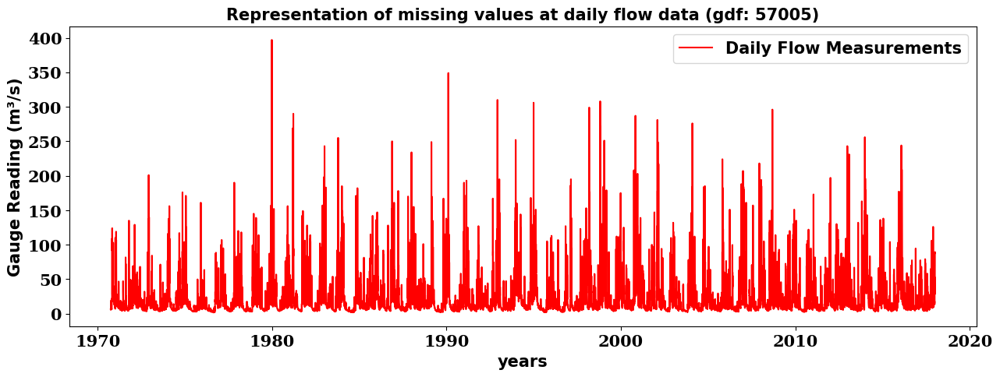

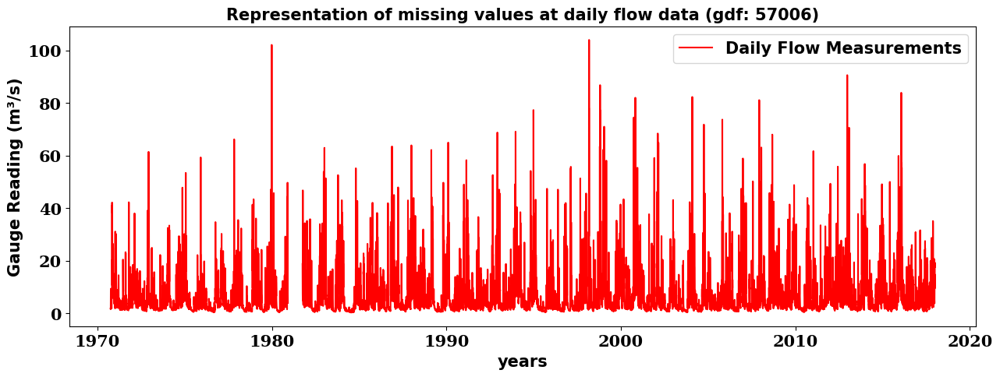

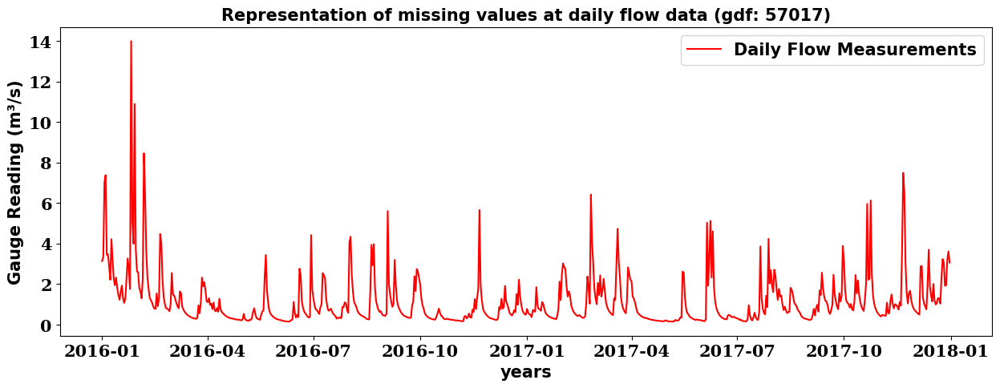

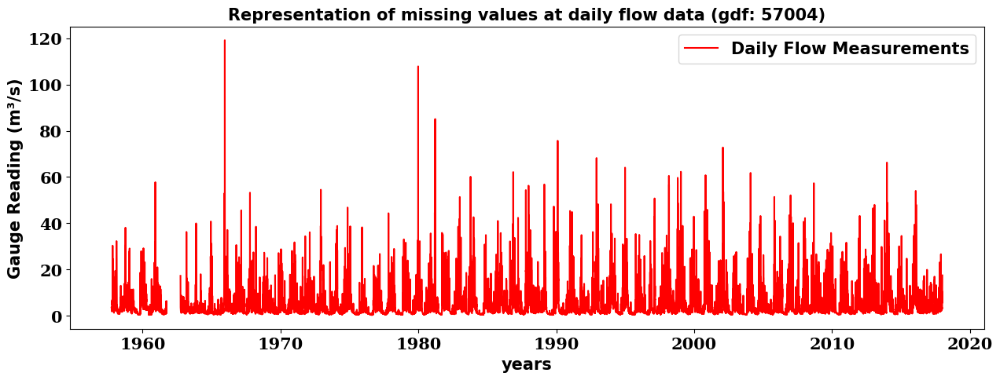

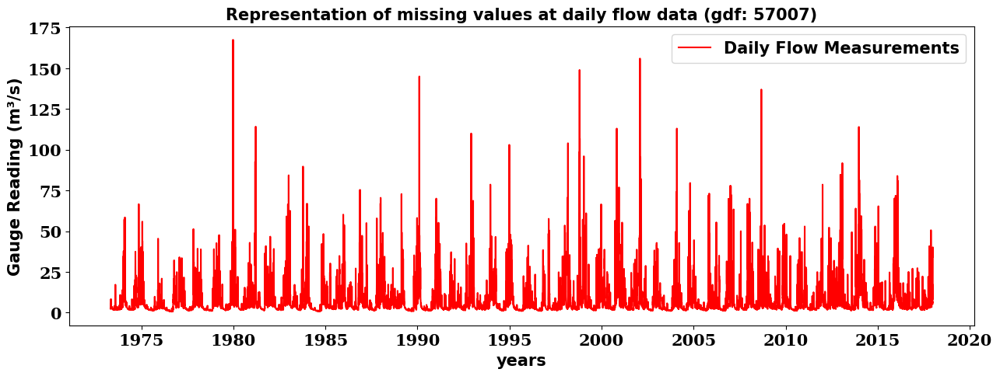

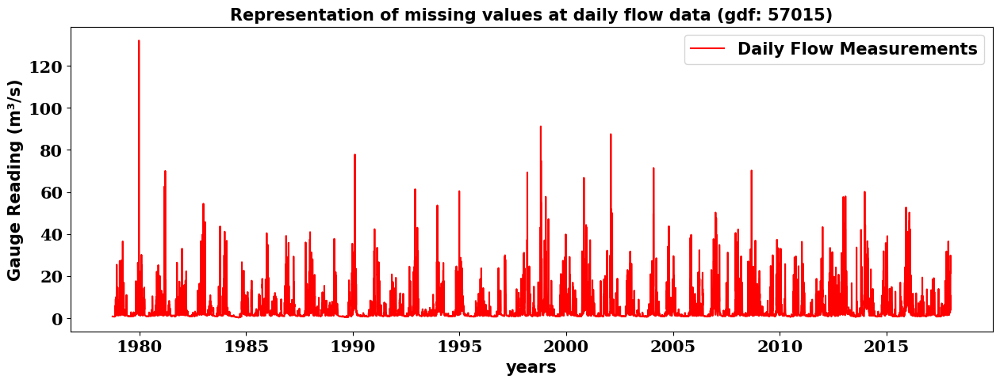

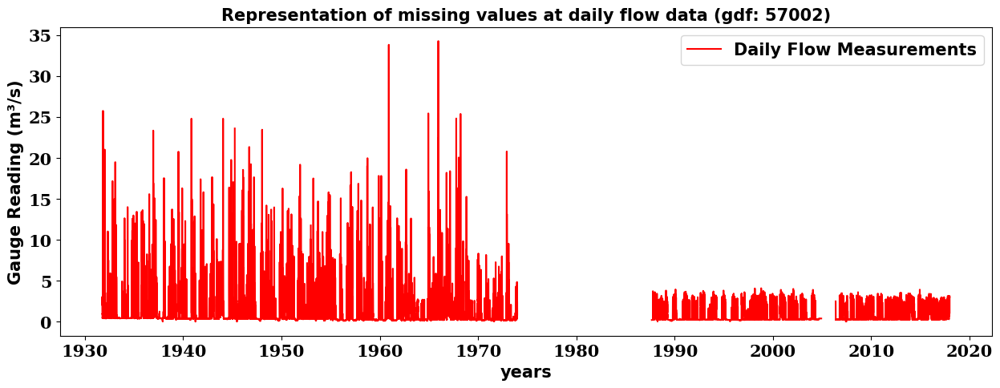

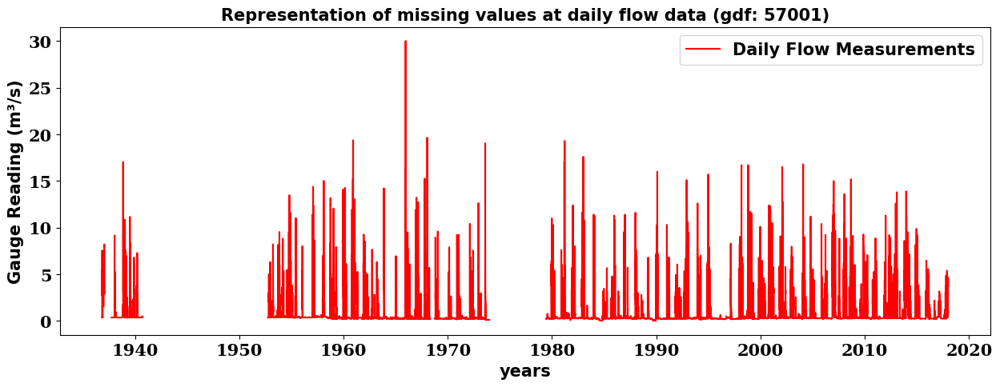

In [249]:
all_data_frame = [
    merged_df_57005,
    merged_df_57006,
    merged_df_57017,
    merged_df_57004,
    merged_df_57007,
    merged_df_57015,
    merged_df_57002,
    merged_df_57001
]

def graphical_inspection_missing_values(all_data_frame):
    for gauge in all_data_frame:
        plt.figure(figsize=(15, 5))
        plt.plot(
            gauge['date'],
            gauge['gdf'],
            label='Daily Flow Measurements',
            color='red')
        plt.title(
            f'Representation of missing values at daily flow data (gdf: {gauge["gauge"][0]})',
            fontsize = 15,
            fontweight='bold'
        )
        plt.xticks(
            fontsize=15,
            fontfamily='serif',
            fontweight='bold'
        )
        plt.yticks(
            fontsize=15,
            fontfamily='serif',
            fontweight='bold'
        )
        plt.gca().set_facecolor('white')
        plt.legend(fontsize=15)
        plt.xlabel('years', fontsize = 15, fontweight='bold')
        plt.ylabel('Gauge Reading (m³/s)', fontsize = 15, fontweight='bold')
        plt.legend(prop={'size': 15, 'weight': 'bold'})
        plt.show()
    
graphical_inspection_missing_values(all_data_frame)

### 3.2.2 Comparison of combined representation rainfall and daily flow to Understand recording gap of data for all gauges

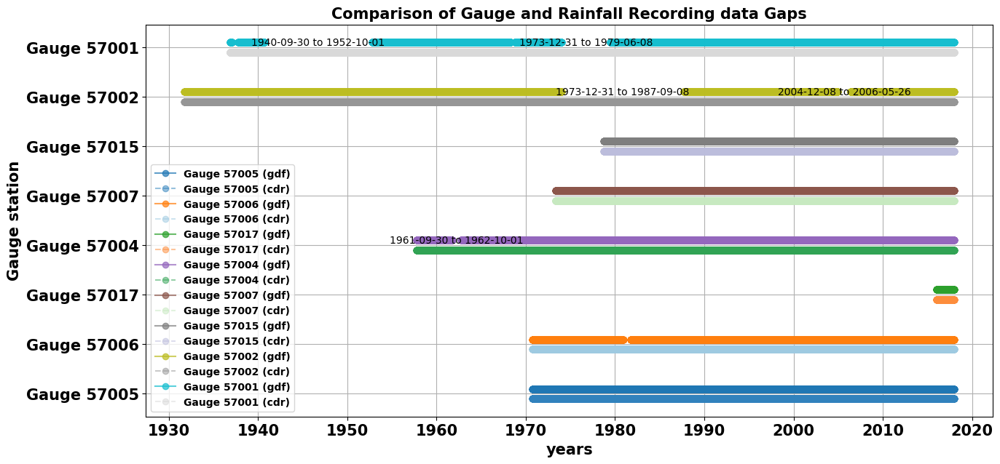

In [250]:
# Combine all data frames into one
combined_gauge_data = pd.concat(all_data_frame)

def plot_gdf_and_cdr_data_gaps(
    combined_gauge_df,
    date_column='date',
    value_column='gdf',
    rainfall_column='cdr',
    gauge_column='gauge'
):
    plt.figure(figsize=(15, 7))
    #date column is datetime
    combined_gauge_df[date_column] = pd.to_datetime(combined_gauge_df[date_column])
    
    # Identify unique gauges
    gauges = combined_gauge_df[gauge_column].unique()
    
    # Define a color map
    cmap = plt.get_cmap('tab10')
    colors = cmap(
        np.linspace(0, 1, len(gauges))
    )
    light_cmap = plt.get_cmap('tab20c')
    light_colors = light_cmap(
        np.linspace(0, 1, len(gauges))
    )

    # Create a plot for each gauge
    for i, gauge in enumerate(gauges):
        gauge_data = combined_gauge_df[combined_gauge_df[gauge_column] == gauge].copy()
        
        # Sort data by date
        gauge_data = gauge_data.sort_values(by=date_column)
        
        # Create segments where there are no missing values for gdf
        gdf_segments = []
        current_segment = []
        for j in range(len(gauge_data)):
            if not np.isnan(gauge_data.iloc[j][value_column]):
                current_segment.append((gauge_data.iloc[j][date_column], 2 * i + 0.2))  # Offset gdf line
            else:
                if current_segment:
                    gdf_segments.append(current_segment)
                    current_segment = []
        if current_segment:
            gdf_segments.append(current_segment)
        
        # Plot the segments for gdf with a unique color for each gauge
        for segment in gdf_segments:
            dates, y = zip(*segment)
            plt.plot(dates, y, 'o-', label=f'Gauge {gauge} (gdf)' if segment == gdf_segments[0] else "", color=colors[i], alpha=0.7)

        # Create segments where there are no missing values for cdr
        cdr_segments = []
        current_segment = []
        for j in range(len(gauge_data)):
            if not np.isnan(gauge_data.iloc[j][rainfall_column]):
                current_segment.append((gauge_data.iloc[j][date_column], 2 * i - 0.2))  # Offset cdr line
            else:
                if current_segment:
                    cdr_segments.append(current_segment)
                    current_segment = []
        if current_segment:
            cdr_segments.append(current_segment)

        # Plot the segments for cdr with a dashed line and the same color for each gauge
        for segment in cdr_segments:
            dates, y = zip(*segment)
            plt.plot(dates, y, 'o--', label=f'Gauge {gauge} (cdr)' if segment == cdr_segments[0] else "", color=light_colors[i], alpha=0.5)

        # Label long gaps in gdf data with start and end dates
        for j in range(1, len(gauge_data)):
            if np.isnan(gauge_data.iloc[j][value_column]) and not np.isnan(gauge_data.iloc[j-1][value_column]):
                start_date = gauge_data.iloc[j-1][date_column]
            if not np.isnan(gauge_data.iloc[j][value_column]) and np.isnan(gauge_data.iloc[j-1][value_column]):
                end_date = gauge_data.iloc[j][date_column]
                if (end_date - start_date).days > 365:  #threshold for 365
                    mid_date = start_date + (end_date - start_date) / 2
                    plt.text(
                        mid_date,
                        2 * i + 0.2,
                        f'{start_date.strftime("%Y-%m-%d")} to {end_date.strftime("%Y-%m-%d")}',
                        color='black',
                        ha='center',
                        va='center'
                    )

    plt.title(
        'Comparison of Gauge and Rainfall Recording data Gaps',
        fontsize = 15,
        fontweight='bold'
    )
    plt.xlabel(
        'years',
        fontsize = 15,
        fontweight='bold'
    )
    plt.ylabel(
        'Gauge station',
        fontsize = 15,
        fontweight='bold'
    )
    ytick_labels = []
    for gauge in gauges:
        ytick_labels.append(
            f'Gauge {gauge} (gdf)'
        )
        ytick_labels.append(
            f'Gauge {gauge} (cdr)'
        )
    plt.yticks(
        range(0, 2 * len(gauges), 2),
        [f'Gauge {g}' for g in gauges],
        fontsize = 15,
        fontweight='bold'
    )
    plt.xticks(
        fontsize = 15,
        fontweight='bold'
    )
    plt.legend(
        prop={'size': 10, 'weight': 'bold'}
    )
    plt.grid(True)
    plt.show()

plot_gdf_and_cdr_data_gaps(combined_gauge_data)

Note: With the observation of above graph comparsion between all gauges of daily flow and rainfall, we will used data from 26-05-2006 because there is long period missing data approx 1.5 year, So we will taken base of gauge : 57002 to arranged data of all gauge for further analysis

## 3.3 Arranging data from 2006-05-26 for all gauge by taken base of gdf 57002

In [251]:
df = pd.DataFrame()
start_date = '2006-05-26'
arranged_df_57005 = pd.DataFrame(merged_df_57005[merged_df_57005['date']>= start_date]).reset_index(drop=True)
arranged_df_57006 = pd.DataFrame(merged_df_57006[merged_df_57006['date']>= start_date]).reset_index(drop=True)
arranged_df_57004 = pd.DataFrame(merged_df_57004[merged_df_57004['date']>= start_date]).reset_index(drop=True)
arranged_df_57007 = pd.DataFrame(merged_df_57007[merged_df_57007['date']>= start_date]).reset_index(drop=True)
arranged_df_57015 = pd.DataFrame(merged_df_57015[merged_df_57015['date']>= start_date]).reset_index(drop=True)
arranged_df_57002 = pd.DataFrame(merged_df_57002[merged_df_57002['date']>= start_date]).reset_index(drop=True)
arranged_df_57001 = pd.DataFrame(merged_df_57001[merged_df_57001['date']>= start_date]).reset_index(drop=True)

print('-----------------------------------------------------------')
print('Arranged dataframe of gauge 57005')
print('-----------------------------------------------------------')
print(arranged_df_57005)
print('-----------------------------------------------------------')
print('Arranged dataframe of gauge 57006')
print('-----------------------------------------------------------')
print(arranged_df_57006)
print('-----------------------------------------------------------')
print('Arranged dataframe of gauge 57004')
print('-----------------------------------------------------------')
print(arranged_df_57004)
print('-----------------------------------------------------------')
print('Arranged dataframe of gauge 570057')
print('-----------------------------------------------------------')
print(arranged_df_57007)
print('-----------------------------------------------------------')
print('Arranged dataframe of gauge 57015')
print('-----------------------------------------------------------')
print(arranged_df_57015)
print('-----------------------------------------------------------')
print('Arranged dataframe of gauge 57002')
print('-----------------------------------------------------------')
print(arranged_df_57002)
print('-----------------------------------------------------------')
print('Arranged dataframe of gauge 57001')
print('-----------------------------------------------------------')
print(arranged_df_57001)

-----------------------------------------------------------
Arranged dataframe of gauge 57005
-----------------------------------------------------------
           date   cdr   gdf  gauge
0    2006-05-26   4.1  55.1  57005
1    2006-05-27   6.5  41.6  57005
2    2006-05-28   0.4  27.4  57005
3    2006-05-29   1.0  20.8  57005
4    2006-05-30   0.0  16.2  57005
...         ...   ...   ...    ...
4233 2017-12-27   1.5  34.5  57005
4234 2017-12-28  19.0  28.5  57005
4235 2017-12-29  10.5  73.4  57005
4236 2017-12-30  24.1  89.4  57005
4237 2017-12-31  13.3  87.7  57005

[4238 rows x 4 columns]
-----------------------------------------------------------
Arranged dataframe of gauge 57006
-----------------------------------------------------------
           date   cdr    gdf  gauge
0    2006-05-26   6.6  12.80  57006
1    2006-05-27   8.6  10.20  57006
2    2006-05-28   0.5   7.11  57006
3    2006-05-29   1.5   5.63  57006
4    2006-05-30   0.0   4.56  57006
...         ...   ...    ...   

In [252]:
print('----------------------------------------------------------')
bold('**checking missing value after Arrangind data with same date**')
print('----------------------------------------------------------')
df_list = [arranged_df_57005, arranged_df_57006, arranged_df_57004, arranged_df_57007, arranged_df_57015, arranged_df_57002, arranged_df_57001]
for i in df_list:
    bold('**gauge ' +str(i['gauge'][0])+'**')
    print(i.isna().sum())
    

----------------------------------------------------------


**checking missing value after Arrangind data with same date**

----------------------------------------------------------


**gauge 57005**

date     0
cdr      0
gdf      0
gauge    0
dtype: int64


**gauge 57006**

date     0
cdr      0
gdf      0
gauge    0
dtype: int64


**gauge 57004**

date     0
cdr      0
gdf      0
gauge    0
dtype: int64


**gauge 57007**

date     0
cdr      0
gdf      0
gauge    0
dtype: int64


**gauge 57015**

date     0
cdr      0
gdf      0
gauge    0
dtype: int64


**gauge 57002**

date     0
cdr      0
gdf      6
gauge    0
dtype: int64


**gauge 57001**

date     0
cdr      0
gdf      0
gauge    0
dtype: int64


### handling Missing value at gauge 57002 of gdf

<!-- #### After implementation of forward fill/ backward will followed by seasonal decomposition and interpolation to handle missing value of long range gap in the data of gauge 57002 which showing in above graphical representation have linearly filled range between 2004 to 2007, which is not adding any quality in data. Also After conducted investigation with NRFA's Team to know the reason of missing value, before 1950; missing value due to world war II and after 1979 if any long range data missing is due to reconstruction, for short range does not found any specific reason. Overall conclusion, better to remove those instances where value is missing.  -->

In [253]:
#Rest of value is handling by backward and forward fill
arranged_df_57002 = arranged_df_57002.fillna(method='ffill')

# Perform backward fill
arranged_df_57002 = arranged_df_57002.fillna(method='bfill')
bold('**After handling missing value by backward and forward fill method**')
print(arranged_df_57002.isna().sum())

**After handling missing value by backward and forward fill method**

date     0
cdr      0
gdf      0
gauge    0
dtype: int64


In [254]:
arranged_df_57002.reset_index(drop=True, inplace=True)
arranged_df_57002

,date,cdr,gdf,gauge
0,2006-05-26,3.5,2.480,57002
1,2006-05-27,6.4,2.370,57002
2,2006-05-28,0.5,1.110,57002
3,2006-05-29,1.3,0.591,57002
4,2006-05-30,0.0,0.358,57002
...,...,...,...,...
4233,2017-12-27,2.7,1.600,57002
4234,2017-12-28,18.2,0.986,57002
4235,2017-12-29,8.9,2.950,57002
4236,2017-12-30,25.5,3.140,57002


## 3.4 Monthly Average of daily data

In [255]:
arranged_df_list =  [arranged_df_57005, arranged_df_57006, arranged_df_57004, arranged_df_57007, arranged_df_57015, arranged_df_57002, arranged_df_57001]

for arng_gauge in arranged_df_list:
    if (arng_gauge['cdr'] < 0).any().any() or (arng_gauge['gdf'] < 0).any().any():
        print(f"cdr or gdf contains negative values in gauge : {arng_gauge['gauge'][0]}.")
    else:
        print(f"cdr or gdf does not contain negative values in gauge : {arng_gauge['gauge'][0]}.")

cdr or gdf does not contain negative values in gauge : 57005.
cdr or gdf does not contain negative values in gauge : 57006.
cdr or gdf does not contain negative values in gauge : 57004.
cdr or gdf does not contain negative values in gauge : 57007.
cdr or gdf does not contain negative values in gauge : 57015.
cdr or gdf does not contain negative values in gauge : 57002.
cdr or gdf does not contain negative values in gauge : 57001.


In [256]:
arranged_df_57001['date'] = pd.to_datetime(arranged_df_57001['date'])
# Set 'date' as the index
arranged_df_57001.set_index('date', inplace=True)
# Resample to monthly frequency and calculate the mean
monthly_avg_57001 = arranged_df_57001.resample('M').mean().reset_index()
#rename the 'date' column to 'month' for clarity
monthly_avg_57001.rename(columns={'date': 'month'}, inplace=True)
# Display the first few rows of the resulting DataFrame
print(monthly_avg_57001)

         month       cdr       gdf    gauge
0   2006-05-31  2.050000  1.377167  57001.0
1   2006-06-30  1.933333  0.266233  57001.0
2   2006-07-31  2.451613  0.270226  57001.0
3   2006-08-31  3.419355  0.289742  57001.0
4   2006-09-30  4.186667  0.275900  57001.0
..         ...       ...       ...      ...
135 2017-08-31  4.164516  0.283806  57001.0
136 2017-09-30  5.940000  0.573433  57001.0
137 2017-10-31  4.364516  0.862806  57001.0
138 2017-11-30  5.913333  0.880000  57001.0
139 2017-12-31  7.558065  1.191419  57001.0

[140 rows x 4 columns]


In [257]:
monthly_avg_57001['gauge'] = monthly_avg_57001['gauge'].astype(int)  # Convert gauge to integer
monthly_avg_57001['month'] = monthly_avg_57001['month'].dt.to_period('M').astype(str) # Format the 'month' column to year and month
bold('**Monthly average of gauge 57001**')
print(monthly_avg_57001)

**Monthly average of gauge 57001**

       month       cdr       gdf  gauge
0    2006-05  2.050000  1.377167  57001
1    2006-06  1.933333  0.266233  57001
2    2006-07  2.451613  0.270226  57001
3    2006-08  3.419355  0.289742  57001
4    2006-09  4.186667  0.275900  57001
..       ...       ...       ...    ...
135  2017-08  4.164516  0.283806  57001
136  2017-09  5.940000  0.573433  57001
137  2017-10  4.364516  0.862806  57001
138  2017-11  5.913333  0.880000  57001
139  2017-12  7.558065  1.191419  57001

[140 rows x 4 columns]


In [258]:
arranged_df_57002['date'] = pd.to_datetime(arranged_df_57002['date'])

# Set 'date' as the index
arranged_df_57002.set_index('date', inplace=True)

# Resample to monthly frequency and calculate the mean
monthly_avg_57002 = arranged_df_57002.resample('M').mean().reset_index()

#rename the 'date' column to 'month' for clarity
monthly_avg_57002.rename(columns={'date': 'month'}, inplace=True)

# Display the first few rows of the resulting DataFrame
print(monthly_avg_57002)

         month       cdr       gdf    gauge
0   2006-05-31  1.950000  1.191833  57002.0
1   2006-06-30  1.693333  0.230233  57002.0
2   2006-07-31  2.403226  0.245387  57002.0
3   2006-08-31  3.416129  0.247387  57002.0
4   2006-09-30  4.340000  0.238267  57002.0
..         ...       ...       ...      ...
135 2017-08-31  4.809677  1.040161  57002.0
136 2017-09-30  6.656667  0.878567  57002.0
137 2017-10-31  4.503226  1.152290  57002.0
138 2017-11-30  5.800000  1.131900  57002.0
139 2017-12-31  7.396774  1.508097  57002.0

[140 rows x 4 columns]


In [259]:

monthly_avg_57002['gauge'] = monthly_avg_57002['gauge'].astype(int)  # Convert gauge to integer
monthly_avg_57002['month'] = monthly_avg_57002['month'].dt.to_period('M').astype(str) # Format the 'month' column to year and month
bold('**Monthly average of gauge 57002**')
print(monthly_avg_57002)

**Monthly average of gauge 57002**

       month       cdr       gdf  gauge
0    2006-05  1.950000  1.191833  57002
1    2006-06  1.693333  0.230233  57002
2    2006-07  2.403226  0.245387  57002
3    2006-08  3.416129  0.247387  57002
4    2006-09  4.340000  0.238267  57002
..       ...       ...       ...    ...
135  2017-08  4.809677  1.040161  57002
136  2017-09  6.656667  0.878567  57002
137  2017-10  4.503226  1.152290  57002
138  2017-11  5.800000  1.131900  57002
139  2017-12  7.396774  1.508097  57002

[140 rows x 4 columns]


In [260]:
arranged_df_57015['date'] = pd.to_datetime(arranged_df_57015['date'])

# Set 'date' as the index
arranged_df_57015.set_index('date', inplace=True)

# Resample to monthly frequency and calculate the mean
monthly_avg_57015 = arranged_df_57015.resample('M').mean().reset_index()

# Rename the 'date' column to 'month' for clarity
monthly_avg_57015.rename(columns={'date': 'month'}, inplace=True)

# Display the first few rows of the resulting DataFrame
print(monthly_avg_57015)

         month       cdr       gdf    gauge
0   2006-05-31  1.900000  5.283333  57015.0
1   2006-06-30  1.656667  1.017333  57015.0
2   2006-07-31  2.280645  0.781323  57015.0
3   2006-08-31  3.351613  0.812097  57015.0
4   2006-09-30  3.960000  0.907000  57015.0
..         ...       ...       ...      ...
135 2017-08-31  4.329032  2.781935  57015.0
136 2017-09-30  6.140000  3.162667  57015.0
137 2017-10-31  4.187097  5.090645  57015.0
138 2017-11-30  5.616667  5.484333  57015.0
139 2017-12-31  7.125806  7.118387  57015.0

[140 rows x 4 columns]


In [261]:
monthly_avg_57015['gauge'] = monthly_avg_57015['gauge'].astype(int)  # Convert gauge to integer
monthly_avg_57015['month'] = monthly_avg_57015['month'].dt.to_period('M').astype(str) # Format the 'month' column to year and month
bold('**Monthly average of gauge 57015**')
print(monthly_avg_57015)

**Monthly average of gauge 57015**

       month       cdr       gdf  gauge
0    2006-05  1.900000  5.283333  57015
1    2006-06  1.656667  1.017333  57015
2    2006-07  2.280645  0.781323  57015
3    2006-08  3.351613  0.812097  57015
4    2006-09  3.960000  0.907000  57015
..       ...       ...       ...    ...
135  2017-08  4.329032  2.781935  57015
136  2017-09  6.140000  3.162667  57015
137  2017-10  4.187097  5.090645  57015
138  2017-11  5.616667  5.484333  57015
139  2017-12  7.125806  7.118387  57015

[140 rows x 4 columns]


In [262]:
arranged_df_57007['date'] = pd.to_datetime(arranged_df_57007['date'])

# Set 'date' as the index
arranged_df_57007.set_index('date', inplace=True)

# Resample to monthly frequency and calculate the mean
monthly_avg_57007 = arranged_df_57007.resample('M').mean().reset_index()

# Rename the 'date' column to 'month' for clarity
monthly_avg_57007.rename(columns={'date': 'month'}, inplace=True)

# Display the first few rows of the resulting DataFrame
print(monthly_avg_57007)

         month       cdr        gdf    gauge
0   2006-05-31  1.666667  10.610000  57007.0
1   2006-06-30  1.613333   2.454667  57007.0
2   2006-07-31  2.229032   1.567742  57007.0
3   2006-08-31  3.000000   1.546129  57007.0
4   2006-09-30  3.580000   1.689667  57007.0
..         ...       ...        ...      ...
135 2017-08-31  3.764516   4.837097  57007.0
136 2017-09-30  5.543333   5.007000  57007.0
137 2017-10-31  3.967742   8.074194  57007.0
138 2017-11-30  5.036667   8.747667  57007.0
139 2017-12-31  6.732258  11.655161  57007.0

[140 rows x 4 columns]


In [263]:
monthly_avg_57007['gauge'] = monthly_avg_57007['gauge'].astype(int)  # Convert gauge to integer
monthly_avg_57007['month'] = monthly_avg_57007['month'].dt.to_period('M').astype(str) # Format the 'month' column to year and month
bold('**Monthly average of gauge 57007**')
print(monthly_avg_57007)

**Monthly average of gauge 57007**

       month       cdr        gdf  gauge
0    2006-05  1.666667  10.610000  57007
1    2006-06  1.613333   2.454667  57007
2    2006-07  2.229032   1.567742  57007
3    2006-08  3.000000   1.546129  57007
4    2006-09  3.580000   1.689667  57007
..       ...       ...        ...    ...
135  2017-08  3.764516   4.837097  57007
136  2017-09  5.543333   5.007000  57007
137  2017-10  3.967742   8.074194  57007
138  2017-11  5.036667   8.747667  57007
139  2017-12  6.732258  11.655161  57007

[140 rows x 4 columns]


In [264]:
arranged_df_57004['date'] = pd.to_datetime(arranged_df_57004['date'])

# Set 'date' as the index
arranged_df_57004.set_index('date', inplace=True)

# Resample to monthly frequency and calculate the mean
monthly_avg_57004 = arranged_df_57004.resample('M').mean().reset_index()

# Rename the 'date' column to 'month' for clarity
monthly_avg_57004.rename(columns={'date': 'month'}, inplace=True)

# Display the first few rows of the resulting DataFrame
print(monthly_avg_57004)

         month       cdr       gdf    gauge
0   2006-05-31  1.750000  5.744000  57004.0
1   2006-06-30  1.596667  1.313000  57004.0
2   2006-07-31  2.506452  0.802065  57004.0
3   2006-08-31  2.854839  0.782161  57004.0
4   2006-09-30  3.720000  1.099000  57004.0
..         ...       ...       ...      ...
135 2017-08-31  3.941935  3.032903  57004.0
136 2017-09-30  6.013333  2.960333  57004.0
137 2017-10-31  4.429032  4.430129  57004.0
138 2017-11-30  5.356667  4.889700  57004.0
139 2017-12-31  7.138710  6.576065  57004.0

[140 rows x 4 columns]


In [265]:
monthly_avg_57004['gauge'] = monthly_avg_57004['gauge'].astype(int)  # Convert gauge to integer
monthly_avg_57004['month'] = monthly_avg_57004['month'].dt.to_period('M').astype(str) # Format the 'month' column to year and month
bold('**Monthly average of gauge 57004**')
print(monthly_avg_57004)

**Monthly average of gauge 57004**

       month       cdr       gdf  gauge
0    2006-05  1.750000  5.744000  57004
1    2006-06  1.596667  1.313000  57004
2    2006-07  2.506452  0.802065  57004
3    2006-08  2.854839  0.782161  57004
4    2006-09  3.720000  1.099000  57004
..       ...       ...       ...    ...
135  2017-08  3.941935  3.032903  57004
136  2017-09  6.013333  2.960333  57004
137  2017-10  4.429032  4.430129  57004
138  2017-11  5.356667  4.889700  57004
139  2017-12  7.138710  6.576065  57004

[140 rows x 4 columns]


In [266]:
arranged_df_57006['date'] = pd.to_datetime(arranged_df_57006['date'])

# Set 'date' as the index
arranged_df_57006.set_index('date', inplace=True)

# Resample to monthly frequency and calculate the mean
monthly_avg_57006 = arranged_df_57006.resample('M').mean().reset_index()

# Rename the 'date' column to 'month' for clarity
monthly_avg_57006.rename(columns={'date': 'month'}, inplace=True)

# Display the first few rows of the resulting DataFrame
print(monthly_avg_57006)

         month       cdr       gdf    gauge
0   2006-05-31  2.866667  7.330000  57006.0
1   2006-06-30  1.896667  1.556567  57006.0
2   2006-07-31  3.312903  1.432581  57006.0
3   2006-08-31  2.741935  0.971903  57006.0
4   2006-09-30  4.286667  1.538967  57006.0
..         ...       ...       ...      ...
135 2017-08-31  4.961290  5.026452  57006.0
136 2017-09-30  7.696667  5.152667  57006.0
137 2017-10-31  6.135484  7.902581  57006.0
138 2017-11-30  7.016667  7.116333  57006.0
139 2017-12-31  8.419355  8.462258  57006.0

[140 rows x 4 columns]


In [267]:
monthly_avg_57006['gauge'] = monthly_avg_57006['gauge'].astype(int)  # Convert gauge to integer
monthly_avg_57006['month'] = monthly_avg_57006['month'].dt.to_period('M').astype(str) # Format the 'month' column to year and month
bold('**Monthly average of gauge 57006**')
print(monthly_avg_57006)

**Monthly average of gauge 57006**

       month       cdr       gdf  gauge
0    2006-05  2.866667  7.330000  57006
1    2006-06  1.896667  1.556567  57006
2    2006-07  3.312903  1.432581  57006
3    2006-08  2.741935  0.971903  57006
4    2006-09  4.286667  1.538967  57006
..       ...       ...       ...    ...
135  2017-08  4.961290  5.026452  57006
136  2017-09  7.696667  5.152667  57006
137  2017-10  6.135484  7.902581  57006
138  2017-11  7.016667  7.116333  57006
139  2017-12  8.419355  8.462258  57006

[140 rows x 4 columns]


In [268]:
arranged_df_57005['date'] = pd.to_datetime(arranged_df_57005['date'])

# Set 'date' as the index
arranged_df_57005.set_index('date', inplace=True)

# Resample to monthly frequency and calculate the mean
monthly_avg_57005 = arranged_df_57005.resample('M').mean().reset_index()

# Rename the 'date' column to 'month' for clarity
monthly_avg_57005.rename(columns={'date': 'month'}, inplace=True)

# Display the first few rows of the resulting DataFrame
print(monthly_avg_57005)

         month       cdr        gdf    gauge
0   2006-05-31  2.000000  29.083333  57005.0
1   2006-06-30  1.686667   6.809000  57005.0
2   2006-07-31  2.606452   4.746774  57005.0
3   2006-08-31  2.825806   3.950968  57005.0
4   2006-09-30  3.726667   5.075000  57005.0
..         ...       ...        ...      ...
135 2017-08-31  4.035484  14.499355  57005.0
136 2017-09-30  6.130000  14.900333  57005.0
137 2017-10-31  4.593548  24.262581  57005.0
138 2017-11-30  5.526667  24.520333  57005.0
139 2017-12-31  7.206452  32.840000  57005.0

[140 rows x 4 columns]


In [269]:
monthly_avg_57005['gauge'] = monthly_avg_57005['gauge'].astype(int)  # Convert gauge to integer
monthly_avg_57005['month'] = monthly_avg_57005['month'].dt.to_period('M').astype(str) # Format the 'month' column to year and month
bold('**Monthly average of gauge 57005**')
print(monthly_avg_57005)

**Monthly average of gauge 57005**

       month       cdr        gdf  gauge
0    2006-05  2.000000  29.083333  57005
1    2006-06  1.686667   6.809000  57005
2    2006-07  2.606452   4.746774  57005
3    2006-08  2.825806   3.950968  57005
4    2006-09  3.726667   5.075000  57005
..       ...       ...        ...    ...
135  2017-08  4.035484  14.499355  57005
136  2017-09  6.130000  14.900333  57005
137  2017-10  4.593548  24.262581  57005
138  2017-11  5.526667  24.520333  57005
139  2017-12  7.206452  32.840000  57005

[140 rows x 4 columns]


## 3.5 Outlier Checking

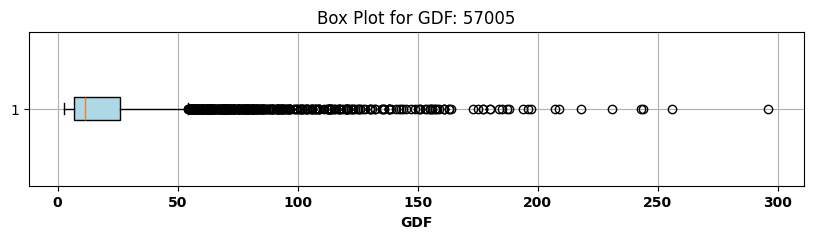

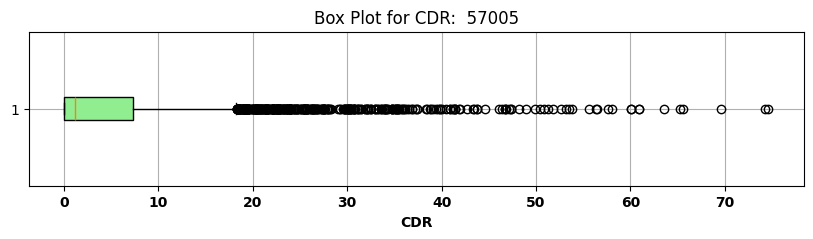

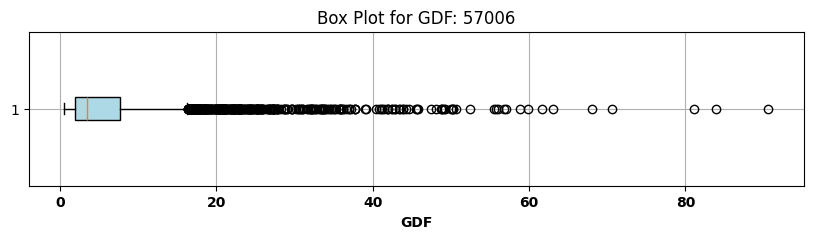

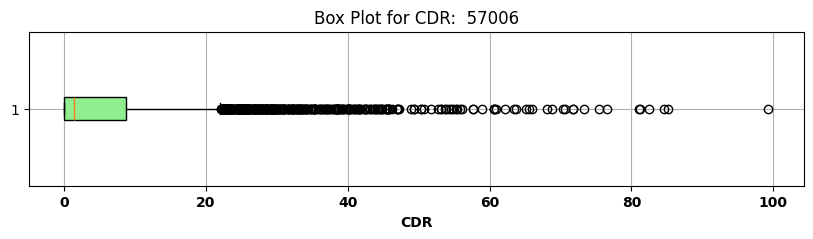

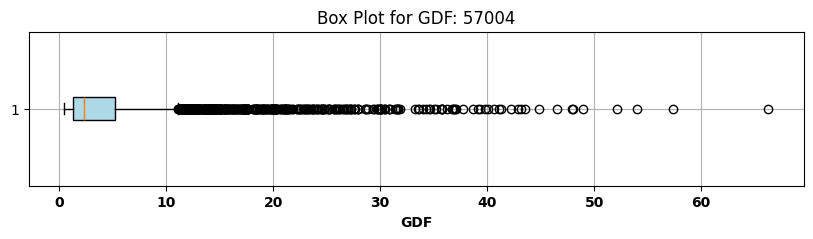

...

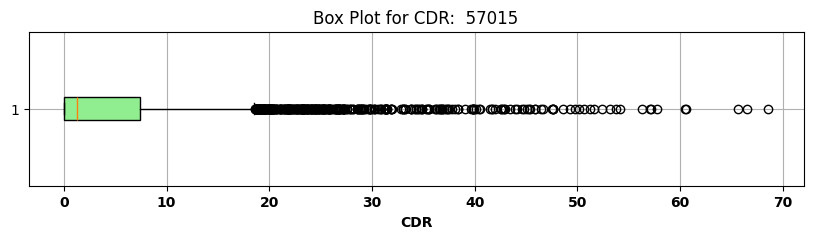

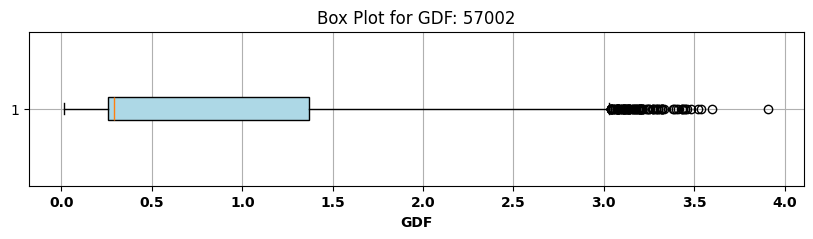

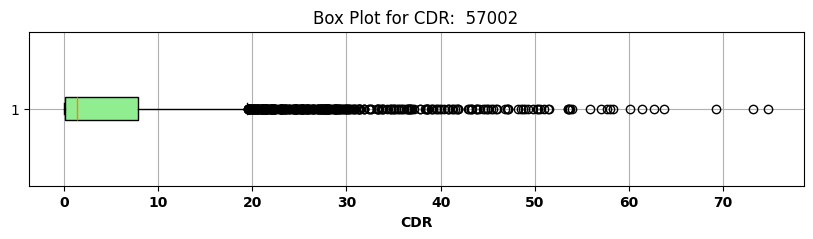

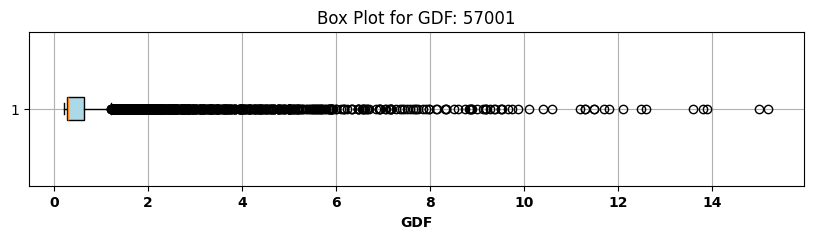

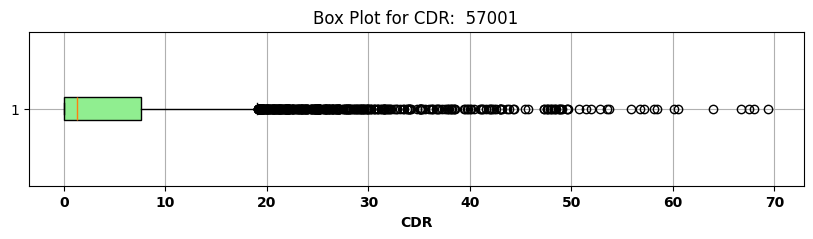

In [270]:
def box_plot_daily_data(arranged_df_list):
    for gauge in arranged_df_list:
        # Box plot for gdf
        plt.figure(figsize=(10, 2))
        plt.boxplot(
            gauge['gdf'].dropna(),
            vert=False,
            patch_artist=True,
            boxprops=dict(facecolor="lightblue")
        )
        plt.title(f"Box Plot for GDF: {gauge['gauge'][0]}")
        plt.xlabel('GDF', fontsize='10', fontweight = 'bold')
        plt.xticks(fontsize='10', fontweight = 'bold')
        plt.grid(True)
        plt.show()
        
        # Box plot for cdr
        plt.figure(figsize=(10, 2))
        plt.boxplot(
            gauge['cdr'].dropna(),
            vert=False,
            patch_artist=True,
            boxprops=dict(facecolor="lightgreen")
        )
        plt.title(f"Box Plot for CDR:  {gauge['gauge'][0]}")
        plt.xlabel('CDR', fontsize='10', fontweight = 'bold')
        plt.xticks(fontsize='10', fontweight = 'bold')
        plt.grid(True)
        plt.show()
box_plot_daily_data(arranged_df_list)

Note After investigating outlier by plotting box in above representation, it seem outlier exist, those points outside whiskers are considered outliers.
 1. Extreme value of rainfall(cdr) can be natural phenomena.
 2. Higher rainfall are common event may not be outlier. For rainfall event need to investigate to check at particular season or trend.
 3. Due to Higher rainfall flow can be higher need to investigate further before handle all these point outside the whisker.
 4. also box plot showing it right skewed


# 4. Data Exploration

In [271]:
from functools import reduce

# Define DataFrames
dfs = [
    arranged_df_57015,
    arranged_df_57002,
    arranged_df_57006,
    arranged_df_57007,
    arranged_df_57004,
    arranged_df_57005,
    arranged_df_57001
]

# Define the gauge numbers
gauges = ['57015', '57002', '57006', '57007', '57004', '57005', '57001']

# Process each DataFrame
for df, gauge in zip(dfs, gauges):
    df.rename(
        columns={'cdr': f'cdr_{gauge}','gdf': f'gdf_{gauge}'},
        inplace=True
    )
    df.drop(
        columns=['gauge'],
        inplace=True
    )

# Combine all data frames into one using reduce to merge them iteratively on 'date'
merge_allfilter_df = reduce(lambda left, right: pd.merge(left, right, on='date', how='inner'), dfs)


In [272]:
merge_allfilter_df

,cdr_57015,gdf_57015,cdr_57002,gdf_57002,cdr_57006,gdf_57006,cdr_57007,gdf_57007,cdr_57004,gdf_57004,cdr_57005,gdf_57005,cdr_57001,gdf_57001
date,,,,,,,,,,,,,,
2006-05-26,3.3,11.80,3.5,2.480,6.6,12.80,2.9,20.10,3.1,11.590,4.1,55.1,3.5,2.970
2006-05-27,6.5,8.62,6.4,2.370,8.6,10.20,5.9,15.60,5.9,7.969,6.5,41.6,7.0,2.400
2006-05-28,0.5,4.54,0.5,1.110,0.5,7.11,0.4,9.87,0.4,5.069,0.4,27.4,0.7,1.340
2006-05-29,1.1,2.99,1.3,0.591,1.5,5.63,0.8,7.32,1.1,3.902,1.0,20.8,1.1,0.762
2006-05-30,0.0,2.13,0.0,0.358,0.0,4.56,0.0,5.89,0.0,3.200,0.0,16.2,0.0,0.483
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-12-27,2.2,5.79,2.7,1.600,1.3,9.38,1.7,11.00,1.4,6.390,1.5,34.5,2.2,1.170
2017-12-28,18.2,3.77,18.2,0.986,22.3,9.57,17.5,8.28,19.7,5.518,19.0,28.5,19.4,0.634
2017-12-29,8.4,17.40,8.9,2.950,13.3,19.30,8.7,24.40,10.2,14.560,10.5,73.4,8.3,2.700


In [273]:
print('-----------------------------------------------------------')
print('no missing value after merge all dataframe in single dataframe')
print('-----------------------------------------------------------')
print(merge_allfilter_df.isna().sum())


-----------------------------------------------------------
no missing value after merge all dataframe in single dataframe
-----------------------------------------------------------
cdr_57015    0
gdf_57015    0
cdr_57002    0
gdf_57002    0
cdr_57006    0
gdf_57006    0
cdr_57007    0
gdf_57007    0
cdr_57004    0
gdf_57004    0
cdr_57005    0
gdf_57005    0
cdr_57001    0
gdf_57001    0
dtype: int64


## 4.1 Relation of daily flow  and daily rainfall at gauges 

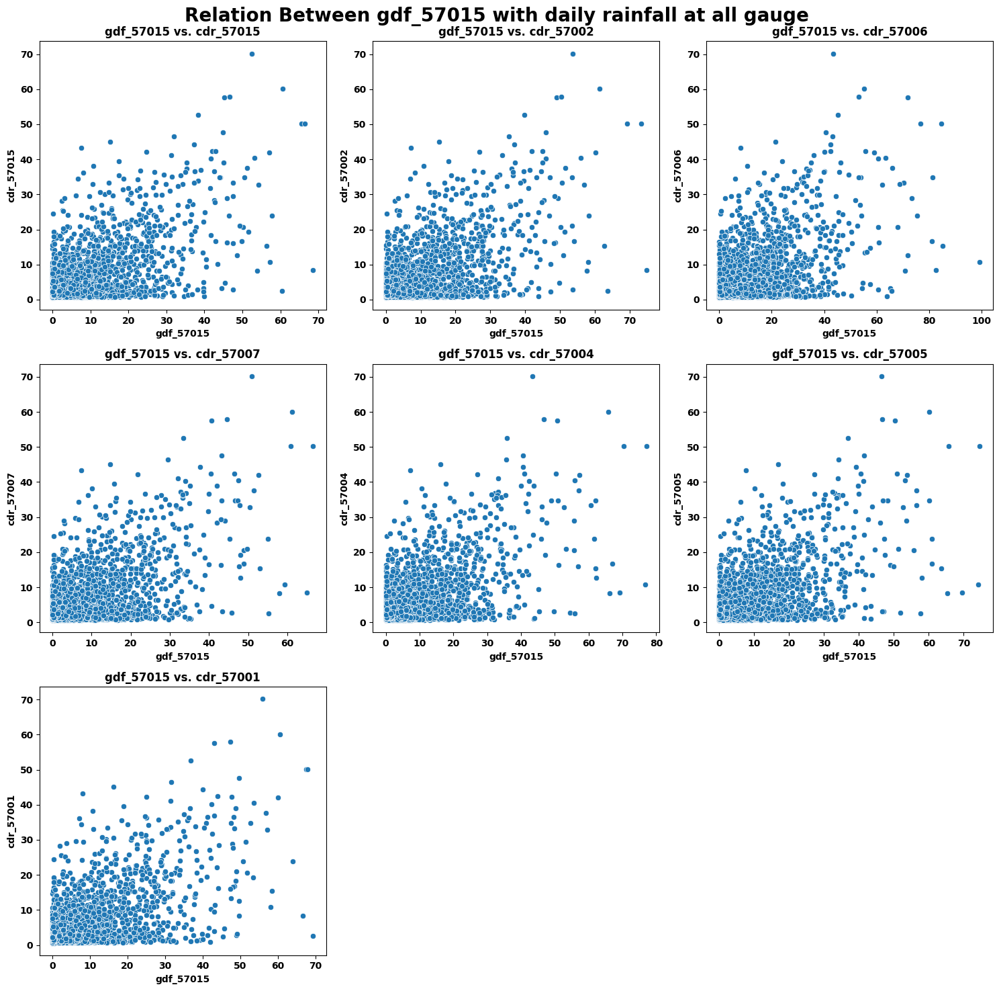

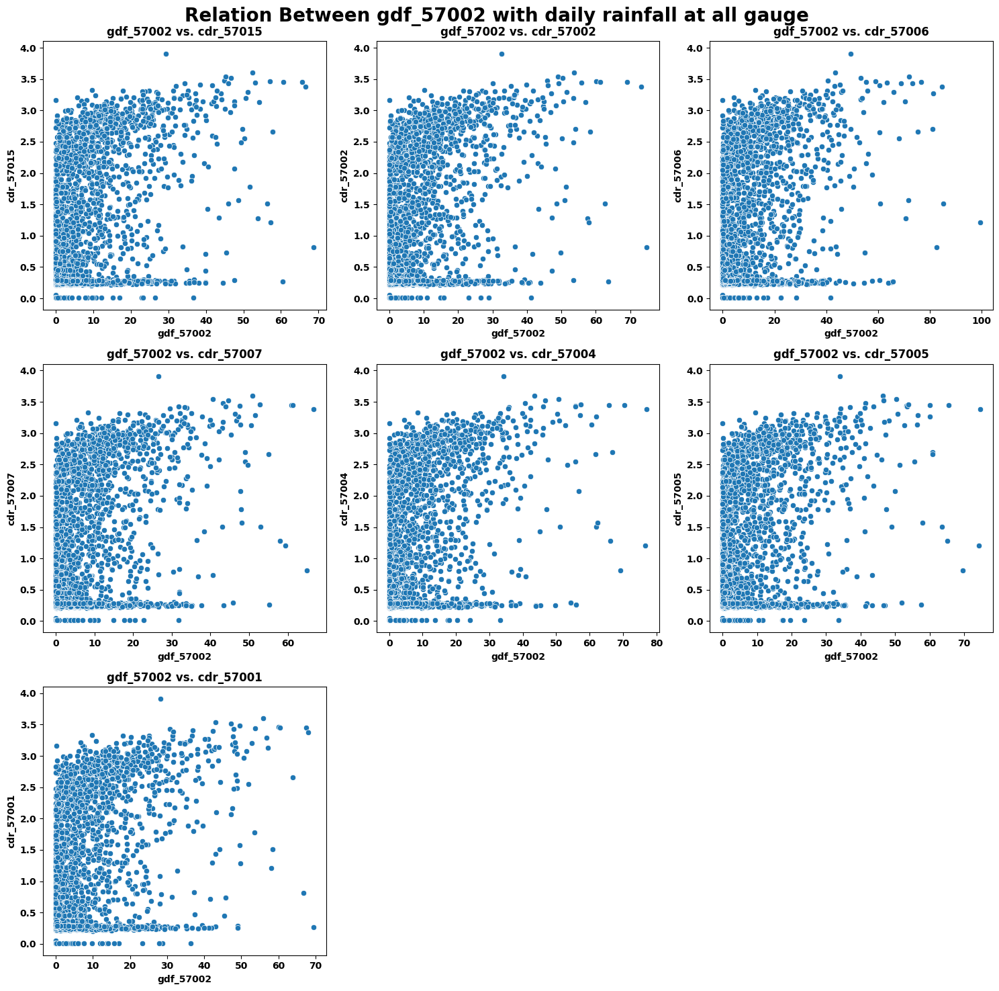

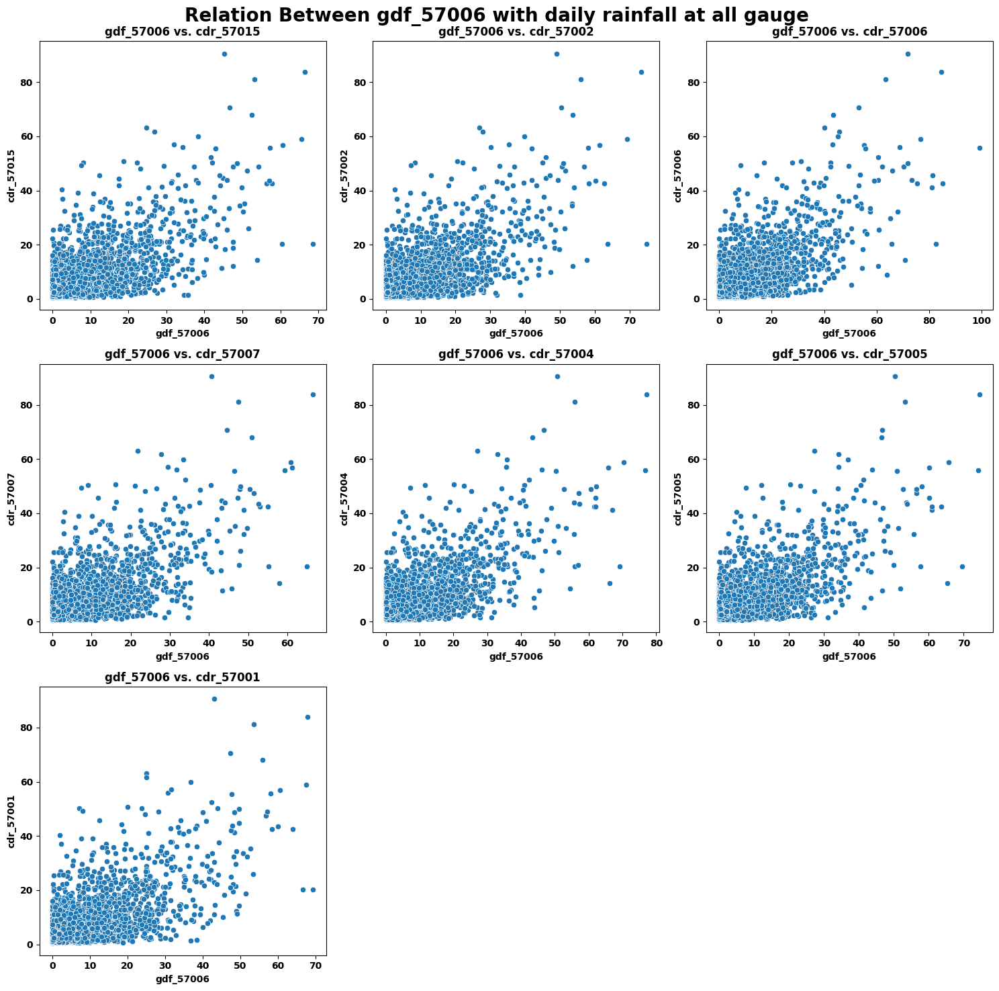

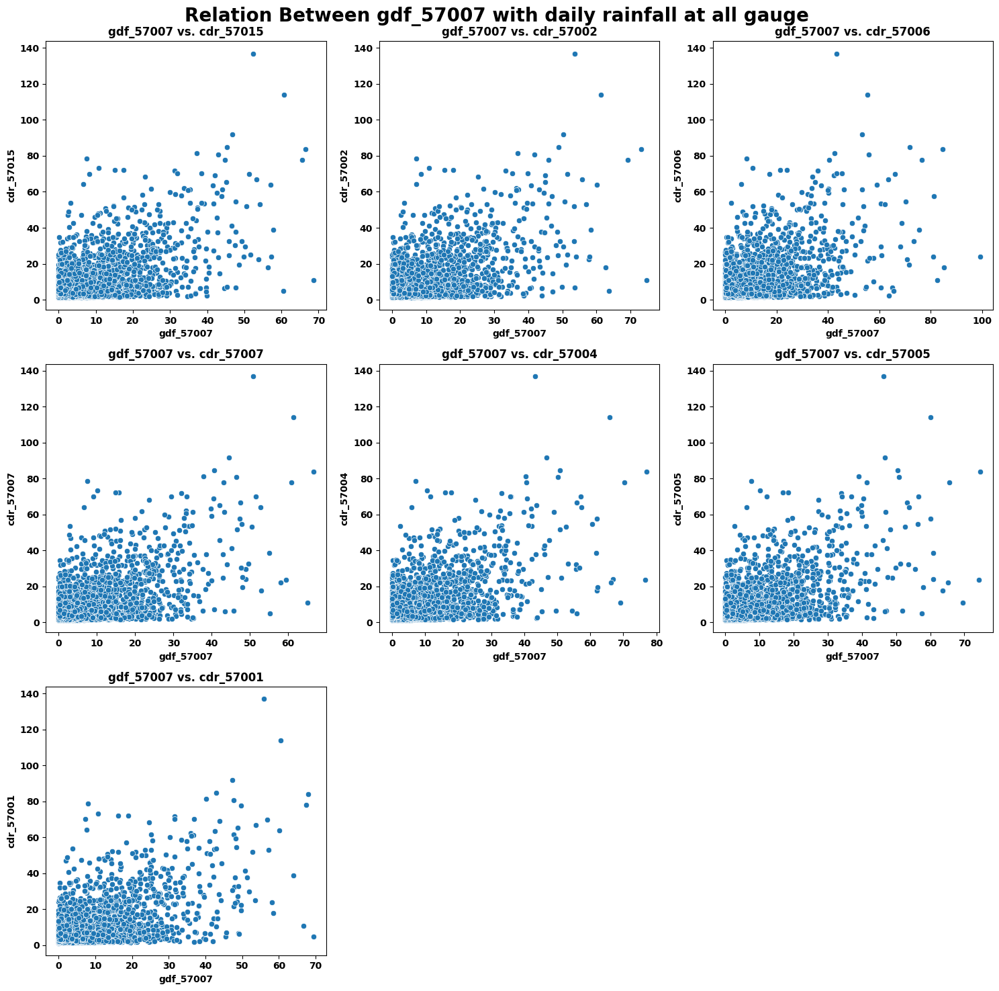

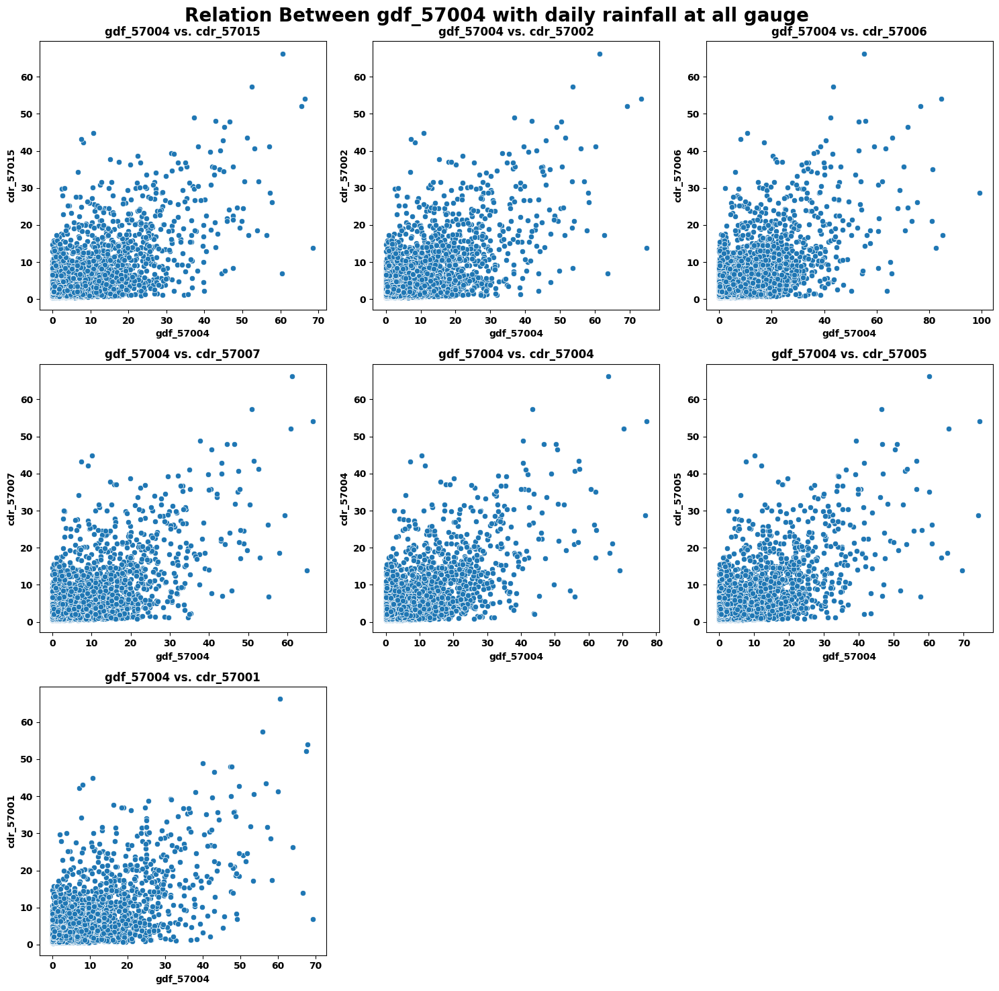

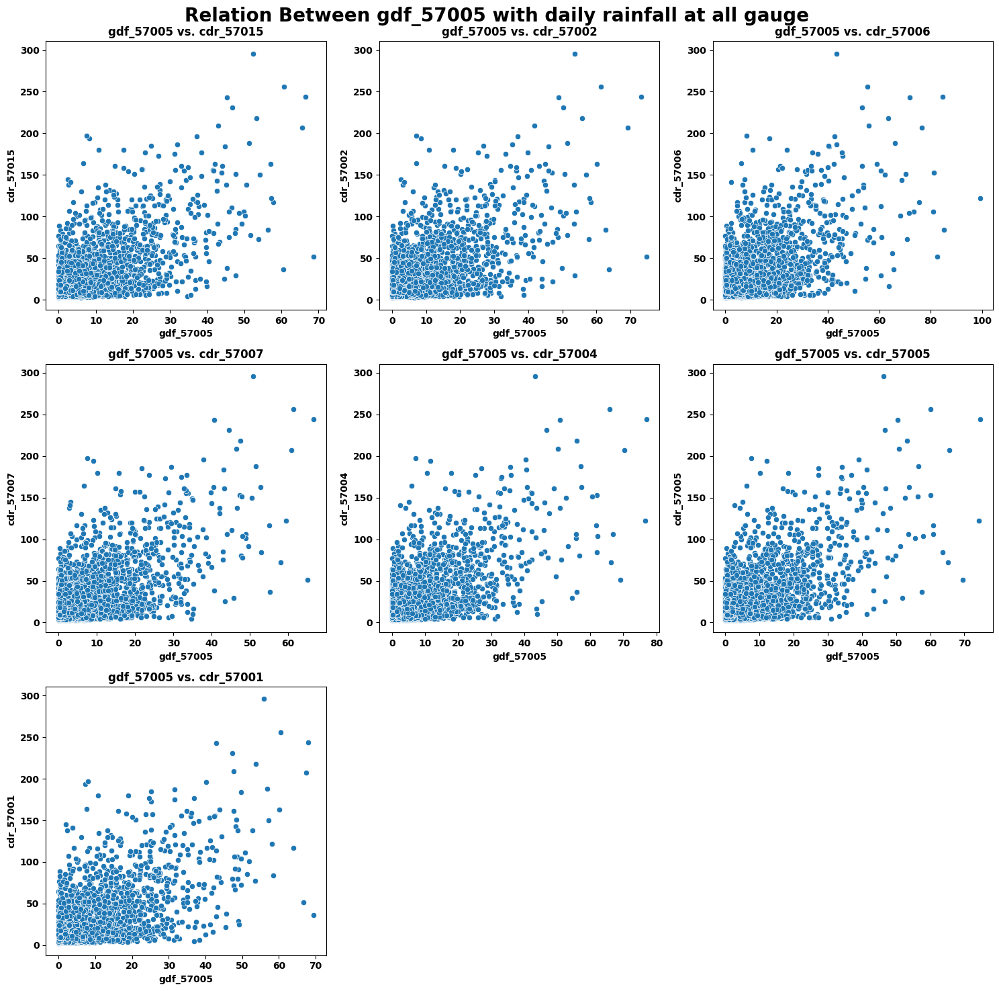

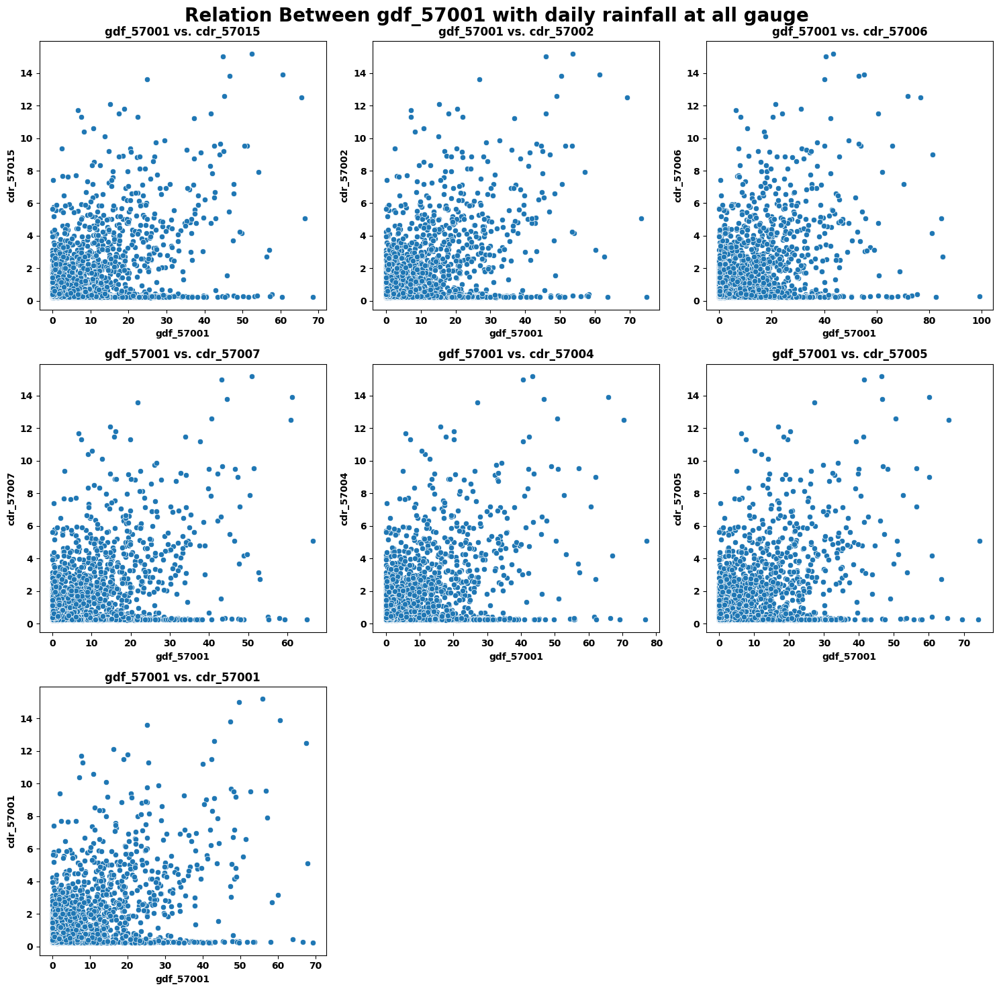

In [274]:
def relation_cdr_gdf_daily_data(merge_allfilter_df):
    #merge_allfilter_df is already loaded
    flow_columns = [col for col in merge_allfilter_df.columns if col.startswith('gdf_')]
    rainfall_columns = [col for col in merge_allfilter_df.columns if col.startswith('cdr_')]
    
    # Loop over each gdf column (flow_columns) to create separate figures
    for flow_col in flow_columns:
        # Define the number of columns for the subplot grid
        ncols = 3  # Two plots per row
        nrows = int(len(rainfall_columns) / ncols) + (len(rainfall_columns) % ncols > 0)
        
        # Creating a new figure for each gdf column
        fig, axes = plt.subplots(
            nrows=nrows,
            ncols=ncols,
            figsize=(5 * ncols, 5 * nrows)
        )
        
        # Flatten the axes array for easy iteration
        axes = axes.flatten()
        
        # Plot each cdr column against the current gdf column
        for j, rain_col in enumerate(rainfall_columns):
            sns.scatterplot(x=merge_allfilter_df[rain_col], y=merge_allfilter_df[flow_col], ax=axes[j])
            axes[j].set_title(f'{flow_col} vs. {rain_col}', fontsize=12, fontweight='bold')
            axes[j].set_xlabel(flow_col, fontsize=10, fontweight='bold')
            axes[j].set_ylabel(rain_col, fontsize=10, fontweight='bold')
            axes[j].tick_params(axis='x')  # Rotate x-axis labels for better readability
            plt.setp(axes[j].get_xticklabels(), fontweight='bold')
            plt.setp(axes[j].get_yticklabels(), fontweight='bold')
        for k in range(len(rainfall_columns), len(axes)):
            fig.delaxes(axes[k])
        plt.suptitle(
            f"Relation Between {flow_col} with daily rainfall at all gauge ",
            fontsize=20, fontweight='bold'
        )
        plt.tight_layout()
        plt.show()
relation_cdr_gdf_daily_data(merge_allfilter_df)

## 4.2 Relation of daily flow at all gauges

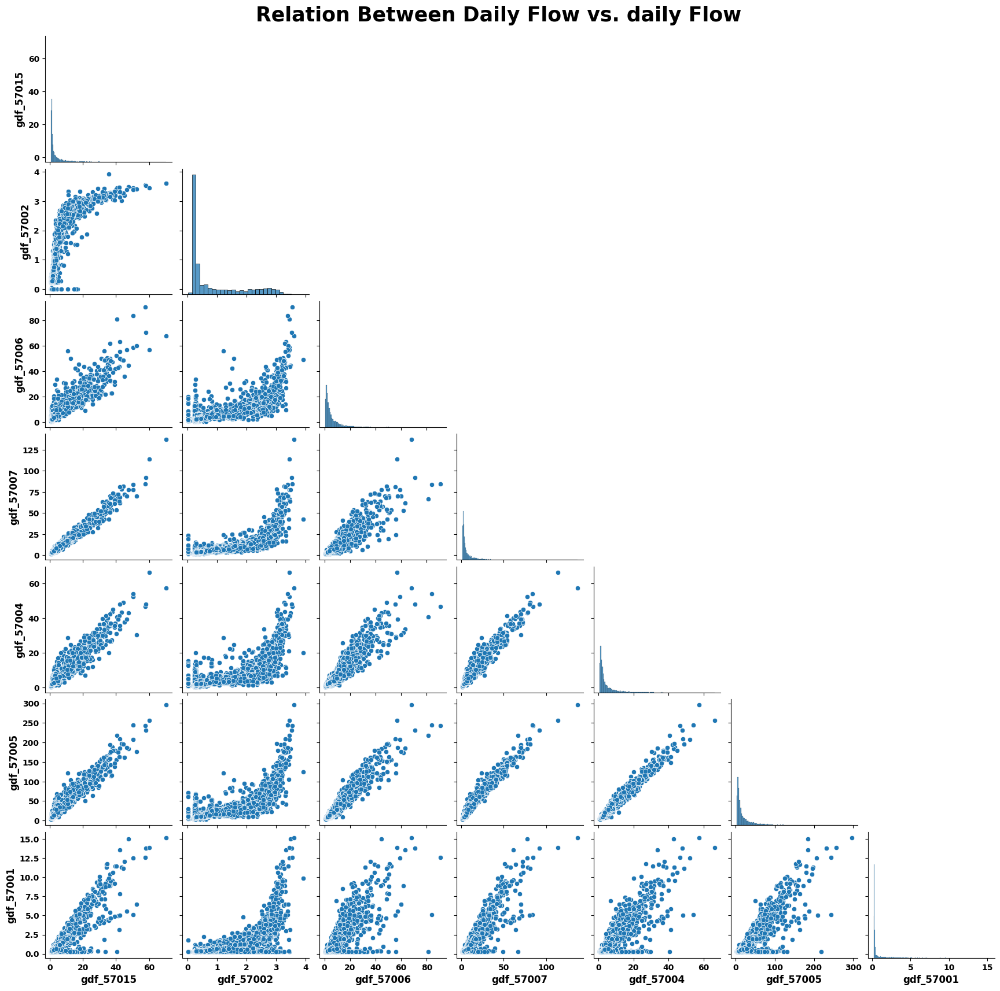

In [275]:

def relationship_daily_data_flow_vs_flow(merge_allfilter_df):
    # Extract flow columns
    gdf_columns = [col for col in merge_allfilter_df.columns if col.startswith('gdf_')]
    flow_df = merge_allfilter_df[gdf_columns]
    
    # Create a pairplot
    g = sns.pairplot(flow_df)
    
    # Removed the upper triangle to avoid redundancy
    for i, j in zip(*np.triu_indices_from(g.axes, 1)):
        g.axes[i, j].set_visible(False)
    
    # Make x and y labels and tick labels bold
    for ax in g.axes.flatten():
        if ax is not None:
            ax.set_xlabel(ax.get_xlabel(), fontsize=12, fontweight='bold')
            ax.set_ylabel(ax.get_ylabel(), fontsize=12, fontweight='bold')
            ax.tick_params(axis='both', which='major', labelsize=10)
            ax.tick_params(axis='x')  # Rotate x-axis labels for better readability
            plt.setp(ax.get_xticklabels(), fontweight='bold')
            plt.setp(ax.get_yticklabels(), fontweight='bold')
    
    #main title
    plt.suptitle(
        "Relation Between Daily Flow vs. daily Flow ",
        fontsize=25, fontweight='bold'
    )
    
    # Adjust the position of the main title
    plt.subplots_adjust(top=0.95)
    
    # Show the plot
    plt.show()

relationship_daily_data_flow_vs_flow(merge_allfilter_df)

## 4.3 Monthly Average Relation of daily flow for all gauges

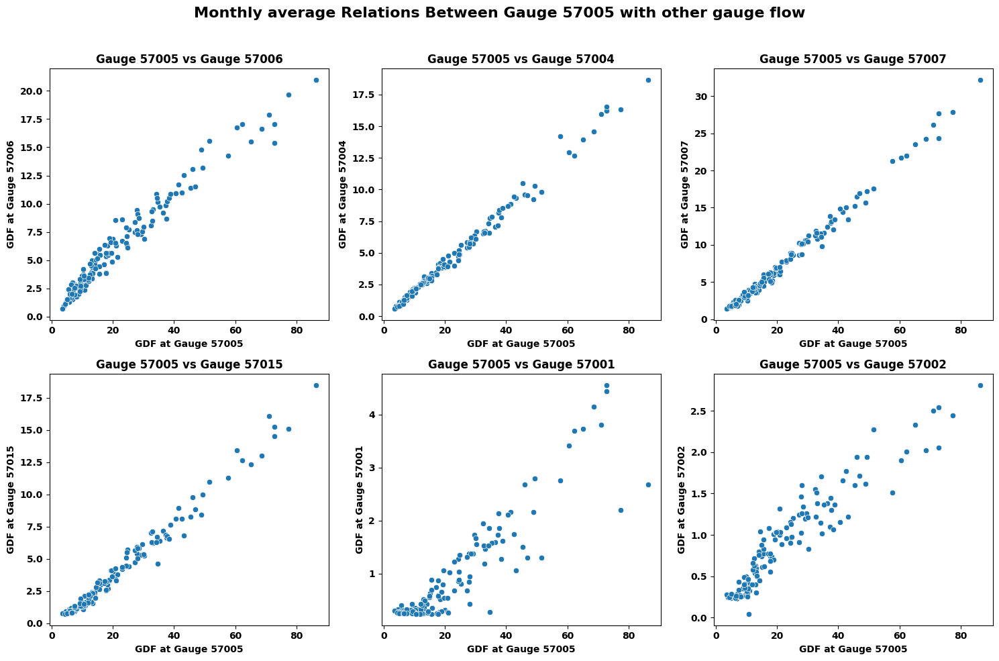

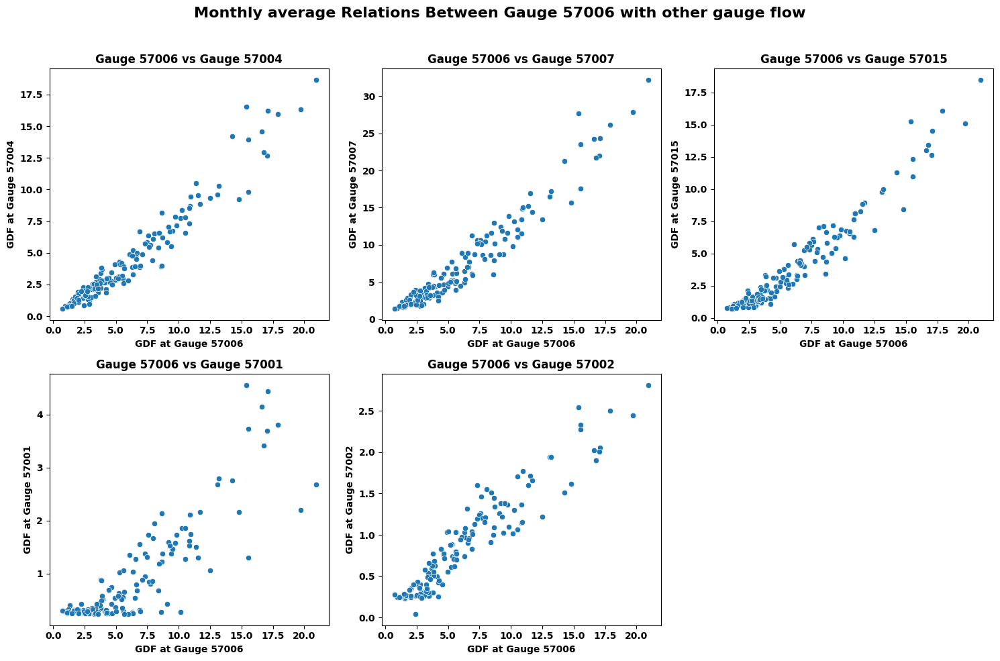

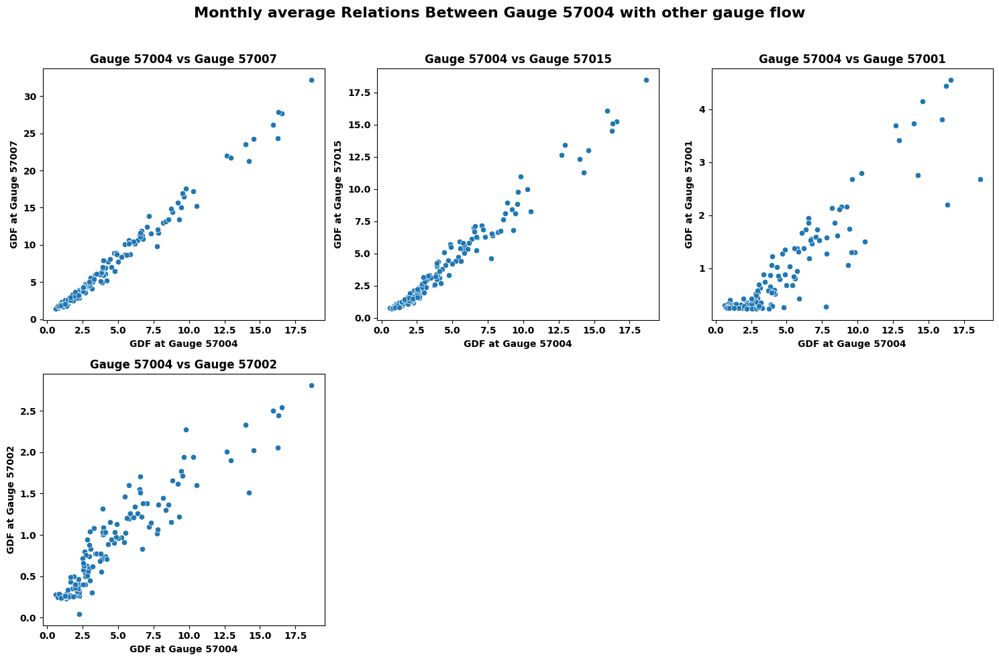

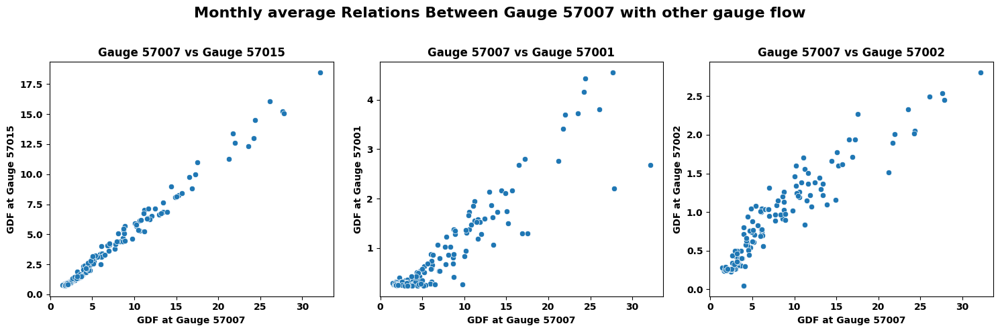

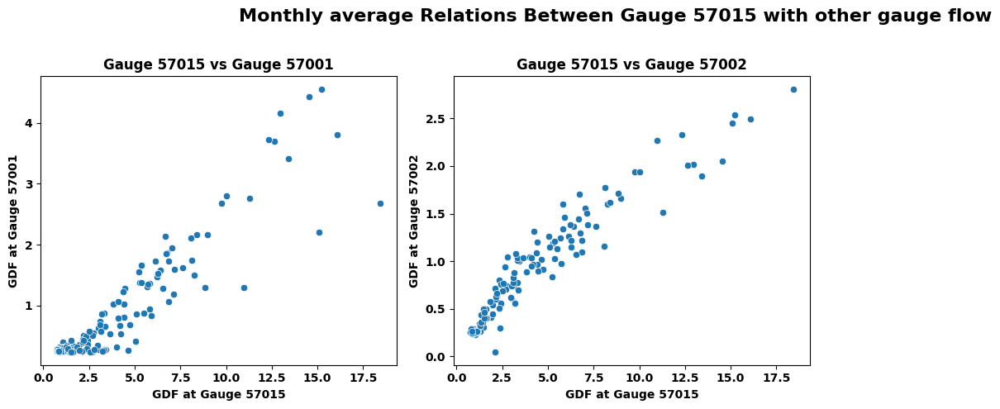

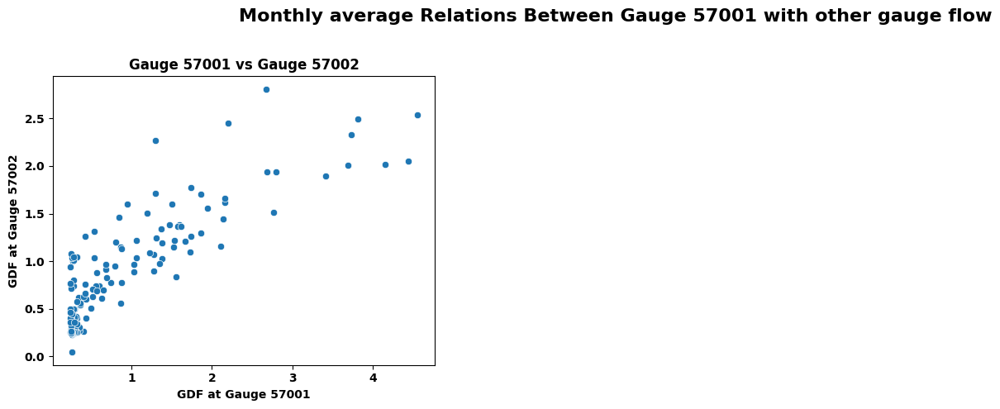

In [276]:
def monthly_avg_plot_flow():
    # List of gauge data
    gauges = [
        ('57005', monthly_avg_57005),
        ('57006', monthly_avg_57006),
        ('57004', monthly_avg_57004),
        ('57007', monthly_avg_57007),
        ('57015', monthly_avg_57015),
        ('57001', monthly_avg_57001),
        ('57002', monthly_avg_57002)
    ]
    
    # Create a set to track plotted combinations
    plotted_pairs = set()
    
    # Loop over each gauge and create a subplot for each of its relationships
    for gauge1_id, gauge1_data in gauges:
        # Find pairs involving the current gauge that have not yet been plotted
        pairs_to_plot = [(gauge2_id, gauge1_data, gauge2_data) for gauge2_id, gauge2_data in gauges
                         if gauge1_id != gauge2_id and (gauge1_id, gauge2_id) not in plotted_pairs
                         and (gauge2_id, gauge1_id) not in plotted_pairs]
        
        if not pairs_to_plot:
            continue  # Skip if there are no new pairs to plot for this gauge
    
        num_plots = len(pairs_to_plot)
        ncols = 3  # Number of columns in the subplot grid
        nrows = (num_plots + ncols - 1) // ncols  # Calculate rows needed based on the number of plots
        
        fig, axes = plt.subplots(
            nrows=nrows,
            ncols=ncols,
            figsize=(15, 5 * nrows)
        )
        fig.suptitle(
            f'Monthly average Relations Between Gauge {gauge1_id} with other gauge flow',
            fontsize=16, fontweight='bold', x=0.5, y=0.98
        )
    
        for ax, (gauge2_id, gauge1_data, gauge2_data) in zip(axes.flat, pairs_to_plot):
            sns.scatterplot(x=gauge1_data['gdf'], y=gauge2_data['gdf'], ax=ax)
            ax.set_title(f'Gauge {gauge1_id} vs Gauge {gauge2_id}', fontweight='bold')
            ax.set_xlabel(f'GDF at Gauge {gauge1_id}', fontweight='bold')
            ax.set_ylabel(f'GDF at Gauge {gauge2_id}', fontweight='bold')
            plt.setp(ax.get_xticklabels(), fontweight='bold')
            plt.setp(ax.get_yticklabels(), fontweight='bold')
            # Add the plotted pair to the set to avoid duplication
            plotted_pairs.add((gauge1_id, gauge2_id))
    
        # Hide any unused subplots
        if num_plots < nrows * ncols:
            for i in range(num_plots, nrows * ncols):
                fig.delaxes(axes.flat[i])
    
        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()
monthly_avg_plot_flow()

## 4.4 Correlations Analysis on daily data

C:\Program Files\Python311\Lib\site-packages\seaborn\matrix.py:260: FutureWarning: Format strings passed to MaskedConstant are ignored, but in future may error or produce different behavior
  annotation = ("{:" + self.fmt + "}").format(val)


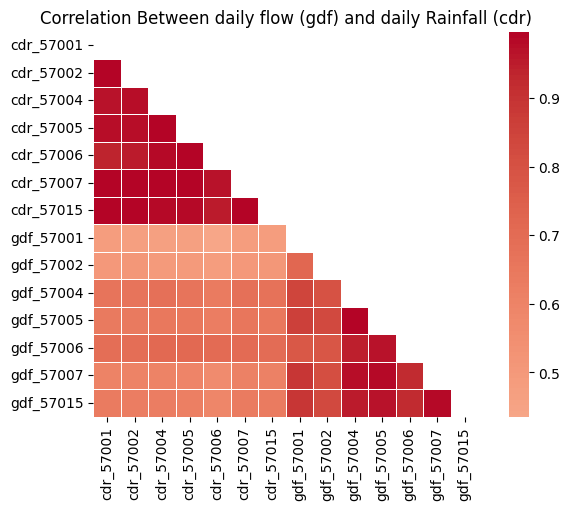

In [277]:
def correlation_daily_data(merge_allfilter_df):
    # Calculate the correlation matrix
    correlation_matrix = merge_allfilter_df.corr()
    
    # Reorder the columns to group flows and rainfall together
    columns_order = sorted(correlation_matrix.columns, key=lambda x: ('gdf' in x, x))
    correlation_matrix = correlation_matrix.loc[columns_order, columns_order]
    
    # Create a mask for the upper triangle
    mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))
    
    # Set up the matplotlib figure
    plt.figure(figsize=(8, 5))
    
    # Draw the heatmap with the mask and correct aspect ratio
    sns.heatmap(correlation_matrix, mask=mask, annot=True, fmt=".2f", cmap='coolwarm', center=0, square=True, linewidths=.5)
    
    plt.title('Correlation Between daily flow (gdf) and daily Rainfall (cdr)')
    plt.show()
correlation_daily_data(merge_allfilter_df)

Note: With correlation heatmap observation,  Strong Correlations between gauges(GDF) which important factor to predict pattern and less Correlations between daily flow and rainfall

## 4.5 Distribution at Daily Mean Data

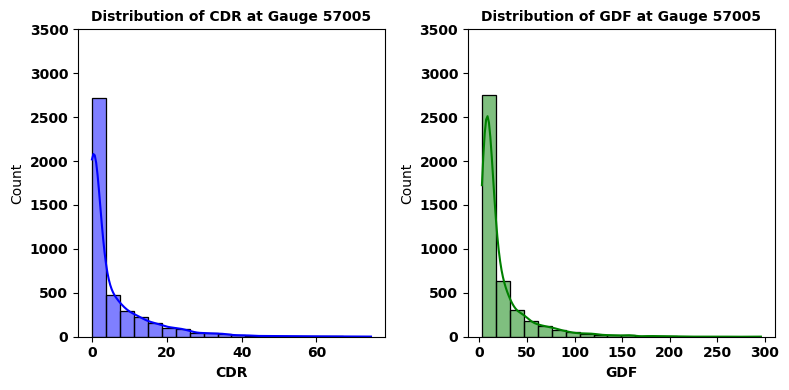

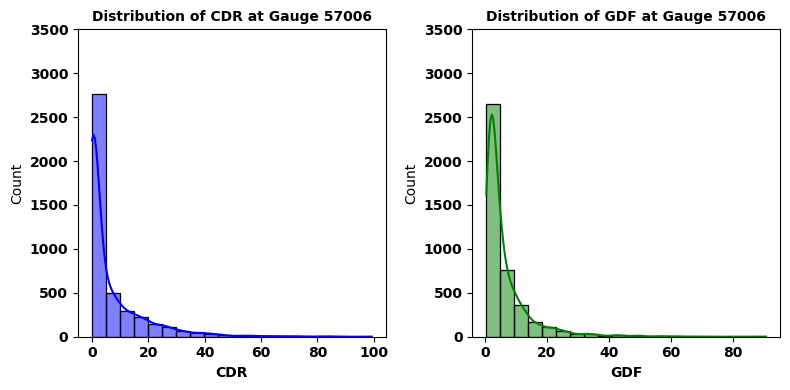

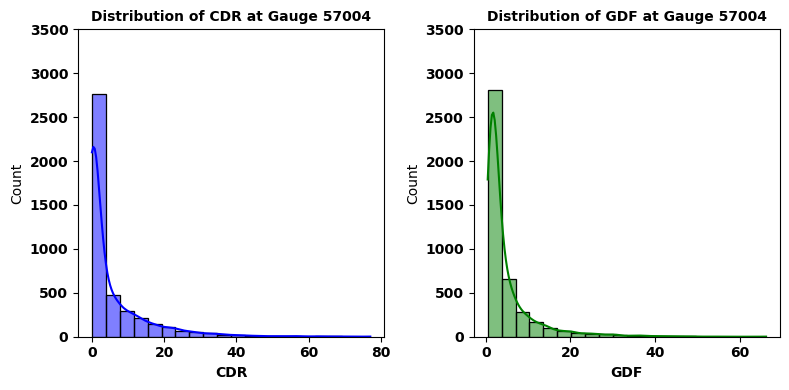

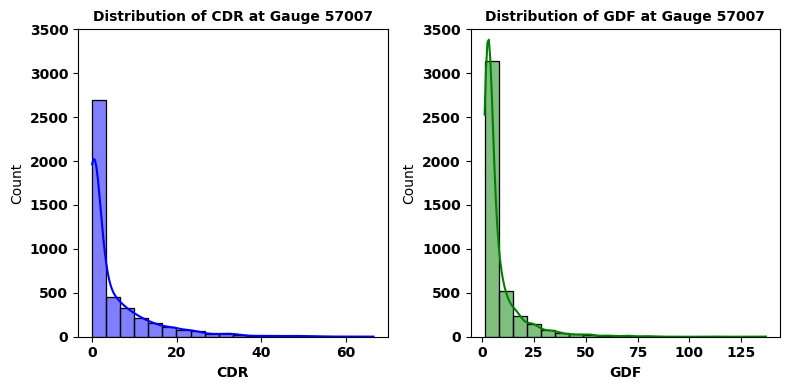

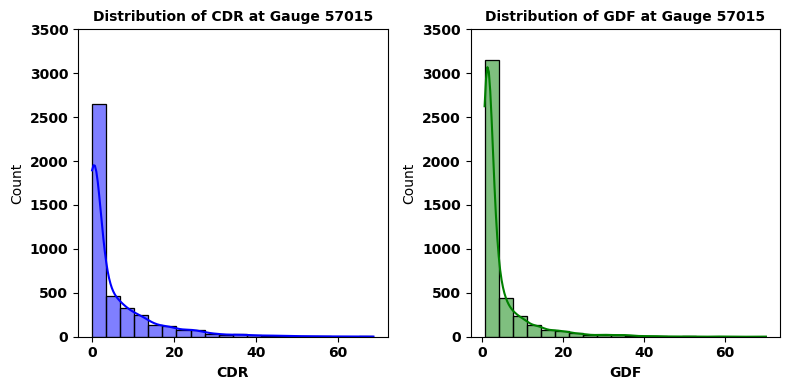

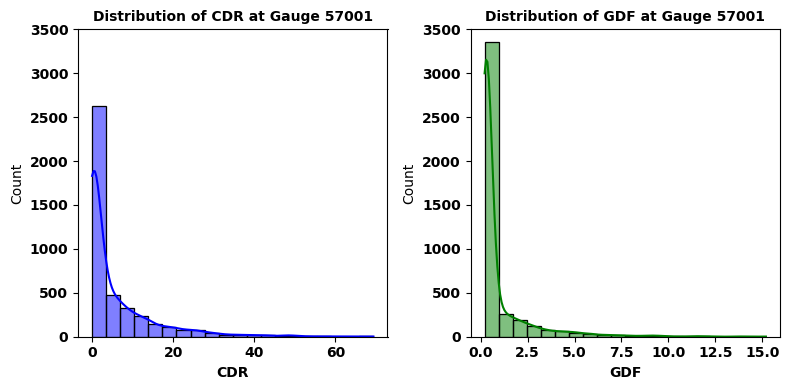

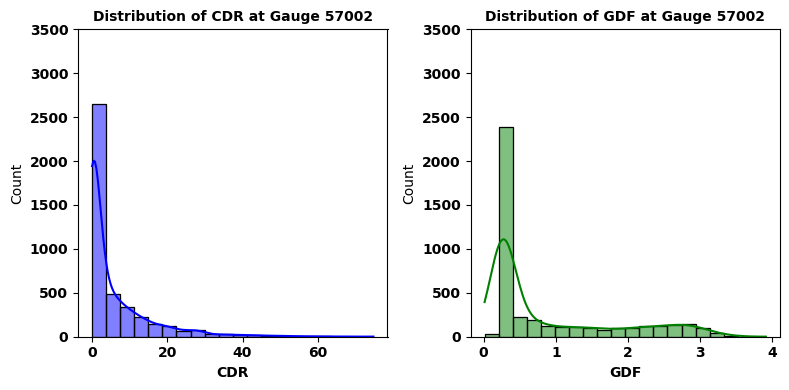

In [278]:

def dist_plot_daily_data(merge_allfilter_df):
    # List of gauge numbers
    gauges = ['57005', '57006', '57004', '57007', '57015', '57001', '57002']
    
    # Loop over each gauge to create the plots
    for gauge in gauges:
        plt.figure(figsize=(8, 4))
    
        # Plot CDR histogram with its own scale
        plt.subplot(1, 2, 1)
        sns.histplot(merge_allfilter_df[f'cdr_{gauge}'], bins=20, kde=True, color='blue')
        plt.title(f'Distribution of CDR at Gauge {gauge}', fontsize=10, fontweight='bold')
        plt.xlabel('CDR', fontsize=10, fontweight='bold')
        plt.xticks(fontsize=10, fontweight='bold')
        plt.yticks(fontsize=10, fontweight='bold')
        plt.ylim(0, 3500)  # Adjust y-axis to a common scale
    
        # Plot GDF histogram with its own scale
        plt.subplot(1, 2, 2)
        sns.histplot(merge_allfilter_df[f'gdf_{gauge}'], bins=20, kde=True, color='green')
        plt.title(f'Distribution of GDF at Gauge {gauge}', fontsize=10, fontweight='bold')
        plt.xlabel('GDF', fontsize=10, fontweight='bold')
        plt.xticks(fontsize=10, fontweight='bold')
        plt.yticks(fontsize=10, fontweight='bold')
        plt.ylim(0, 3500)  # Adjust y-axis to a common scale
        
        # Adjust layout and show the plot
        plt.tight_layout()
        plt.show()
dist_plot_daily_data(merge_allfilter_df)

## 4.6 Distribution at monthly Average Data

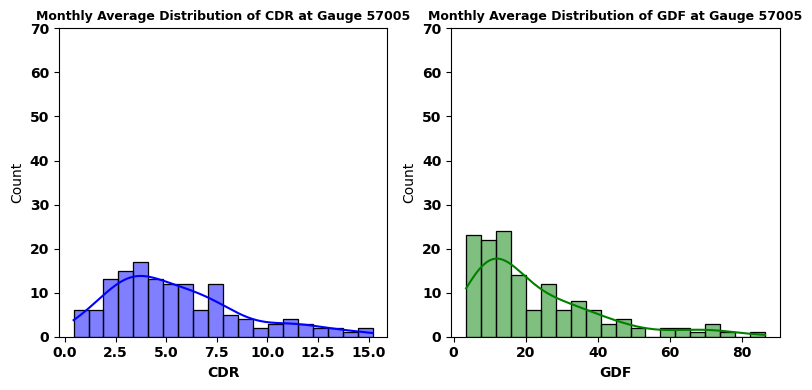

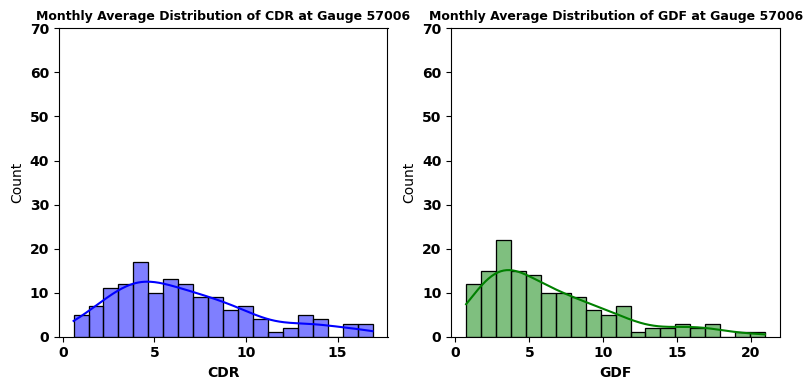

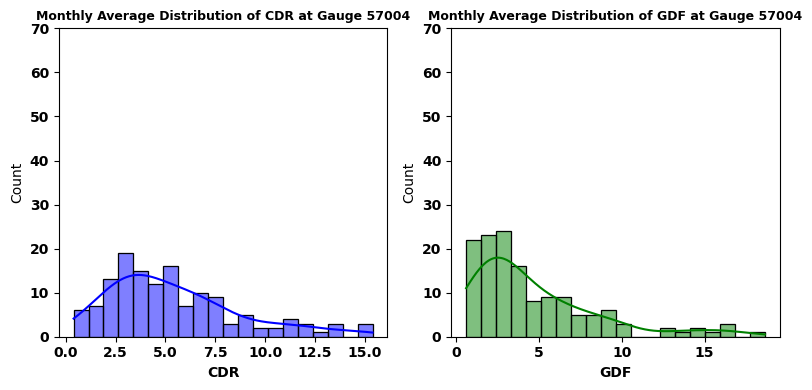

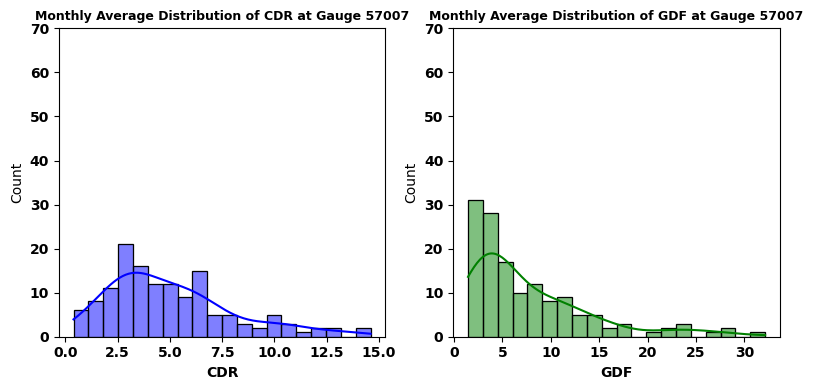

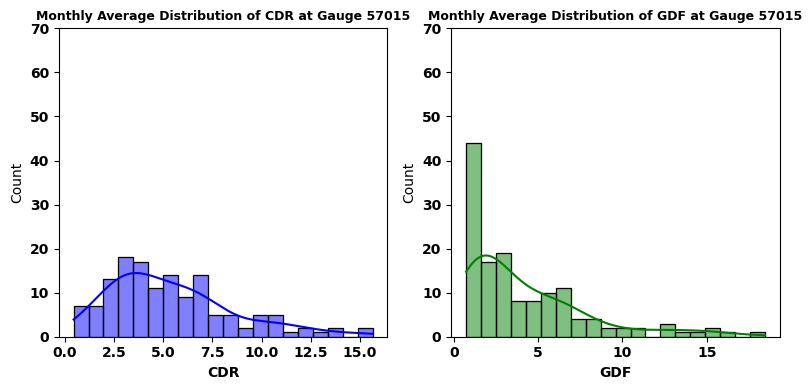

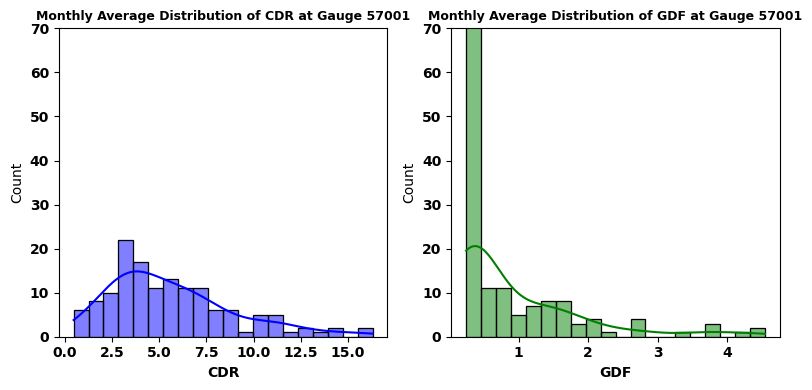

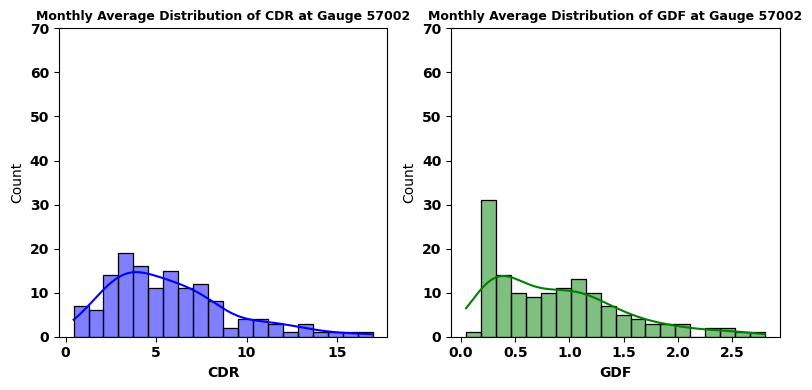

In [279]:

def monthly_avg_dist_plot():
    # List of gauge data dictionaries and their identifiers
    m_gauges = [
        ('57005', monthly_avg_57005),
        ('57006', monthly_avg_57006),
        ('57004', monthly_avg_57004),
        ('57007', monthly_avg_57007),
        ('57015', monthly_avg_57015),
        ('57001', monthly_avg_57001),
        ('57002', monthly_avg_57002)
    ]
    
    # Loop over each gauge to create the plots
    for gauge_id, gauge_data in m_gauges:
        plt.figure(figsize=(8, 4))
    
        # Plot CDR histogram
        plt.subplot(1, 2, 1)
        sns.histplot(gauge_data['cdr'], bins=20, kde=True, color='blue')
        plt.title(f'Monthly Average Distribution of CDR at Gauge {gauge_id}', fontsize=9, fontweight='bold')
        plt.xlabel('CDR', fontsize=10, fontweight='bold')
        plt.xticks(fontsize=10, fontweight='bold')
        plt.yticks(fontsize=10, fontweight='bold')
        plt.ylim(0, 70) 
    
        # Plot GDF histogram
        plt.subplot(1, 2, 2)
        sns.histplot(gauge_data['gdf'], bins=20, kde=True, color='green')
        plt.title(f'Monthly Average Distribution of GDF at Gauge {gauge_id}', fontsize=9, fontweight='bold')
        plt.xlabel('GDF', fontsize=10, fontweight='bold')
        plt.xticks(fontsize=10, fontweight='bold')
        plt.yticks(fontsize=10, fontweight='bold')
        plt.ylim(0, 70) 
        # Adjust layout and show the plot
        plt.tight_layout()
        plt.show()
monthly_avg_dist_plot()

## 4.7 Comparsion of mean with variance at 30 rolling window

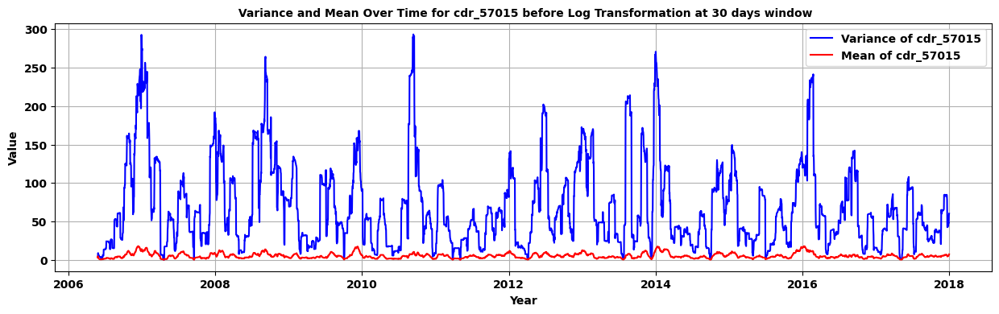

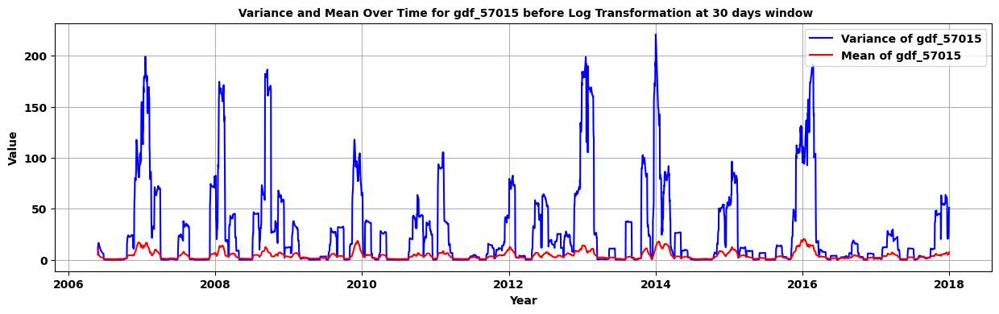

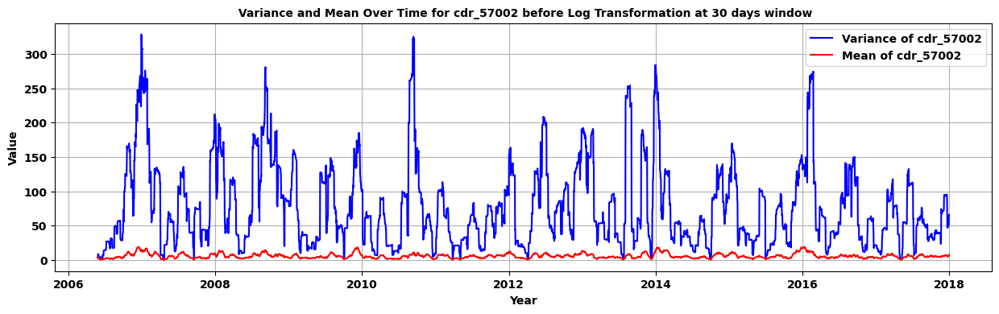

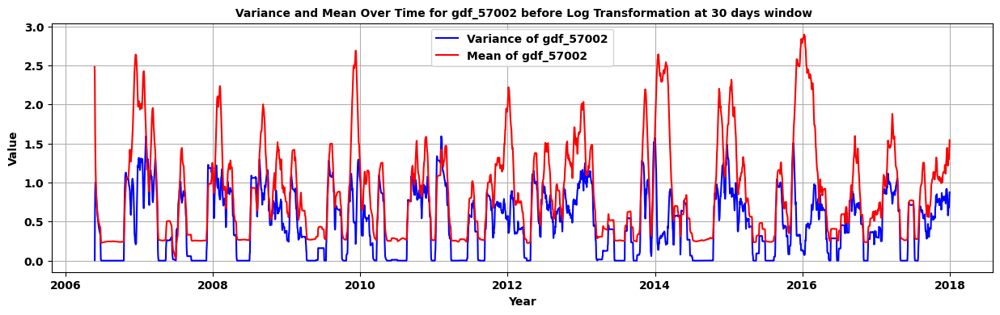

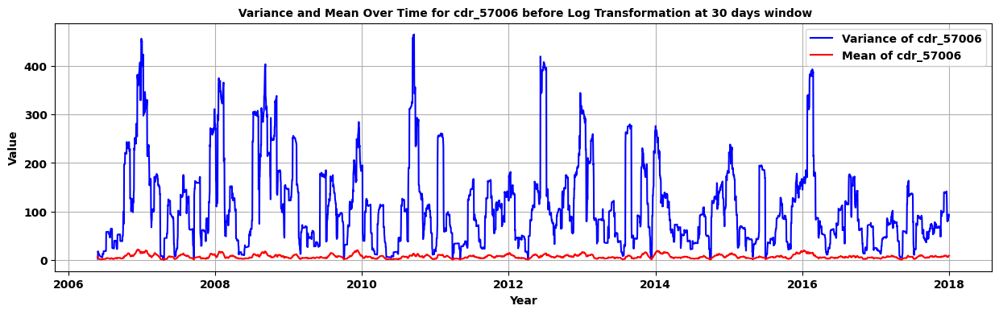

...

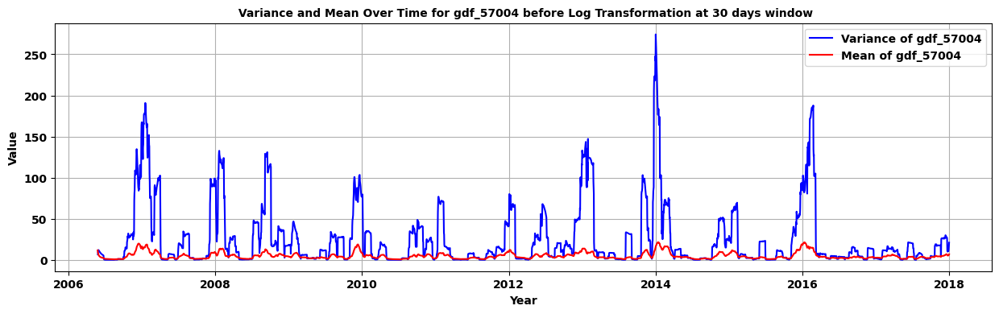

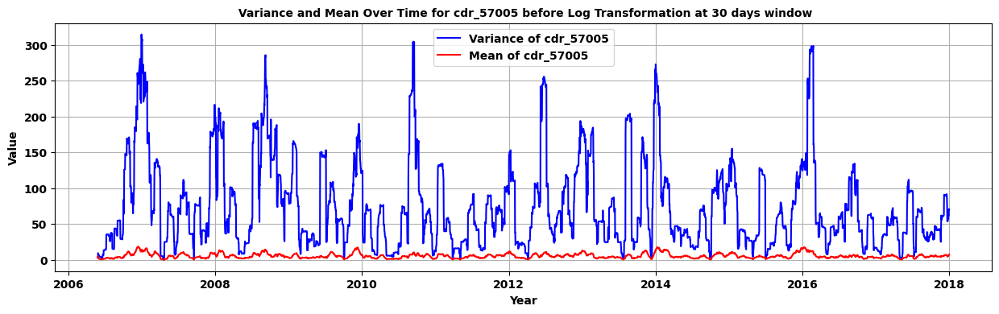

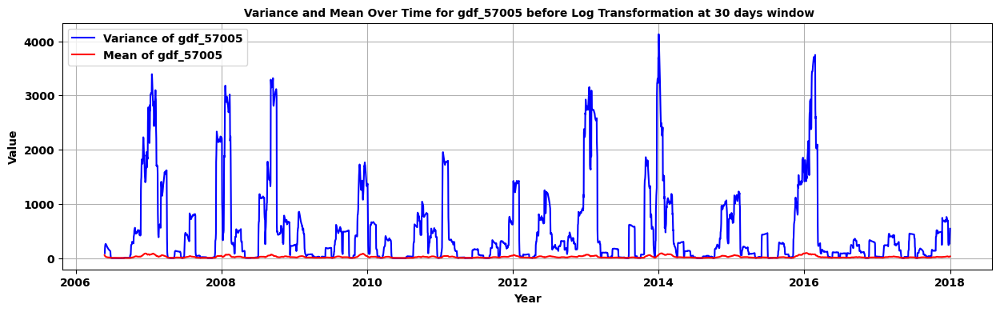

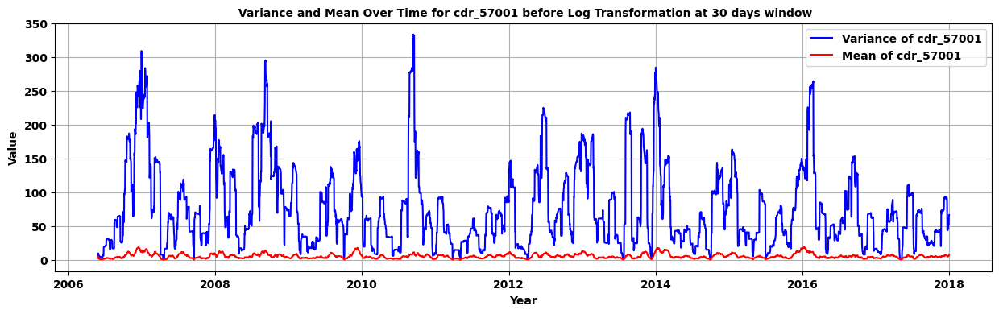

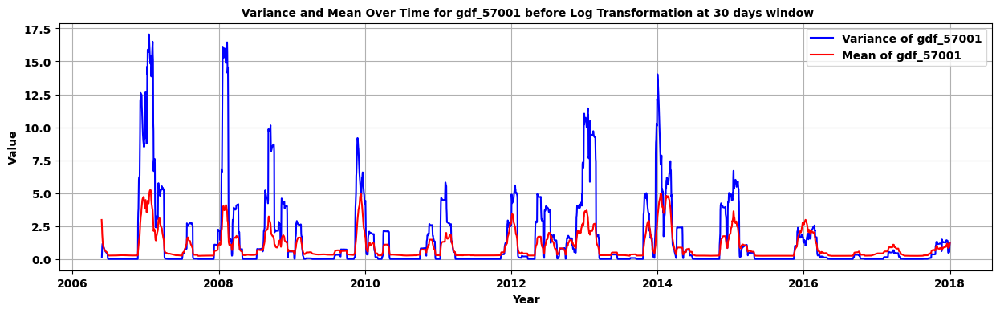

In [280]:
def mean_var_comparsion_plot(merge_allfilter_df):
    # Calculate the rolling variance and mean with a window of 30 days
    monthly_variance = merge_allfilter_df.rolling(window=30, min_periods=1).var()
    monthly_means = merge_allfilter_df.rolling(window=30, min_periods=1).mean()
    
    # Create a plot for each column
    for column in merge_allfilter_df.columns:
        plt.figure(figsize=(15, 4))
        plt.plot(monthly_variance.index, monthly_variance[column], label=f'Variance of {column}', color='blue')
        plt.plot(monthly_means.index, monthly_means[column], label=f'Mean of {column}', color='red')
        plt.title(f' Variance and Mean Over Time for {column} before Log Transformation at 30 days window', fontsize=10, fontweight='bold')
        plt.xlabel('Year', fontsize=10, fontweight='bold')
        plt.ylabel('Value', fontsize=10, fontweight='bold')
        plt.xticks(fontsize=10, fontweight='bold')
        plt.yticks(fontsize=10, fontweight='bold')
        plt.legend(prop={'size': 10, 'weight': 'bold'})
        plt.grid(True)
        plt.show()
mean_var_comparsion_plot(merge_allfilter_df)

**Variance is not stable there is no pattern found over months or sudden fluction over the year.**            
means is approximately constant over time but variance is highly volatile

# 5. Transformation 

## 5.1 Applying Log Transformation

In [281]:
# Apply log transformation
log_transformed_daily_df = merge_allfilter_df.copy()
gdf_columns = [col for col in merge_allfilter_df.columns if col.startswith('gdf')]
cdr_columns = [col for col in merge_allfilter_df.columns if col.startswith('cdr')]
# Apply log transformation to gdf columns
log_transformed_daily_df[gdf_columns] = np.log(merge_allfilter_df[gdf_columns])
# Apply log(1 + x) transformation to cdr columns
log_transformed_daily_df[cdr_columns] = np.log1p(merge_allfilter_df[cdr_columns])
print(log_transformed_daily_df)

            cdr_57015  gdf_57015  cdr_57002  gdf_57002  cdr_57006  gdf_57006   
date                                                                           
2006-05-26   1.458615   2.468100   1.504077   0.908259   2.028148   2.549445  \
2006-05-27   2.014903   2.154085   2.001480   0.862890   2.261763   2.322388   
2006-05-28   0.405465   1.512927   0.405465   0.104360   0.405465   1.961502   
2006-05-29   0.741937   1.095273   0.832909  -0.525939   0.916291   1.728109   
2006-05-30   0.000000   0.756122   0.000000  -1.027222   0.000000   1.517323   
...               ...        ...        ...        ...        ...        ...   
2017-12-27   1.163151   1.756132   1.308333   0.470004   0.832909   2.238580   
2017-12-28   2.954910   1.327075   2.954910  -0.014099   3.148453   2.258633   
2017-12-29   2.240710   2.856470   2.292535   1.081805   2.660260   2.960105   
2017-12-30   3.242592   3.394508   3.277145   1.144223   3.198673   2.960105   
2017-12-31   2.928524   3.068053   3.005

In [282]:
# Check for negative values
negative_values_exist = (log_transformed_daily_df < 0).any()

# Check for zero values
zero_values_exist = (log_transformed_daily_df == 0).any()

# Print the results
print("Negative values exist:", negative_values_exist)
print("Zero values exist:", zero_values_exist)


Negative values exist: cdr_57015    False
gdf_57015     True
cdr_57002    False
gdf_57002     True
cdr_57006    False
gdf_57006     True
cdr_57007    False
gdf_57007    False
cdr_57004    False
gdf_57004     True
cdr_57005    False
gdf_57005    False
cdr_57001    False
gdf_57001     True
dtype: bool
Zero values exist: cdr_57015     True
gdf_57015     True
cdr_57002     True
gdf_57002     True
cdr_57006     True
gdf_57006     True
cdr_57007     True
gdf_57007    False
cdr_57004     True
gdf_57004     True
cdr_57005     True
gdf_57005    False
cdr_57001     True
gdf_57001     True
dtype: bool


### 5.1.1 Distribution plot at log transformed data

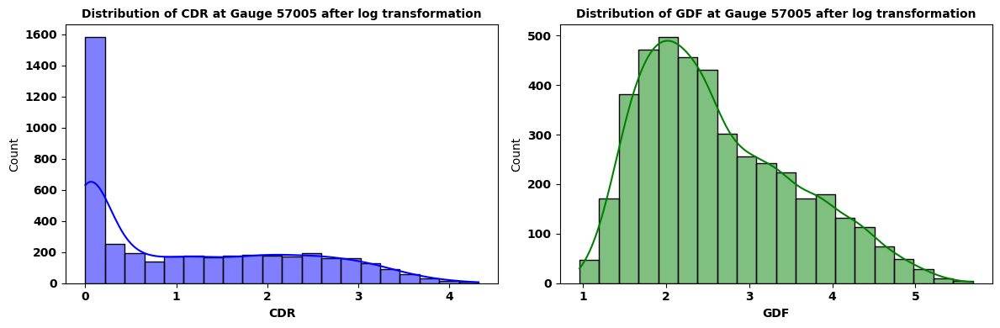

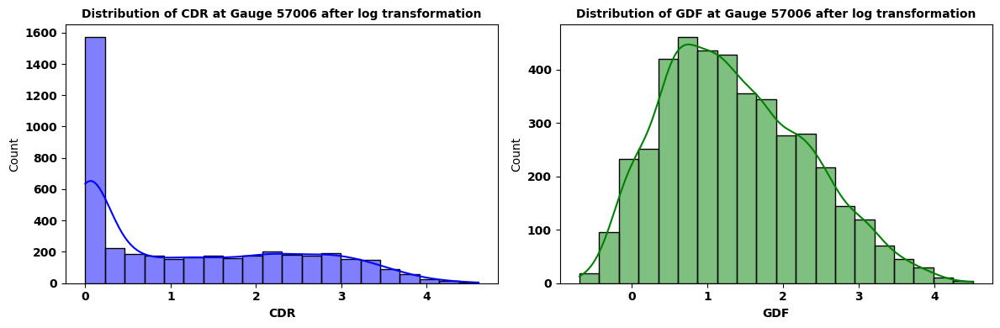

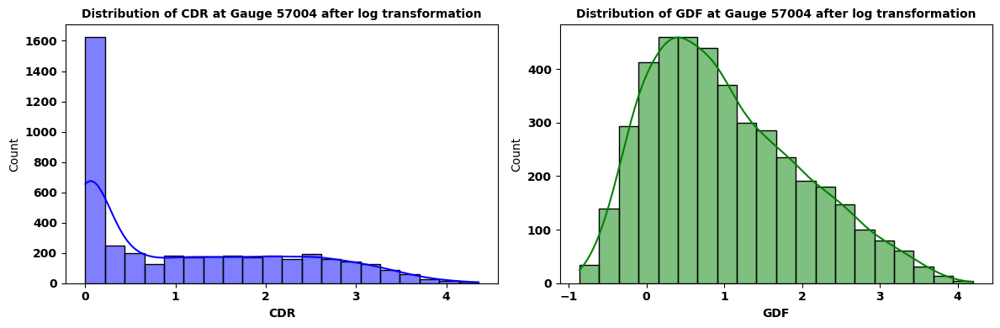

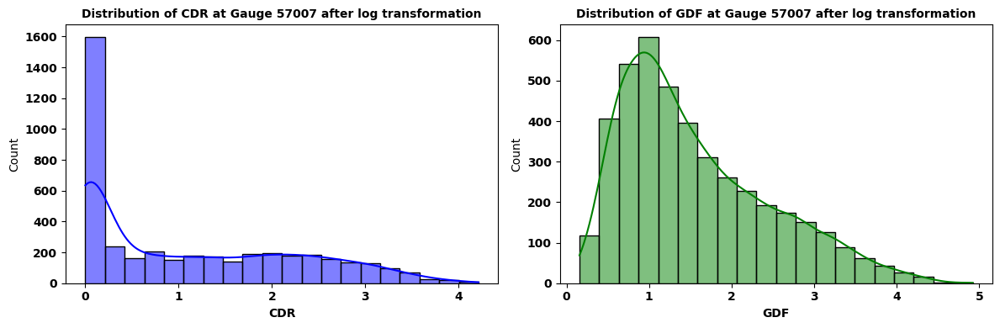

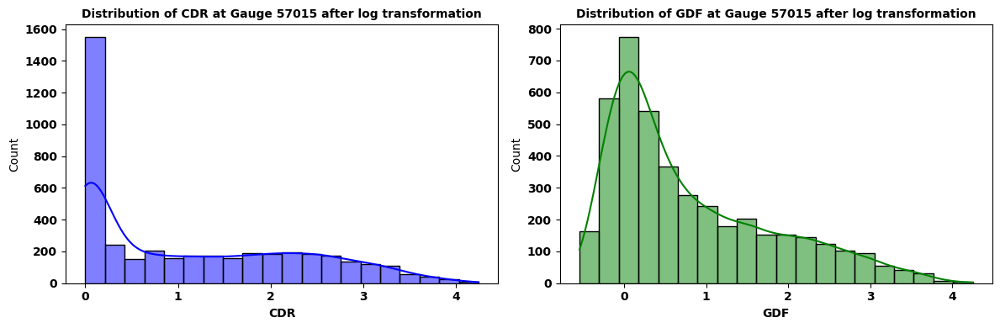

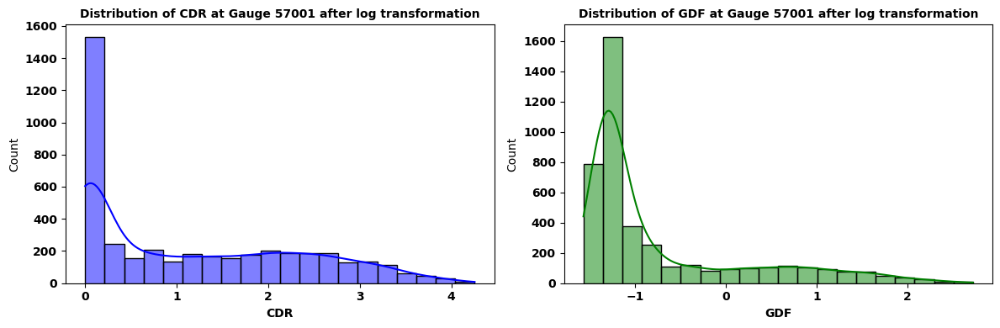

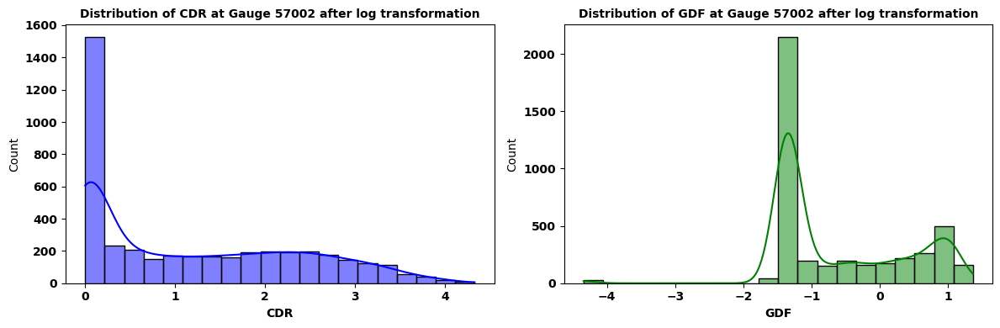

In [283]:

# List of gauge IDs
gauges = ['57005', '57006', '57004', '57007', '57015', '57001', '57002']

# Loop over each gauge to create the plots
for gauge in gauges:
    plt.figure(figsize=(12, 4))

    # Plot CDR histogram
    plt.subplot(1, 2, 1)
    sns.histplot(log_transformed_daily_df[f'cdr_{gauge}'], bins=20, kde=True, color='blue')
    plt.title(f'Distribution of CDR at Gauge {gauge} after log transformation', fontsize=10, fontweight='bold')
    plt.xlabel('CDR', fontsize=10, fontweight='bold')
    plt.xticks(fontsize=10, fontweight='bold')
    plt.yticks(fontsize=10, fontweight='bold')

    # Plot GDF histogram
    plt.subplot(1, 2, 2)
    sns.histplot(log_transformed_daily_df[f'gdf_{gauge}'], bins=20, kde=True, color='green')
    plt.title(f'Distribution of GDF at Gauge {gauge} after log transformation', fontsize=10, fontweight='bold')
    plt.xlabel('GDF', fontsize=10, fontweight='bold')
    plt.xticks(fontsize=10, fontweight='bold')
    plt.yticks(fontsize=10, fontweight='bold')

    # Adjust layout and show the plot
    plt.tight_layout()
    plt.show()


Note: 1. Above distribution plot showing that after applied log transformation it appear more normalize which stabilize  variance
      2. For CDR most of days have approximately very low rainfall tend to zero.

### 5.1.2 Box plot at log transformed data

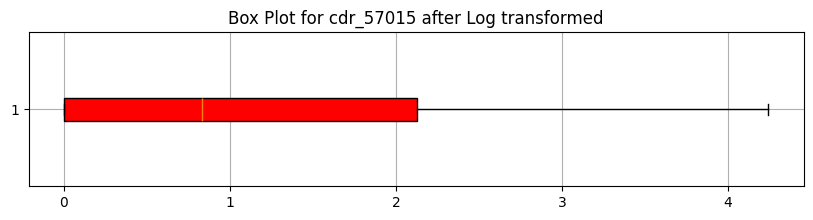

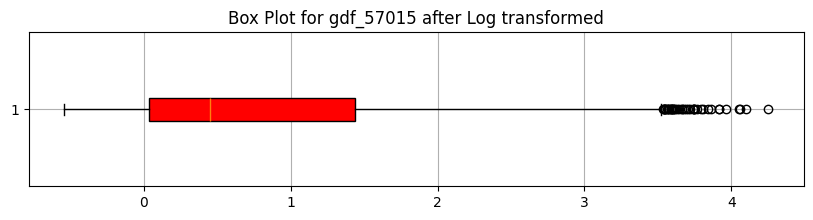

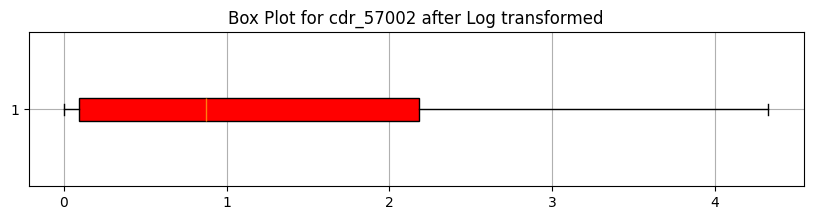

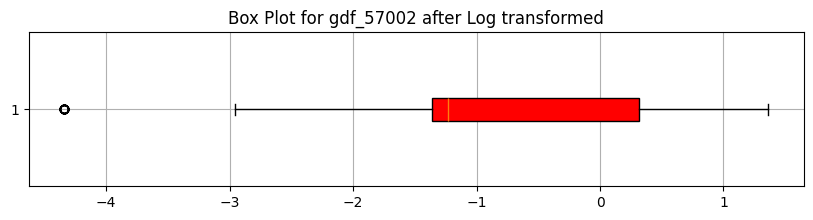

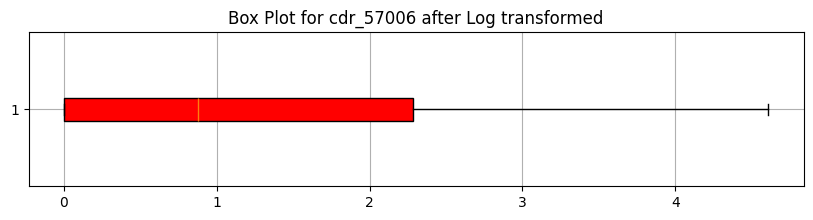

...

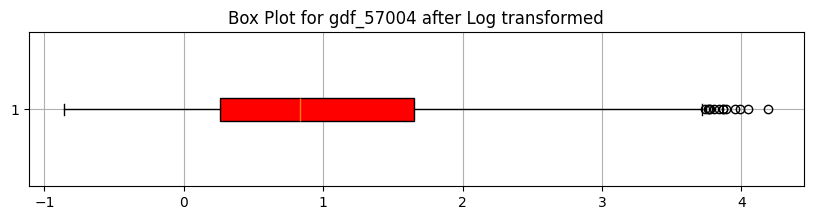

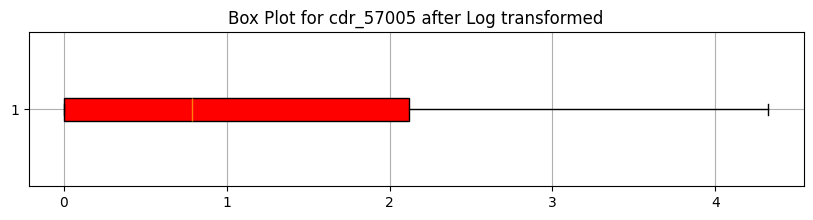

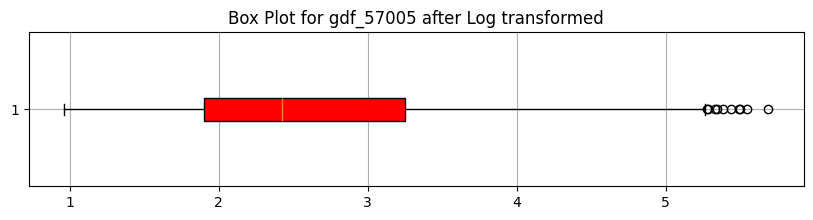

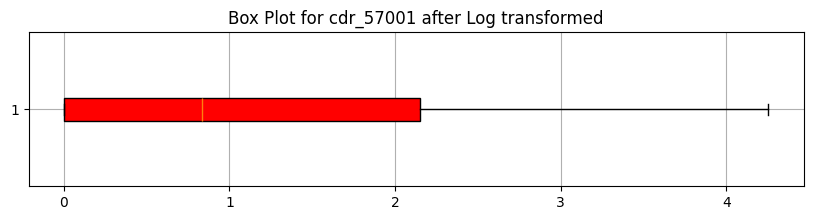

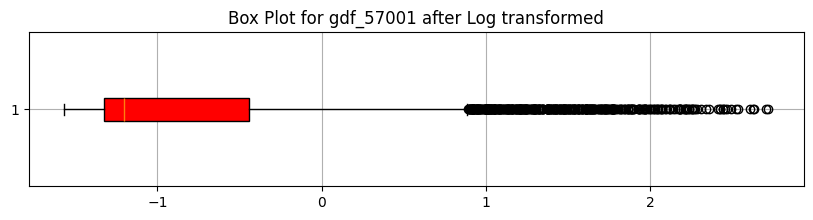

In [284]:
for column in log_transformed_daily_df.columns:
    plt.figure(figsize=(10, 2))
    plt.boxplot(
        log_transformed_daily_df[column].dropna(),
        vert=False,
        patch_artist=True,
        boxprops=dict(facecolor="Red")
    )
    plt.title(f'Box Plot for {column} after Log transformed')
    #plt.xlabel('CDR')
    plt.grid(True)
    plt.show()

### 5.1.3 Comparsion between Variance and Mean to check stablity of variance with mean after applied log Tranformation

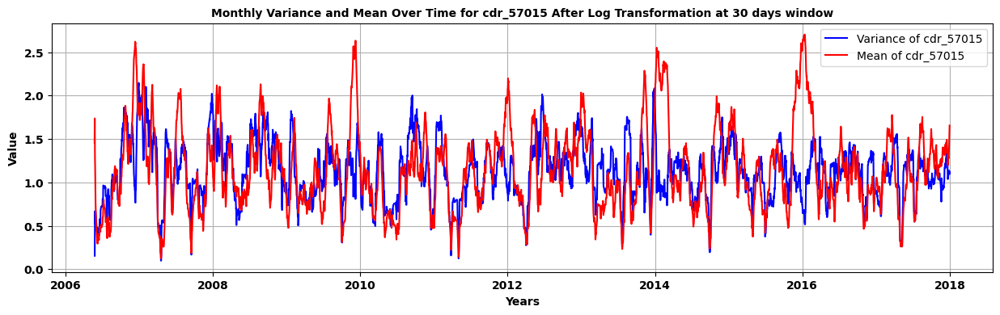

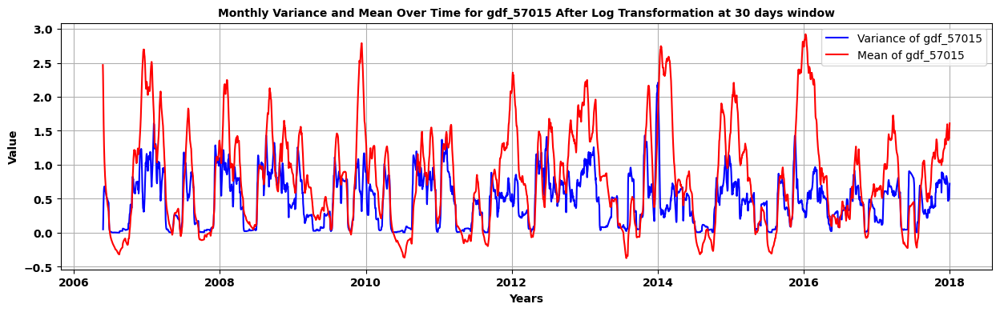

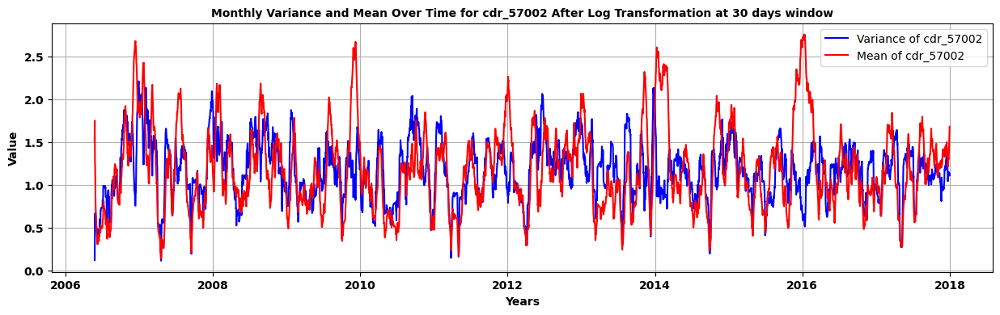

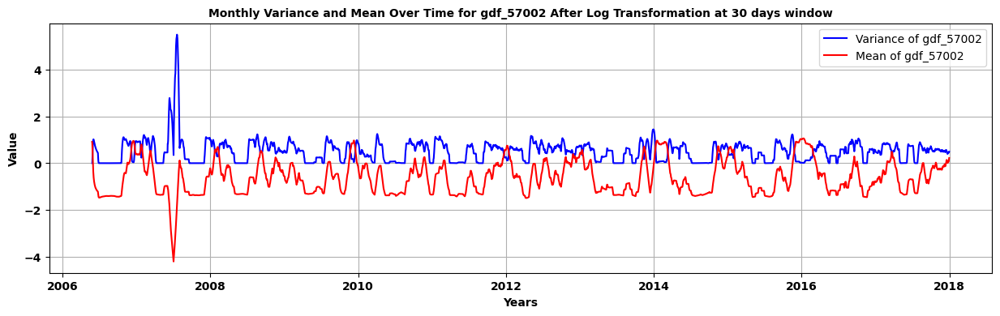

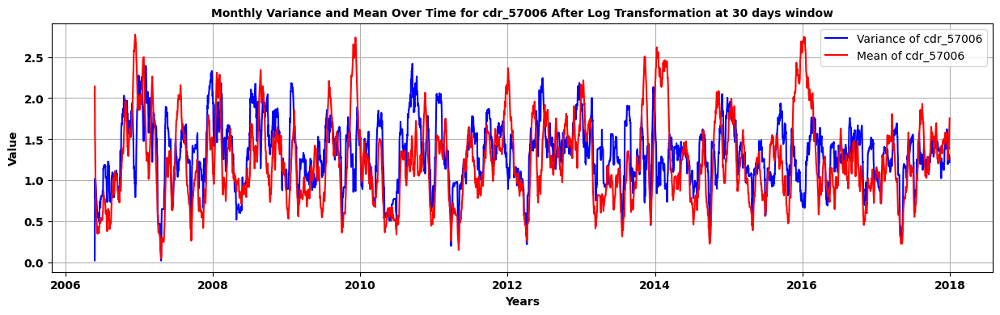

...

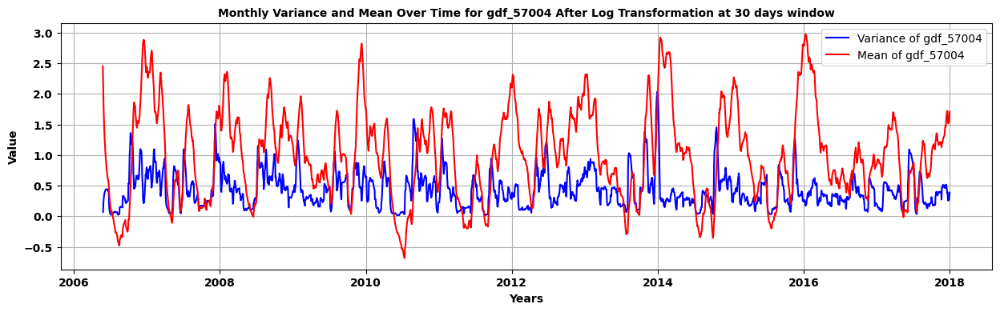

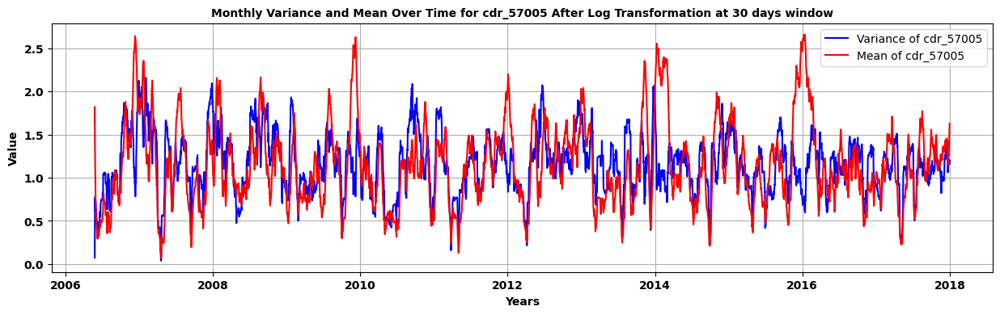

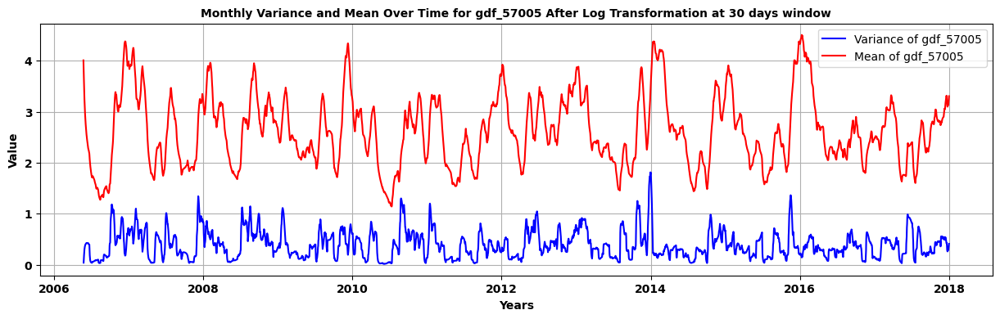

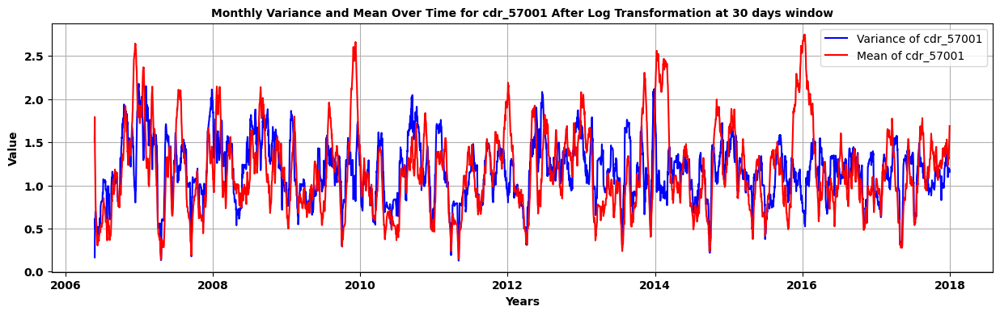

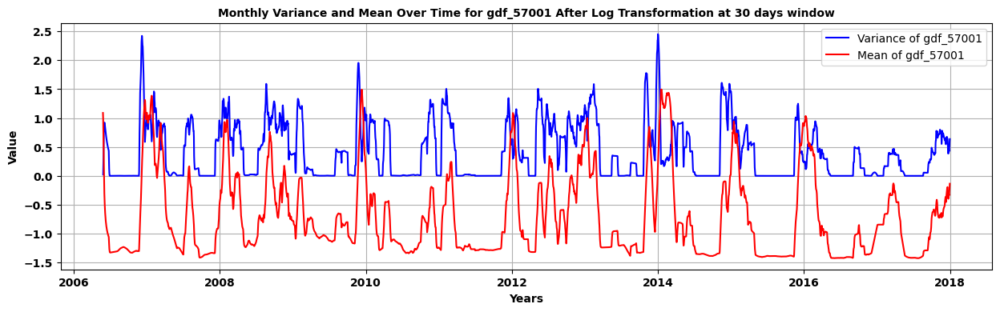

In [285]:
# Calculate the rolling variance and mean with a window of 30 days on the transformed data
log_transform_monthly_variance = log_transformed_daily_df.rolling(window=30, min_periods=1).var()
log_transform_monthly_means = log_transformed_daily_df.rolling(window=30, min_periods=1).mean()

# Create a plot for each column
for column in log_transformed_daily_df.columns:
    plt.figure(figsize=(15, 4))
    plt.plot(log_transform_monthly_variance.index, log_transform_monthly_variance[column], label=f'Variance of {column}', color='blue')
    plt.plot(log_transform_monthly_means.index, log_transform_monthly_means[column], label=f'Mean of {column}', color='red')
    plt.title(f'Monthly Variance and Mean Over Time for {column} After Log Transformation at 30 days window', fontsize=10, fontweight='bold')
    plt.xlabel('Years', fontsize=10, fontweight='bold')
    plt.ylabel('Value', fontsize=10, fontweight='bold')
    plt.xticks(fontsize=10, fontweight='bold')
    plt.yticks(fontsize=10, fontweight='bold')
    plt.legend()
    plt.grid(True)
    plt.show()

### 5.1.4 Moving Average to Identify Underlying Trend at 7MA, double 7MA, 30MA, weighted MA

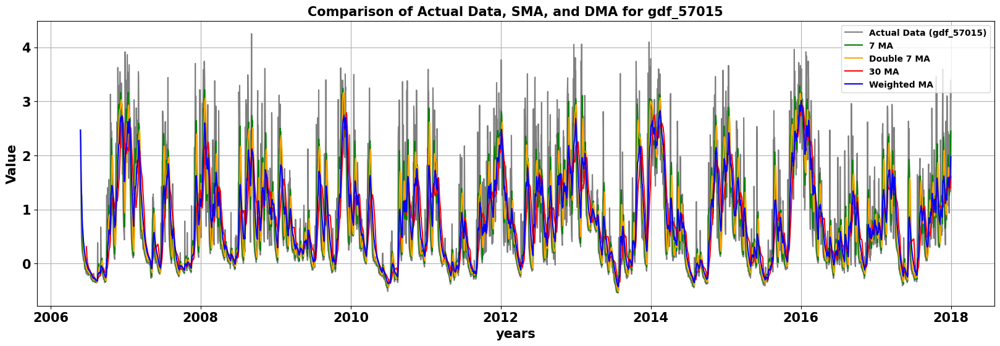

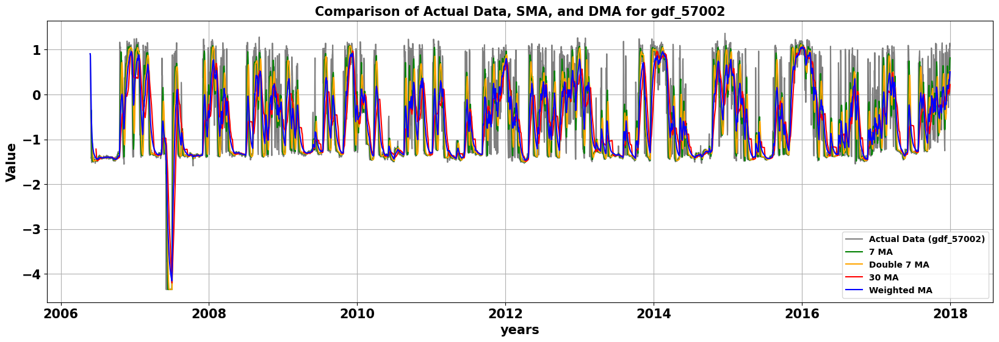

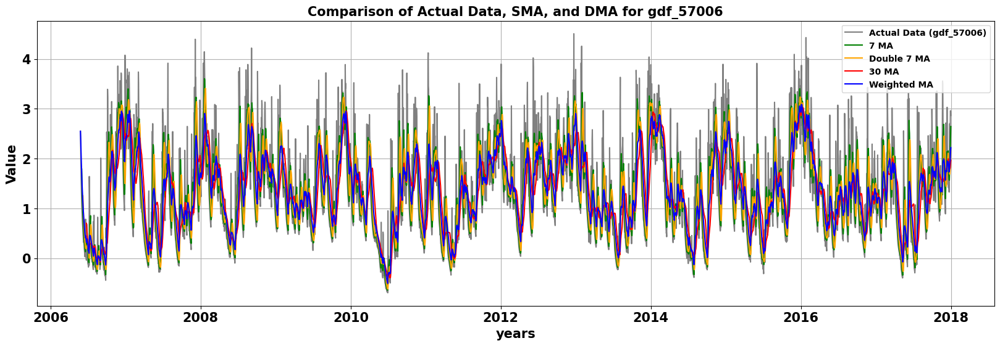

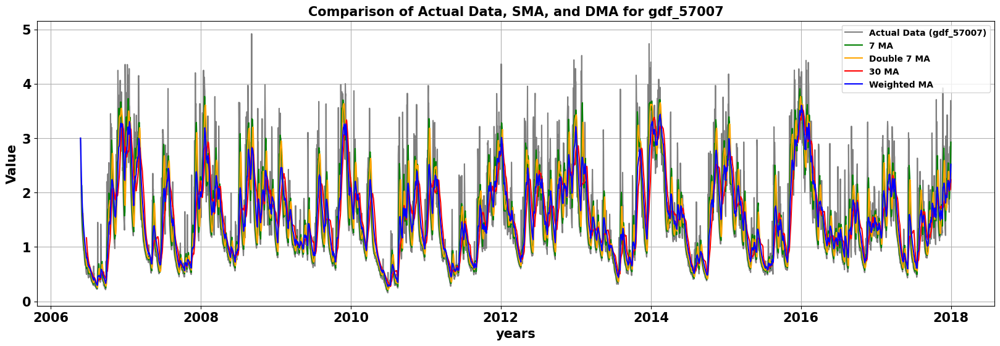

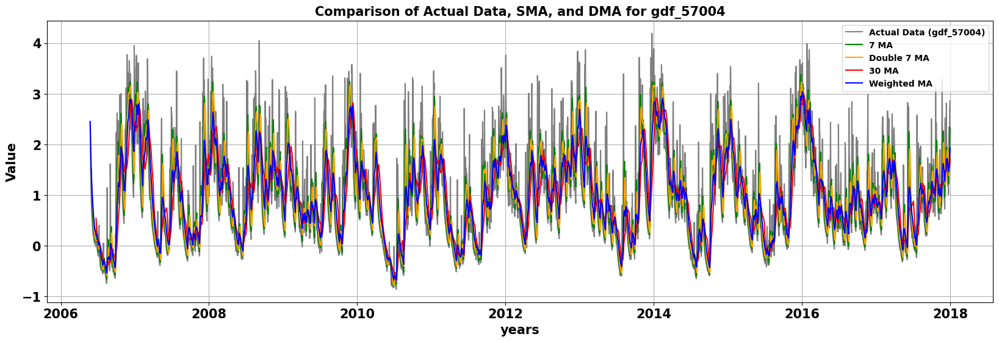

...

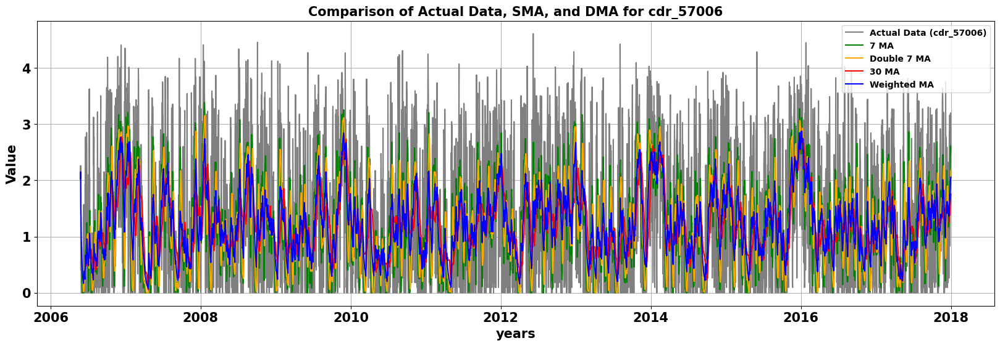

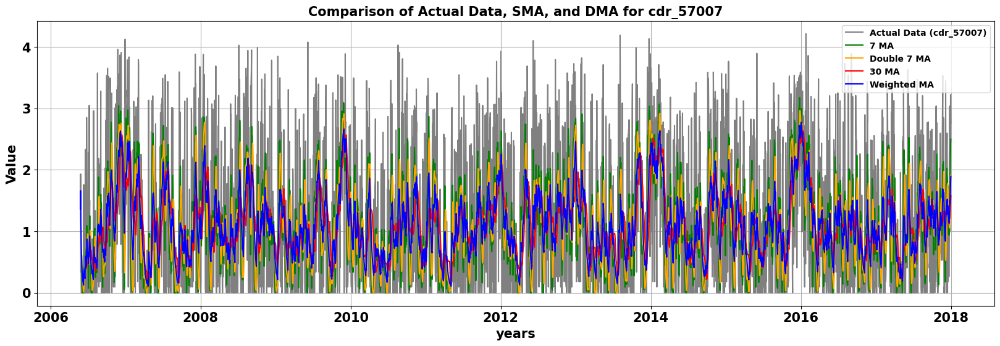

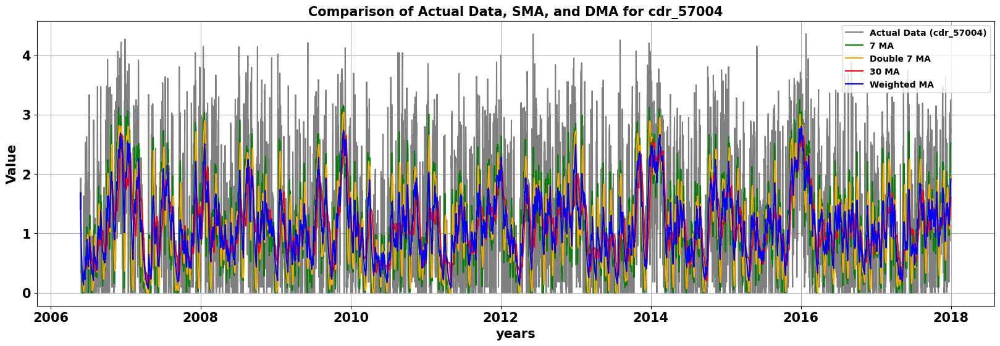

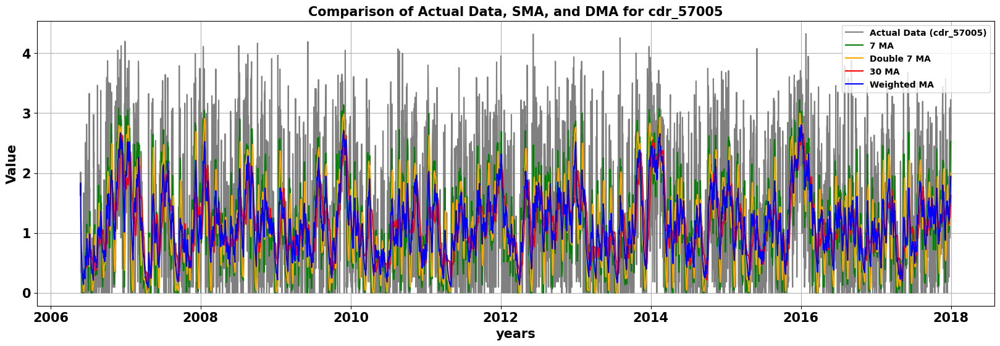

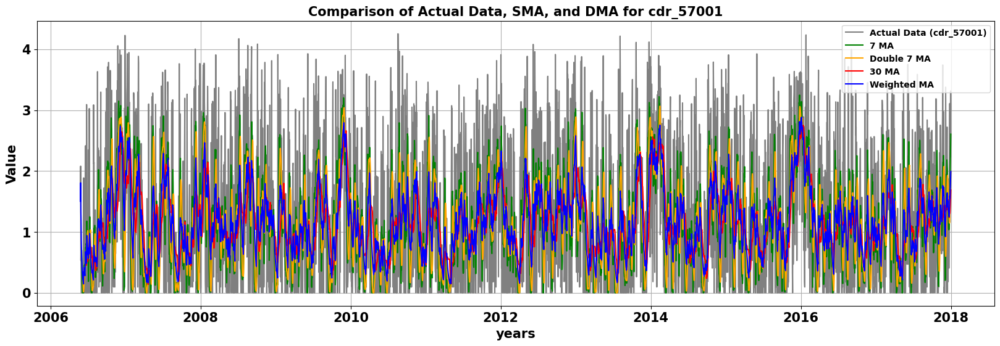

In [286]:
def ma_find_trend(log_transformed_daily_df):
    # List of column types and their corresponding labels
    column_types = [
        ('gdf', [col for col in log_transformed_daily_df.columns if 'gdf' in col]),
        ('cdr', [col for col in log_transformed_daily_df.columns if 'cdr' in col])
    ]
    
    # Loop through each column type ('gdf' and 'cdr') and process accordingly
    for label, columns in column_types:
        # Calculate moving averages for the columns
        seven_MA = log_transformed_daily_df[columns].rolling(7).mean()  # 7MA
        double_seven_MA = seven_MA.rolling(7).mean()  # Double 7MA
        thirty_MA = log_transformed_daily_df[columns].rolling(30).mean()  # 30MA
        Wma = log_transformed_daily_df[columns].ewm(halflife=7).mean()  # Weighted MA
    
        # Plot moving averages for each column
        for col in columns:
            plt.figure(figsize=(20, 6))
            plt.plot(log_transformed_daily_df[col], label=f'Actual Data ({col})', color='grey')
            plt.plot(seven_MA[col], label='7 MA', color='green')
            plt.plot(double_seven_MA[col], label='Double 7 MA', color='orange')
            plt.plot(thirty_MA[col], label='30 MA', color='red')
            plt.plot(Wma[col], label='Weighted MA', color='blue')
    
            # Adding labels and title
            plt.xlabel('years', fontsize=15, fontweight='bold')
            plt.ylabel('Value', fontsize=15, fontweight='bold')
            plt.title(f'Comparison of Actual Data, SMA, and DMA for {col}', fontsize=15, fontweight='bold')
            plt.xticks(fontsize=15, fontweight='bold')
            plt.yticks(fontsize=15, fontweight='bold')
    
            # Adding legend with bold font
            plt.legend(prop={'weight': 'bold'})
    
            # Showing plot
            plt.grid(True)
            plt.show()

ma_find_trend(log_transformed_daily_df)

Note: NO trend found by applying moving average for monthly , weekly and double moving average

### 5.1.5 Time Series Decomposition to find seasonality or trend (STL Decomposition)

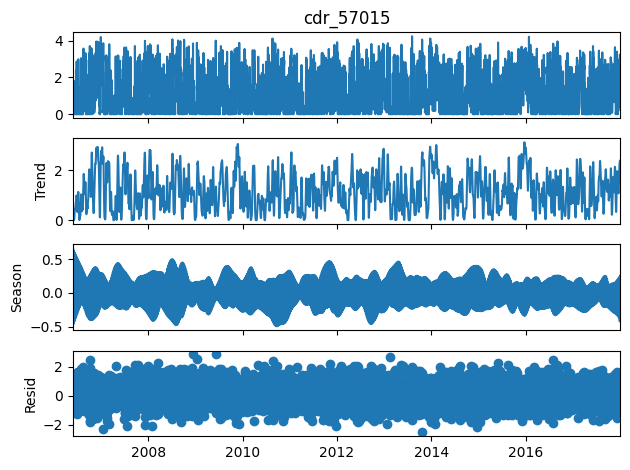

<Figure size 1500x800 with 0 Axes>

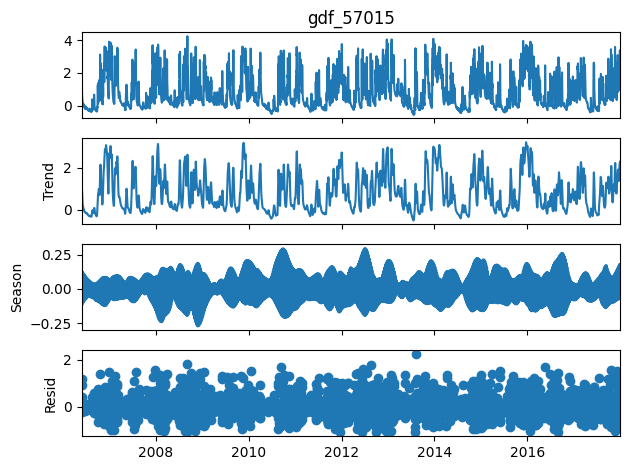

<Figure size 1500x800 with 0 Axes>

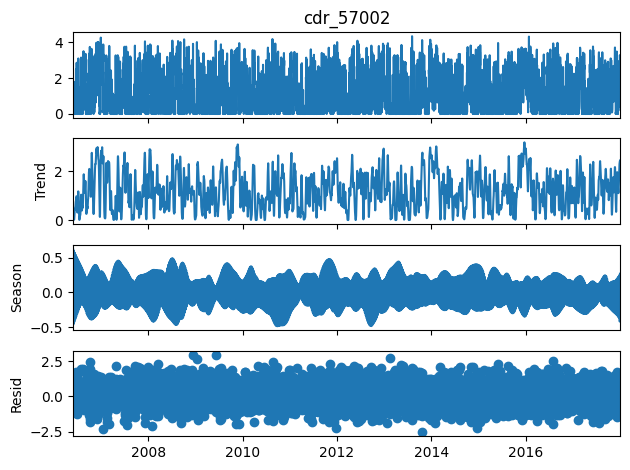

<Figure size 1500x800 with 0 Axes>

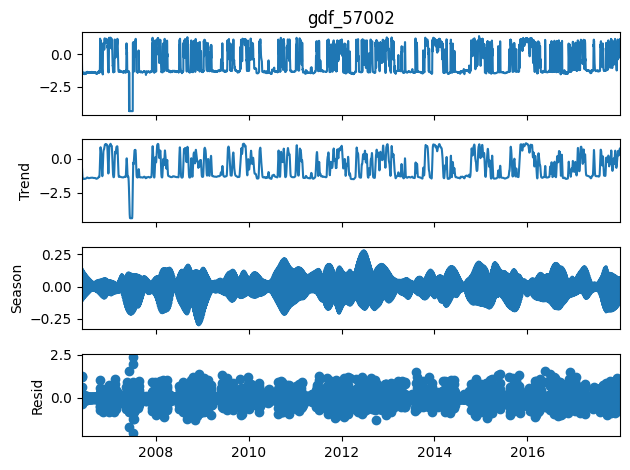

<Figure size 1500x800 with 0 Axes>

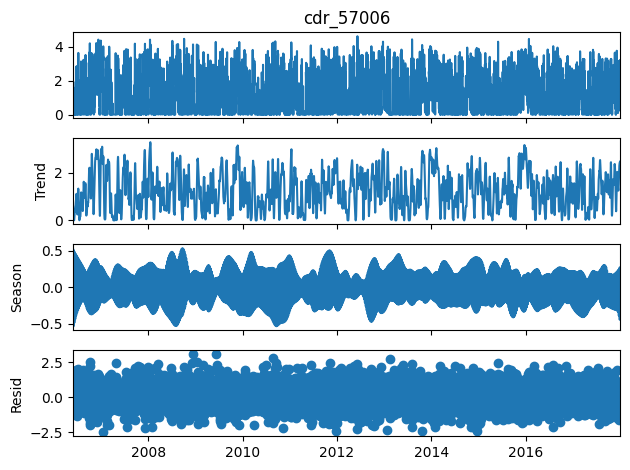

<Figure size 1500x800 with 0 Axes>

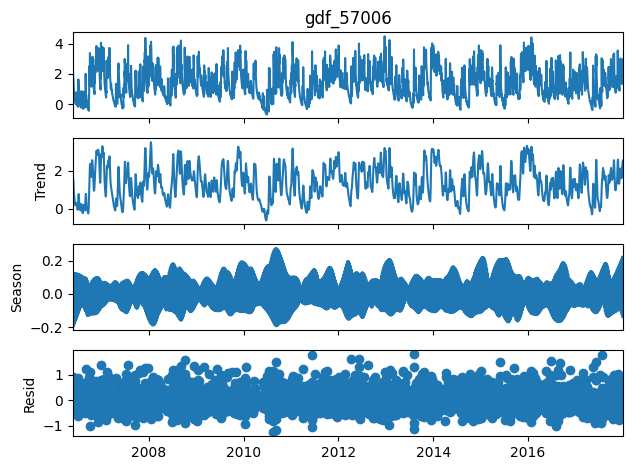

<Figure size 1500x800 with 0 Axes>

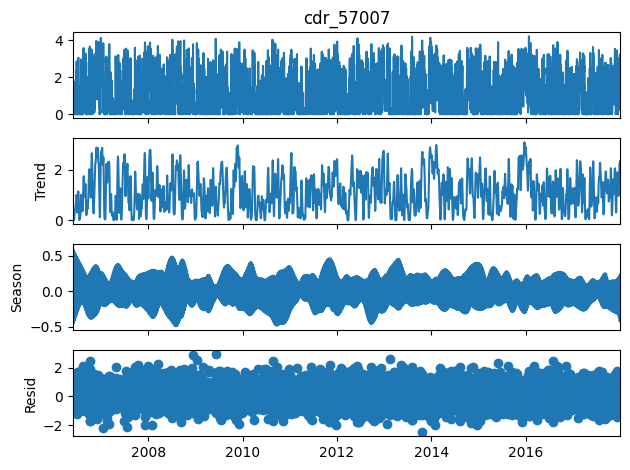

<Figure size 1500x800 with 0 Axes>

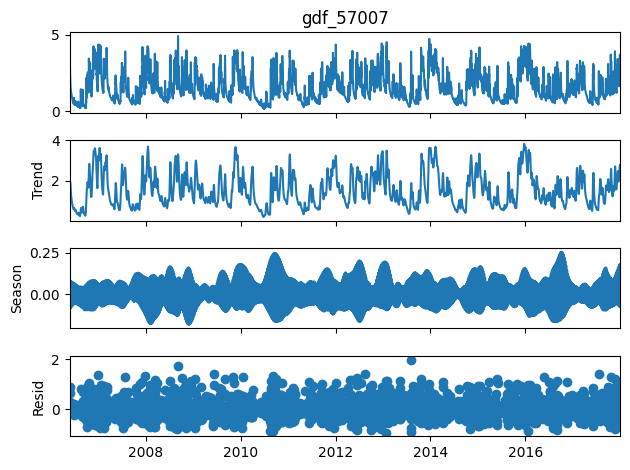

<Figure size 1500x800 with 0 Axes>

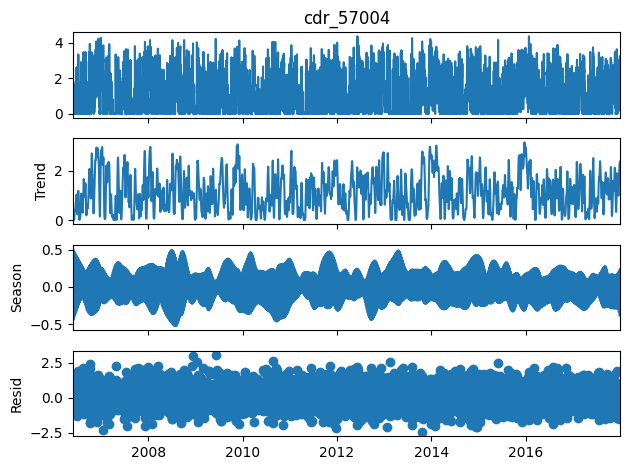

<Figure size 1500x800 with 0 Axes>

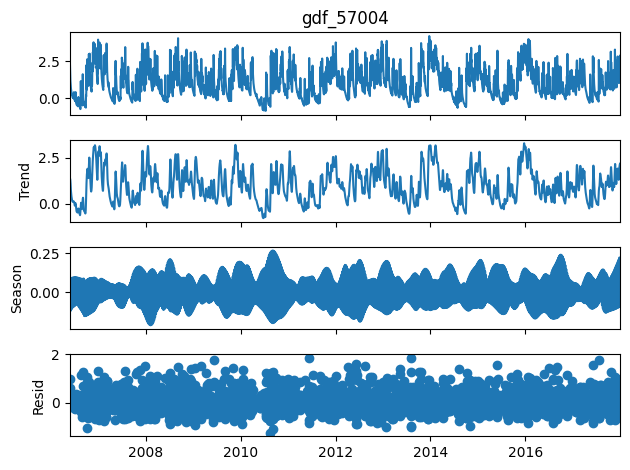

<Figure size 1500x800 with 0 Axes>

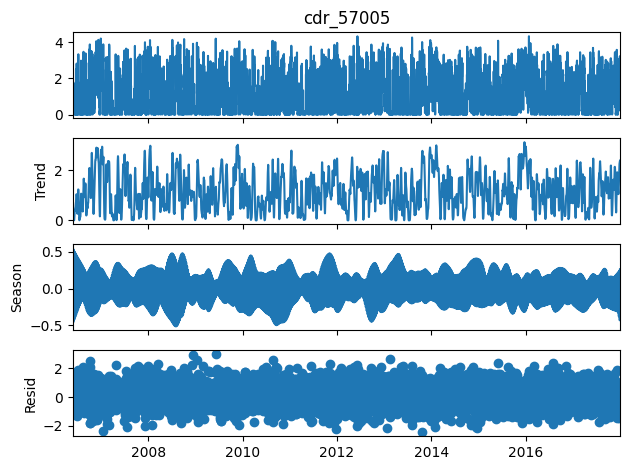

<Figure size 1500x800 with 0 Axes>

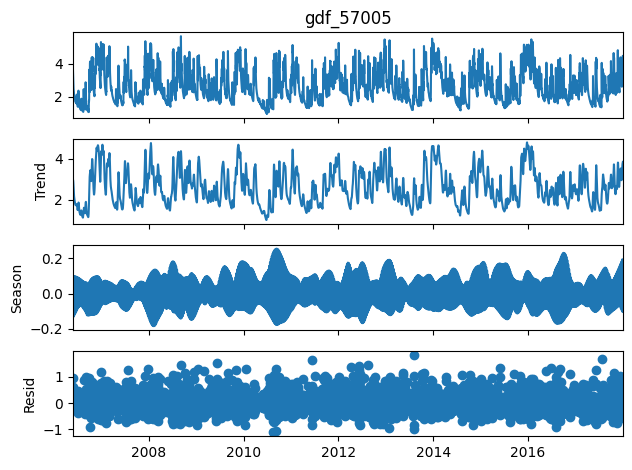

<Figure size 1500x800 with 0 Axes>

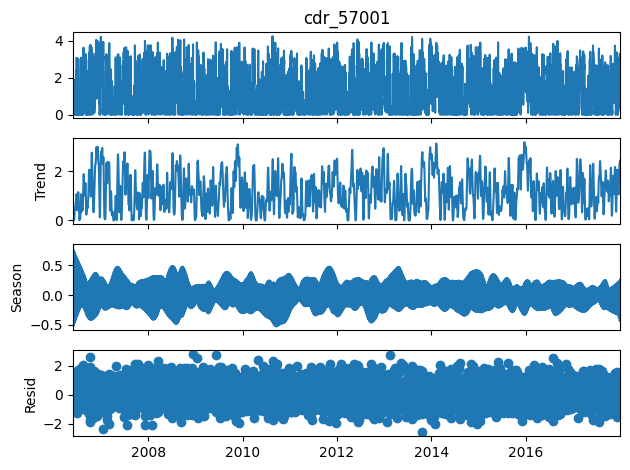

<Figure size 1500x800 with 0 Axes>

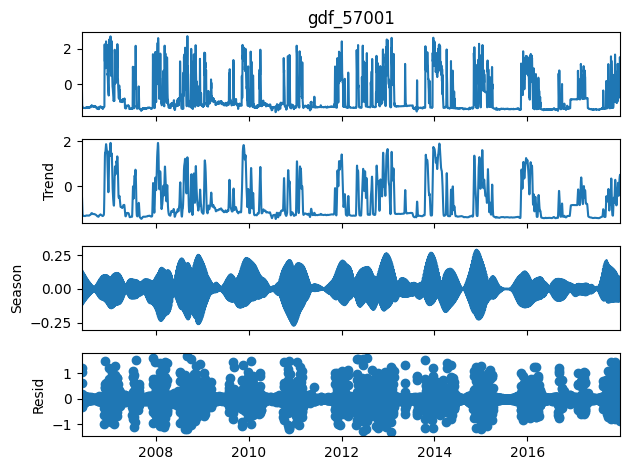

<Figure size 1500x800 with 0 Axes>

In [287]:
# Function to perform STL decomposition and plot the components
def plot_stl_decomposition(data, column, seasonal=31):
    stl = STL(data[column], seasonal=seasonal)
    result = stl.fit()
  
    fig = result.plot()
    plt.figure(figsize=(15, 8))
    plt.suptitle(f'STL Decomposition of {column}', y=1.02)
    plt.show()

# Apply STL decomposition to each column in log_transformed
for column in log_transformed_daily_df.columns:
    plot_stl_decomposition(log_transformed_daily_df, column, seasonal=31)


### 5.1.6 Seasoanl plots for last 3 year to yearly seasonality

Index(['cdr_57001', 'cdr_57002', 'cdr_57004', 'cdr_57005', 'cdr_57006',
       'cdr_57007', 'cdr_57015', 'gdf_57001', 'gdf_57002', 'gdf_57004',
       'gdf_57005', 'gdf_57006', 'gdf_57007', 'gdf_57015'],
      dtype='object')


C:\Users\c23039854\AppData\Local\Temp\ipykernel_7932\622606760.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = cm.get_cmap('tab20', len(data['Year'].unique()))


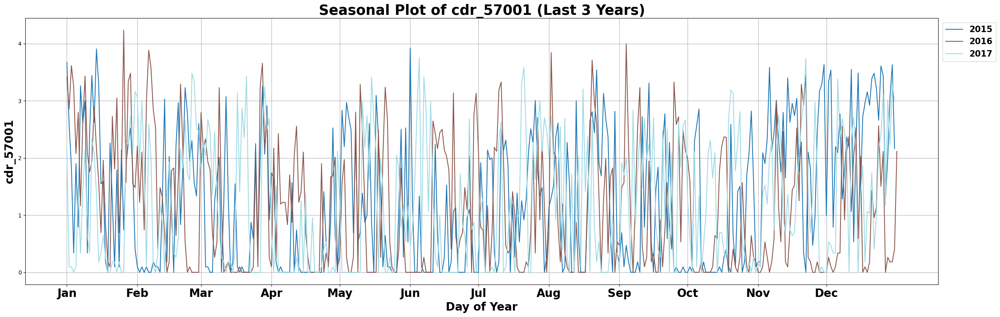

C:\Users\c23039854\AppData\Local\Temp\ipykernel_7932\622606760.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = cm.get_cmap('tab20', len(data['Year'].unique()))


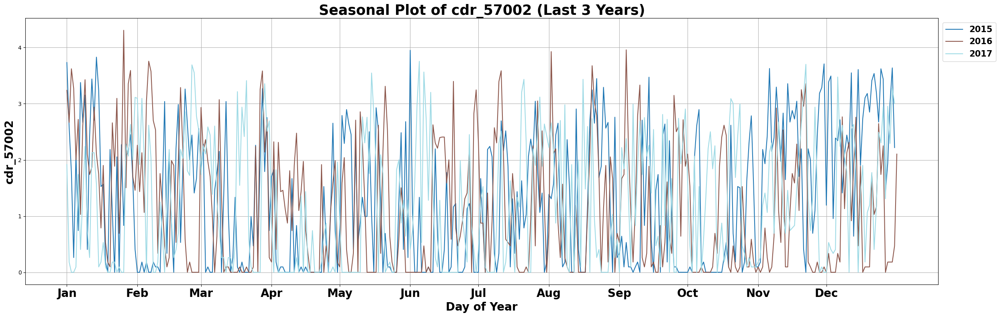

C:\Users\c23039854\AppData\Local\Temp\ipykernel_7932\622606760.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = cm.get_cmap('tab20', len(data['Year'].unique()))


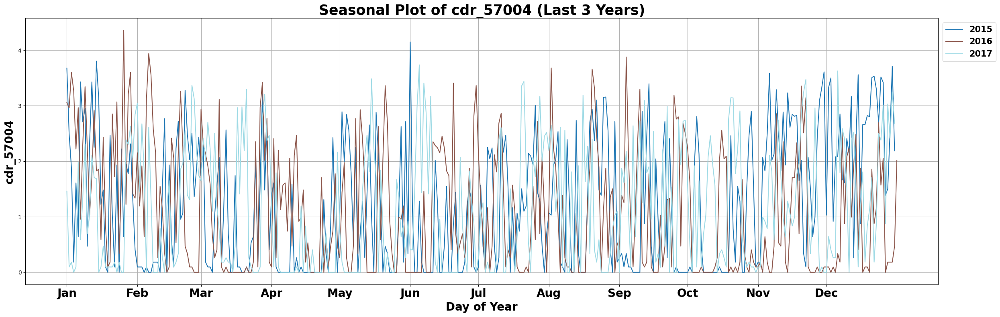

C:\Users\c23039854\AppData\Local\Temp\ipykernel_7932\622606760.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = cm.get_cmap('tab20', len(data['Year'].unique()))


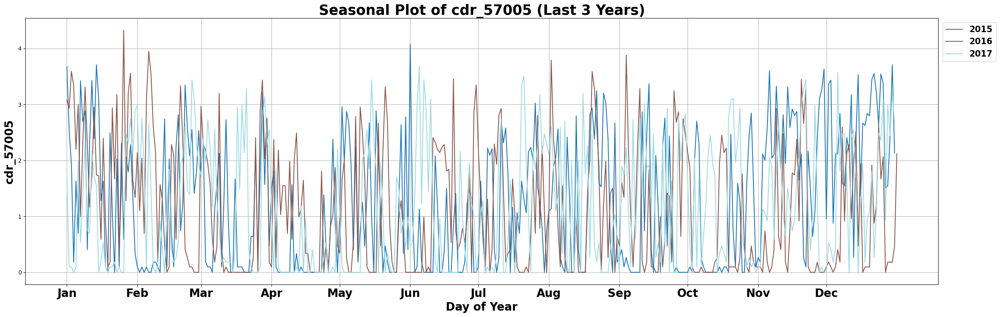

C:\Users\c23039854\AppData\Local\Temp\ipykernel_7932\622606760.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = cm.get_cmap('tab20', len(data['Year'].unique()))


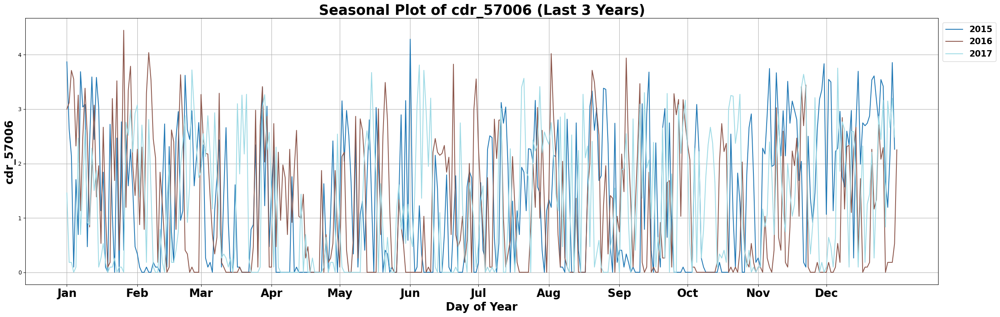

C:\Users\c23039854\AppData\Local\Temp\ipykernel_7932\622606760.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = cm.get_cmap('tab20', len(data['Year'].unique()))


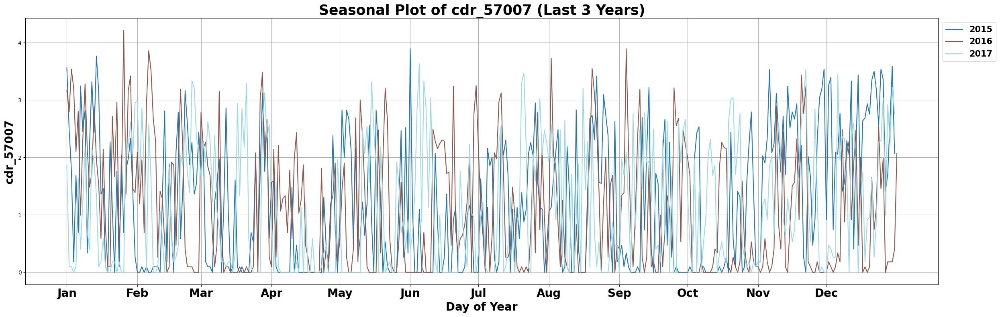

C:\Users\c23039854\AppData\Local\Temp\ipykernel_7932\622606760.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = cm.get_cmap('tab20', len(data['Year'].unique()))


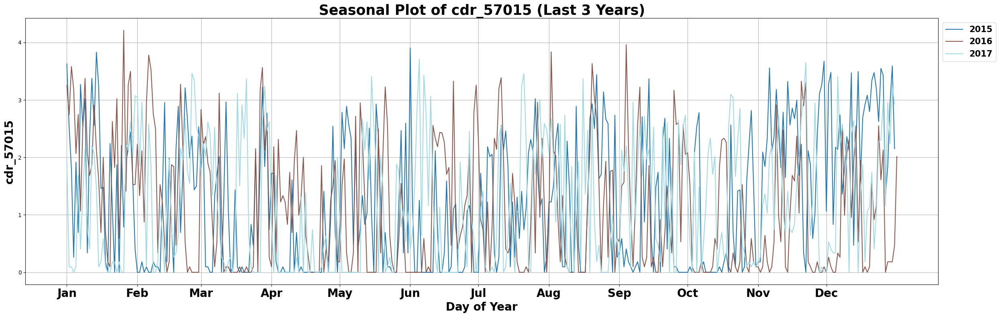

C:\Users\c23039854\AppData\Local\Temp\ipykernel_7932\622606760.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = cm.get_cmap('tab20', len(data['Year'].unique()))


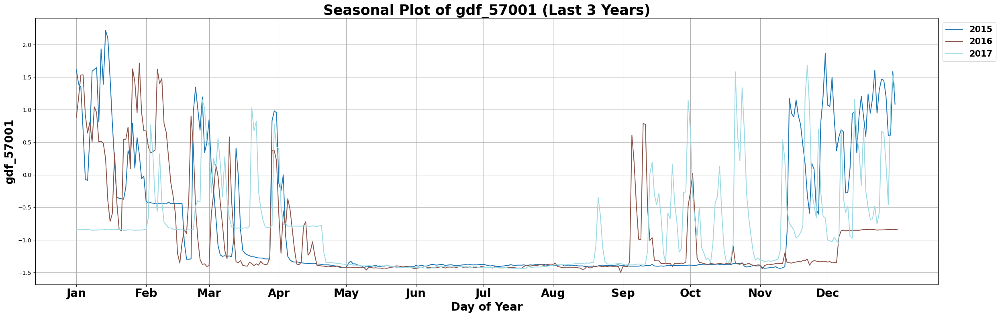

C:\Users\c23039854\AppData\Local\Temp\ipykernel_7932\622606760.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = cm.get_cmap('tab20', len(data['Year'].unique()))


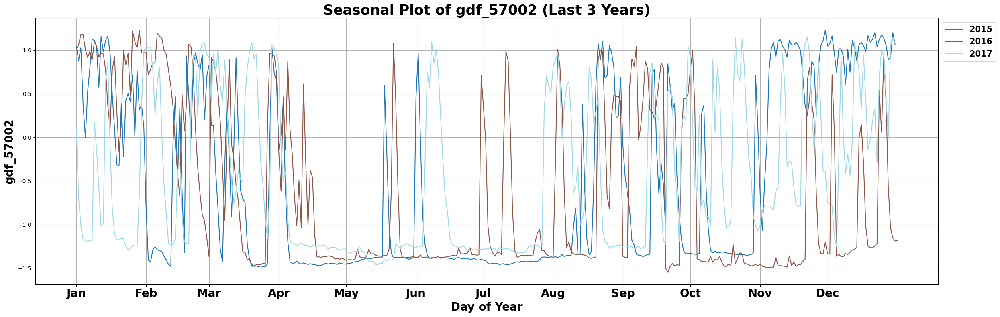

C:\Users\c23039854\AppData\Local\Temp\ipykernel_7932\622606760.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = cm.get_cmap('tab20', len(data['Year'].unique()))


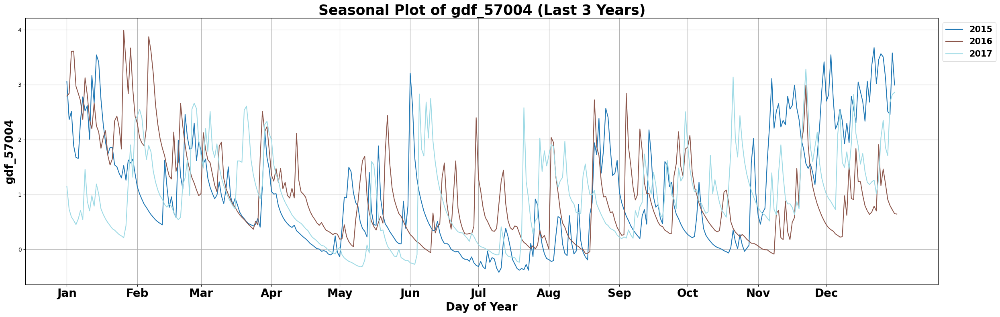

C:\Users\c23039854\AppData\Local\Temp\ipykernel_7932\622606760.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = cm.get_cmap('tab20', len(data['Year'].unique()))


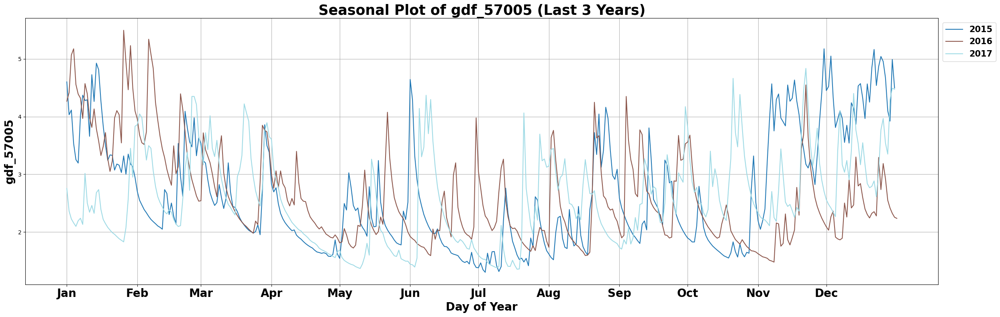

C:\Users\c23039854\AppData\Local\Temp\ipykernel_7932\622606760.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = cm.get_cmap('tab20', len(data['Year'].unique()))


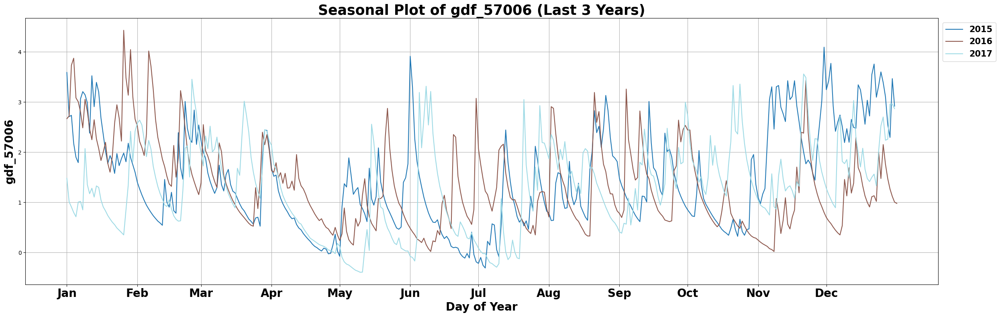

C:\Users\c23039854\AppData\Local\Temp\ipykernel_7932\622606760.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = cm.get_cmap('tab20', len(data['Year'].unique()))


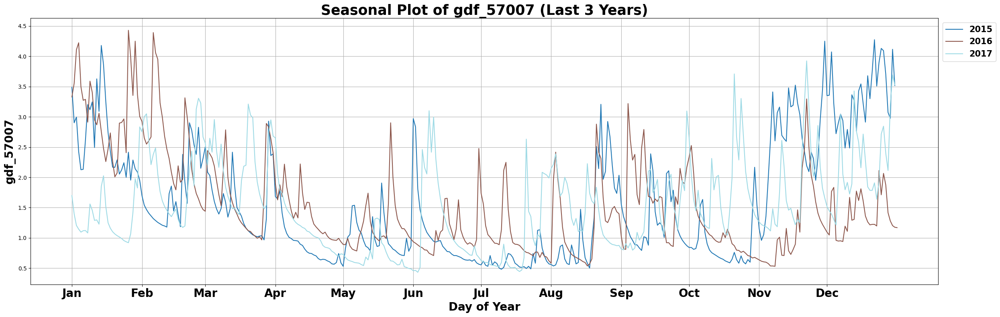

C:\Users\c23039854\AppData\Local\Temp\ipykernel_7932\622606760.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = cm.get_cmap('tab20', len(data['Year'].unique()))


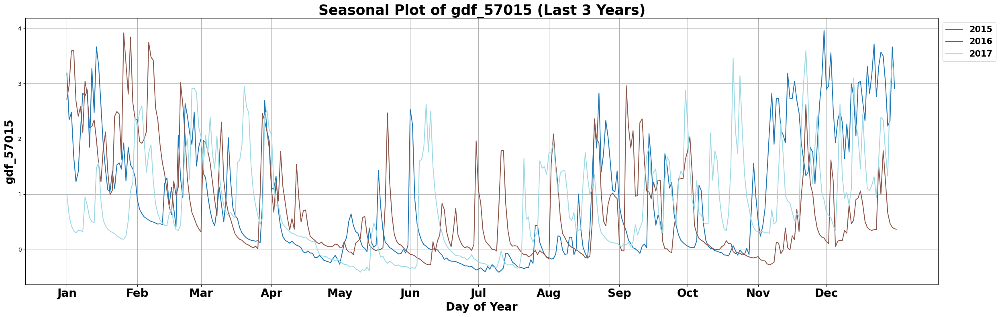

In [288]:

seasonal_plot_lg_transform_df = log_transformed_daily_df.copy()

# Ensure the index is a datetime index if it's not already
seasonal_plot_lg_transform_df.index = pd.to_datetime(log_transformed_daily_df.index)

# Extract year and day of year
seasonal_plot_lg_transform_df['Year'] = log_transformed_daily_df.index.year
seasonal_plot_lg_transform_df['DayOfYear'] = log_transformed_daily_df.index.dayofyear

# Filter the DataFrame to include only the last 5 years
last_5_years = seasonal_plot_lg_transform_df['Year'].unique()[-3:]
filtered_df = seasonal_plot_lg_transform_df[seasonal_plot_lg_transform_df['Year'].isin(last_5_years)]

# Function to plot seasonal patterns for each column
def plot_seasonal(data, column):
    plt.figure(figsize=(25, 8))

    colors = cm.get_cmap('tab20', len(data['Year'].unique()))

    for i, year in enumerate(data['Year'].unique()):
        yearly_data = data[data['Year'] == year]
        plt.plot(yearly_data['DayOfYear'], yearly_data[column], label=str(year), color=colors(i))

    # Customize the plot
    plt.title(f'Seasonal Plot of {column} (Last 3 Years)', fontsize=25, fontweight='bold')
    plt.xlabel('Day of Year', fontsize=20, fontweight='bold')
    plt.ylabel(column, fontsize=20, fontweight='bold')
    plt.legend(loc='upper left', bbox_to_anchor=(1, 1), prop={'weight': 'bold', 'size': 15})
    plt.grid(True)

    # Set x-axis to show months
    months = pd.date_range('2022-01-01', periods=12, freq='MS').strftime('%b')
    plt.xticks(ticks=pd.date_range('2022-01-01', periods=12, freq='MS').dayofyear, labels=months, fontsize=20, fontweight='bold')

    plt.tight_layout()
    plt.show()

# List of columns to plot
columns_to_plot = filtered_df.columns.difference(['Year', 'DayOfYear', 'Day', 'Month'])
print(columns_to_plot)
# Plot seasonal patterns for all columns
for column in columns_to_plot:
    plot_seasonal(filtered_df, column)


### 5.1.7 Correlation after applied log transformation

C:\Program Files\Python311\Lib\site-packages\seaborn\matrix.py:260: FutureWarning: Format strings passed to MaskedConstant are ignored, but in future may error or produce different behavior
  annotation = ("{:" + self.fmt + "}").format(val)


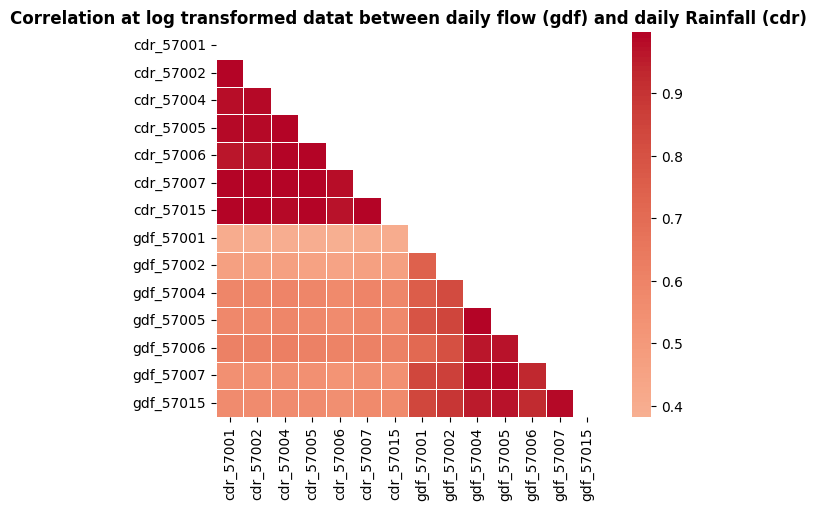

In [289]:
def correlation_transformed_data(log_transformed_daily_df):
    # Calculate the correlation matrix
    correlation_matrix = log_transformed_daily_df.corr()
    
    # Reorder the columns to group flows and rainfall together
    columns_order = sorted(correlation_matrix.columns, key=lambda x: ('gdf' in x, x))
    correlation_matrix = correlation_matrix.loc[columns_order, columns_order]
    
    # Create a mask for the upper triangle
    mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))
    
    # Set up the matplotlib figure
    plt.figure(figsize=(8, 5))
    
    # Draw the heatmap with the mask and correct aspect ratio
    sns.heatmap(correlation_matrix, mask=mask, annot=True, fmt=".2f", cmap='coolwarm', center=0, square=True, linewidths=.5)
    
    plt.title('Correlation at log transformed datat between daily flow (gdf) and daily Rainfall (cdr)', fontweight = 'bold')
    plt.show()
correlation_transformed_data(log_transformed_daily_df)

## 5.2 Removing Seasonal Component From Data (Deaseasonalised)

In [290]:

log_transformed_deseasonalised_df = pd.DataFrame()
seasonal_component = pd.DataFrame()

def remove_seasonality(data, column, seasonal=7):
    stl = STL(data[column], seasonal=seasonal)
    result = stl.fit()
    #deseasonalized = result.trend+ result.resid
    deseasonalized = data[column]-result.seasonal
    if column == 'gdf_57005':
        seasonal_component[column] = result.seasonal
        
    return deseasonalized

# Apply STL decomposition and remove seasonality for each column
for column in log_transformed_daily_df.columns:
    log_transformed_deseasonalised_df[column] = remove_seasonality(log_transformed_daily_df, column, seasonal=31)
log_transformed_deseasonalised_df

,cdr_57015,gdf_57015,cdr_57002,gdf_57002,cdr_57006,gdf_57006,cdr_57007,gdf_57007,cdr_57004,gdf_57004,cdr_57005,gdf_57005,cdr_57001,gdf_57001
date,,,,,,,,,,,,,,
2006-05-26,1.749700,2.327643,1.785806,0.754251,2.225120,2.616457,1.644574,2.919823,1.665245,2.384412,1.865704,3.983966,1.820731,0.938144
2006-05-27,1.745579,2.042113,1.727390,0.714917,1.903236,2.200435,1.659615,2.665458,1.623048,1.986871,1.720974,3.627108,1.828130,0.731621
2006-05-28,-0.253873,1.484956,-0.227146,0.066930,-0.125082,1.854863,-0.270549,2.253597,-0.179606,1.588601,-0.213847,3.264527,-0.256210,0.234457
2006-05-29,0.561084,1.098325,0.622269,-0.498503,0.675792,1.633466,0.427890,1.976115,0.561374,1.319143,0.507327,2.971025,0.559282,-0.240077
2006-05-30,-0.099531,0.797947,-0.098581,-0.948531,-0.105807,1.460125,-0.129200,1.809332,-0.156170,1.163237,-0.135388,2.778926,-0.096096,-0.641396
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-12-27,1.014468,1.573660,1.132699,0.397371,0.742429,2.014671,0.840307,2.217607,0.731142,1.632302,0.795990,3.346512,1.043094,0.063088
2017-12-28,2.866306,1.359314,2.897908,-0.072686,3.139095,2.229063,2.857052,2.117720,2.998491,1.703447,2.969961,3.338691,2.901009,-0.475739
2017-12-29,2.660230,2.931534,2.713282,1.018095,3.104791,3.100478,2.695649,3.273190,2.805380,2.759087,2.874479,4.401120,2.659968,1.076259


## 5.3 Applied Box-cox Transformation over original cleaned data

In [291]:
boxcox_transformed_df = merge_allfilter_df.copy()
boxcox_lambdas = {}
for column in merge_allfilter_df.columns:
    # Shift the data to be strictly positive if necessary
    data = merge_allfilter_df[column]
    if any(data <= 0):
        shift = abs(min(data)) + 1  # Ensure all data is positive
        data = data + shift
    
    # Apply Box-Cox transformation and store the lambda value
    boxcox_transformed, lam = boxcox(data)
    boxcox_transformed_df[column] = boxcox_transformed
    boxcox_lambdas[column] = lam  # Store the lambda value for this column

print(boxcox_transformed_df)

# Function to reverse Box-Cox transformation after final prediction
def inverse_boxcox(y, lam):
    if lam == 0:
        return np.exp(y)
    else:
        return np.exp(np.log(lam * y + 1) / lam)

            cdr_57015  gdf_57015  cdr_57002  gdf_57002  cdr_57006  gdf_57006   
date                                                                           
2006-05-26   1.118422   1.326452   1.160551   0.868102   1.450299   2.010908  \
2006-05-27   1.405584   1.241961   1.425055   0.826591   1.560249   1.869398   
2006-05-28   0.375639   1.014665   0.377181   0.103816   0.377897   1.631242   
2006-05-29   0.646107   0.815234   0.719329  -0.540064   0.783380   1.468094   
2006-05-30   0.000000   0.614570   0.000000  -1.082026   0.000000   1.314259   
...               ...        ...        ...        ...        ...        ...   
2017-12-27   0.939210   1.110756   1.042718   0.459093   0.722063   1.815569   
2017-12-28   1.771528   0.931736   1.816631  -0.014109   1.904274   1.828529   
2017-12-29   1.505824   1.412095   1.559175   1.025161   1.728169   2.251527   
2017-12-30   1.859694   1.503439   1.921291   1.080983   1.920734   2.251527   
2017-12-31   1.762946   1.451380   1.833

In [292]:
# Check for negative values
negative_values_exist = (boxcox_transformed_df < 0).any()

# Check for zero values
zero_values_exist = (boxcox_transformed_df == 0).any()

# Print the results
print("Negative values exist:", negative_values_exist)
print("Zero values exist:", zero_values_exist)


Negative values exist: cdr_57015    False
gdf_57015     True
cdr_57002    False
gdf_57002     True
cdr_57006    False
gdf_57006     True
cdr_57007    False
gdf_57007    False
cdr_57004    False
gdf_57004     True
cdr_57005    False
gdf_57005    False
cdr_57001    False
gdf_57001     True
dtype: bool
Zero values exist: cdr_57015     True
gdf_57015     True
cdr_57002     True
gdf_57002     True
cdr_57006     True
gdf_57006     True
cdr_57007     True
gdf_57007    False
cdr_57004     True
gdf_57004     True
cdr_57005     True
gdf_57005    False
cdr_57001     True
gdf_57001     True
dtype: bool


### 5.3.1 Box Plot at after applied box-cox Transformation over original cleaned data

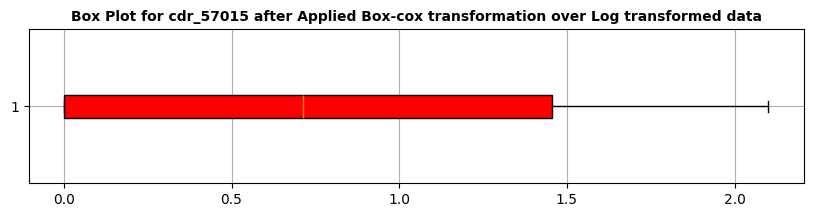

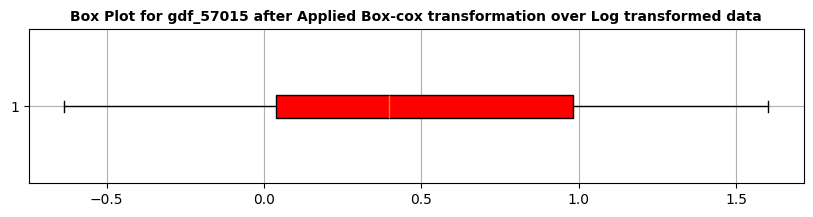

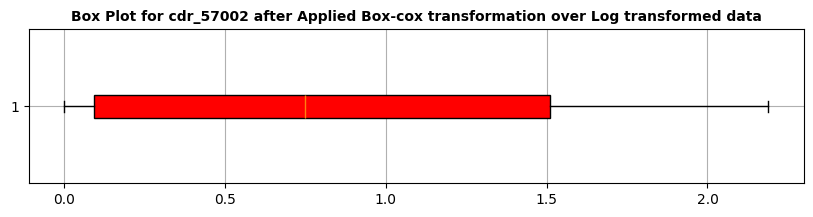

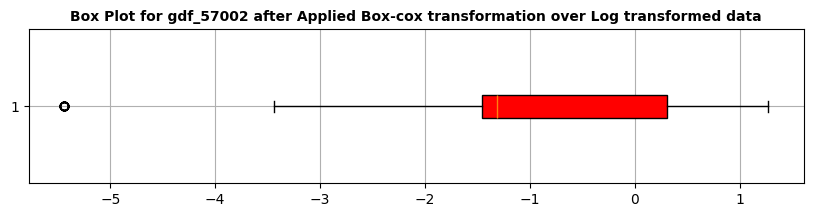

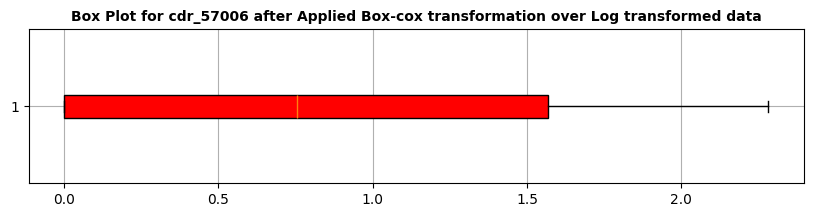

...

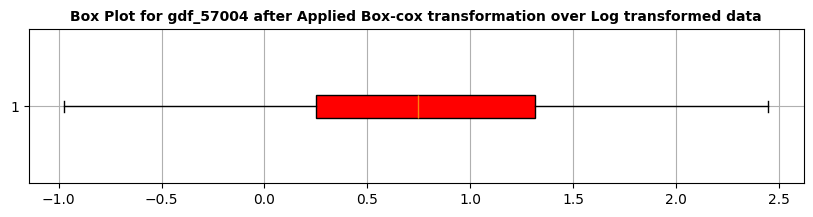

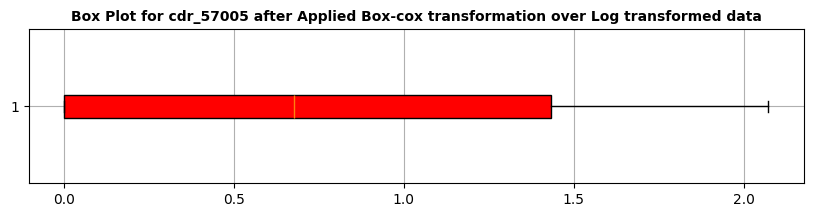

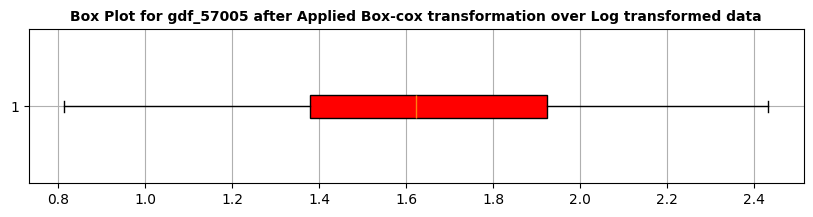

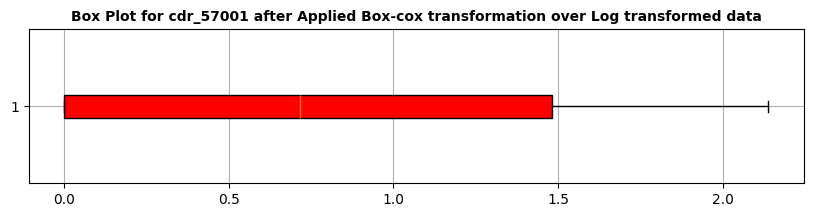

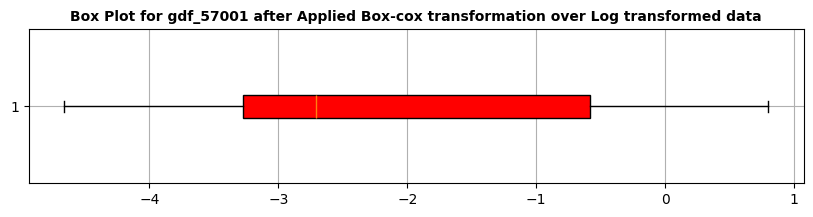

In [293]:
for column in boxcox_transformed_df.columns:
    plt.figure(figsize=(10, 2))
    plt.boxplot(
        boxcox_transformed_df[column].dropna(),
        vert=False,
        patch_artist=True,
        boxprops=dict(facecolor="Red")
    )
    plt.title(f'Box Plot for {column} after Applied Box-cox transformation over Log transformed data', fontsize ='10', fontweight ='bold')
    #plt.xlabel('CDR')
    plt.grid(True)
    plt.show()

### 5.3.2 Distribution plot after applied box-cox transformation over original cleaned data

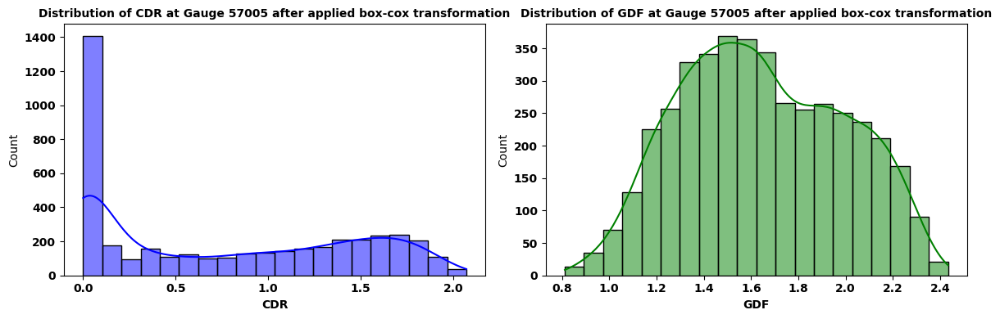

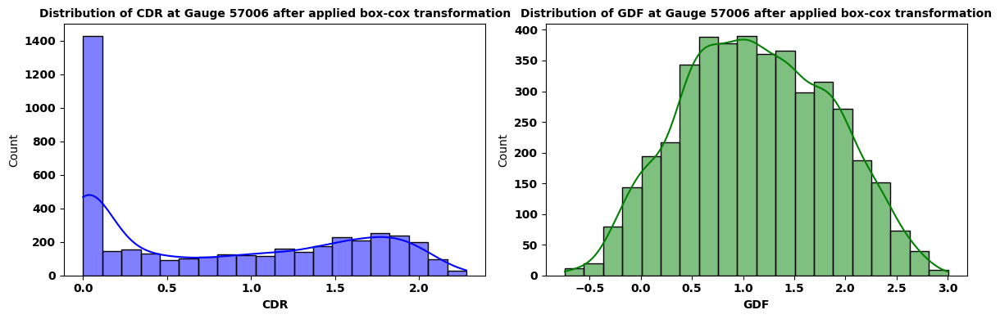

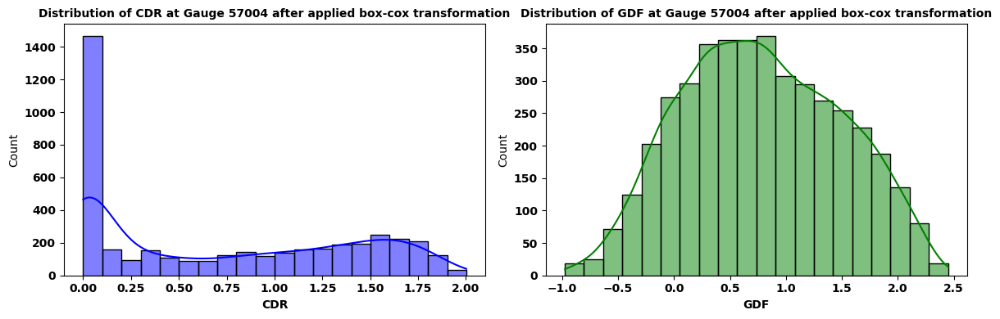

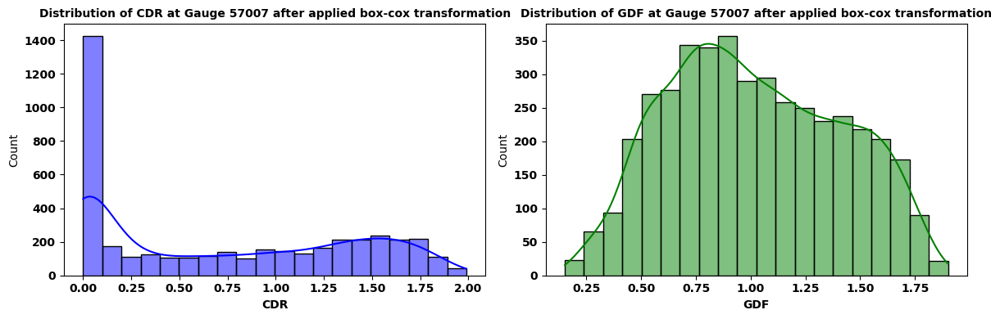

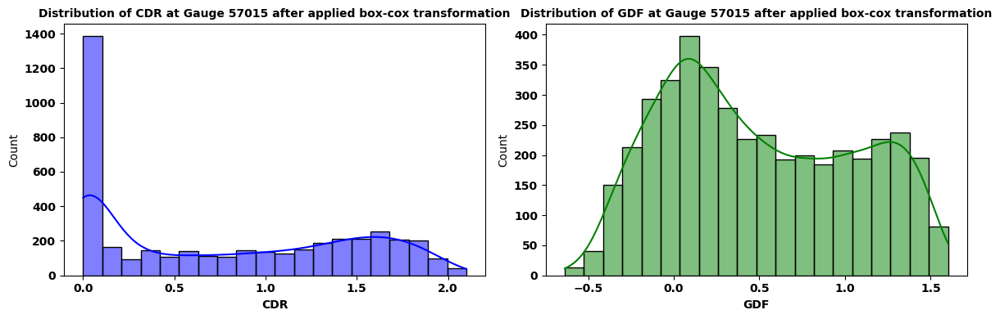

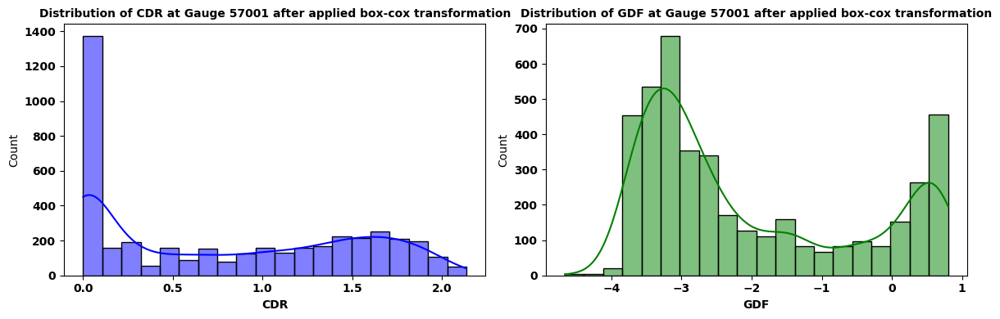

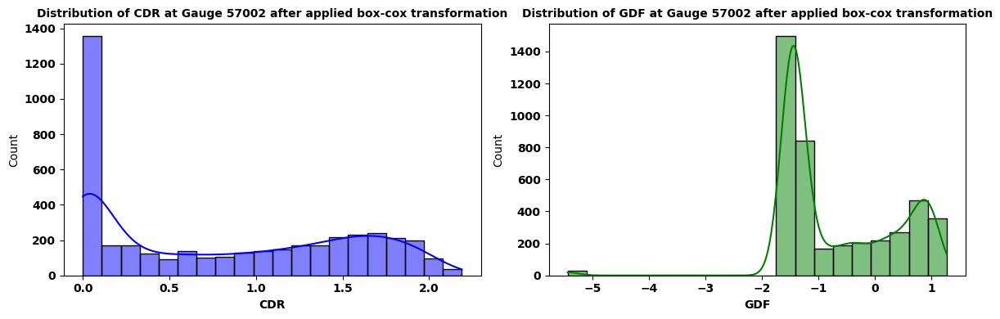

In [294]:

# List of gauge IDs
gauges = ['57005', '57006', '57004', '57007', '57015', '57001', '57002']

# Loop over each gauge to create the plots
for gauge in gauges:
    plt.figure(figsize=(12, 4))

    # Plot CDR histogram
    plt.subplot(1, 2, 1)
    sns.histplot(boxcox_transformed_df[f'cdr_{gauge}'], bins=20, kde=True, color='blue')
    plt.title(f'Distribution of CDR at Gauge {gauge} after applied box-cox transformation', fontsize ='10', fontweight ='bold')
    plt.xlabel('CDR', fontsize ='10', fontweight ='bold')
    plt.xticks(fontsize ='10', fontweight ='bold')
    plt.yticks(fontsize ='10', fontweight ='bold')

    # Plot GDF histogram
    plt.subplot(1, 2, 2)
    sns.histplot(boxcox_transformed_df[f'gdf_{gauge}'], bins=20, kde=True, color='green')
    plt.title(f'Distribution of GDF at Gauge {gauge} after applied box-cox transformation', fontsize ='10', fontweight ='bold')
    plt.xlabel('GDF', fontsize ='10', fontweight ='bold')
    plt.xticks(fontsize ='10', fontweight ='bold')
    plt.yticks(fontsize ='10', fontweight ='bold')

    # Adjust layout and show the plot
    plt.tight_layout()
    plt.show()


## 5.4 Autocorrelation Function and Partial Auto-correlation function at log transformed data

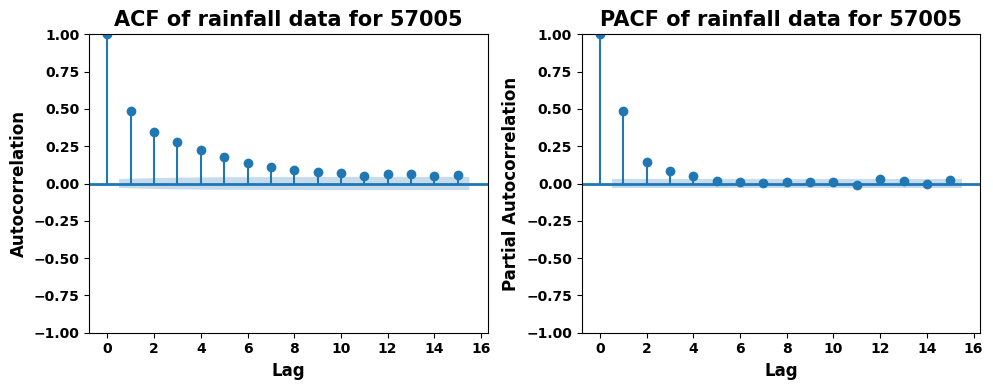

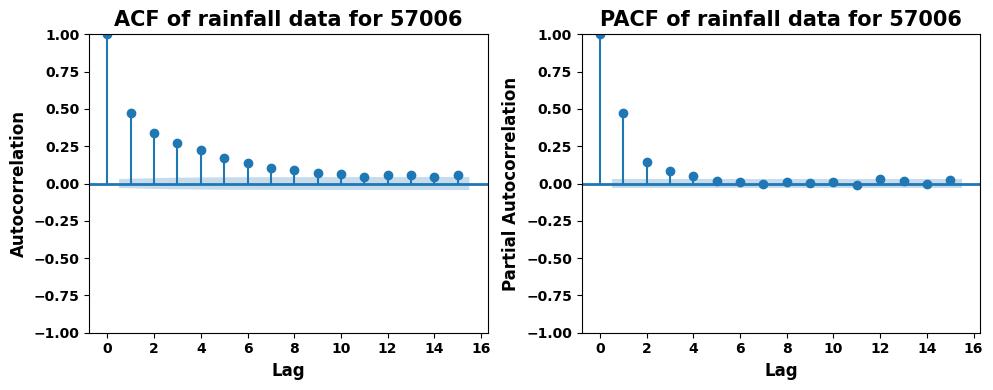

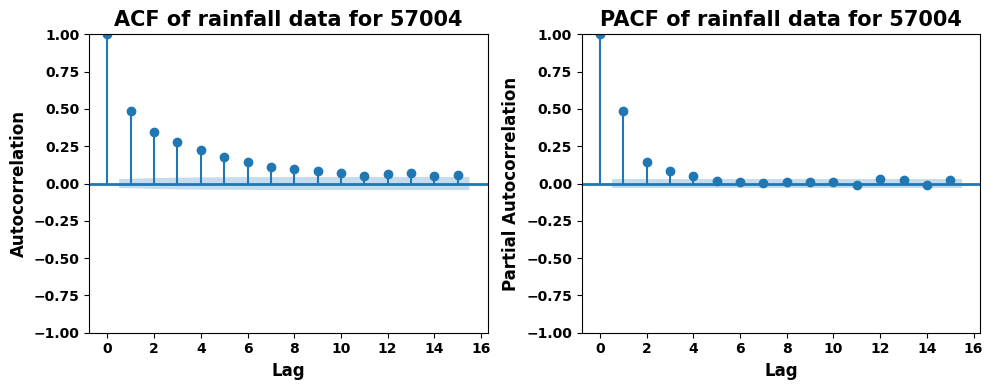

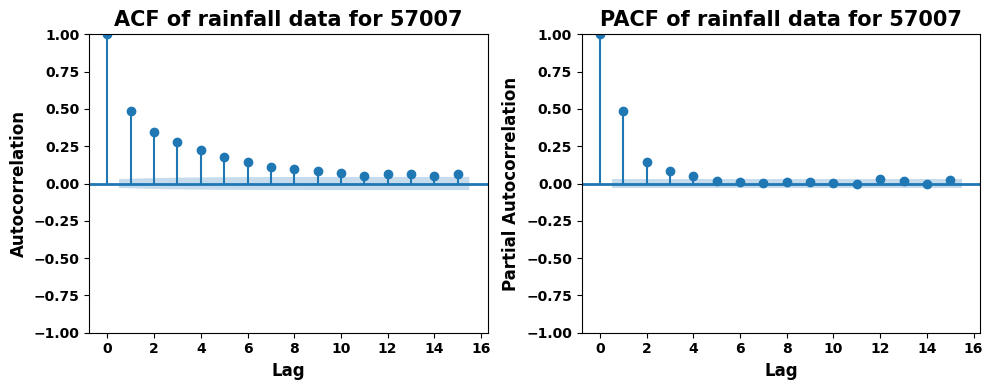

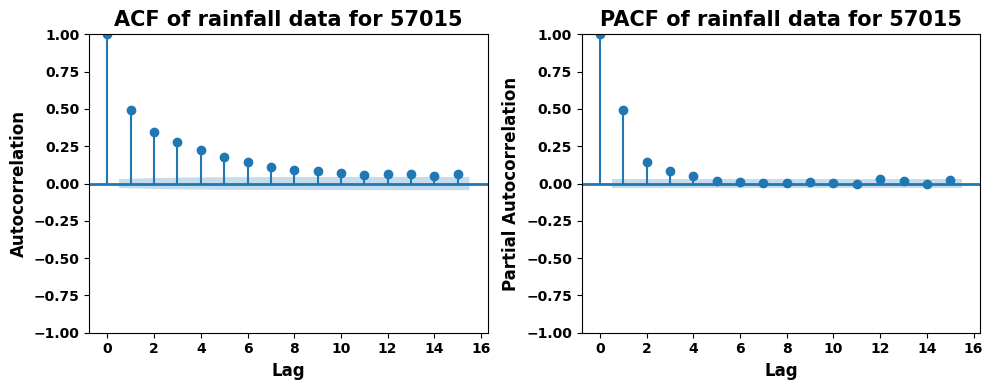

...

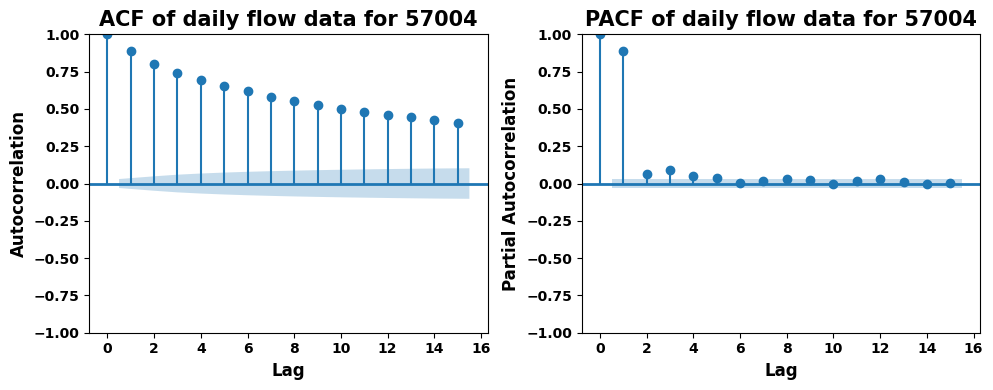

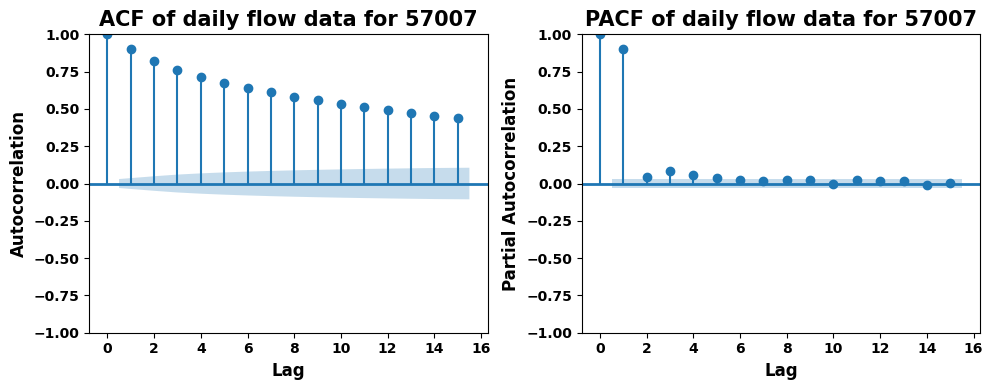

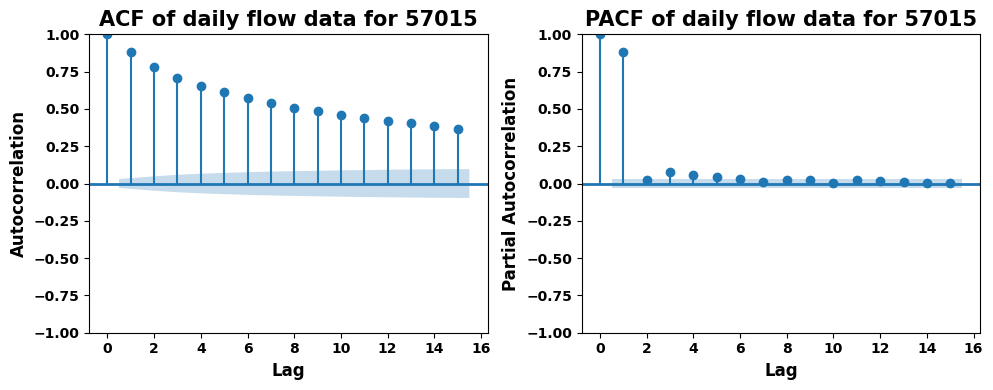

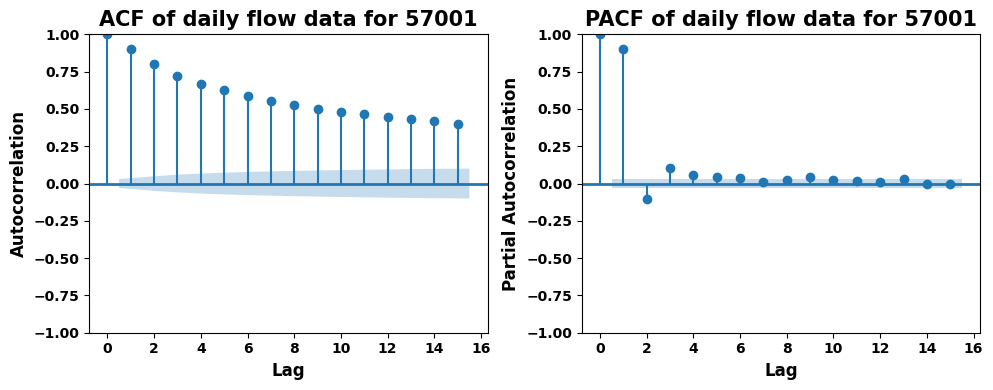

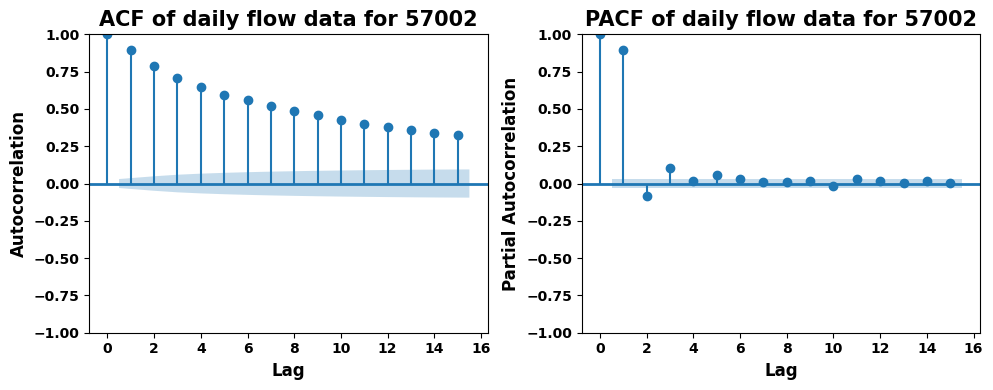

In [295]:
# Function to plot ACF and PACF for a given gauge as subplots
def plot_acf_pacf_cdr(data, gauge_ids, lags=15):
    for gauge_id in gauge_ids:
        fig, ax = plt.subplots(1, 2, figsize=(10, 4))
    
        # Plot ACF
        plot_acf(data[f'cdr_{gauge_id}'], lags=lags, ax=ax[0])
        ax[0].set_xlabel('Lag', fontsize=12, fontweight='bold')
        ax[0].set_ylabel('Autocorrelation', fontsize=12, fontweight='bold')
        ax[0].set_title(f'ACF of rainfall data for {gauge_id}', fontsize=15, fontweight='bold')
    
        # Plot PACF
        plot_pacf(data[f'cdr_{gauge_id}'], lags=lags, ax=ax[1])
        ax[1].set_xlabel('Lag', fontsize=12, fontweight='bold')
        ax[1].set_ylabel('Partial Autocorrelation', fontsize=12, fontweight='bold')
        ax[1].set_title(f'PACF of rainfall data for {gauge_id}', fontsize=15, fontweight='bold')
        for axis in ax:
            plt.setp(axis.get_xticklabels(), fontweight='bold')
            plt.setp(axis.get_yticklabels(), fontweight='bold')
            for line in axis.get_lines():
                line.set_linewidth(2)
                line.set_markersize(6)
        plt.tight_layout()
        plt.show()

def plot_acf_pacf_gdf(data, gauge_ids, lags=15):
    for gauge_id in gauge_ids:
        fig, ax = plt.subplots(1, 2, figsize=(10, 4))
    
        # Plot ACF
        plot_acf(data[f'gdf_{gauge_id}'], lags=lags, ax=ax[0])
        ax[0].set_xlabel('Lag', fontsize=12, fontweight='bold')
        ax[0].set_ylabel('Autocorrelation', fontsize=12, fontweight='bold')
        ax[0].set_title(f'ACF of daily flow data for {gauge_id}', fontsize=15, fontweight='bold')
    
        # Plot PACF
        plot_pacf(data[f'gdf_{gauge_id}'], lags=lags, ax=ax[1])
        ax[1].set_xlabel('Lag', fontsize=12, fontweight='bold')
        ax[1].set_ylabel('Partial Autocorrelation', fontsize=12, fontweight='bold')
        ax[1].set_title(f'PACF of daily flow data for {gauge_id}', fontsize=15, fontweight='bold')
        for axis in ax:
            plt.setp(axis.get_xticklabels(), fontweight='bold')
            plt.setp(axis.get_yticklabels(), fontweight='bold')
            for line in axis.get_lines():
                line.set_linewidth(2)
                line.set_markersize(6)
        plt.tight_layout()
        plt.show()

# List of gauge IDs
gauge_ids = ['57005', '57006', '57004', '57007', '57015', '57001', '57002']

# Plot ACF and PACF for each gauge as subplots

plot_acf_pacf_cdr(log_transformed_daily_df, gauge_ids)
plot_acf_pacf_gdf(log_transformed_daily_df, gauge_ids)

# 6. Model Building and Evaluation and optimization

## 6.0 Train Test Split data

In [296]:
# Function to create lagged features with different lags for each column
def lagged_datas(df, lags_dict, target_var):
    lagged = pd.DataFrame()
    for col, lags in lags_dict.items():
        if col != target_var:
            for lag in range(1, lags + 1):
                lagged[f'{col}_lag_{lag}'] = df[col].shift(lag)
    return lagged

# lags_dict which consider by pacf plot
lags_dict = {
    'cdr_57002': 4,
    'gdf_57002': 5,
    'cdr_57015': 4,
    'gdf_57015': 5,
    'cdr_57006': 4,
    'gdf_57006': 5,
    'cdr_57007': 4,
    'gdf_57007': 5,
    'cdr_57004': 4,
    'gdf_57004': 5,
    'cdr_57001': 4,
    'gdf_57001': 5,
    'cdr_57005': 4,
}      

target_col = 'gdf_57005'

# creating lagged data log_transformed_daily_df is your dataframe
lag_features = lagged_datas(log_transformed_daily_df, lags_dict, target_col)

# Merge the lagged features with the target variable
data_with_lags = pd.concat([log_transformed_daily_df[target_col], lag_features], axis=1).dropna()

np.random.seed(42)
random.seed(42)
tf.random.set_seed(42)
torch.manual_seed(42)
X = data_with_lags.drop(columns=[target_col])
y = data_with_lags[target_col]

# Split the data into train and test sets
X_train_ss, X_test_ss, y_train_ss, y_test_ss = train_test_split(X, y, test_size=0.3, random_state=42)


## 6.1 model building at log transformed data

### 6.1.0 Automatic Stepwise selection of linear model by using p-value

In [297]:
# Stepwise selection function
def stepwise_selection(X, y, initial_features=[], threshold_in=0.05, threshold_out=0.05, verbose=True):
    included = list(initial_features)
    while True:
        changed = False
        # Forward step
        excluded = list(set(X.columns) - set(included))
        new_pval = pd.Series(index=excluded)
        for new_column in excluded:
            model = sm.OLS(y, sm.add_constant(pd.DataFrame(X[included + [new_column]]))).fit()
            new_pval[new_column] = model.pvalues[new_column]
        best_pval = new_pval.min()
        if best_pval < threshold_in:
            best_feature = new_pval.idxmin()
            included.append(best_feature)
            changed = True
            if verbose:
                print(f'Add {best_feature} with p-value {best_pval}')

        # Backward step
        model = sm.OLS(y, sm.add_constant(pd.DataFrame(X[included]))).fit()
        # Use all coefs except intercept
        pvalues = model.pvalues.iloc[1:]
        worst_pval = pvalues.max()
        if worst_pval > threshold_out:
            worst_feature = pvalues.idxmax()
            included.remove(worst_feature)
            changed = True
            if verbose:
                print(f'Drop {worst_feature} with p-value {worst_pval}')

        if not changed:
            break

    return included



# Cross-Validation with the selected features
def cross_validate_selected_features(X_train, y_train, selected_features, cv_folds=5):
    # Create KFold object for cross-validation
    kf = KFold(n_splits=cv_folds, shuffle=True, random_state=42)
    
    cv_mse_scores = []
    cv_r2_scores = []
    cv_mape_scores = []

    # Iterate through each fold
    for train_index, val_index in kf.split(X_train):
        X_train_fold, X_val_fold = X_train.iloc[train_index][selected_features], X_train.iloc[val_index][selected_features]
        y_train_fold, y_val_fold = y_train.iloc[train_index], y_train.iloc[val_index]

        # Fit the model on the training fold
        model = sm.OLS(y_train_fold, sm.add_constant(X_train_fold)).fit()

        # Predict on the validation fold
        y_val_pred = model.predict(sm.add_constant(X_val_fold))

        # Calculate metrics
        mse = mean_squared_error(y_val_fold, y_val_pred)
        r2 = r2_score(y_val_fold, y_val_pred)
        mape = mean_absolute_percentage_error(y_val_fold, y_val_pred)

        # Store the scores
        cv_mse_scores.append(mse)
        cv_r2_scores.append(r2)
        cv_mape_scores.append(mape)

    # Return the average scores across all folds
    return {
        'CV MSE': np.mean(cv_mse_scores),
        'CV MSE Std': np.std(cv_mse_scores),
        'CV R-squared': np.mean(cv_r2_scores),
        'CV R-squared Std': np.std(cv_r2_scores),
        'CV MAPE': np.mean(cv_mape_scores),
        'CV MAPE Std': np.std(cv_mape_scores),
    }

# Perform stepwise selection on the complete data 
selected_features = stepwise_selection(X, y) 
print('Selected features:', selected_features)


Add gdf_57015_lag_1 with p-value 0.0
Add gdf_57004_lag_1 with p-value 2.421063261975215e-215
Add cdr_57006_lag_1 with p-value 1.2829484800520344e-135
Add gdf_57007_lag_2 with p-value 2.3175207516307374e-97
Drop gdf_57015_lag_1 with p-value 0.983887994703905
Add gdf_57006_lag_4 with p-value 5.8560969647892124e-36
Add gdf_57004_lag_5 with p-value 9.513174156142404e-09
Add cdr_57004_lag_1 with p-value 7.513087002623435e-09
Drop cdr_57006_lag_1 with p-value 0.13326495230410498
Add gdf_57006_lag_1 with p-value 1.1689552861736986e-05
Add cdr_57001_lag_2 with p-value 0.00011766686747977468
Add gdf_57006_lag_5 with p-value 0.0007424243071222715
Add cdr_57015_lag_4 with p-value 0.0013533336852687191
Add cdr_57005_lag_1 with p-value 0.00246104498091304
Add gdf_57002_lag_1 with p-value 0.0031495100665920204
Add gdf_57004_lag_2 with p-value 0.0009642010267849611
Add gdf_57002_lag_4 with p-value 0.020863602613754195
Add gdf_57007_lag_5 with p-value 0.0471231839888976
Add gdf_57015_lag_5 with p-valu

### 6.1.1 Linear Regression

                            OLS Regression Results                            
Dep. Variable:              gdf_57005   R-squared:                       0.850
Model:                            OLS   Adj. R-squared:                  0.849
Method:                 Least Squares   F-statistic:                     1041.
Date:                Fri, 06 Sep 2024   Prob (F-statistic):               0.00
Time:                        21:38:53   Log-Likelihood:                -1168.6
No. Observations:                2963   AIC:                             2371.
Df Residuals:                    2946   BIC:                             2473.
Df Model:                          16                                         
Covariance Type:            nonrobust                                         
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const               1.4729      0.069     

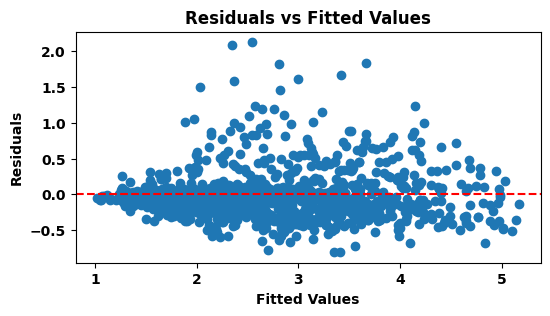

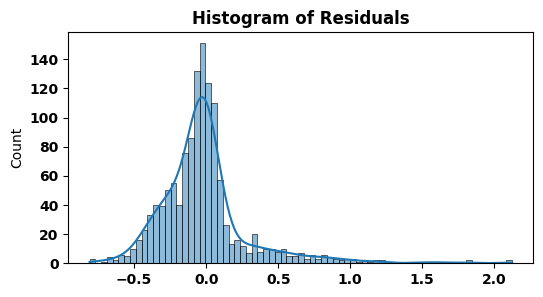

<Figure size 600x300 with 0 Axes>

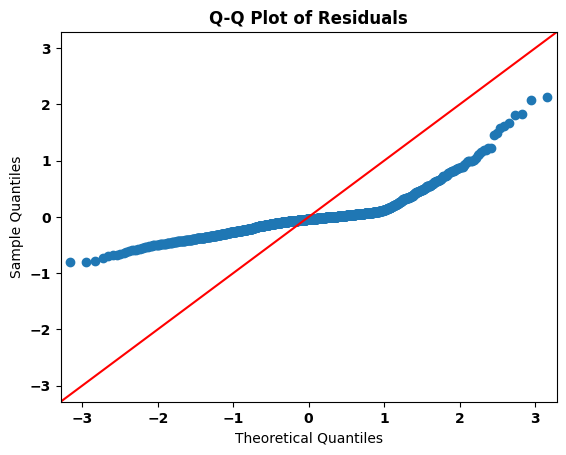

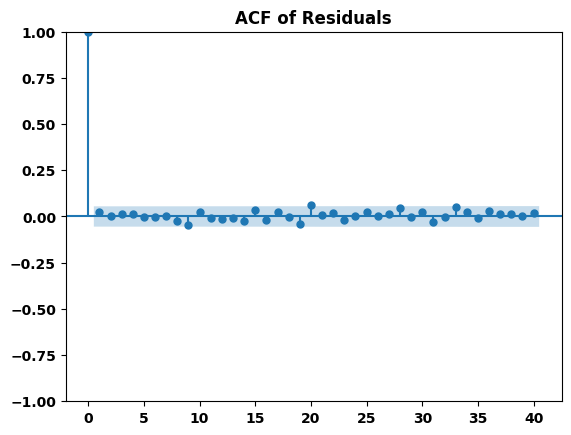

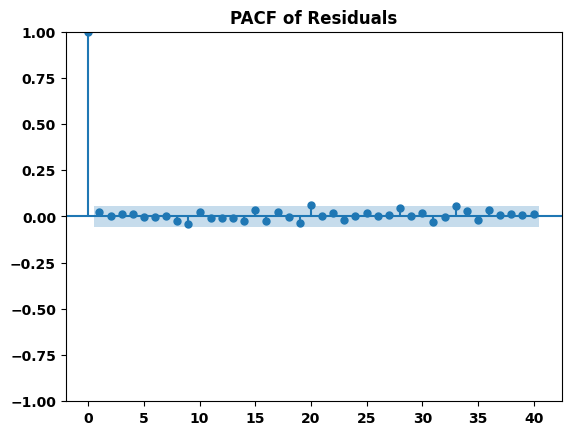

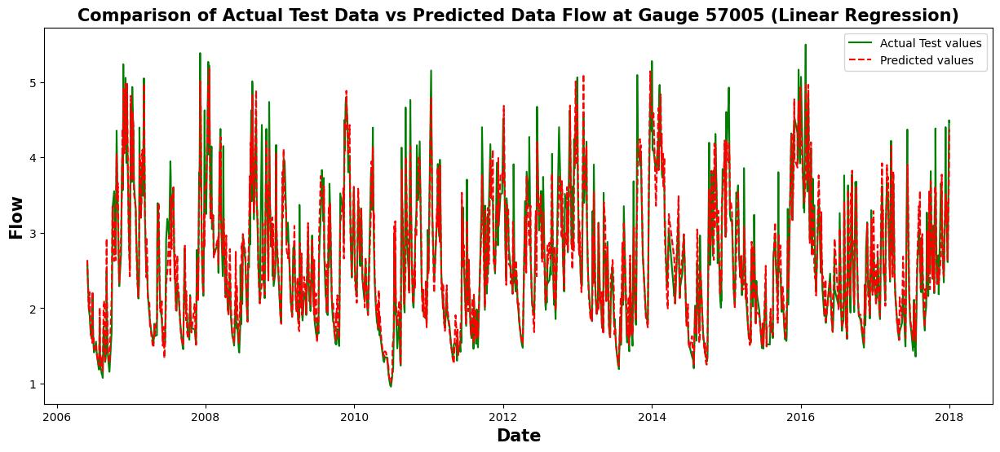

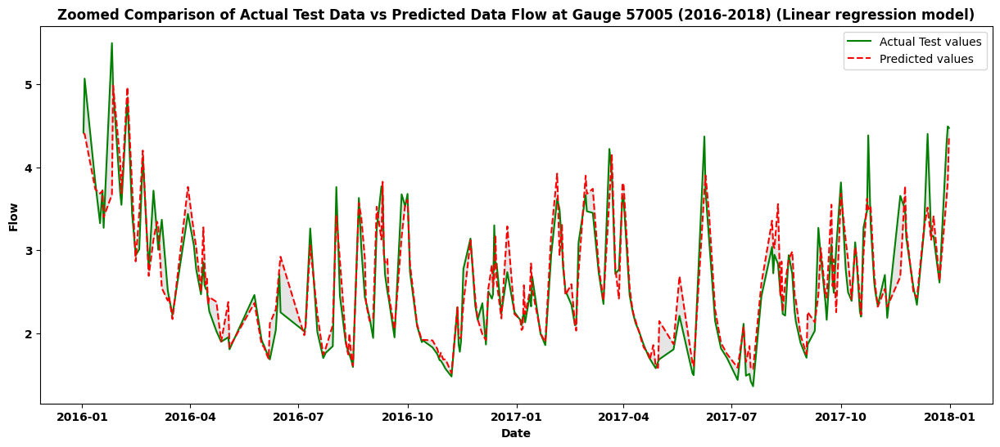

In [298]:
# Fit final model with selected features on the training data
def OLS_linear_regression_compute(selected_features, X_train_ss, X_test_ss, y_train_ss, y_test_ss):
    final_model = sm.OLS(y_train_ss, sm.add_constant(X_train_ss[selected_features])).fit()
    print(final_model.summary())
    X_train_a_ss = sm.add_constant(X_train_ss[selected_features])
    
    y_train_pred_ss = final_model.predict(X_train_a_ss)
    # Calculate MSE and R-squared for Training Data
    train_ss_mse = mean_squared_error(y_train_ss, y_train_pred_ss)
    train_ss_mae = mean_absolute_error(y_train_ss, y_train_pred_ss)
    train_ss_r2 = r2_score(y_train_ss, y_train_pred_ss)
    train_ss_mape = mean_absolute_percentage_error(y_train_ss, y_train_pred_ss)
    
    # Evaluate the model on the test data
    X_test_selected = sm.add_constant(X_test_ss[selected_features])
    y_pred_ss = final_model.predict(X_test_selected)
     # Calculate MSE, Mape  and R-squared for Test Data
    test_ss_mse = mean_squared_error(y_test_ss, y_pred_ss)
    test_ss_mae = mean_absolute_error(y_test_ss, y_pred_ss)
    test_ss_r2 = r2_score(y_test_ss, y_pred_ss)
    test_ss_mape = mean_absolute_percentage_error(y_test_ss, y_pred_ss)
    
    #print train and test evaluation
    print(f'Training MSE: {train_ss_mse},Training Mae: {train_ss_mae}, Training Mape: {train_ss_mape} Training R-squared: {train_ss_r2}')
    print(f'Test MSE: {test_ss_mse}, Test Mae: {test_ss_mae}, Test Mape: {test_ss_mape}, Test R-squared: {test_ss_r2}')

    cv_results = cross_validate_selected_features(X_test_ss, y_test_ss, selected_features)
    print('Cross-Validation Results:')
    print(cv_results)
    
    # Step 5: Model Diagnostics
    # Residuals
    residuals = y_test_ss - y_pred_ss
    
    # 1. to check Independence by Durbin-Watson test
    dw_statistic = durbin_watson(residuals)
    
    print(f'Durbin-Watson statistic test : {dw_statistic}')


    # 2. Linearity and Homoscedasticity
    plt.figure(figsize=(6, 3))
    plt.scatter(y_pred_ss, residuals)
    plt.axhline(y=0, color='r', linestyle='--')
    plt.xlabel(
        'Fitted Values',
        fontweight ='bold'
    )
    plt.ylabel(
        'Residuals',
        fontweight ='bold'
    )
    plt.title(
        'Residuals vs Fitted Values',
        fontweight ='bold'
    )
    plt.xticks(fontweight ='bold')
    plt.yticks(fontweight ='bold')
    plt.show()
    
    # 3. Normality (Histogram and Q-Q plot of residuals)
    plt.figure(figsize=(6, 3))
    sns.histplot(residuals, kde=True)
    plt.title('Histogram of Residuals', fontweight='bold')
    plt.xticks(fontweight ='bold')
    plt.yticks(fontweight ='bold')
    
    plt.figure(figsize=(6, 3))
    sm.qqplot(residuals, line='45')
    plt.title('Q-Q Plot of Residuals', fontweight ='bold')
    plt.xticks(fontweight ='bold')
    plt.yticks(fontweight ='bold')
    plt.show()
    
    # 4. ACF and PACF plots of residuals
    plot_acf(residuals, lags=40)
    plt.title('ACF of Residuals', fontweight ='bold')
    plt.xticks(fontweight ='bold')
    plt.yticks(fontweight ='bold')
    plt.show()
    
    plot_pacf(residuals, lags=40)
    plt.title('PACF of Residuals', fontweight ='bold')
    plt.xticks(fontweight ='bold')
    plt.yticks(fontweight ='bold')
    plt.show()
    
    # Plot actual vs predicted values
    y_test_sorted = y_test_ss.sort_index()
    y_pred_ss_sorted = pd.Series(y_pred_ss, index=y_test_ss.index).sort_index()
    
    plt.figure(figsize=(15, 6))
    plt.plot(y_test_sorted.index, y_test_sorted.values, label='Actual Test values', color='green', linestyle='-')
    plt.plot(y_test_sorted.index, y_pred_ss_sorted.values, label='Predicted values', color='red', linestyle='--')
    plt.fill_between(y_test_sorted.index, y_test_sorted.values, y_pred_ss_sorted.values, color='gray', alpha=0.2)
    plt.xlabel('Date', fontsize = '15', fontweight ='bold')
    plt.ylabel('Flow', fontsize = '15', fontweight = 'bold')
    plt.title('Comparison of Actual Test Data vs Predicted Data Flow at Gauge 57005 (Linear Regression)', fontsize = '15', fontweight ='bold')
    plt.legend()
    plt.show()
    
    # Zoom in on a specific period (2016-2018)
    plt.figure(figsize=(15, 6))
    plt.plot(y_test_sorted.loc['2016':'2018'].index, y_test_sorted.loc['2016':'2018'].values, label='Actual Test values', color='green', linestyle='-')
    plt.plot(y_test_sorted.loc['2016':'2018'].index, y_pred_ss_sorted.loc['2016':'2018'].values, label='Predicted values', color='red', linestyle='--')
    plt.fill_between(y_test_sorted.loc['2016':'2018'].index, y_test_sorted.loc['2016':'2018'].values, y_pred_ss_sorted.loc['2016':'2018'].values, color='gray', alpha=0.2)
    plt.xlabel('Date', fontweight ='bold')
    plt.ylabel('Flow', fontweight ='bold')
    plt.xticks(fontweight = 'bold')
    plt.yticks(fontweight = 'bold')
    plt.title('Zoomed Comparison of Actual Test Data vs Predicted Data Flow at Gauge 57005 (2016-2018) (Linear regression model)', fontweight= 'bold')
    plt.legend()
    plt.show()

    return test_ss_mse, test_ss_mae, test_ss_r2, test_ss_mape, y_pred_ss

test_ss_mse, test_ss_mae, test_ss_r2, test_ss_mape, linear_pred = OLS_linear_regression_compute(
    selected_features,
    X_train_ss,
    X_test_ss,
    y_train_ss,
    y_test_ss
)


### 6.1.3 Support vector Regression

Training MSE: 0.11070235490590823, Training R-squared: 0.8709314383385743, Training MAPE: 0.061839363430667246
Test MSE: 0.0976596160965712, Test R-squared: 0.8860316038425973, Test MAPE: 0.060308756197509895
 Test MAE: 0.17420776645785052
Cross-Validation MSE: 0.12171268485766866
Cross-Validation R-squared: 0.8575521517817553
Cross-Validation MAPE: 0.0666227527087501


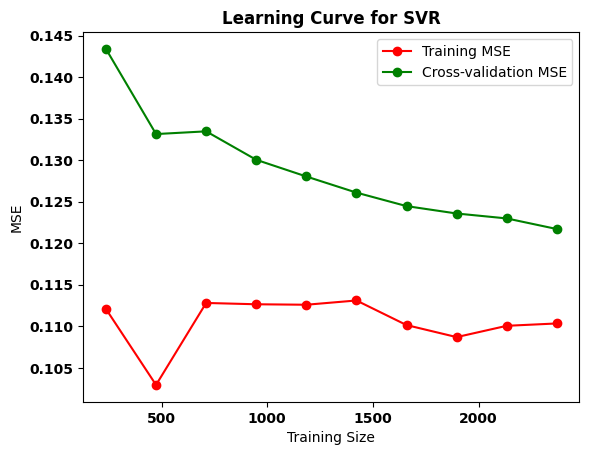

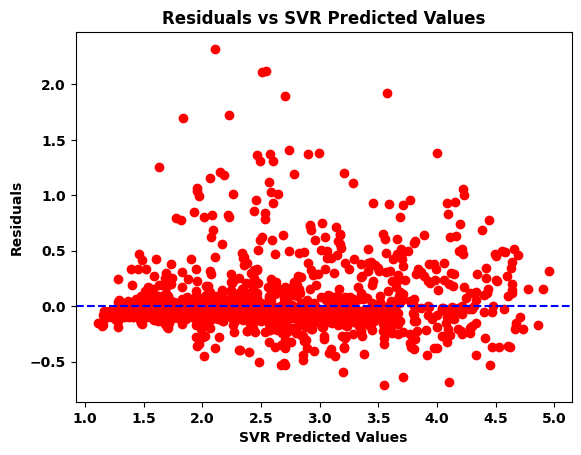

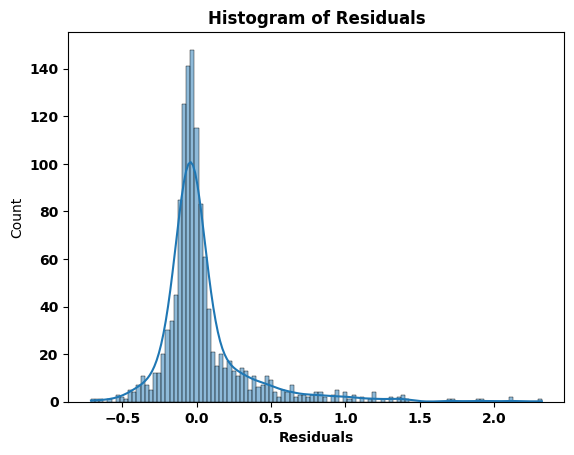

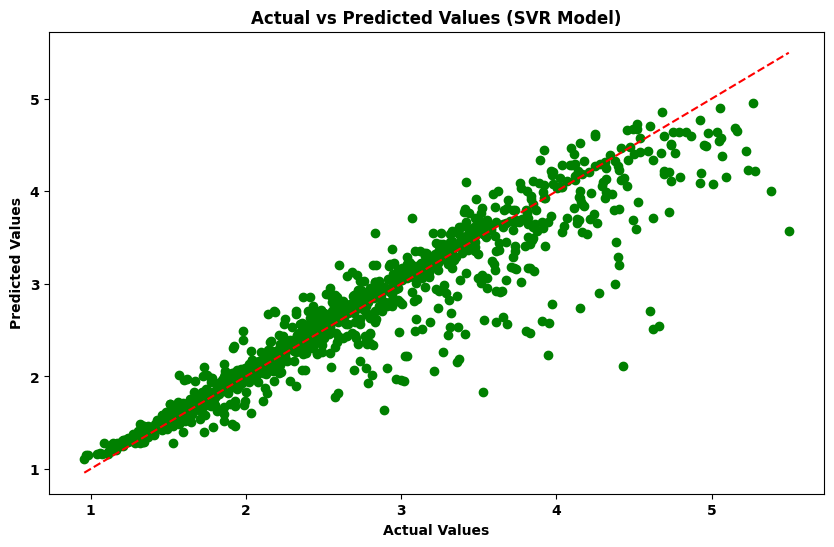

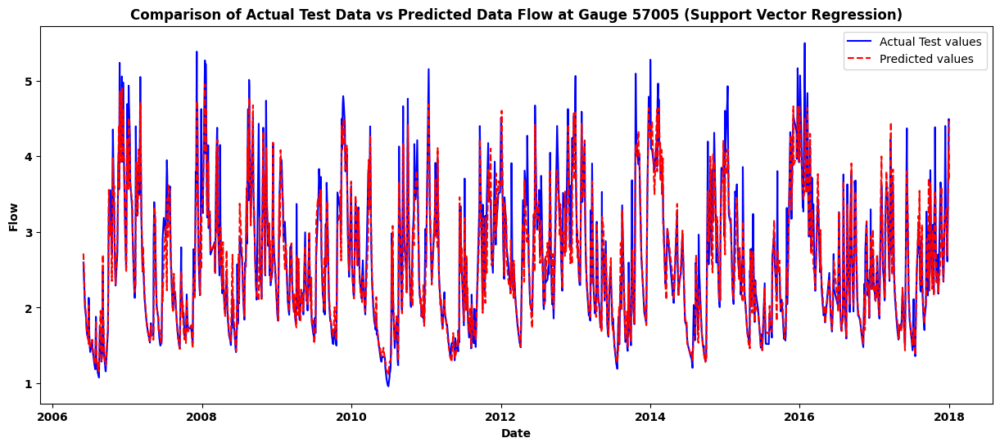

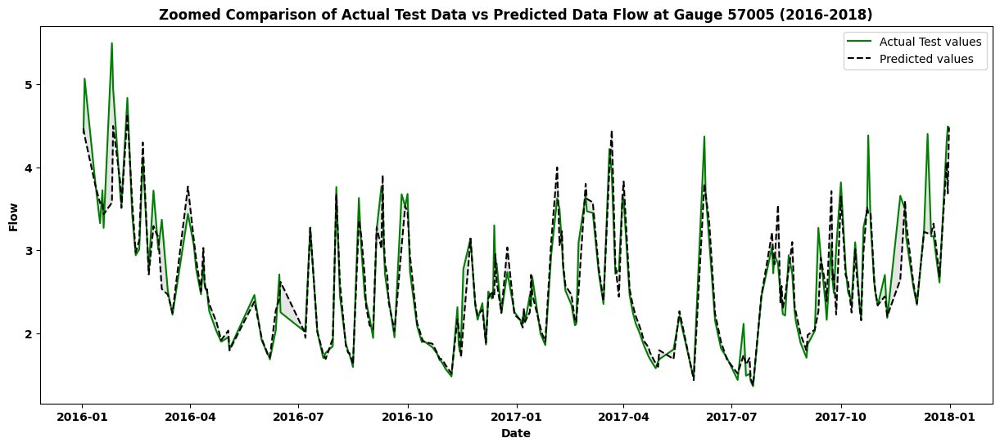

In [299]:


def svr_regression(X_train, y_train, X_test, y_test, kernel='rbf', C=1.0, epsilon=0.1, gamma = 'scale'):
    svr_model = SVR(kernel=kernel, C=C, epsilon=epsilon, gamma = gamma)
    svr_model.fit(X_train, y_train)
    
    # Predictions
    y_train_pred = svr_model.predict(X_train)
    y_test_pred = svr_model.predict(X_test)
    
    # Errors for training and test sets
    train_mse = mean_squared_error(y_train, y_train_pred)
    test_mse = mean_squared_error(y_test, y_test_pred)
    
    train_r2 = r2_score(y_train, y_train_pred)
    test_r2 = r2_score(y_test, y_test_pred)
    
    train_mape = mean_absolute_percentage_error(y_train, y_train_pred)
    test_mape = mean_absolute_percentage_error(y_test, y_test_pred)
    test_mae = mean_absolute_error(y_test, y_test_pred)
    
    print(f'Training MSE: {train_mse}, Training R-squared: {train_r2}, Training MAPE: {train_mape}')
    print(f'Test MSE: {test_mse}, Test R-squared: {test_r2}, Test MAPE: {test_mape}')
    print(f' Test MAE: {test_mae}')
    
    # Cross-Validation
    cv_mse = -cross_val_score(svr_model, X_train, y_train, cv=5, scoring='neg_mean_squared_error').mean()
    cv_r2 = cross_val_score(svr_model, X_train, y_train, cv=5, scoring='r2').mean()
    cv_mape = cross_val_score(svr_model, X_train, y_train, cv=5, scoring='neg_mean_absolute_percentage_error').mean()
    
    print(f'Cross-Validation MSE: {cv_mse}')
    print(f'Cross-Validation R-squared: {cv_r2}')
    print(f'Cross-Validation MAPE: {-cv_mape}')
    
    # Learning Curve
    train_sizes, train_scores, test_scores = learning_curve(
        SVR(kernel=kernel, C=C, epsilon=epsilon), X_train, y_train, cv=5, scoring='neg_mean_squared_error', 
        train_sizes=np.linspace(0.1, 1.0, 10)
    )
    train_scores_mean = -train_scores.mean(axis=1)
    test_scores_mean = -test_scores.mean(axis=1)

    plt.figure()
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r", label="Training MSE")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g", label="Cross-validation MSE")
    plt.xlabel('Training Size')
    plt.ylabel('MSE')
    plt.title('Learning Curve for SVR', fontweight = 'bold')
    plt.xticks(fontweight = 'bold')
    plt.yticks(fontweight = 'bold')
    plt.legend(loc="best")
    plt.show()

    # Residual plot
    residuals = y_test - y_test_pred
    plt.scatter(y_test_pred, residuals, color='red')
    plt.axhline(y=0, color='blue', linestyle='--')
    plt.xlabel('SVR Predicted Values',  fontweight = 'bold')
    plt.ylabel('Residuals',  fontweight = 'bold')
    plt.title('Residuals vs SVR Predicted Values',  fontweight = 'bold')
    plt.xticks(fontweight = 'bold')
    plt.yticks(fontweight = 'bold')
    plt.show()

    # histogram of Residual
    sns.histplot(residuals, kde=True)
    plt.title('Histogram of Residuals',  fontweight = 'bold')
    plt.xlabel('Residuals',  fontweight = 'bold')
    plt.xticks(fontweight = 'bold')
    plt.yticks(fontweight = 'bold')
    plt.show()

    plt.figure(figsize=(10, 6))
    plt.scatter(y_test, y_test_pred, color='green')
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', linestyle='--')
    plt.title('Actual vs Predicted Values (SVR Model)', fontweight = 'bold')
    plt.xlabel('Actual Values',  fontweight = 'bold')
    plt.ylabel('Predicted Values',  fontweight = 'bold')
    plt.xticks(fontweight = 'bold')
    plt.yticks(fontweight = 'bold')
    plt.show()


    y_test_sorted = y_test.sort_index()
    y_pred_svr_sorted = pd.Series(y_test_pred, index=y_test.index).sort_index()
    plt.figure(figsize=(15, 6))
    plt.plot(y_test_sorted.index, y_test_sorted.values, label='Actual Test values', color='blue', linestyle='-')
    plt.plot(y_test_sorted.index, y_pred_svr_sorted.values, label='Predicted values', color='red', linestyle='--')
    plt.fill_between(y_test_sorted.index, y_test_sorted.values, y_pred_svr_sorted.values, color='gray', alpha=0.2)
    plt.xlabel('Date', fontweight='bold')
    plt.ylabel('Flow', fontweight='bold')
    plt.xticks(fontweight = 'bold')
    plt.yticks(fontweight = 'bold')
    plt.title('Comparison of Actual Test Data vs Predicted Data Flow at Gauge 57005 (Support Vector Regression)', fontweight = 'bold')
    plt.legend()
    plt.show()
    
    # Zoom in on a specific period (e.g., 2016-2018)
    plt.figure(figsize=(15, 6))
    plt.plot(y_test_sorted.loc['2016':'2018'].index, y_test_sorted.loc['2016':'2018'].values, label='Actual Test values', color='green', linestyle='-')
    plt.plot(y_test_sorted.loc['2016':'2018'].index, y_pred_svr_sorted.loc['2016':'2018'].values, label='Predicted values', color='black', linestyle='--')
    plt.fill_between(y_test_sorted.loc['2016':'2018'].index, y_test_sorted.loc['2016':'2018'].values, y_pred_svr_sorted.loc['2016':'2018'].values, color='gray', alpha=0.2)
    plt.xlabel('Date', fontweight ='bold')
    plt.ylabel('Flow', fontweight ='bold')
    plt.xticks(fontweight = 'bold')
    plt.yticks(fontweight = 'bold')
    plt.title('Zoomed Comparison of Actual Test Data vs Predicted Data Flow at Gauge 57005 (2016-2018)', fontweight= 'bold')
    plt.legend()
    plt.show()
    return test_mse, test_r2, test_mape, y_test_pred, test_mae

mse_svr, r2_svr, mape_svr, y_pred_svr, svr_mae = svr_regression(
    X_train_ss[selected_features],
    y_train_ss,
    X_test_ss[selected_features],
    y_test_ss,
    kernel='rbf'
)


### 6.1.4 Neural Network

C:\Users\c23039854\AppData\Roaming\Python\Python311\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/30
38/38 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 5.3058 - val_loss: 0.4657
Epoch 2/30
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.3056 - val_loss: 0.1617
Epoch 3/30
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.1853 - val_loss: 0.1297
Epoch 4/30
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1540 - val_loss: 0.1159
Epoch 5/30
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1405 - val_loss: 0.1117
Epoch 6/30
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1359 - val_loss: 0.1102
Epoch 7/30
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1339 - val_loss: 0.1091
Epoch 8/30
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1324 - val_loss: 0.1080
Epoch 9/30
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.1312 - val_loss: 0.1071
Epoch 10/30
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1301 - val_loss: 0.1062
Epoch 11/30
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1290 - val_loss: 0.1052
Epoch 12/30
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1281 - val_l

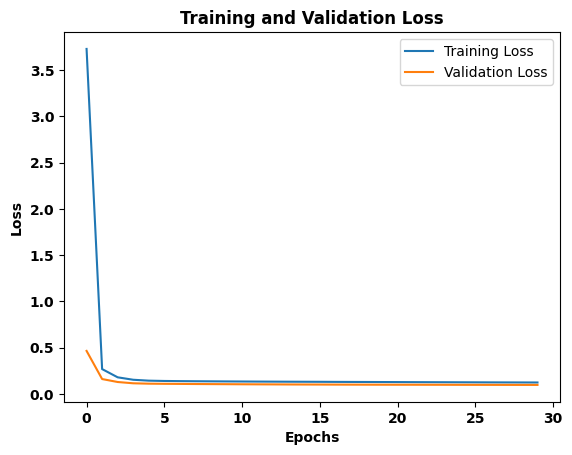

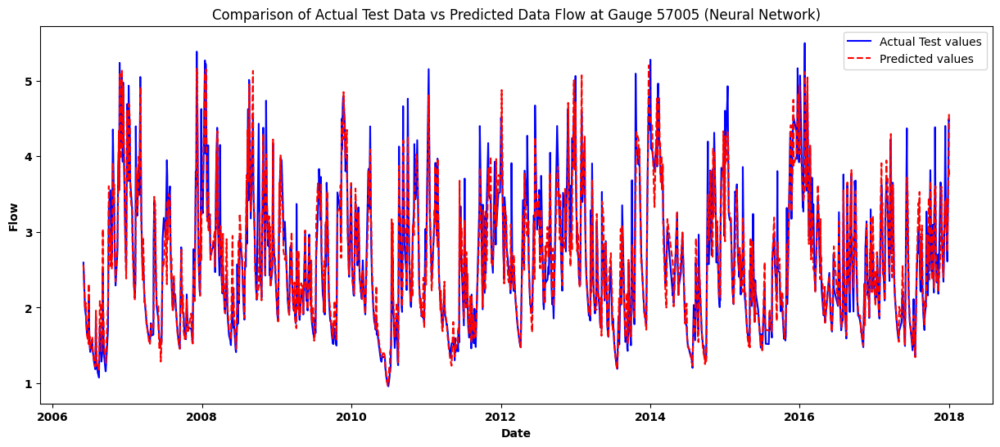

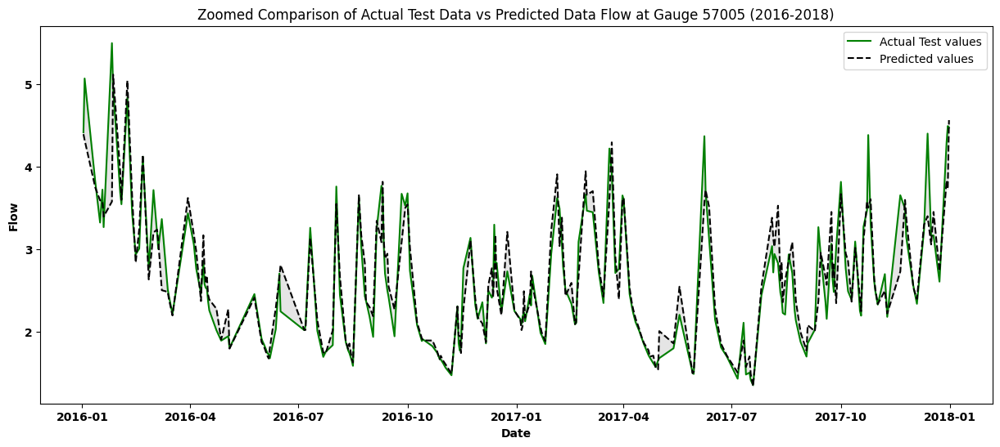

In [300]:
def neural_network(X_train_nn, X_test_nn, y_train_nn, y_test_nn, epochs=10, batch_size=100):
    # Standardize the data
    scaler = MinMaxScaler()
    X_train_nn_scaled = scaler.fit_transform(X_train_nn)
    X_test_nn_scaled = scaler.transform(X_test_nn)

    # Define the model
    model = Sequential()
    model.add(Dense(64, input_dim=X_train_nn.shape[1], activation='relu'))
    model.add(Dense(32, activation='relu'))
    model.add(Dense(1))

    # Compile the model
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Define the early stopping callback
    early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

    # Train the model
    history = model.fit(X_train_nn_scaled, y_train_nn, epochs=epochs, validation_data=(X_test_nn_scaled, y_test_nn),
                        batch_size=batch_size, verbose=1, callbacks=[early_stopping])

    # Evaluate the model on the training data
    y_pred_train_nn = model.predict(X_train_nn_scaled).flatten()
    mse_train_nn = mean_squared_error(y_train_nn, y_pred_train_nn)
    r2_train_nn = r2_score(y_train_nn, y_pred_train_nn)
    mape_train_nn = mean_absolute_percentage_error(y_train_nn, y_pred_train_nn)

    # Evaluate the model on the test data
    y_pred_nn = model.predict(X_test_nn_scaled).flatten()
    mse_test_nn = mean_squared_error(y_test_nn, y_pred_nn)
    r2_test_nn = r2_score(y_test_nn, y_pred_nn)
    mape_test_nn = mean_absolute_percentage_error(y_test_nn, y_pred_nn)
    test_mae_nn = mean_absolute_error(y_test_nn, y_pred_nn)
    # Print train and test evaluation
    print(f'Training MSE: {mse_train_nn}, Training Mape: {mape_train_nn}, Training R-squared: {r2_train_nn}')
    print(f'Test MSE: {mse_test_nn}, Test Mape: {mape_test_nn}, Test R-squared: {r2_test_nn}')
   
    # Plot the training and validation loss
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.xlabel('Epochs', fontweight = 'bold')
    plt.ylabel('Loss', fontweight ='bold')
    plt.legend()
    plt.title('Training and Validation Loss', fontweight = 'bold')
    plt.xticks(fontweight = 'bold')
    plt.yticks(fontweight = 'bold')
    plt.show()

    # Plot actual vs predicted values
    y_test_sorted_nn = y_test_nn.sort_index()
    y_pred_nn_sorted = pd.Series(y_pred_nn, index=y_test_nn.index).sort_index()
    
    plt.figure(figsize=(15, 6))
    plt.plot(y_test_sorted_nn.index, y_test_sorted_nn.values, label='Actual Test values', color='blue', linestyle='-')
    plt.plot(y_test_sorted_nn.index, y_pred_nn_sorted.values, label='Predicted values', color='red', linestyle='--')
    plt.fill_between(y_test_sorted_nn.index, y_test_sorted_nn.values, y_pred_nn_sorted.values, color='gray', alpha=0.2)
    plt.xlabel('Date', fontweight='bold')
    plt.ylabel('Flow', fontweight='bold')
    plt.title('Comparison of Actual Test Data vs Predicted Data Flow at Gauge 57005 (Neural Network)')
    plt.xticks(fontweight = 'bold')
    plt.yticks(fontweight = 'bold')
    plt.legend()
    plt.show()

    # Zoom in on a specific period (e.g., 2016-2018)
    plt.figure(figsize=(15, 6))
    plt.plot(y_test_sorted_nn.loc['2016':'2018'].index, y_test_sorted_nn.loc['2016':'2018'].values, label='Actual Test values', color='green', linestyle='-')
    plt.plot(y_test_sorted_nn.loc['2016':'2018'].index, y_pred_nn_sorted.loc['2016':'2018'].values, label='Predicted values', color='black', linestyle='--')
    plt.fill_between(y_test_sorted_nn.loc['2016':'2018'].index, y_test_sorted_nn.loc['2016':'2018'].values, y_pred_nn_sorted.loc['2016':'2018'].values, color='gray', alpha=0.2)
    plt.xlabel('Date', fontweight='bold')
    plt.ylabel('Flow', fontweight='bold')
    plt.title('Zoomed Comparison of Actual Test Data vs Predicted Data Flow at Gauge 57005 (2016-2018)')
    plt.xticks(fontweight = 'bold')
    plt.yticks(fontweight = 'bold')
    plt.legend()
    plt.show()

    return mse_test_nn, mape_test_nn, r2_test_nn, y_pred_nn, test_mae_nn

# Evaluate Neural Network
mse_test_nn, mape_test_nn, r2_test_nn, y_pred_nn, mae_nn = neural_network(
    X_train_ss[selected_features],
    X_test_ss[selected_features],
    y_train_ss,
    y_test_ss,
    epochs=30,
    batch_size=80
)



### 6.1.5 Generalized additive model

Training MSE: 0.10709706442496437,Training Mape: 0.07567282442653438 Training R-squared: 0.8751348688540549
Test MSE: 0.1045358079617504, Test Mape: 0.07557127863453861, Test R-squared: 0.8780071143978496


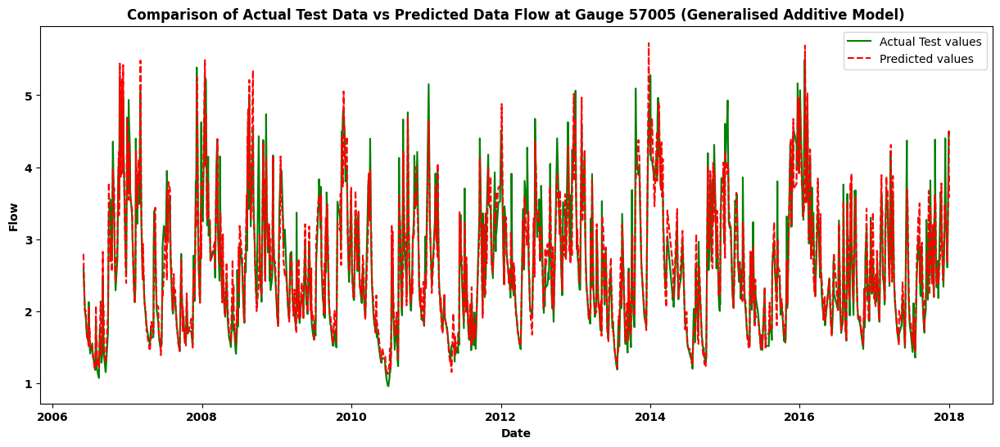

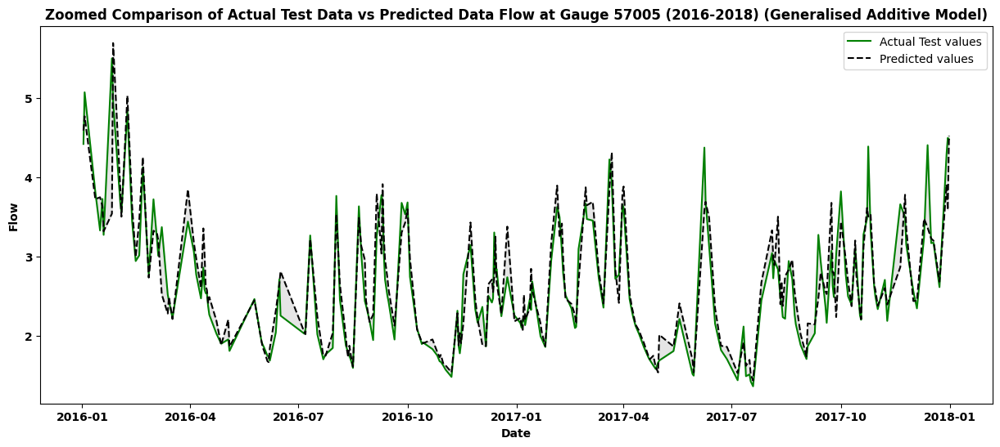

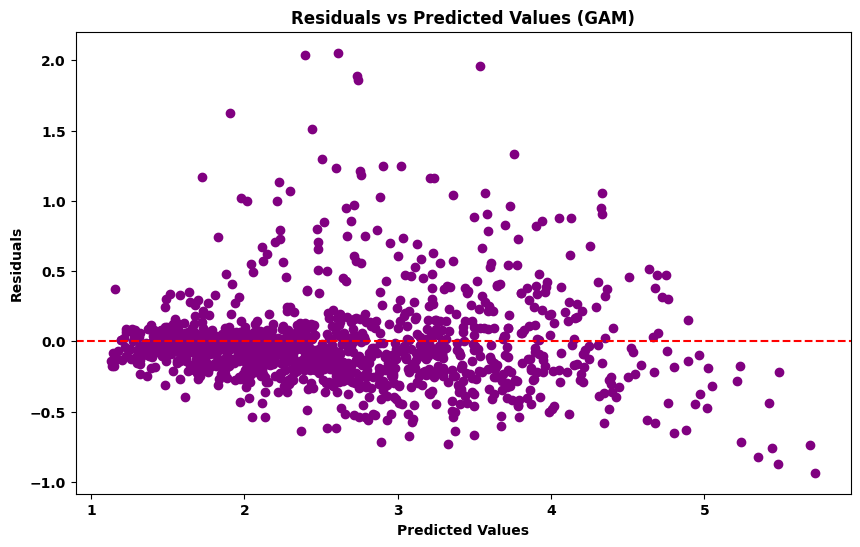

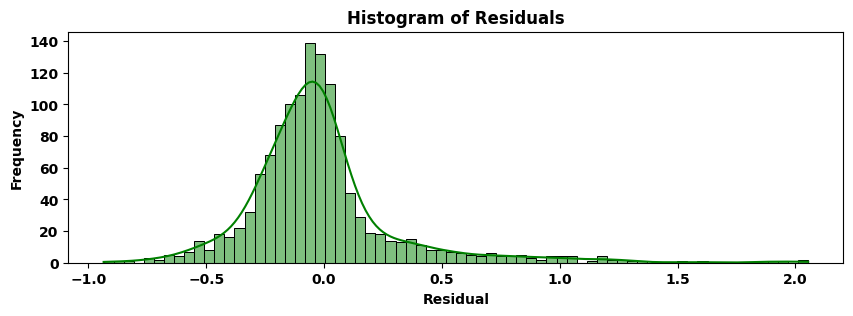

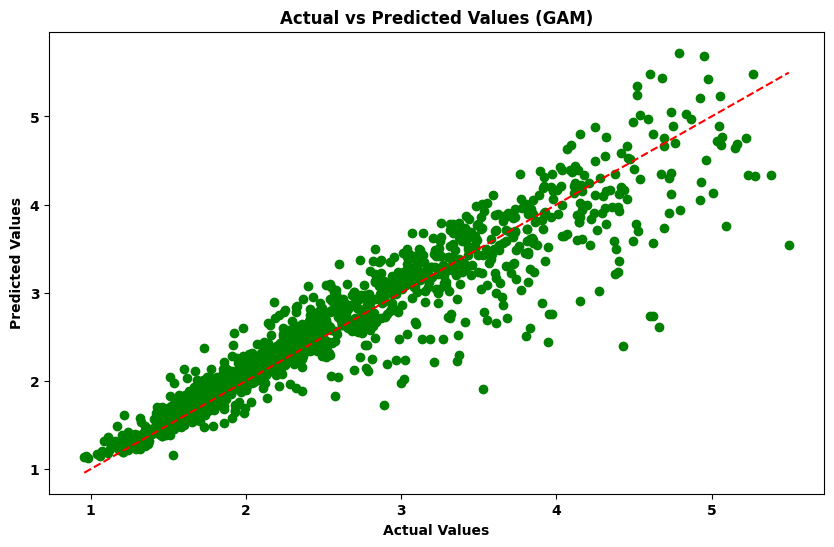

In [301]:
def gam_model_diagnostic(X_train_ss,y_train_ss, X_test_ss, y_test_ss, selected_features):
    # Fit the GAM model
    gam = LinearGAM(lam=2.0).fit(X_train_ss[selected_features], y_train_ss)
    
    y_pred_gam_train = gam.predict(X_train_ss[selected_features])
    
    mse_train_gam = mean_squared_error(y_train_ss, y_pred_gam_train)
    r2_train_gam = r2_score(y_train_ss, y_pred_gam_train)
    mape_train_gam = mean_absolute_percentage_error(y_train_ss, y_pred_gam_train)
    # Step 5: Make test predictions

    y_pred_gam = gam.predict(X_test_ss[selected_features])
    # Step 6: Evaluate the model
    mse_test_gam = mean_squared_error(y_test_ss, y_pred_gam)
    r2_test_gam = r2_score(y_test_ss, y_pred_gam)
    mape_test_gam = mean_absolute_percentage_error(y_test_ss, y_pred_gam)
    mae_test_gam = mean_absolute_error(y_test_ss, y_pred_gam)
    
    #print train and test evaluation
    print(f'Training MSE: {mse_train_gam},Training Mape: {mape_train_gam} Training R-squared: {r2_train_gam}')
    print(f'Test MSE: {mse_test_gam}, Test Mape: {mape_test_gam}, Test R-squared: {r2_test_gam}')

    # Plot actual vs predicted values
    y_test_sorted_gam = y_test_ss.sort_index()
    y_pred_gam_sorted = pd.Series(y_pred_gam, index=y_test_ss.index).sort_index()
    
    plt.figure(figsize=(15, 6))
    plt.plot(y_test_sorted_gam.index, y_test_sorted_gam.values, label='Actual Test values', color='green', linestyle='-')
    plt.plot(y_test_sorted_gam.index, y_pred_gam_sorted.values, label='Predicted values', color='red', linestyle='--')
    plt.fill_between(y_test_sorted_gam.index, y_test_sorted_gam.values, y_pred_gam_sorted.values, color='gray', alpha=0.2)
    plt.xlabel('Date', fontweight = 'bold')
    plt.ylabel('Flow', fontweight = 'bold')
    plt.xticks (fontweight = 'bold')
    plt.yticks (fontweight = 'bold')
    plt.title('Comparison of Actual Test Data vs Predicted Data Flow at Gauge 57005 (Generalised Additive Model)', fontweight ='bold')
    plt.legend()
    plt.show()

    # Zoom in on a specific period (e.g., 2016-2018)
    plt.figure(figsize=(15, 6))
    plt.plot(y_test_sorted_gam.loc['2016':'2018'].index, y_test_sorted_gam.loc['2016':'2018'].values, label='Actual Test values', color='green', linestyle='-')
    plt.plot(y_test_sorted_gam.loc['2016':'2018'].index, y_pred_gam_sorted.loc['2016':'2018'].values, label='Predicted values', color='black', linestyle='--')
    plt.fill_between(y_test_sorted_gam.loc['2016':'2018'].index, y_test_sorted_gam.loc['2016':'2018'].values, y_pred_gam_sorted.loc['2016':'2018'].values, color='gray', alpha=0.2)
    plt.xlabel('Date', fontweight='bold')
    plt.ylabel('Flow', fontweight='bold')
    plt.xticks (fontweight = 'bold')
    plt.yticks (fontweight = 'bold')
    plt.title('Zoomed Comparison of Actual Test Data vs Predicted Data Flow at Gauge 57005 (2016-2018) (Generalised Additive Model)', fontweight='bold')
    plt.legend()
    plt.show()

    # Residual Plot
    residuals = y_test_ss - y_pred_gam
    plt.figure(figsize=(10, 6))
    plt.scatter(y_pred_gam, residuals, color='purple')
    plt.axhline(y=0, color='red', linestyle='--')
    plt.title('Residuals vs Predicted Values (GAM)', fontweight='bold')
    plt.xlabel('Predicted Values', fontweight='bold')
    plt.ylabel('Residuals', fontweight='bold')
    plt.xticks (fontweight = 'bold')
    plt.yticks (fontweight = 'bold')
    plt.show()

    
    plt.figure(figsize=(10, 3))
    sns.histplot(residuals, kde=True, color='green')
    plt.title('Histogram of Residuals', fontweight='bold')
    plt.xlabel('Residual', fontweight='bold')
    plt.ylabel('Frequency', fontweight='bold')
    plt.xticks (fontweight = 'bold')
    plt.yticks (fontweight = 'bold')
    plt.show()


    # Scatter Plot of Actual vs Predicted Values
    plt.figure(figsize=(10, 6))
    plt.scatter(y_test_ss, y_pred_gam, color='green')
    plt.plot([y_test_ss.min(), y_test_ss.max()], [y_test_ss.min(), y_test_ss.max()], color='red', linestyle='--')
    plt.title('Actual vs Predicted Values (GAM)', fontweight='bold')
    plt.xlabel('Actual Values', fontweight='bold')
    plt.ylabel('Predicted Values', fontweight='bold')
    plt.xticks (fontweight = 'bold')
    plt.yticks (fontweight = 'bold')
    plt.show()

    return  mse_test_gam, r2_test_gam, mape_test_gam, mae_test_gam, y_pred_gam
mse_test_gam, r2_test_gam, mape_test_gam, mae_test_gam, pred_gam = gam_model_diagnostic(
    X_train_ss,
    y_train_ss,
    X_test_ss,
    y_test_ss,
    selected_features
)

### 6.1.6 Model Comparsion on log transformed data

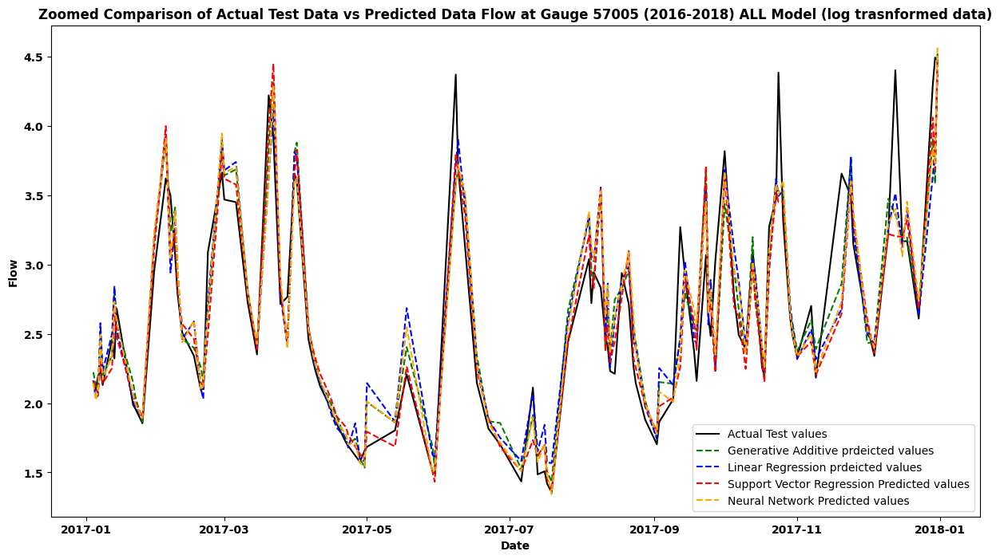

In [302]:
y_test_sorted_gam = y_test_ss.sort_index()
y_pred_gam_sorted = pd.Series(pred_gam, index=y_test_ss.index).sort_index() # Generalised additive model
y_pred_ols_sorted = pd.Series(linear_pred, index=y_test_ss.index).sort_index() # Linear Regression model
y_pred_svr_sorted = pd.Series(y_pred_svr, index=y_test_ss.index).sort_index() # Svr model model
y_pred_nn_sorted = pd.Series(y_pred_nn, index=y_test_ss.index).sort_index() # Neural Network model
plt.figure(figsize=(15, 8))
plt.plot(y_test_sorted_gam.loc['2017':'2018'].index, y_test_sorted_gam.loc['2017':'2018'].values, label='Actual Test values', color='Black', linestyle='-')
plt.plot(y_test_sorted_gam.loc['2017':'2018'].index, y_pred_gam_sorted.loc['2017':'2018'].values, label='Generative Additive prdeicted values', color='green', linestyle='--')
plt.plot(y_test_sorted_gam.loc['2017':'2018'].index, y_pred_ols_sorted.loc['2017':'2018'].values, label='Linear Regression prdeicted values', color='blue', linestyle='--')
plt.plot(y_test_sorted_gam.loc['2017':'2018'].index, y_pred_svr_sorted.loc['2017':'2018'].values, label='Support Vector Regression Predicted values', color='red', linestyle='--')
plt.plot(y_test_sorted_gam.loc['2017':'2018'].index, y_pred_nn_sorted.loc['2017':'2018'].values, label='Neural Network Predicted values', color='orange', linestyle='--')
#plt.fill_between(y_test_sorted_gam.loc['2016':'2018'].index, y_test_sorted_gam.loc['2016':'2018'].values, y_pred_gam_sorted.loc['2016':'2018'].values, color='gray', alpha=0.2)
plt.xlabel('Date', fontweight ='bold')
plt.ylabel('Flow', fontweight ='bold')
plt.yticks(fontweight ='bold')
plt.xticks(fontweight ='bold')
plt.title('Zoomed Comparison of Actual Test Data vs Predicted Data Flow at Gauge 57005 (2016-2018) ALL Model (log trasnformed data)', fontweight ='bold')
plt.legend()
plt.show()

### 6.1.7 Model Evaluation

In [303]:
# Comparison of Error Statistics on original scale
error_statistics = pd.DataFrame({
    'Model': ['Linear Regression', 'Support Vector Regression', 'Neural Network', 'Generalized additive models'],
    'MSE': [test_ss_mse, mse_svr, mse_test_nn, mse_test_gam],
    'MAPE': [test_ss_mape, mape_svr, mape_test_nn, mape_test_gam],
    'MAE': [test_ss_mae, svr_mae, mae_nn, mae_test_gam],
    'R-Squared': [test_ss_r2, r2_svr, r2_test_nn, r2_test_gam],
})
print(error_statistics)

                         Model       MSE      MAPE       MAE  R-Squared
0            Linear Regression  0.100515  0.074229  0.202526   0.882699
1    Support Vector Regression  0.097660  0.060309  0.174208   0.886032
2               Neural Network  0.098253  0.068723  0.192524   0.885339
3  Generalized additive models  0.104536  0.075571  0.207902   0.878007


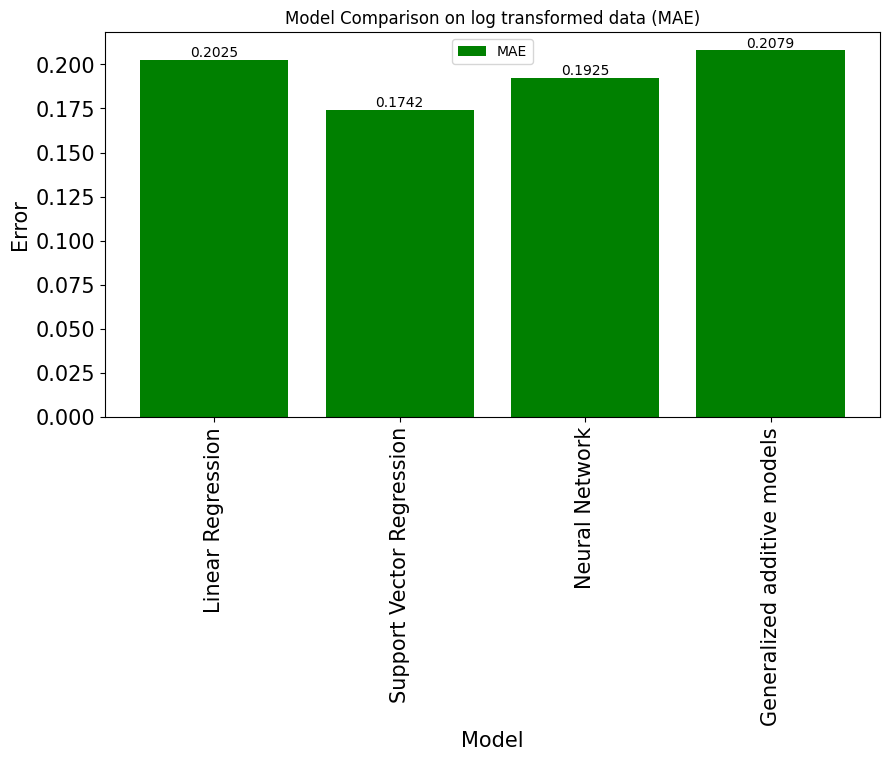

In [304]:
plt.figure(figsize=(10, 5))
# Plot error statistics for each model
bars = plt.bar(error_statistics['Model'], error_statistics['MAE'], color='green', label='MAE')

# Add labels on each bar
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2.0, height, f'{height:.4f}', ha='center', va='bottom')

plt.xlabel('Model', fontsize =15)
plt.ylabel('Error', fontsize = 15)
plt.title('Model Comparison on log transformed data (MAE)')
plt.legend()
plt.xticks(rotation=90, fontsize = 15)
plt.yticks(fontsize = 15)
plt.show()


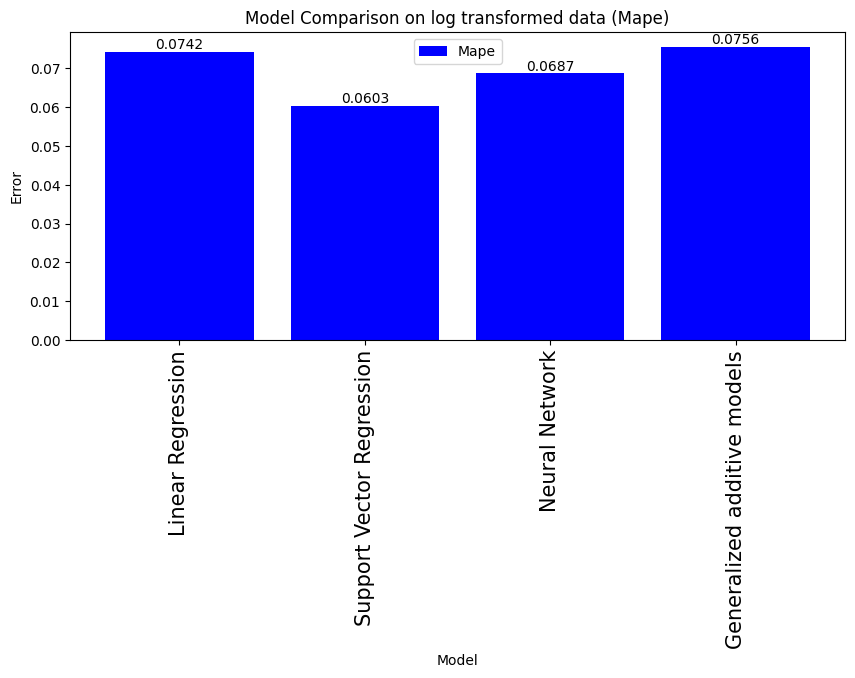

In [305]:
# Model Comparison MSE barGraph on original scale
plt.figure(figsize=(10, 4))
# Plot error statistics for each model

mape_bar = plt.bar(error_statistics['Model'], error_statistics['MAPE'], color='blue', label='Mape')
for bar in mape_bar:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2.0, height, f'{height:.4f}', ha='center', va='bottom')
plt.xlabel('Model')
plt.ylabel('Error')
plt.title('Model Comparison on log transformed data (Mape)')
plt.xticks(rotation=90, fontsize = 15)
plt.legend()
plt.show()

## 6.2 Model optimization and evaluation

### 6.2.1 Model optimization at log transformed data for SVR

#### 6.2.1.1 Experiment of Features Scaling

##### standard Scaler

Training MSE: 0.1087517928830925, Training R-squared: 0.8732056106895618, Training MAPE: 0.061409850280912254
Test MSE: 0.09807859533989904, Test R-squared: 0.8855426566780078, Test MAPE: 0.06085465996573541
 Test MAE: 0.17563376994151425
Cross-Validation MSE: 0.12287206555049826
Cross-Validation R-squared: 0.8562180241970129
Cross-Validation MAPE: 0.06733533031793523


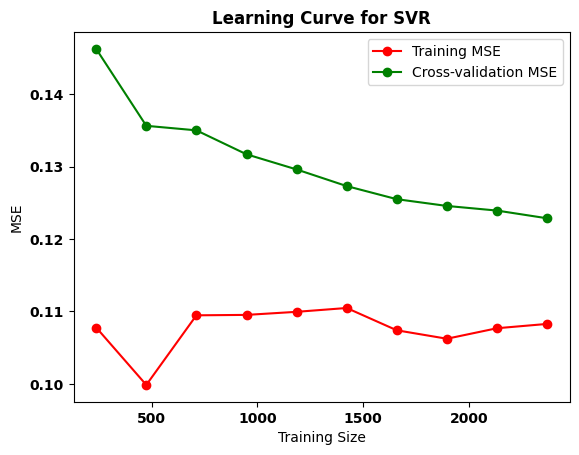

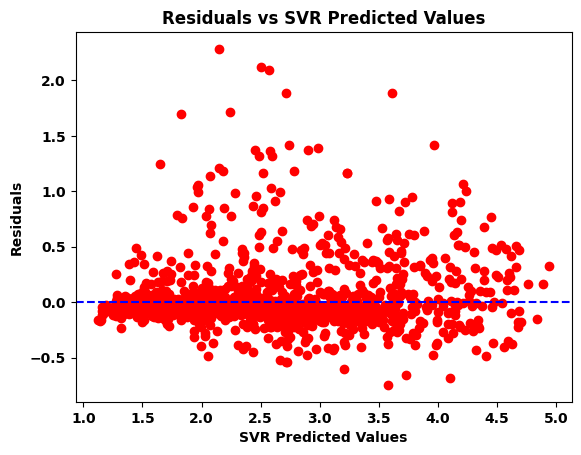

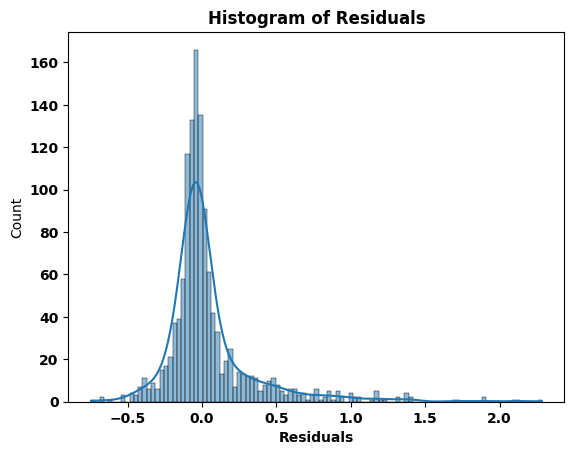

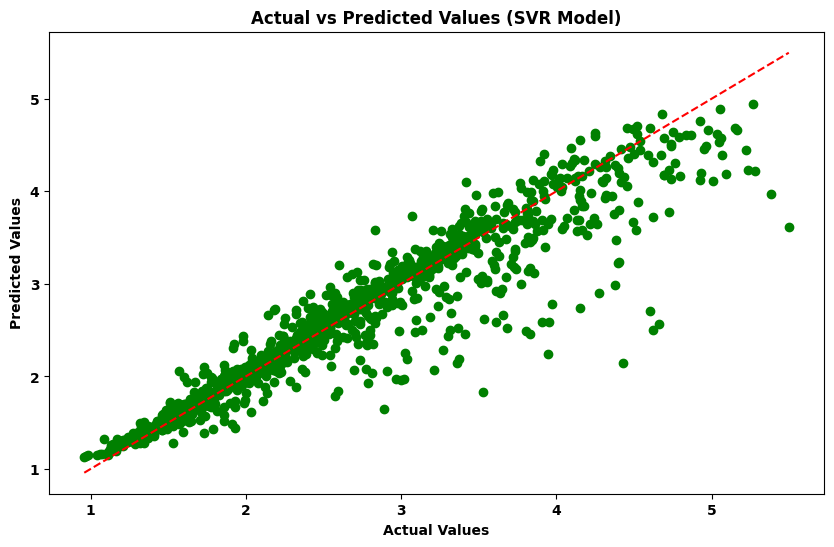

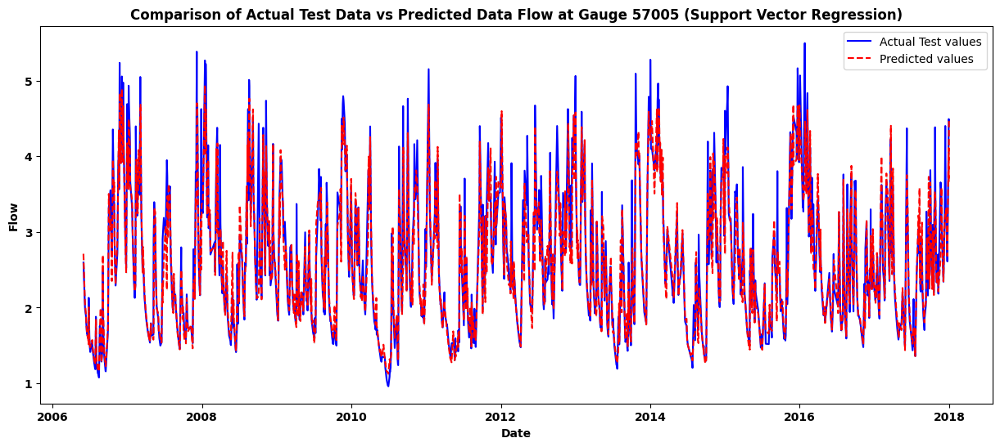

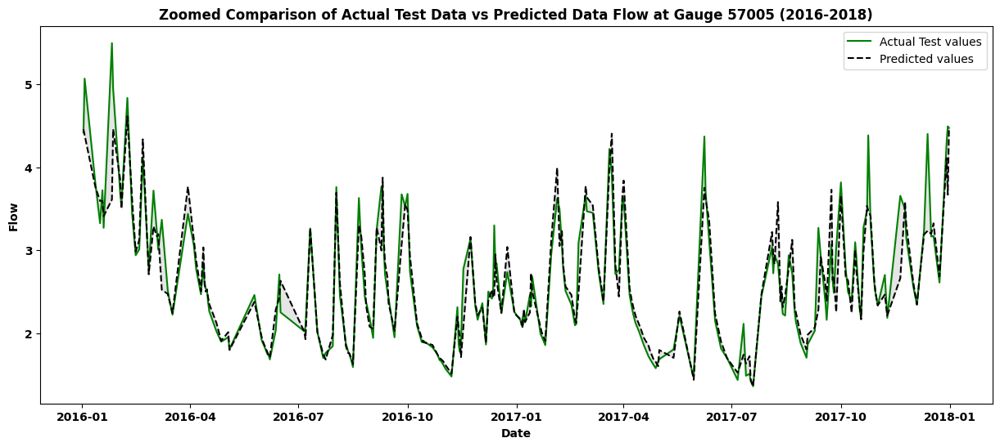

In [306]:
ss_scaler = StandardScaler()

# applied the scaleing only on the input training data
X_train_ss_scaled = ss_scaler.fit_transform(X_train_ss[selected_features])
# applied the scaling to the input test data
X_test_ss_scaled = ss_scaler.transform(X_test_ss[selected_features])
ss_svr_mse, ss_svr_r2, ss_svr_mape, ss_svr_pred, ss_svr_mae = svr_regression(
    X_train_ss_scaled,
    y_train_ss,
    X_test_ss_scaled,
    y_test_ss)

##### Robust Scaler

Training MSE: 0.11121474520507572, Training R-squared: 0.8703340393132417, Training MAPE: 0.06195944033803017
Test MSE: 0.09840740302660185, Test R-squared: 0.8851589393729891, Test MAPE: 0.06112974340892148
 Test MAE: 0.1765871382660135
Cross-Validation MSE: 0.12458727995356042
Cross-Validation R-squared: 0.8542181952537193
Cross-Validation MAPE: 0.06766080759412368


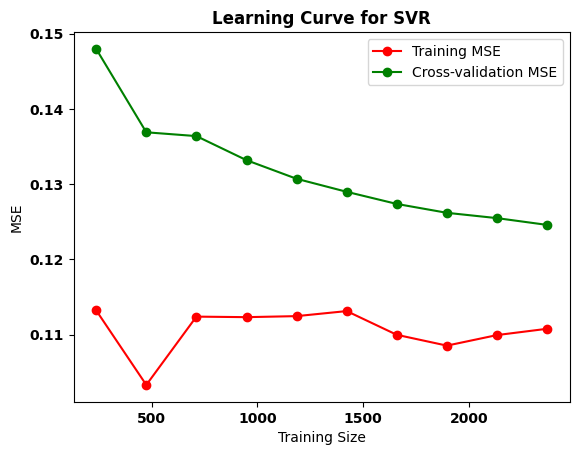

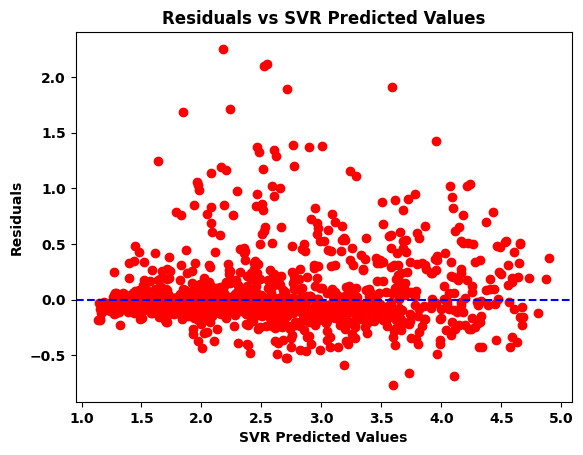

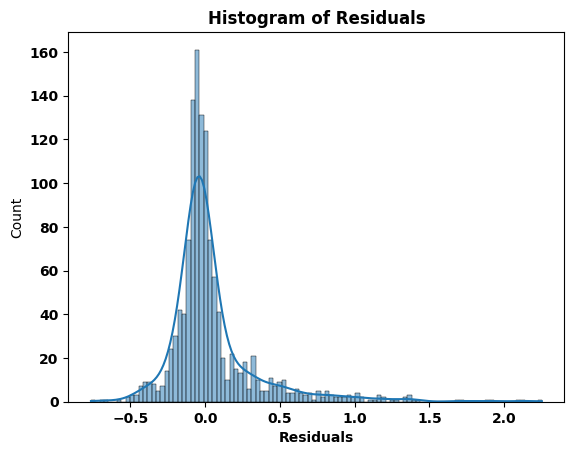

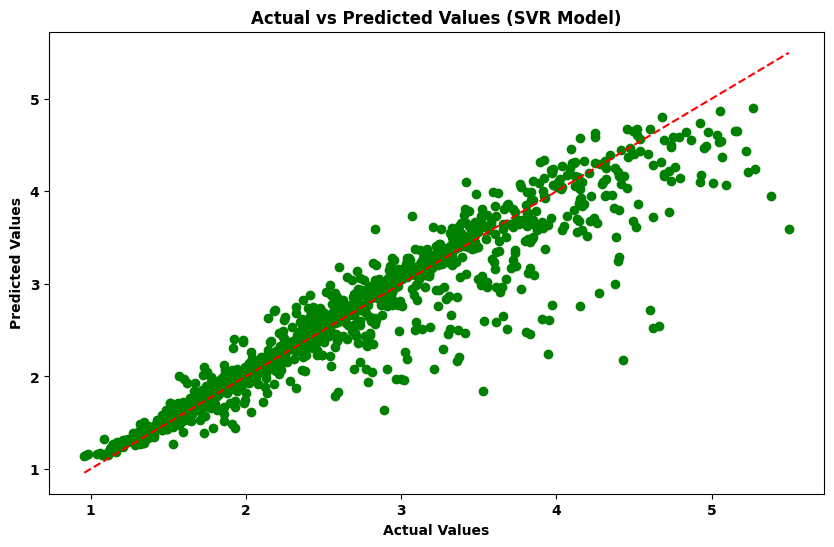

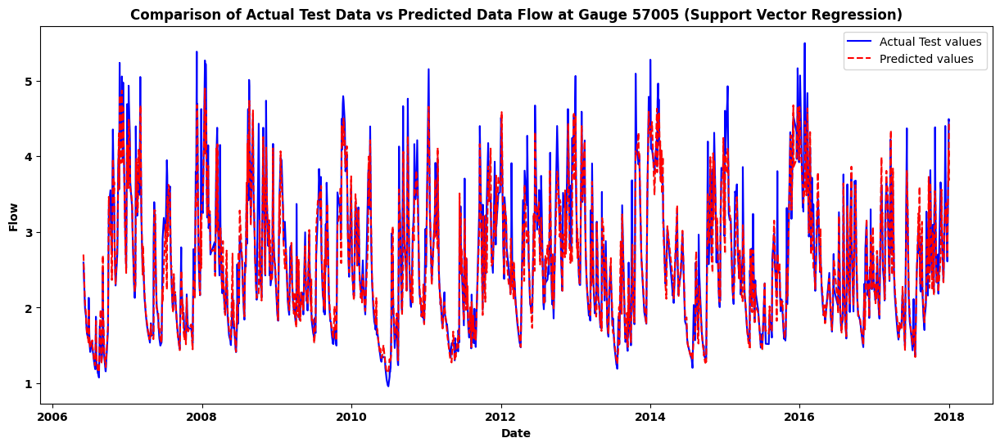

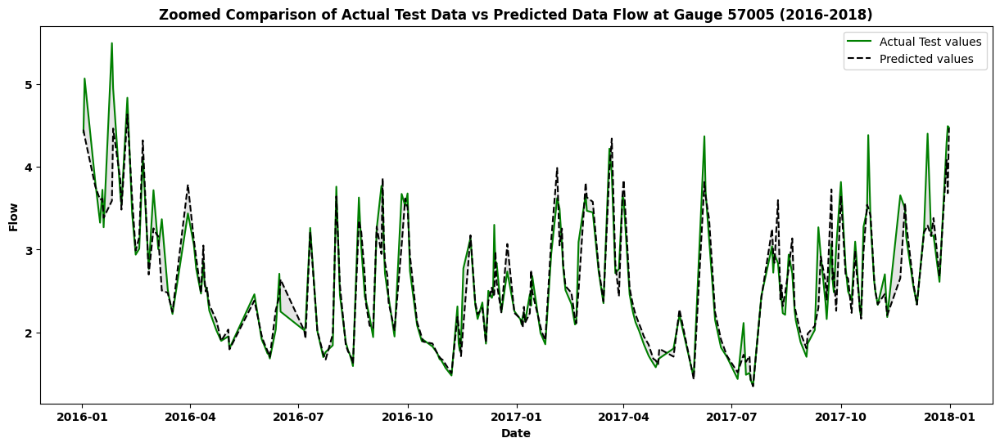

In [307]:
rs_scaler = RobustScaler()
# applied the scaleing only on the input training data
X_train_rs_scaled = rs_scaler.fit_transform(X_train_ss[selected_features])
# applied the scaling to the input test data
X_test_rs_scaled = rs_scaler.transform(X_test_ss[selected_features])
rs_svr_mse, rs_svr_r2, rs_svr_mape, rs_svr_pred, rs_svr_mae = svr_regression(
    X_train_rs_scaled,
    y_train_ss,
    X_test_rs_scaled,
    y_test_ss)

##### MinMAx Scaler

Training MSE: 0.11005374676548463, Training R-squared: 0.871687654589236, Training MAPE: 0.061761050222991984
Test MSE: 0.09772410949935821, Test R-squared: 0.8859563402897374, Test MAPE: 0.060227415391607704
 Test MAE: 0.17383862801977673
Cross-Validation MSE: 0.12132589344706515
Cross-Validation R-squared: 0.8579913399167125
Cross-Validation MAPE: 0.06655295680514821


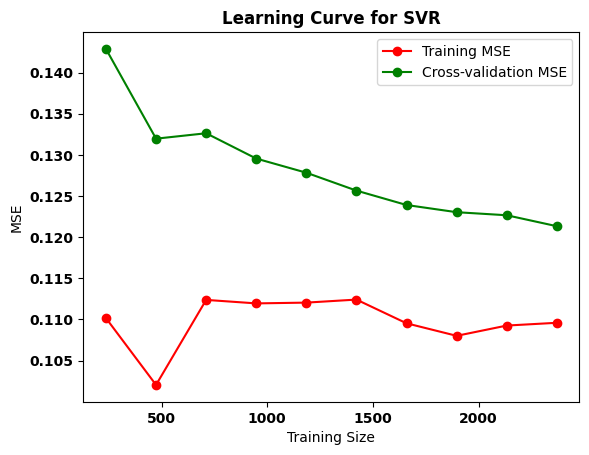

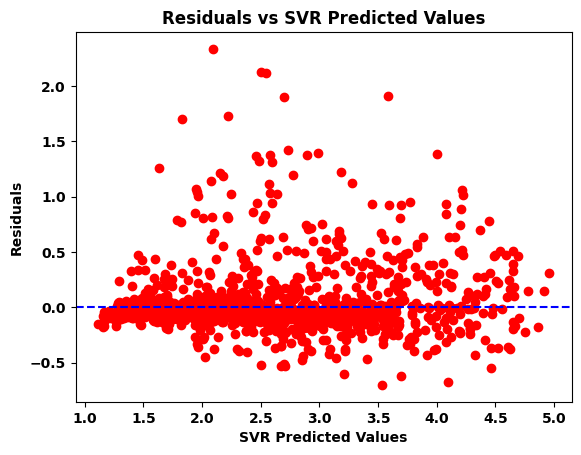

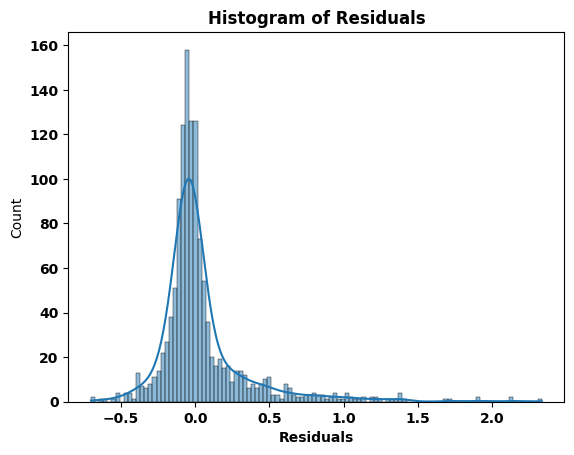

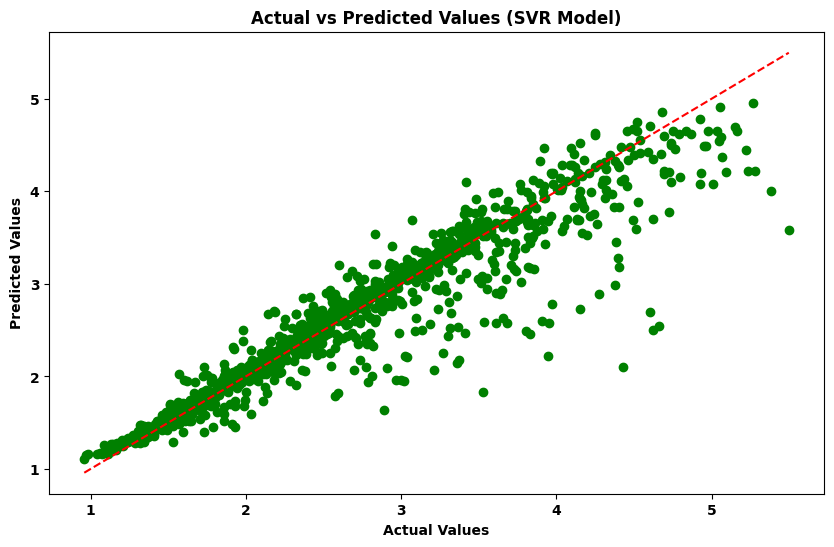

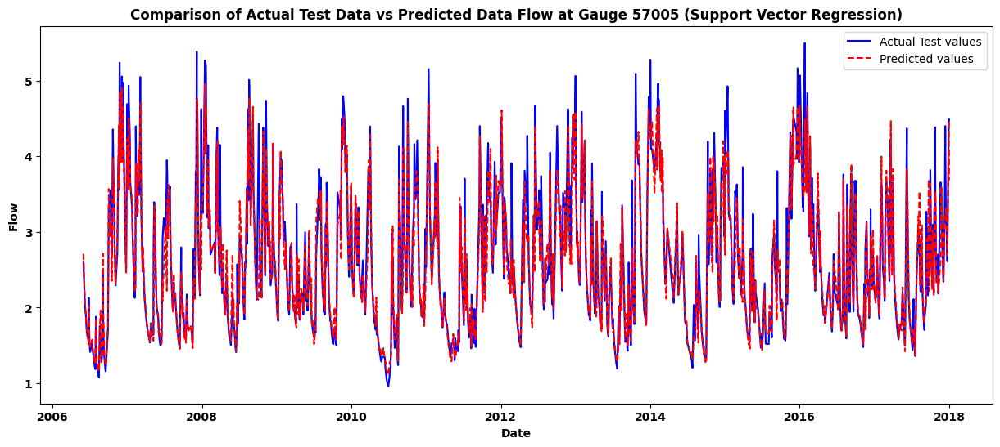

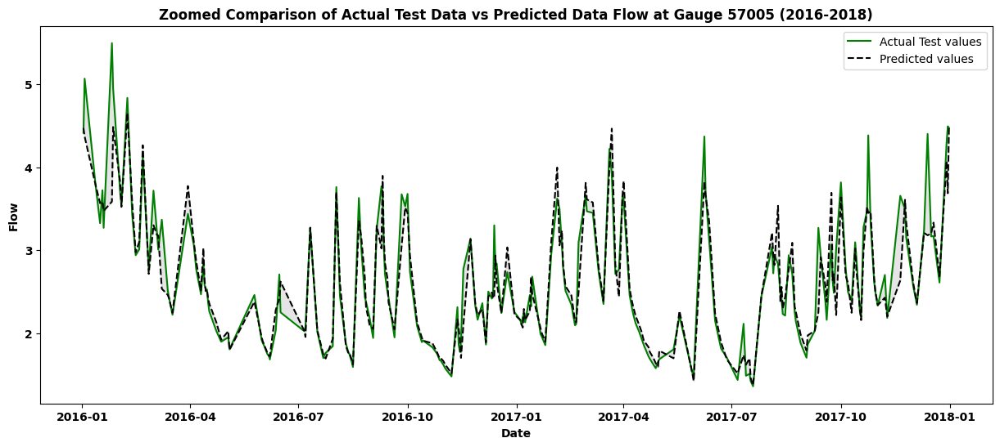

In [308]:
mx_scaler = MinMaxScaler()
# applied the scaleing only on the input training data
X_train_mx_scaled = mx_scaler.fit_transform(X_train_ss[selected_features])
# applied the scaling to the input test data
X_test_mx_scaled = mx_scaler.transform(X_test_ss[selected_features])
mx_svr_mse, mx_svr_r2, mx_svr_mape, mx_svr_pred, mx_svr_mae = svr_regression(
    X_train_mx_scaled,
    y_train_ss,
    X_test_mx_scaled,
    y_test_ss,
)

#### 6.2.1.2 Hyperparameter Tuning at log transformed data

In [309]:
def RandomSearch_find_best_parm(X_train_scaled, y_train_ss, X_test_scaled, y_test_ss):
    # Defined parameter grid for RandomizedSearchCV
    param_dist = {
        'C': uniform(10, 45),  # C values between 1 and 100
        'epsilon': uniform(0.01, 0.5),  # epsilon values between 0.01 and 0.5
        'gamma': ['scale', 'auto'] + list(uniform(0.01, 1).rvs(10)),  # Try 'scale', 'auto' and some random values
        'kernel': ['rbf']  # Trying different kernels
    }
    # Initialize the SVR model
    svr_model = SVR()
    # Define the scoring dictionary
    scoring = {
        'mae': make_scorer(mean_absolute_error, greater_is_better=False),  # Mean Absolute Error
        'mape': make_scorer(mean_absolute_percentage_error, greater_is_better=False),  # Mean Absolute Percentage Error
        'r2': 'r2',
    }
    
    # Initialize the RandomizedSearchCV object using multiple scoring metrics
    random_search = RandomizedSearchCV(
        estimator=svr_model,
        param_distributions=param_dist,
        n_iter=100,  # Number of parameter settings sampled
        scoring=scoring,  # Using multiple scoring metrics
        refit='mae',  # The metric used to select the best model
        cv=5,  # 5-fold cross-validation
        verbose=2,  # Verbosity level
        n_jobs=-1,  # Use all available cores
        random_state=42  # For reproducibility
    )    
    # Fit RandomizedSearchCV on the training data
    random_search.fit(X_train_scaled, y_train_ss)
    
    # Print the best parameters found by RandomizedSearchCV
    print("Best parameters found: ", random_search.best_params_)
    
    # Predict using the best model found
    best_svr_model = random_search.best_estimator_
    
    y_train_pred = best_svr_model.predict(X_train_scaled)
    y_test_pred = best_svr_model.predict(X_test_scaled)
    
    # Evaluate the model performance
    train_r2 = r2_score(y_train_ss, y_train_pred)
    test_r2 = r2_score(y_test_ss, y_test_pred)
    
    train_mse = mean_squared_error(y_train_ss, y_train_pred)
    test_mse = mean_squared_error(y_test_ss, y_test_pred)
    
    train_mape = mean_absolute_percentage_error(y_train_ss, y_train_pred)
    test_mape = mean_absolute_percentage_error(y_test_ss, y_test_pred)
    
    print(f'Training R-squared: {train_r2}, Training MSE: {train_mse}, Training MAPE: {train_mape}')
    print(f'Test R-squared: {test_r2}, Test MSE: {test_mse}, Test MAPE: {test_mape}')
    
    # Cross-Validation on best model using R-squared
    cv_r2 = cross_val_score(best_svr_model, X_train_scaled, y_train_ss, cv=5, scoring='r2').mean()
    
    print(f'Cross-Validation R-squared: {cv_r2}')
    return random_search.best_params_
best_svr_parms1 = RandomSearch_find_best_parm(X_train_mx_scaled, y_train_ss, X_test_mx_scaled, y_test_ss)


Fitting 5 folds for each of 100 candidates, totalling 500 fits
Best parameters found:  {'C': 52.23487190570876, 'epsilon': 0.010389382920507164, 'gamma': 0.26178229582536416, 'kernel': 'rbf'}
Training R-squared: 0.8720661432372194, Training MSE: 0.10972911632025797, Training MAPE: 0.05559643730776396
Test R-squared: 0.8836296180996669, Test MSE: 0.09971787973309765, Test MAPE: 0.05704039354794519
Cross-Validation R-squared: 0.8585698914742574


Training MSE: 0.10972911632025797, Training R-squared: 0.8720661432372194, Training MAPE: 0.05559643730776396
Test MSE: 0.09971787973309765, Test R-squared: 0.8836296180996669, Test MAPE: 0.05704039354794519
 Test MAE: 0.16931768826488264
Cross-Validation MSE: 0.12082265664494293
Cross-Validation R-squared: 0.8585698914742574
Cross-Validation MAPE: 0.062410716989797846


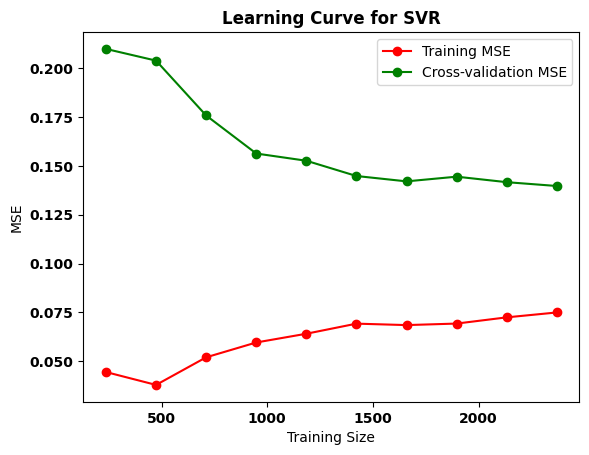

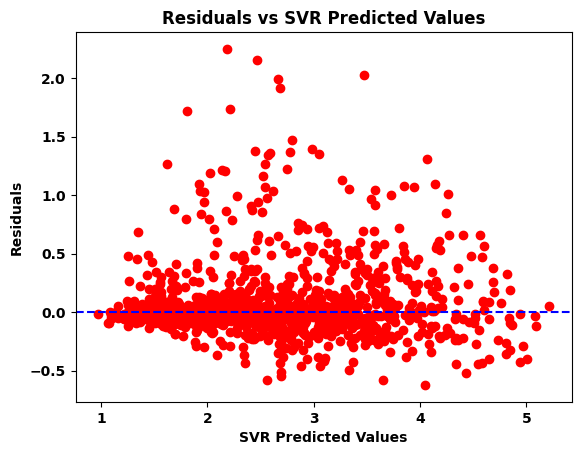

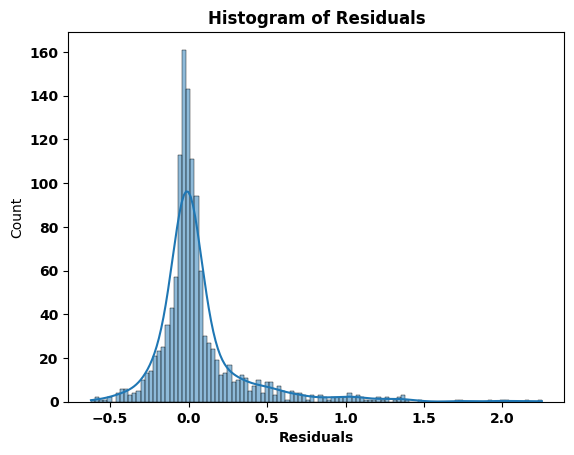

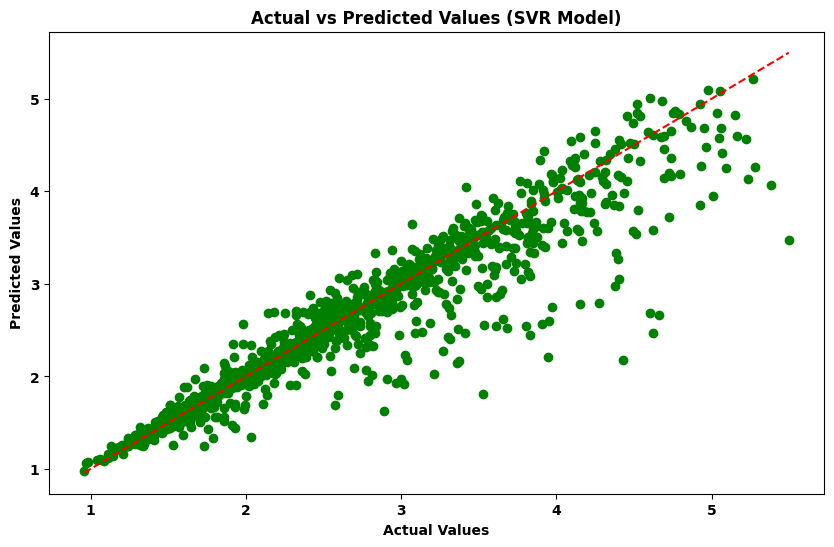

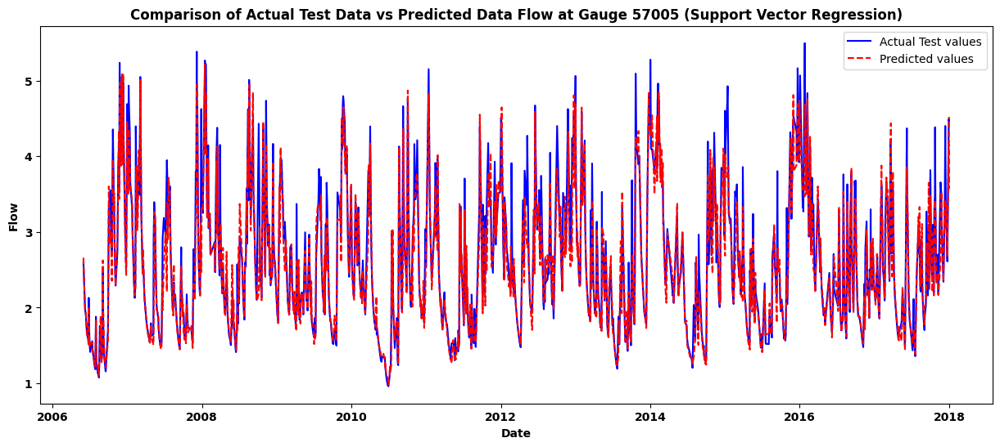

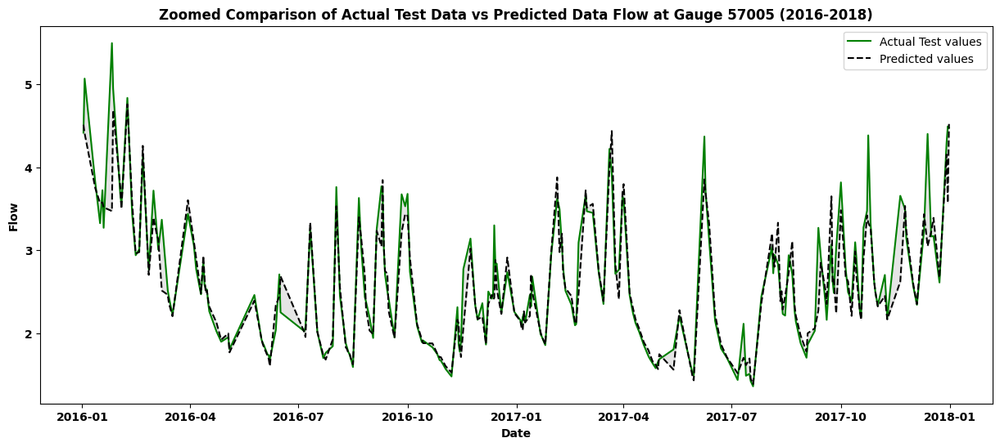

In [310]:

mse_svr, r2_svr, mape_svr, y_pred_svr, svr_mae= svr_regression(
    X_train_mx_scaled,
    y_train_ss,
    X_test_mx_scaled,
    y_test_ss,
    kernel=best_svr_parms1['kernel'],  C=best_svr_parms1['C'], epsilon=best_svr_parms1['epsilon'], gamma =best_svr_parms1['gamma']
)

## 6.3 Model building at log transformed along with deseasonalised data

### 6.3.1 Checking model performance at log transformed along with Deaseasonalised data for linear Regression model by automatic stepwise selection technique

Add gdf_57015_lag_1 with p-value 0.0
Add gdf_57004_lag_1 with p-value 1.9516238717184435e-222
Add cdr_57006_lag_1 with p-value 3.5317859146840502e-137
Add gdf_57007_lag_2 with p-value 3.956143005609647e-98
Drop gdf_57015_lag_1 with p-value 0.9872399732954341
Add gdf_57006_lag_4 with p-value 1.5713238939452555e-35
Add cdr_57004_lag_1 with p-value 2.8100628864825955e-07
Add gdf_57004_lag_5 with p-value 1.0509482797386933e-07
Drop cdr_57006_lag_1 with p-value 0.05082973000883902
Add gdf_57006_lag_1 with p-value 1.6729048337233866e-05
Add cdr_57007_lag_2 with p-value 2.5527732107781728e-05
Add gdf_57006_lag_5 with p-value 0.00037900449060347435
Add cdr_57015_lag_4 with p-value 0.0005764113998247649
Add gdf_57002_lag_1 with p-value 0.0021209279131413268
Add gdf_57004_lag_2 with p-value 0.0013481242413167132
Add cdr_57005_lag_1 with p-value 0.011583730516380964
Add gdf_57002_lag_4 with p-value 0.015252881763385769
Selected features: ['gdf_57004_lag_1', 'gdf_57007_lag_2', 'gdf_57006_lag_4', '

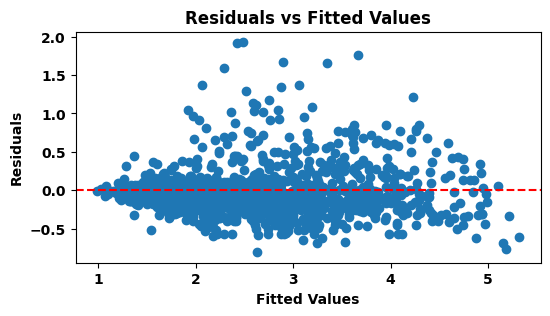

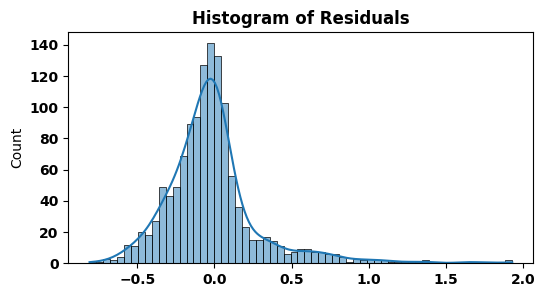

<Figure size 600x300 with 0 Axes>

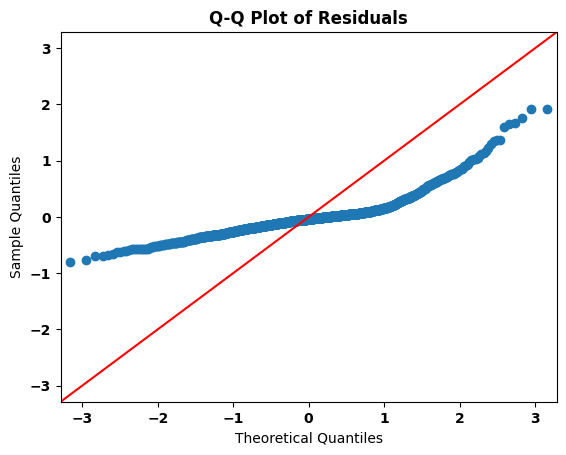

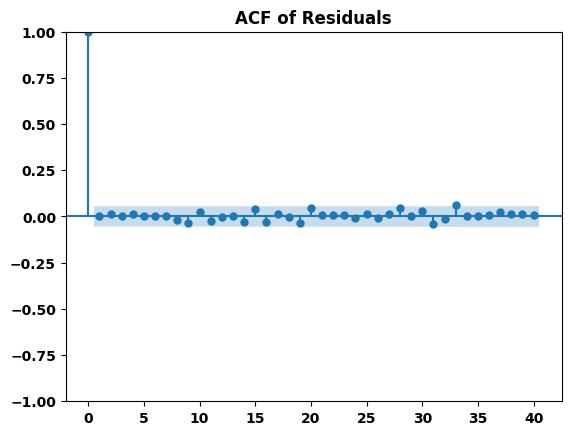

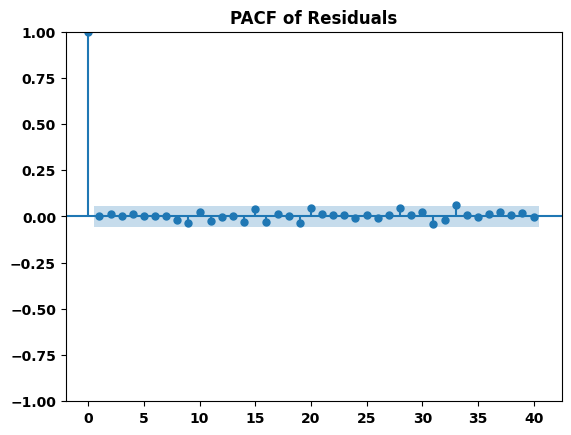

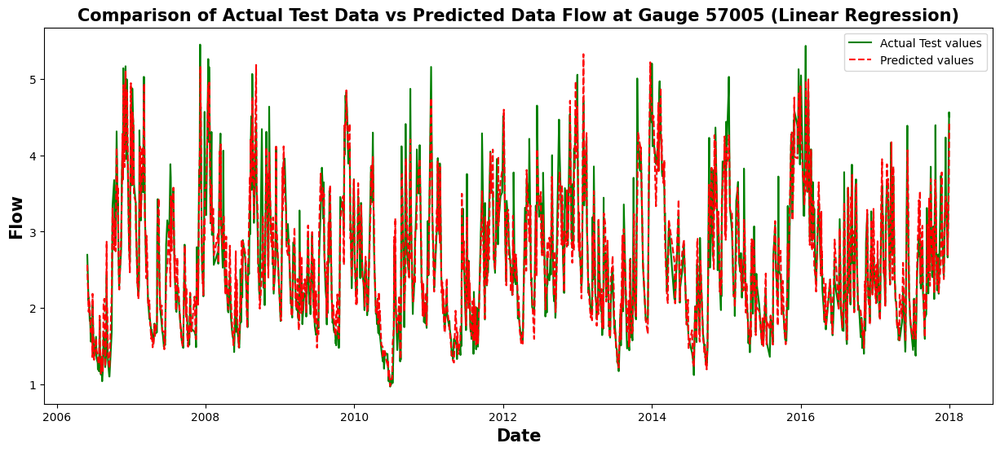

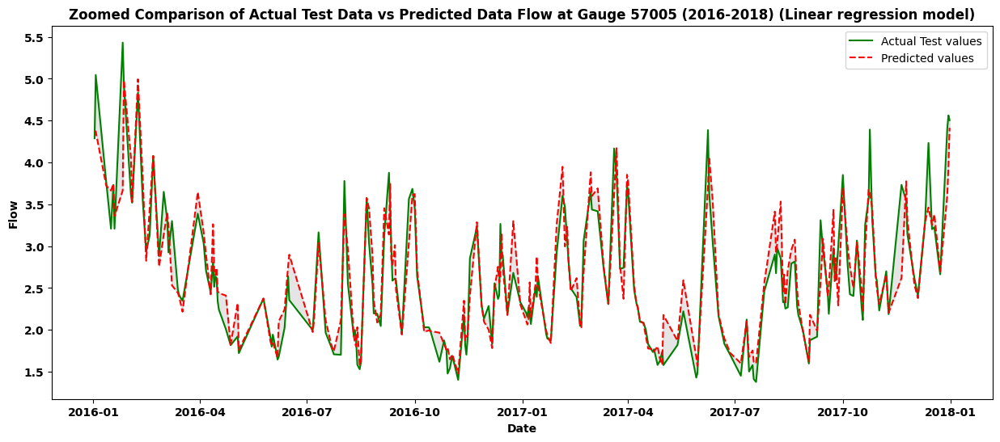

In [311]:
lag_features = lagged_datas(log_transformed_deseasonalised_df, lags_dict, target_col)  # deseasonalised
# Merge the lagged features with the target variable
data_with_lags = pd.concat([log_transformed_deseasonalised_df[target_col], lag_features], axis=1).dropna()  # log_transformed_deseasonalised_df

X_deseasonal = data_with_lags.drop(columns=[target_col])
y_deseasonal = data_with_lags[target_col]

# Split the data into train and test sets
X_train_ds, X_test_ds, y_train_ds, y_test_ds = train_test_split(X_deseasonal, y_deseasonal, test_size=0.3, random_state=42)
# Perform stepwise selection on the deseanalised data
selected_features_deseasonal = stepwise_selection(X_deseasonal, y_deseasonal)
# selected_features = bidirectional_elimination(X_train_ss, y_train_ss)
print('Selected features:', selected_features_deseasonal)
test_ss_mse, test_ss_mae, test_ss_r2, test_ss_mape, linear_pred = OLS_linear_regression_compute(selected_features_deseasonal,X_train_ds, X_test_ds, y_train_ds, y_test_ds)


### 6.3.2 Checking model performance at log transformed along with Deaseasonalised data for Support Vector Regression model

Training MSE: 0.10640359834437137, Training R-squared: 0.8748770311960006, Training MAPE: 0.06744722427757725
Test MSE: 0.09173554955405272, Test R-squared: 0.8921041419437358, Test MAPE: 0.06532280104913865
 Test MAE: 0.18115286592097501
Cross-Validation MSE: 0.11635100881951979
Cross-Validation R-squared: 0.8627201152396738
Cross-Validation MAPE: 0.07186008471530879


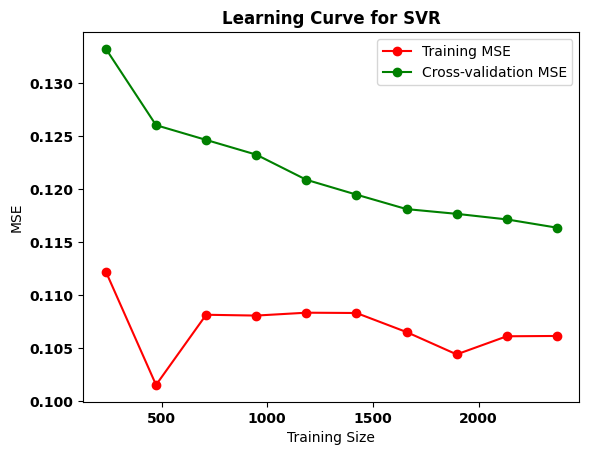

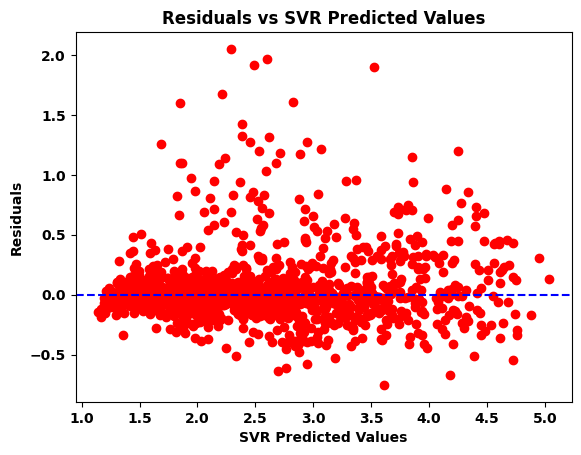

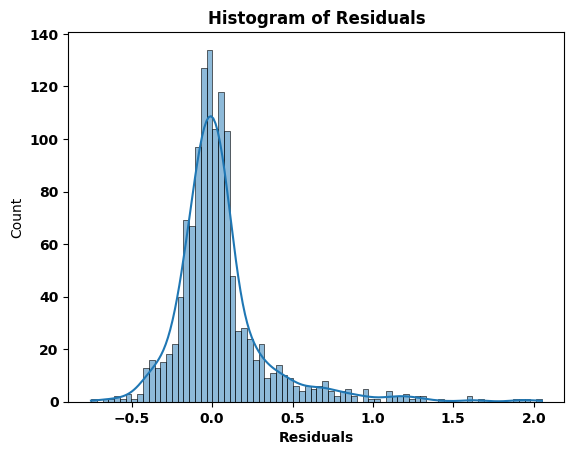

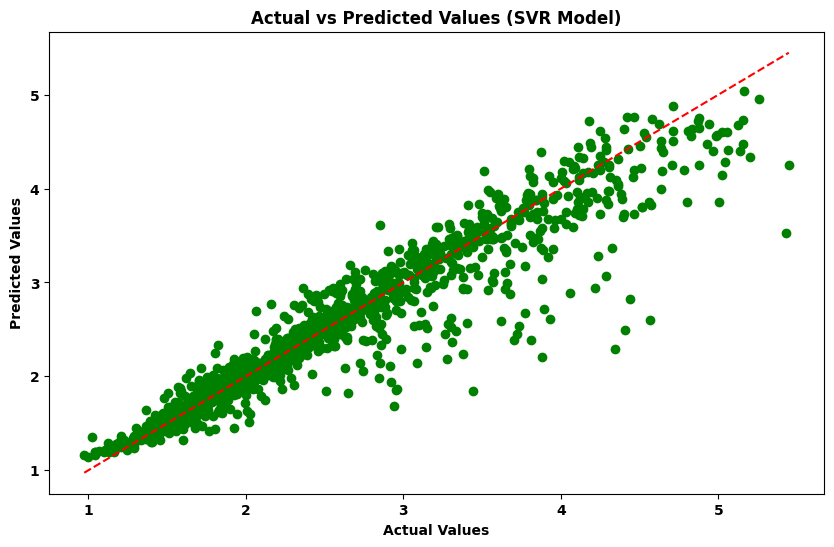

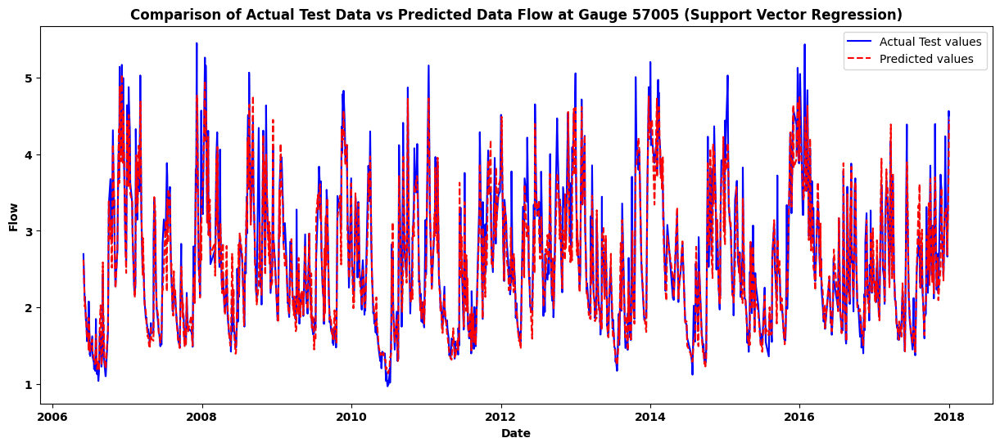

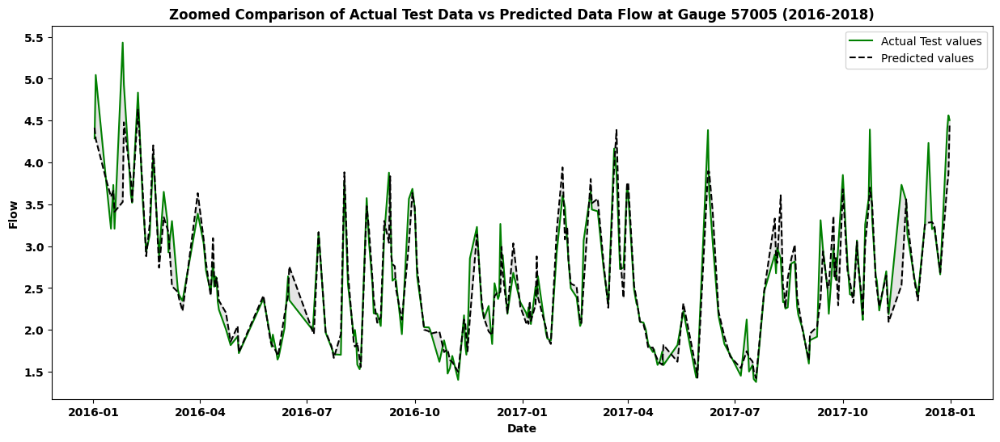

In [312]:
# Evaluate SVR with RBF kernel
ds_mse_svr, ds_r2_svr, ds_mape_svr, ds_y_pred_svr, ds_svr_mae = svr_regression(
    X_train_ds[selected_features_deseasonal],
    y_train_ds,
    X_test_ds[selected_features_deseasonal],
    y_test_ds)

## 6.4 Model optimization at Deseasonalised data for SVR model

### 6.4.1 Experiment of features scaling with deseasonalised data

##### MinMax Scaler

Training MSE: 0.10479339617266685, Training R-squared: 0.8767705129882821, Training MAPE: 0.06706634156679808
Test MSE: 0.091702602369835, Test R-squared: 0.8921428931664513, Test MAPE: 0.06531537491199156
 Test MAE: 0.18115167026770748
Cross-Validation MSE: 0.11587515327398538
Cross-Validation R-squared: 0.863273402643508
Cross-Validation MAPE: 0.07190914727739077


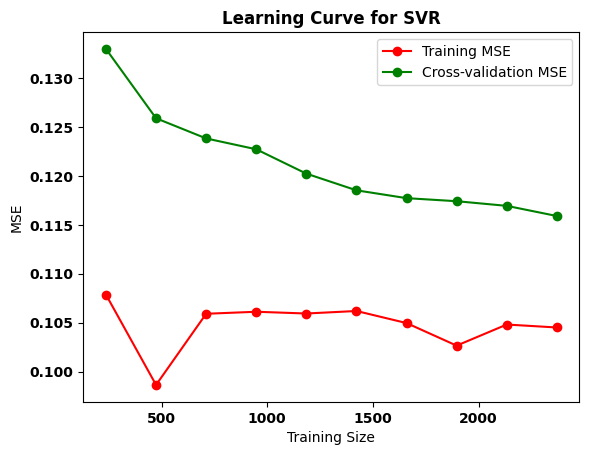

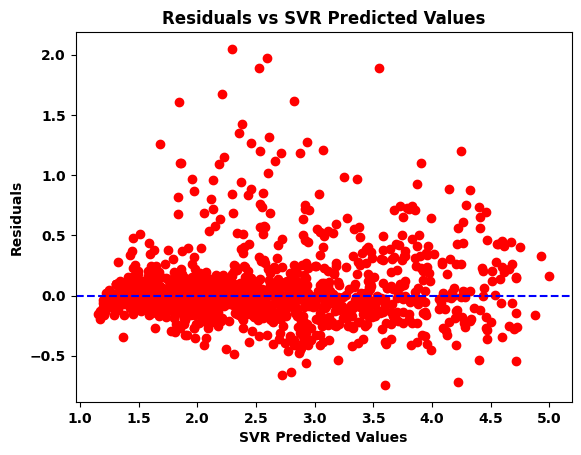

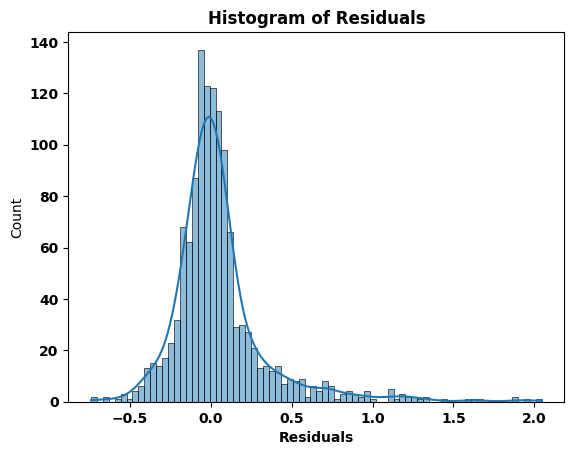

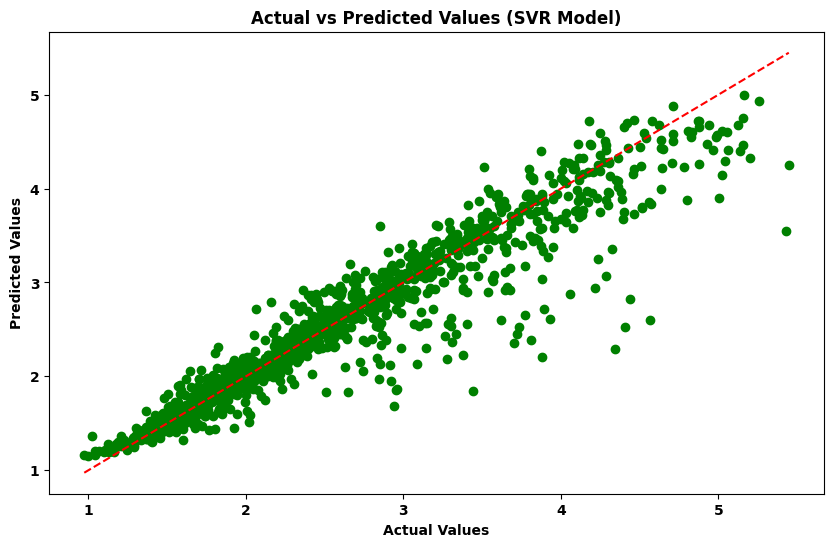

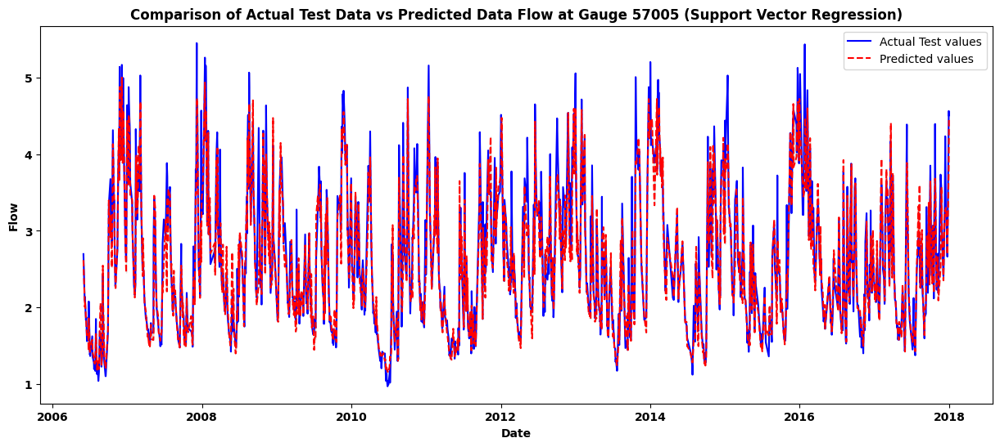

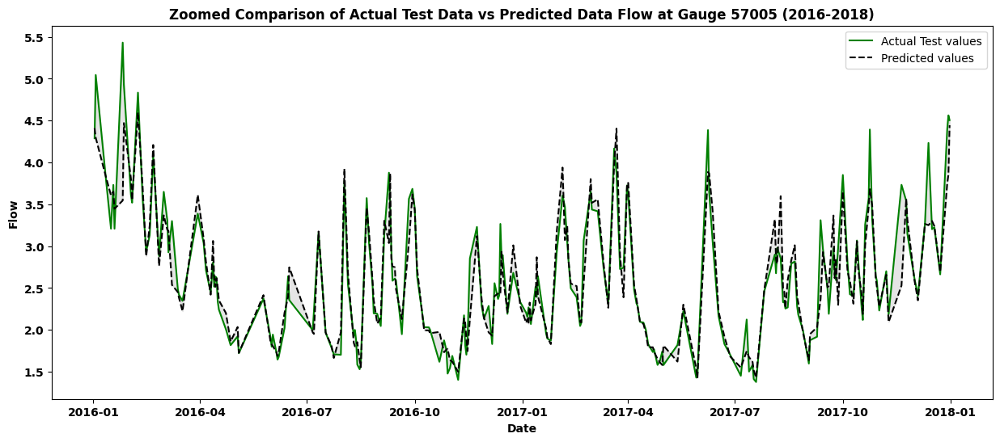

In [313]:
ds_mx_scaler = MinMaxScaler()
# Applied scaling only on input the training data
X_train_Min_scaled_deasonal = ds_mx_scaler.fit_transform(X_train_ds[selected_features_deseasonal])
# Applied scaling to input the test data
X_test_Min_scaled_deseasonal= ds_mx_scaler.transform( X_test_ds[selected_features_deseasonal])
ds_mx_mse_svr, ds_mx_r2_svr, ds_mx_mape_svr, ds_mx_y_pred_svr, ds_mx_svr_mae = svr_regression(
    X_train_Min_scaled_deasonal,
    y_train_ds,
    X_test_Min_scaled_deseasonal,
    y_test_ds
)

### 6.4.2 Hyperparamter tuning at deseasonalised data

In [314]:
# Execute the function
best_svr_prm2 = RandomSearch_find_best_parm(X_train_Min_scaled_deasonal, y_train_ds, X_test_Min_scaled_deseasonal, y_test_ds)

Fitting 5 folds for each of 100 candidates, totalling 500 fits
Best parameters found:  {'C': 30.272466338629435, 'epsilon': 0.016632480579933266, 'gamma': 0.3044488920695857, 'kernel': 'rbf'}
Training R-squared: 0.8721985968958152, Training MSE: 0.10868131801640964, Training MAPE: 0.0653702196138207
Test R-squared: 0.8898326548713135, Test MSE: 0.09366682030575225, Test MAPE: 0.06421840283842586
Cross-Validation R-squared: 0.8630424968627516


Training MSE: 0.10868131801640964, Training R-squared: 0.8721985968958152, Training MAPE: 0.0653702196138207
Test MSE: 0.09366682030575225, Test R-squared: 0.8898326548713135, Test MAPE: 0.06421840283842586
 Test MAE: 0.18013549756268446
Cross-Validation MSE: 0.11605229023681447
Cross-Validation R-squared: 0.8630424968627516
Cross-Validation MAPE: 0.0701069632435578


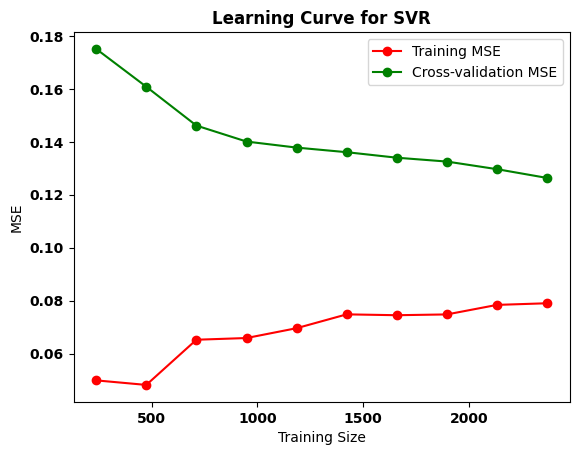

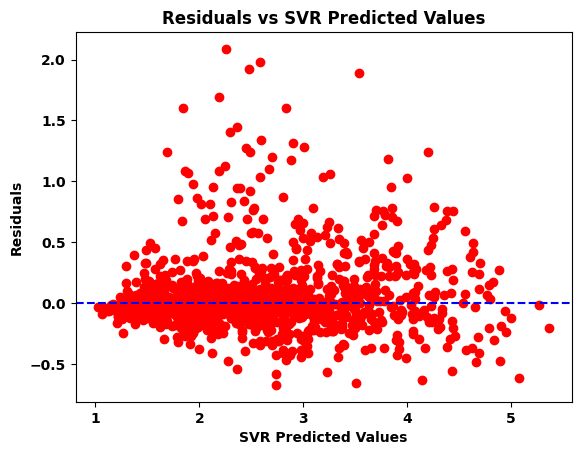

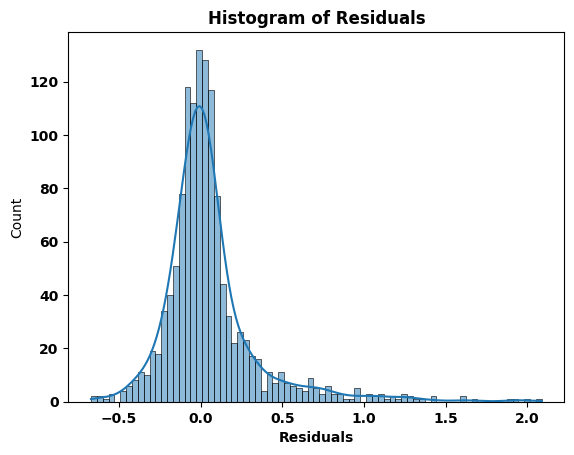

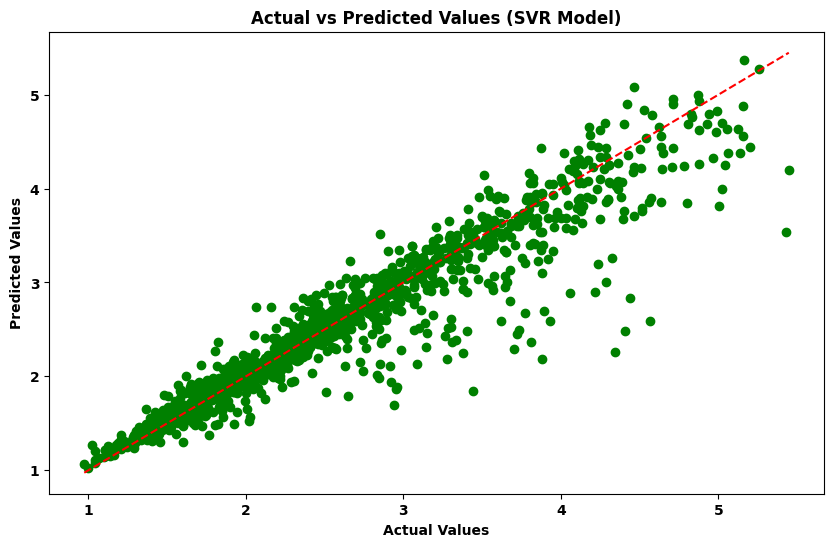

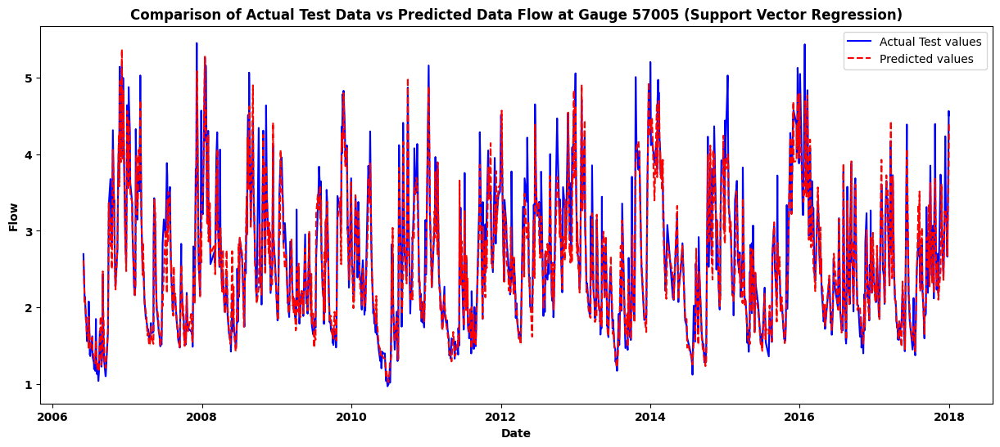

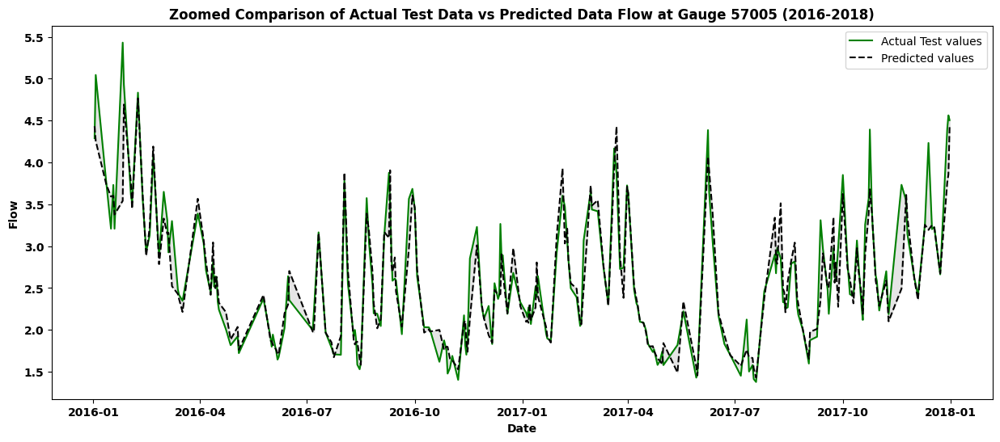

In [315]:
ds_rn_mse_svr, ds_rn_r2_svr, ds_rn_mape_svr, ds_rn_y_pred_svr, ds_rn_svr_mae= svr_regression(
    X_train_Min_scaled_deasonal,
    y_train_ds,
    X_test_Min_scaled_deseasonal,
    y_test_ds,
    kernel=best_svr_prm2['kernel'],  C=best_svr_prm2['C'], epsilon=best_svr_prm2['epsilon'], gamma =best_svr_prm2['gamma']
)

## 6.5 Model building with box-cox transformed data

### 6.5.1 Checking model performance at box-cox transformed data for linear Regression model by automatic stepwise selection technique

Add gdf_57015_lag_1 with p-value 0.0
Add gdf_57004_lag_1 with p-value 6.141727453090971e-153
Add cdr_57006_lag_1 with p-value 3.9432700506495186e-91
Add gdf_57007_lag_4 with p-value 5.120706667962268e-46
Add gdf_57006_lag_2 with p-value 7.087689410764344e-16
Add cdr_57001_lag_2 with p-value 1.9565836507737223e-08
Add gdf_57007_lag_5 with p-value 0.00023436260026765012
Add gdf_57015_lag_5 with p-value 0.0012400263163440215
Add gdf_57006_lag_1 with p-value 0.0019841229496421683
Add gdf_57007_lag_2 with p-value 8.985542145881056e-07
Drop gdf_57006_lag_2 with p-value 0.9327131322004585
Add cdr_57004_lag_1 with p-value 0.0002556309076482613
Drop cdr_57006_lag_1 with p-value 0.18000830102937834
Add gdf_57007_lag_1 with p-value 0.005228130346209462
Add gdf_57006_lag_5 with p-value 0.01948263825376506
Add gdf_57004_lag_4 with p-value 0.010075354527044757
Drop gdf_57007_lag_4 with p-value 0.15185747944547728
Add gdf_57015_lag_3 with p-value 0.00817455748368374
Add gdf_57007_lag_3 with p-value 0

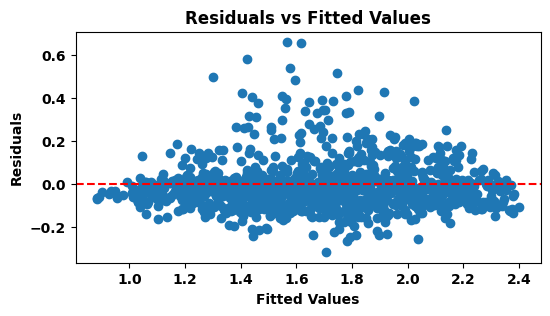

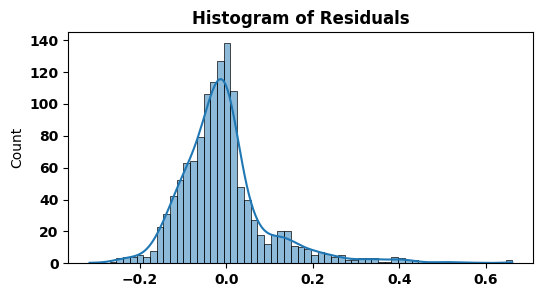

<Figure size 600x300 with 0 Axes>

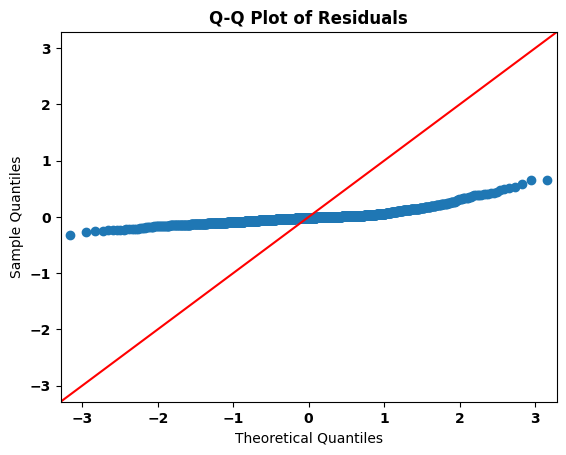

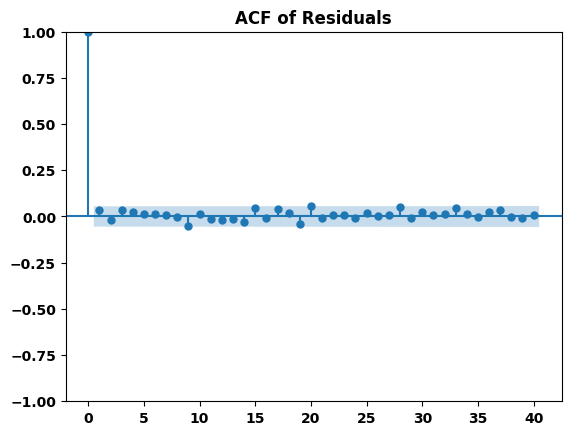

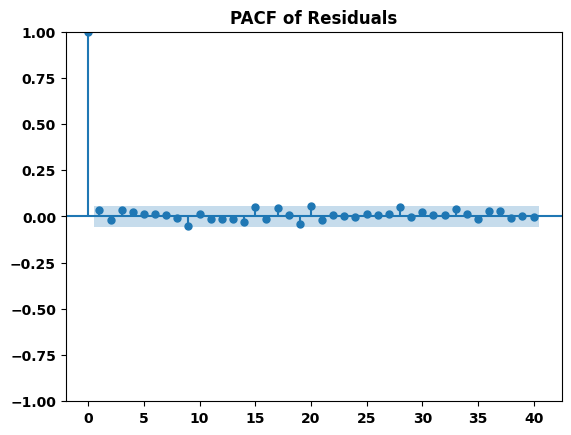

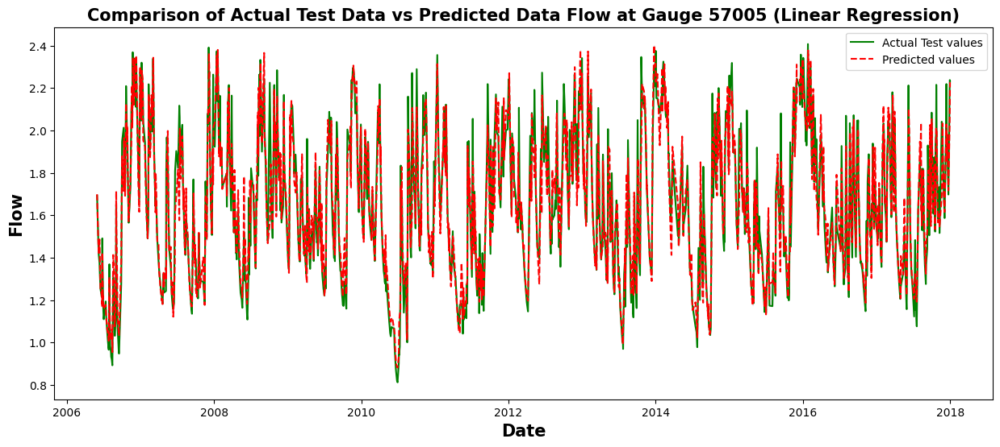

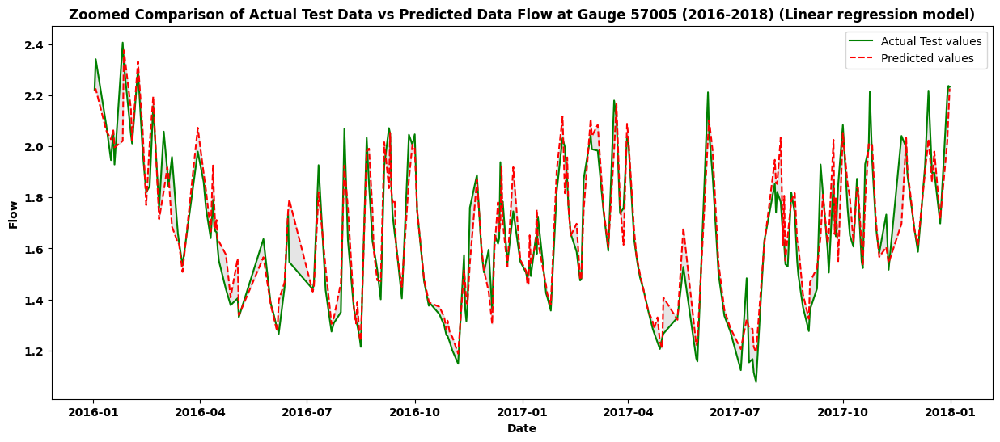

In [316]:
lag_features_box = lagged_datas(boxcox_transformed_df, lags_dict, target_col)  # deseasonalised
# Merge the lagged features with the target variable
data_with_lags_box = pd.concat([boxcox_transformed_df[target_col], lag_features_box], axis=1).dropna()  # log_transformed_deseasonalised_df
#print(data_with_lags_box)
X_box_cox = data_with_lags_box.drop(columns=[target_col])
y_box_cox = data_with_lags_box[target_col]

# Split the data into train and test sets
X_train_box, X_test_box, y_train_box, y_test_box = train_test_split(X_box_cox, y_box_cox, test_size=0.3, random_state=42)
# Perform stepwise selection on the training data
selected_features_box = stepwise_selection(X_train_box, y_train_box)
print('Selected features:', selected_features_box)
test_bx_mse, test_bx_mae, test_bx_r2, test_bx_mape, linear_pred = OLS_linear_regression_compute(selected_features_box,X_train_box, X_test_box, y_train_box, y_test_box)

### 6.5.2 Checking model performance at box-cox Transformed data for Support Vector Regression model

Training MSE: 0.013016195642954136, Training R-squared: 0.8892259541365238, Training MAPE: 0.048945409814975444
Test MSE: 0.011458141841495104, Test R-squared: 0.9036767247988573, Test MAPE: 0.04827434833861241
 Test MAE: 0.07819533908413856
Cross-Validation MSE: 0.014862896760938795
Cross-Validation R-squared: 0.8730377548002988
Cross-Validation MAPE: 0.05169274999518077


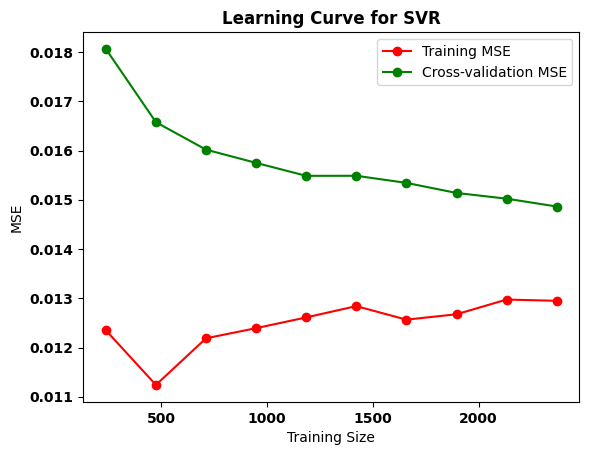

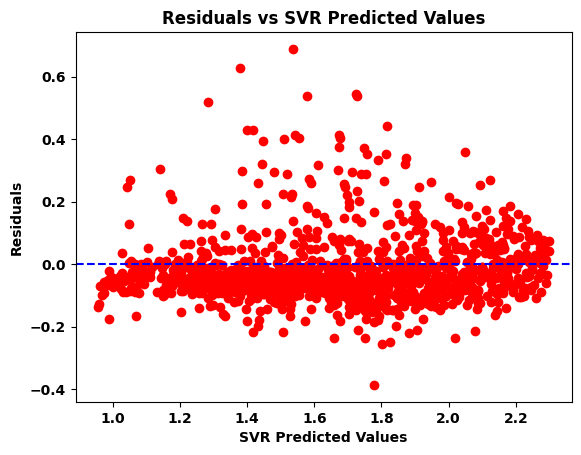

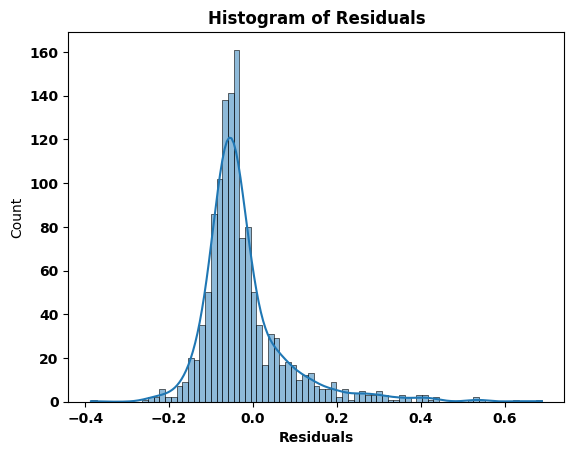

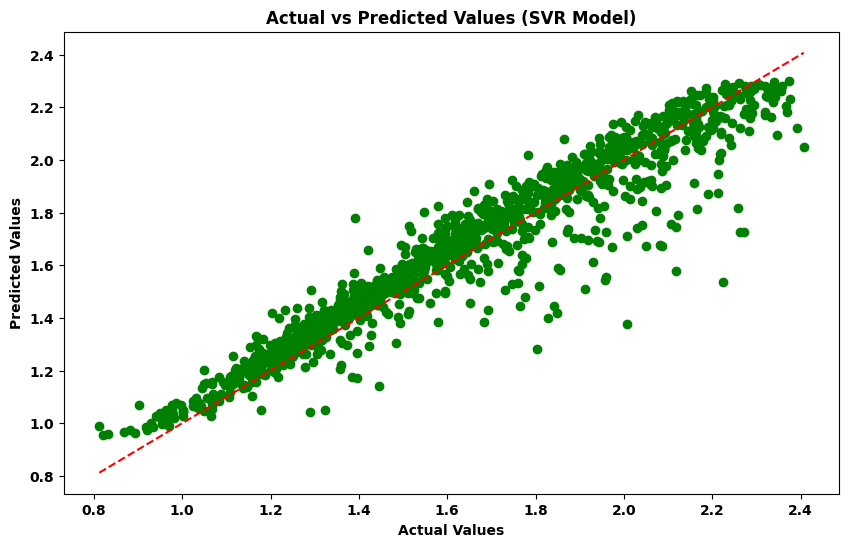

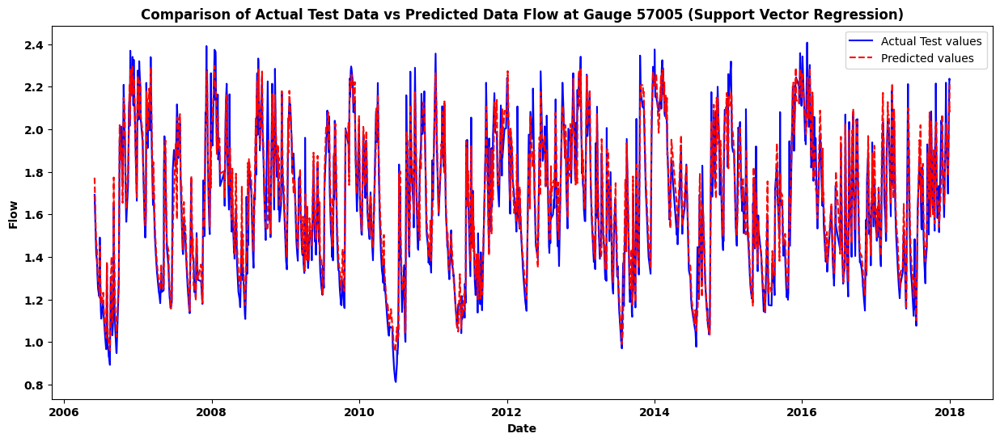

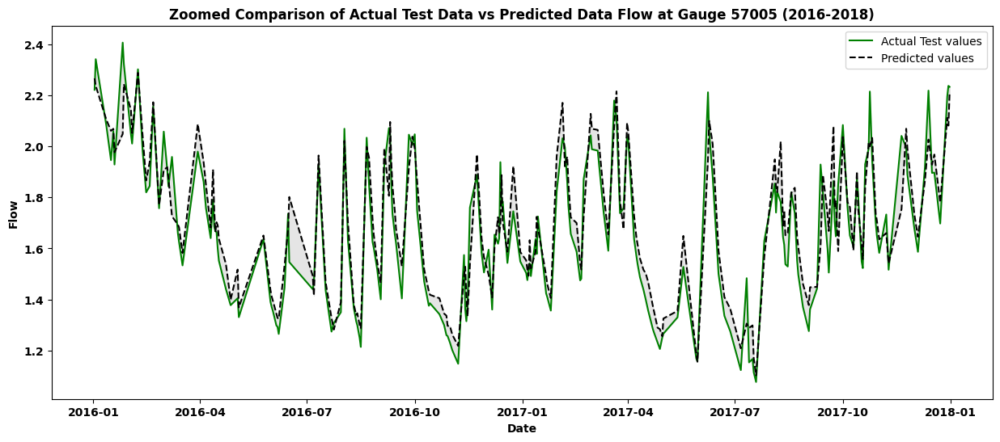

In [317]:
# Evaluate SVR with RBF kernel
box_mse_svr, box_r2_svr, box_mape_svr, box_y_pred_svr, box_svr_mae = svr_regression(
    X_train_box[selected_features_box],
    y_train_box,
    X_test_box[selected_features_box],
    y_test_box)

## 6.6 Model Optimization at box-cox Transformed data

### 6.6.1 Experiment with Feature Scaling

##### MinMax Scaler

Training MSE: 0.012739292360451824, Training R-squared: 0.8915825334133775, Training MAPE: 0.04896347662031575
Test MSE: 0.011417272935436457, Test R-squared: 0.9040202907050848, Test MAPE: 0.048893206538952176
 Test MAE: 0.07876633535458583
Cross-Validation MSE: 0.014614340838326323
Cross-Validation R-squared: 0.875152212196643
Cross-Validation MAPE: 0.051790456881600735


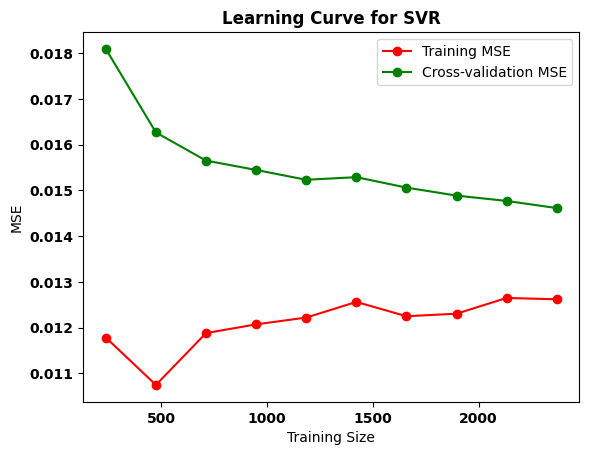

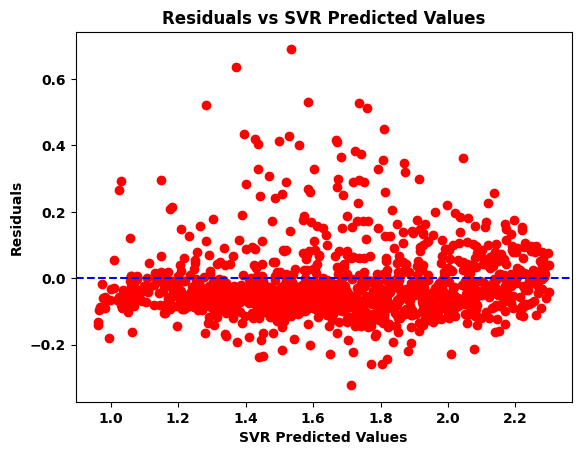

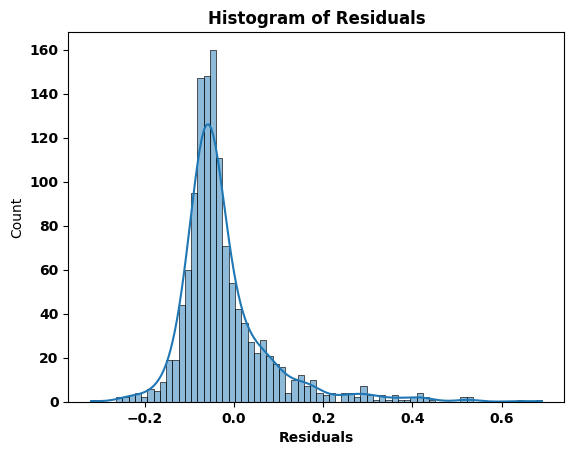

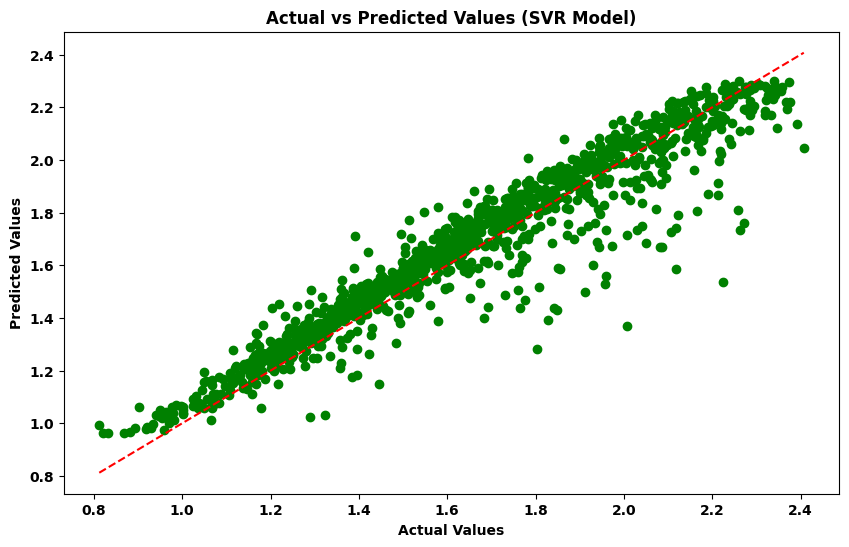

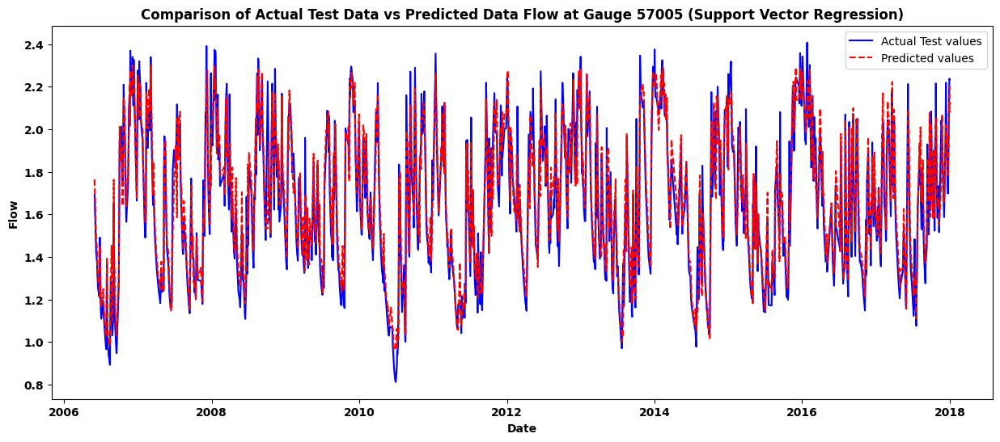

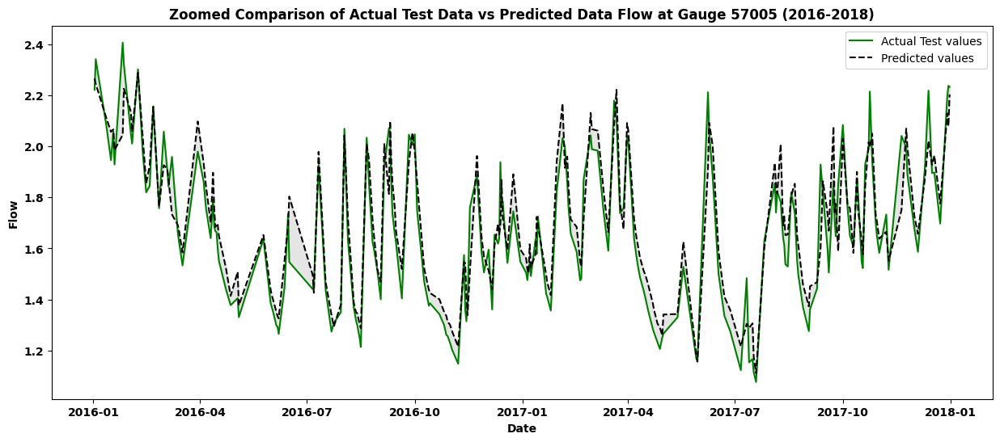

In [318]:
m_scaler = MinMaxScaler()
# Applied scaling only on input the training data
X_train_Min_scaled_box = m_scaler.fit_transform(X_train_box[selected_features_box])
# Applied scaling to input the test data
X_test_Min_scaled_box = m_scaler.transform(X_test_box[selected_features_box])

box_mx_mse_svr, box_mx_r2_svr, box_mx_mape_svr, box_mx_y_pred_svr, box_mx_svr_mae = svr_regression(
    X_train_Min_scaled_box,
    y_train_box,
    X_test_Min_scaled_box,
    y_test_box
)

### 6.6.2 Hyperparameter tuning for SVR model at box-cox transformed data

In [319]:
best_svr_prm3 = RandomSearch_find_best_parm(X_train_Min_scaled_box, y_train_box, X_test_Min_scaled_box, y_test_box)

Fitting 5 folds for each of 100 candidates, totalling 500 fits
Best parameters found:  {'C': 52.23487190570876, 'epsilon': 0.010389382920507164, 'gamma': 0.39610263780077426, 'kernel': 'rbf'}
Training R-squared: 0.8987801543521314, Training MSE: 0.011893555964598698, Training MAPE: 0.03297275660890368
Test R-squared: 0.908892018555013, Test MSE: 0.010837756213220834, Test MAPE: 0.035097233184801215
Cross-Validation R-squared: 0.8770361556080802


Training MSE: 0.011893555964598698, Training R-squared: 0.8987801543521314, Training MAPE: 0.03297275660890368
Test MSE: 0.010837756213220834, Test R-squared: 0.908892018555013, Test MAPE: 0.035097233184801215
 Test MAE: 0.059851208105131275
Cross-Validation MSE: 0.014386109474755479
Cross-Validation R-squared: 0.8770361556080802
Cross-Validation MAPE: 0.039730111647064144


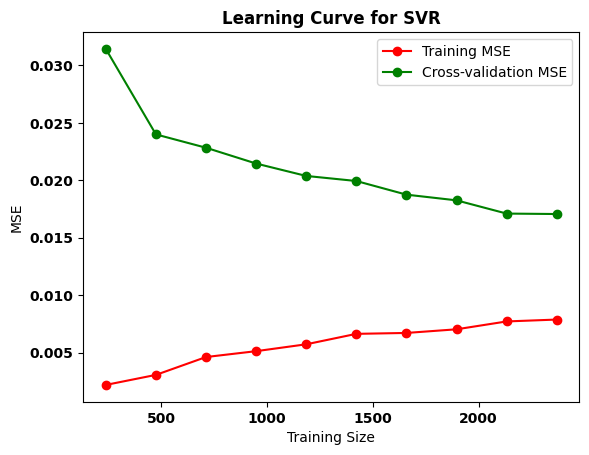

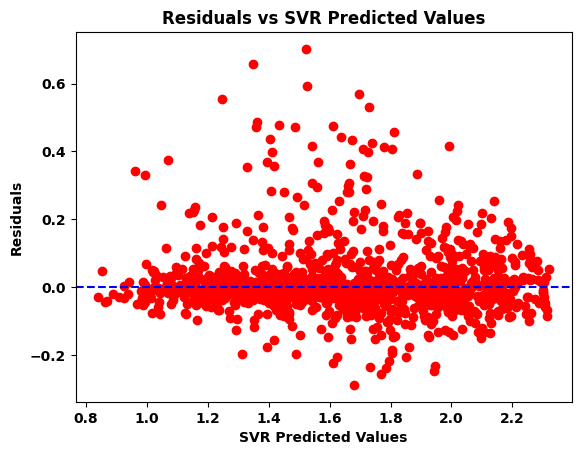

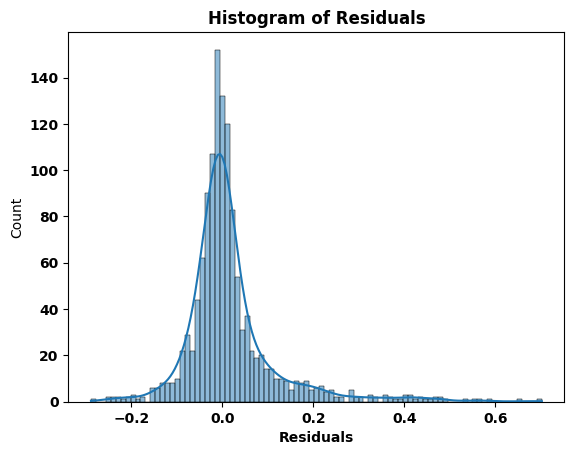

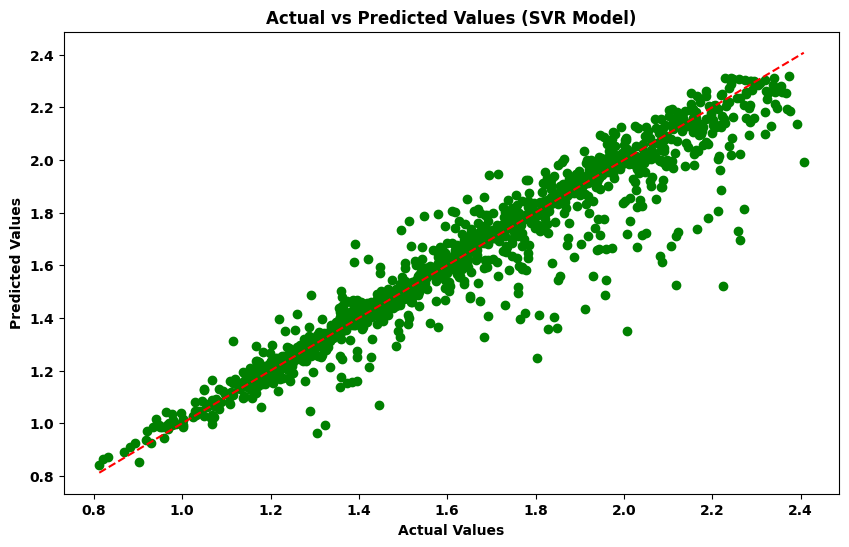

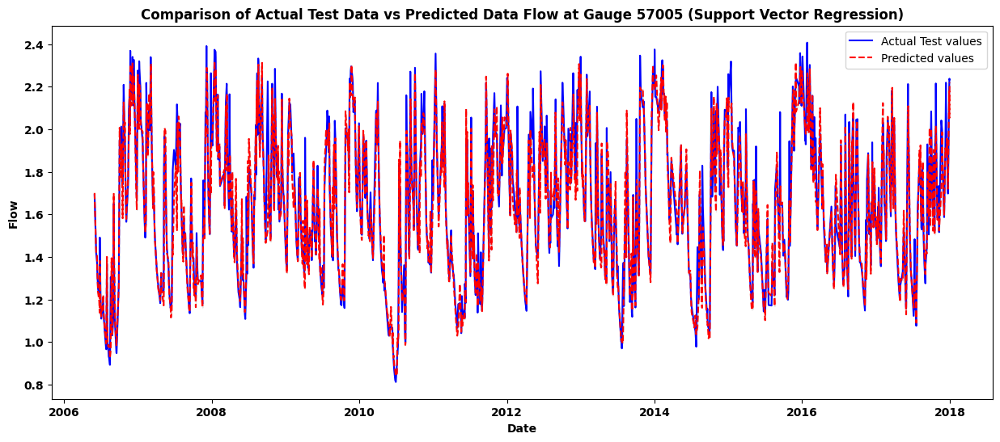

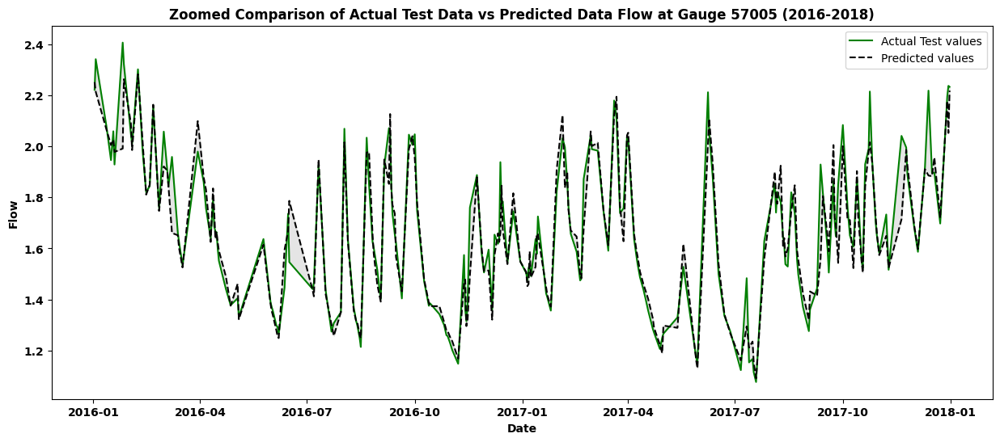

In [320]:

box_mx_rn_mse_svr, box_mx_rn_r2_svr, box_mx_rn_mape_svr, box_mx_rn_y_pred_svr, box_mx_rn_svr_mae = svr_regression(
    X_train_Min_scaled_box,
    y_train_box,
    X_test_Min_scaled_box,
    y_test_box,
    kernel=best_svr_prm3['kernel'],
    C=best_svr_prm3['C'],
    epsilon=best_svr_prm3['epsilon'],
    gamma= best_svr_prm3['gamma']
)

# 7. Predicting next Day ahead value of flow by best optimizing model

In [321]:
X_train_Min_scaled_box_df = pd.DataFrame(X_train_Min_scaled_box, columns=X_train_box[selected_features_box].columns, index=X_train_box.index)
X_test_Min_scaled_box_df = pd.DataFrame(X_test_Min_scaled_box, columns=X_test_box[selected_features_box].columns, index=X_test_box.index)
# Sort the test data by date (or any relevant index)
x_test_sorted = X_test_Min_scaled_box_df.sort_index()

# Extract the last sequence of features (last row) as a Series
last_sequence = x_test_sorted.iloc[-1]

# Convert the last sequence (Pandas Series) to a DataFrame to retain feature names
last_sequence_df = last_sequence.to_frame().T  # Transpose to make it a single-row DataFrame

# Fit the SVR model (assuming it's already trained and ready to predict)
svr_model = SVR(kernel=best_svr_prm3['kernel'], C=best_svr_prm3['C'], epsilon=best_svr_prm3['epsilon'], gamma=best_svr_prm3['gamma'])
svr_model.fit(X_train_Min_scaled_box_df, y_train_box)

# Make predictions for the next day using the last available sequence (DataFrame with feature names)
next_day_predicted_value = svr_model.predict(last_sequence_df)

# Get the last date from the test set
last_date = x_test_sorted.index[-1]

# Calculate the next day's date
next_day_date = last_date + pd.Timedelta(days=1)

# Print the predicted value for the next day
print(f"Predicted value for {next_day_date}: {next_day_predicted_value[0]}")

pred_bck_to_orgnl = inverse_boxcox(next_day_predicted_value[0], boxcox_lambdas['gdf_57005'])

print(f"Predicted value for {next_day_date} (original scale): {pred_bck_to_orgnl}")


Predicted value for 2018-01-01 00:00:00: 2.2189499249170384
Predicted value for 2018-01-01 00:00:00 (original scale): 81.6059124344596
